The center frequency of each peaks is used as a parameter to construct different networks. The main goal of this part is to build network in which the epileptic and non-epileptic channels are distiguishble. To achieve this, each channel is a node of the network and the links between nodes are build using different functions. These functions determine, for example, that a link is estabilished when two channel have peak frequencies within the same range or below a certain threshold. Another characteristic considered is the amplitude of the peak, with thresholds set for both range and amplitude. At the end the measurity of centrality, that are 'Degree Centrality', 'Betweenness Centrality', 'Closeness Centrality', 'Clustering Centrality'  are calculated for each node and saved. The Louvian algorithm is applied and a v_score is computed. 

In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
from collections import defaultdict
from networkx.algorithms import community
import re
import itertools
from community import community_louvain
import community as community_louvain
from collections import defaultdict
from sklearn.metrics.cluster import homogeneity_score
from sklearn.metrics import v_measure_score
import csv

In [2]:
# Ottieni l'elenco dei file nella cartella
folder_path = 'peaks_EPI'  # sostituisci con il percorso della tua cartella
files = os.listdir(folder_path)

folder_path_N= 'peaks_NON_EPI'
files_n=os.listdir(folder_path_N)

# # Rimuovi l'estensione .csv dai nomi dei file
files = [file.replace('.csv', '') for file in files]
files_n = [file.replace('.csv', '') for file in files_n]
# Aggiungi un nodo per ogni file
# files = os.path.splitext(folder_path)
# files_n=os.path.splitext(folder_path_N)
total_files=files+files_n
print(files)
print(files_n)
print(len(total_files))

['J1', 'J2', 'J3', 'J4', 'J5', 'L1', 'L10', 'L11', 'L12', 'L13', 'L14', 'L15', 'L2', 'L3', 'L4', 'L5', 'L6', 'L7', 'L8', 'L9', 'M1', 'M2', 'M3', 'M4', 'M5', 'N1', 'N2', 'N3', 'N4', 'N5', 'N6', 'O10', 'O11', 'O13', 'O5', 'O6', 'O7', 'O8', 'O9', 'R1', 'R2', 'R3', 'X1', 'X2', 'X3', 'X4', 'Z2', 'Z3', 'Z4', 'Z5']
['A1', 'A10', 'A11', 'A12', 'A13', 'A14', 'A2', 'A3', 'A4', 'A5', 'A6', 'A7', 'A8', 'A9', 'F1', 'F10', 'F11', 'F12', 'F2', 'F3', 'F6', 'F7', 'F8', 'F9', 'G1', 'G10', 'G11', 'G12', 'G13', 'G14', 'G2', 'G3', 'G4', 'H1', 'H10', 'H11', 'H12', 'H2', 'H3', 'H4', 'H7', 'H8', 'H9', 'I1', 'I10', 'I2', 'I3', 'I7', 'I8', 'I9', 'J14', 'J15', 'J16', 'J17', 'J18', 'M15', 'M16', 'M17', 'N10', 'N11', 'N12', 'N13', 'N14', 'N15', 'N16', 'N17', 'N18', 'O1', 'O12', 'O2', 'O3', 'O4', 'Q1', 'Q2', 'Q3', 'Q4', 'Q5', 'Q6', 'Q7', 'Q8', 'Q9', 'R10', 'R11', 'R12', 'R13', 'R14', 'R15', 'R16', 'R7', 'R8', 'R9', 'T1', 'T2', 'T3', 'T4', 'X11', 'X12', 'X13', 'X14', 'X15', 'X16', 'X5', 'X6', 'Y1', 'Y10', 'Y11', 'Y2

In [3]:
def legame(file1, file2, threshold):
    # Leggi i file
    df1 = pd.read_csv(file1, header=None)
    df2 = pd.read_csv(file2, header=None)

    # Ottieni i picchi
    picchi1 = df1.iloc[:, 0]
    picchi2 = df2.iloc[:, 0]

    # Controlla se ci sono almeno due valori tali che la loro differenza sia minore del threshold
    for val1, val2 in itertools.product(picchi1, picchi2):
        if abs(val1 - val2) < threshold:
            return True
    return False
def legame_val(file1, file2, threshold):
    # Leggi i file
    df1 = pd.read_csv(file1, header=None)
    df2 = pd.read_csv(file2, header=None)

    # Ottieni i picchi
    picchi1 = df1.iloc[:, 0]
    picchi2 = df2.iloc[:, 0]
    #print('picco 1', picchi1)
    #print('picco 2', picchi2)

    # Conta il numero di valori tali che la loro differenza sia minore del threshold
    count = 0
    for val1, val2 in itertools.product(picchi1, picchi2):
        if val1<150 and val2<150:
            if abs(val1 - val2) < threshold:
                count += 1
    #print('count',count)
    return count


In [4]:
def legame_ampiezze(file1, file2, threshold, amplitude_threshold):
    # Leggi i file
    df1 = pd.read_csv(file1, header=None)
    df2 = pd.read_csv(file2, header=None)

    # Ottieni i picchi e le ampiezze
    picchi1 = df1.iloc[:, 0]
    ampiezze1 = df1.iloc[:, 1]
    picchi2 = df2.iloc[:, 0]
    ampiezze2 = df2.iloc[:, 1]

    # Conta il numero di valori tali che la loro differenza sia minore del threshold
    count = 0
    for (val1, amp1), (val2, amp2) in itertools.product(zip(picchi1, ampiezze1), zip(picchi2, ampiezze2)):
        if val1<150 and val2<150:
            if abs(val1 - val2) < threshold:
                # Confronta le ampiezze
                if abs(amp1 - amp2) < amplitude_threshold:
                    count += 1
    #print('count',count)
    return count
def legame_ampiezze_bw(file1, file2, threshold, amplitude_threshold, lower_bound, upper_bound):
    # Leggi i file
    df1 = pd.read_csv(file_path1, header=None)
    df2 = pd.read_csv(file_path2, header=None)

    # Ottieni i picchi e le ampiezze
    picchi1 = df1.iloc[:, 0]
    ampiezze1 = df1.iloc[:, 1]
    picchi2 = df2.iloc[:, 0]
    ampiezze2 = df2.iloc[:, 1]

    # Conta il numero di valori tali che la loro differenza sia minore del threshold
    count = 0
    for (val1, amp1), (val2, amp2) in itertools.product(zip(picchi1, ampiezze1), zip(picchi2, ampiezze2)):
        if lower_bound <= val1 <= upper_bound and lower_bound <= val2 <= upper_bound:
            if abs(val1 - val2) < threshold:
                print(abs(val1 - val2))
                # Confronta le ampiezze
                if abs(amp1 - amp2) < amplitude_threshold:
                    print(abs(amp1 - amp2))
                    count += 1
                    print('count', count)
    print('count', count)
    return count


In [5]:
def legame_bw(file1, file2, threshold, bw1, bw2):
    # Leggi i file
    df1 = pd.read_csv(file1, header=None)
    df2 = pd.read_csv(file2, header=None)

    # Ottieni i picchi
    picchi1 = df1.iloc[:, 0]
    picchi2 = df2.iloc[:, 0]
    #print('picco 1', picchi1)
    #print('picco 2', picchi2)

    # Conta il numero di valori tali che la loro differenza sia minore del threshold
    count = 0
    for val1, val2 in itertools.product(picchi1, picchi2):
        if val1>=bw1 and val2>=bw1:
            if val1<=bw2 and val2<=bw2:
                count += 1
    #print('count',count)
    return count

In [6]:
def legame_bw_ranges(file1, file2, threshold, ranges):
    # Leggi i file
    df1 = pd.read_csv(file1, header=None)
    df2 = pd.read_csv(file2, header=None)

    # Ottieni i picchi
    picchi1 = df1.iloc[:, 0]
    picchi2 = df2.iloc[:, 0]

    # Conta il numero di valori tali che la loro differenza sia minore del threshold
    count = 0
    for val1, val2 in itertools.product(picchi1, picchi2):
        for bw1, bw2 in ranges:
            if val1 >= bw1 and val2 >= bw1 and val1 <= bw2 and val2 <= bw2:
                count += 1
                break  # Esci dal loop dei range se il valore è già stato contato

    return count

# Esempio di utilizzo
ranges = [(0.4, 4), (12, 75)]
threshold = 0.5  # Imposta il threshold desiderato



In [7]:
def legame_tipo(file_path1 , file_path2 , threshold1=22.5, threshold2=65, threshold3=12.5):
    # Leggi i dati dai file CSV
    data1 = pd.read_csv(file_path1+ '.csv', header=None)
    data2 = pd.read_csv(file_path2+ '.csv', header=None)
    
    # Supponiamo che i picchi siano nella prima colonna
    picchi1 = data1.iloc[:, 0]
    picchi2 = data2.iloc[:, 0]
    
    # Inizializza i flag per i legami
    legame1 = False
    legame2 = False
    
    # Controlla i picchi per il legame di tipo 2
    if any(threshold1 <= picco <= threshold2 for picco in picchi1) and any(threshold1 <= picco <= threshold2 for picco in picchi2):
        legame2 = True
    
    # Controlla i picchi per il legame di tipo 1 solo se non c'è un legame di tipo 2
    if not legame2 and any(threshold3 <= picco <= threshold1 for picco in picchi1) and any(threshold3 <= picco <= threshold1 for picco in picchi2):
        legame1 = True    
    
    # Determina il tipo di legame
    if legame1 and legame2:
        return 3  # Entrambi i legami
    elif legame1:
        return 1  # Solo legame di tipo 1
    elif legame2:
        return 2  # Solo legame di tipo 2
    else:
        return 0  # Nessun legame


In [8]:
#threshold1=22.5, threshold2=65, threshold3=12.5

In [31]:
def legame_tipo(file_path1, file_path2, threshold1=22.5, threshold2=77.5, threshold3=0):
    # Leggi i dati dai file CSV
    data1 = pd.read_csv(file_path1 + '.csv', header=None)
    data2 = pd.read_csv(file_path2 + '.csv', header=None)
    
    # Supponiamo che i picchi siano nella prima colonna
    picchi1 = data1.iloc[:, 0]
    picchi2 = data2.iloc[:, 0]
    
    # Inizializza i flag per i legami
    legame1 = False
    legame2 = False
    
    # Controlla i picchi per il legame di tipo 2
    if any(threshold1 <= picco <= threshold2 for picco in picchi1) and any(threshold1 <= picco <= threshold2 for picco in picchi2):
        legame2 = True
    
    # Controlla i picchi per il legame di tipo 1 solo se non c'è un legame di tipo 2
    if not legame2 and all(threshold3 <= picco <= threshold1 for picco in picchi1) and all(threshold3 <= picco <= threshold1 for picco in picchi2):
        legame1 = True    
    
    # Determina il tipo di legame
    if legame1 and legame2:
        return 3  # Entrambi i legami
    elif legame1:
        return 1  # Solo legame di tipo 1
    elif legame2:
        return 2  # Solo legame di tipo 2
    else:
        return 0  # Nessun legame

In [10]:
def costruisci_network(folder_path, folder_path_N, threshold1=22.5, threshold2=77.5, threshold3=0):
    # Ottieni l'elenco dei file nelle cartelle
    files = os.listdir(folder_path)
    files_n = os.listdir(folder_path_N)
    files = [file.replace('.csv', '') for file in files]
    files_n = [file.replace('.csv', '') for file in files_n]
    total_files = files + files_n
    count=0
    # Crea un grafo vuoto
    G = nx.Graph()
    
    # Aggiungi nodi al grafo
    for filename in total_files:
#         # Salta i file non .csv
#         if not filename.endswith('.csv'):
#             continue
        
        # Determina il percorso del file e il colore del nodo
        if filename in files:
            file_path = os.path.join(folder_path, filename + '.csv')
            color = 'red'
        else:
            file_path = os.path.join(folder_path_N, filename + '.csv')
            color = 'blue'
        
        # Prova a leggere il file
        try:
            df = pd.read_csv(file_path)
        except PermissionError:
            print(f"Non è possibile leggere il file {file_path}. Salto.")
            continue

        # Aggiungi un nodo per ogni file
        G.add_node(filename, label=filename, color=color)
    
    # Aggiungi archi basati sui legami
    legami_tipo2 = set()
    legami_tipo1 = set()
    
    # Prima passata: trova e collega i legami di tipo 2
    for i in range(len(total_files)):
        for j in range(i + 1, len(total_files)):
#             if not total_files[i].endswith('.csv') or not total_files[j].endswith('.csv'):
#                 continue
            
            file_path_i = os.path.join(folder_path, total_files[i]) if total_files[i] in files else os.path.join(folder_path_N, total_files[i])
            file_path_j = os.path.join(folder_path, total_files[j]) if total_files[j] in files else os.path.join(folder_path_N, total_files[j])
            
            legame = legame_tipo(file_path_i, file_path_j, threshold1, threshold2, threshold3)
            
            if legame == 2:
                legami_tipo2.add(total_files[i])
                legami_tipo2.add(total_files[j])
                G.add_edge(total_files[i], total_files[j], tipo=2)
                
                #print(f"Legame di tipo 2 trovato tra {total_files[i]} e {total_files[j]}")
        
    # Seconda passata: trova e collega i legami di tipo 1, escludendo i file con legami di tipo 2
    for i in range(len(total_files)):
        for j in range(i + 1, len(total_files)):
#             if not total_files[i].endswith('.csv') or not total_files[j].endswith('.csv'):
#                 continue
            
            if total_files[i] in legami_tipo2 or total_files[j] in legami_tipo2:
                continue
            
            file_path_i = os.path.join(folder_path, total_files[i]) if total_files[i] in files else os.path.join(folder_path_N, total_files[i])
            file_path_j = os.path.join(folder_path, total_files[j]) if total_files[j] in files else os.path.join(folder_path_N, total_files[j])
            
            legame = legame_tipo(file_path_i, file_path_j, threshold1, threshold2, threshold3)
            
            if legame == 1:
                G.add_edge(total_files[i], total_files[j], tipo=1)
                #print(f"Legame di tipo 1 trovato tra {total_files[i]} e {total_files[j]}")
    # Controlla se ci sono file con entrambi i tipi di legami
    both_legami = legami_tipo2.intersection(legami_tipo1)
    
    if both_legami:
        for filename in both_legami:
            print(f"{filename} ha sia legami di tipo 1 che di tipo 2")
    else:
        print("Nessun file ha sia legami di tipo 1 che di tipo 2")
        
    # Stampa il numero di file con legami di tipo 2
    print(f"Numero di file con legami di tipo 2: {len(legami_tipo2)}")
    return G


In [11]:
def new_graph():
        # Crea un grafo vuoto
    G = nx.Graph()

    # Itera su tutti i file in entrambe le directory
    for filename in total_files:
        # Determina il percorso del file
        # Salta i file non .csv
#         if not filename.endswith('.csv'):
#             continue

        # Determina il percorso del file
        if filename in files:
            file_path = os.path.join(folder_path, filename + '.csv')
            color='red'
        else:
            file_path = os.path.join(folder_path_N, filename + '.csv')
            color='blue'

        # Prova a leggere il file
        try:
            df = pd.read_csv(file_path)
        except PermissionError:
            print(f"Non è possibile leggere il file {file_path}. Salto.")
            continue

        # Aggiungi un nodo per ogni file
        G.add_node(filename, label=filename, color= color)
        
    return G

In [34]:
def show_graph(G, network_name):
    
    pos = nx.spring_layout(G, seed=42, k=1, iterations=50, scale=2.0)
    plt.figure(figsize=(30,30))      
    colors = [node[1]['color'] if 'color' in node[1] else 'black' for node in G.nodes(data=True)]
    #nx.draw(G,pos,node_size=500, with_labels=True, node_color=colors, alpha=0.5)
    # Disegna i nodi
    nx.draw_networkx_nodes(G, pos, node_size=500, node_color=colors, alpha=0.8)

    # Disegna gli edge con alpha
    nx.draw_networkx_edges(G, pos, alpha=0.5)

    # Disegna le etichette
    nx.draw_networkx_labels(G, pos)
    plt.title(f'network {network_name}')
    plt.show()
    
def show_graph_weight(G, name, suffix=''):
    # Verifica se ci sono pesi diversi da 0
    if any('weight' in data and data['weight'] != 0 for _, _, data in G.edges(data=True)):
        lengths = {(u, v): 1 / data['weight'] for u, v, data in G.edges(data=True) if 'weight' in data}
        # Assegna lengths come pesi
        nx.set_edge_attributes(G, lengths, 'weight')
        # Calcola le posizioni dei nodi
        pos = nx.spring_layout(G, seed=42, k=1, iterations=50, scale=2.0, weight='weight')
    else:
        pos = nx.spring_layout(G, seed=42, k=1, iterations=50, scale=2.0)

    # Disegna il grafo
    plt.figure(figsize=(30, 30))
    colors = [node[1].get('color', 'black') for node in G.nodes(data=True)]
    #nx.draw(G, pos, node_size=500, with_labels=True, node_color=colors, alpha=0.5)
    # Disegna i nodi
    nx.draw_networkx_nodes(G, pos, node_size=500, node_color=colors, alpha=0.8)

    # Disegna gli edge con alpha
    nx.draw_networkx_edges(G, pos, alpha=0.5)

    # Disegna le etichette
    nx.draw_networkx_labels(G, pos)
    # Salva il grafico in formato JPG
    # Salva il grafico in formato JPG con il suffisso
    filename = f'network_graph_{i}{suffix}.jpg'
    plt.savefig(filename, format='jpg')
    
    plt.title(f'network {name}')
    
    plt.show()


In [13]:
def aggiungi_archi(L, bw1, bw2):

    # Itera su tutte le coppie di file
    for file1, file2 in itertools.combinations(total_files, 2):
        # Salta i file non .csv
#         if not (file1.endswith('.csv') and file2.endswith('.csv')):
#             continue
#         if file1.endswith('.ipynb_checkpoints.csv') or file2.endswith('.ipynb_checkpoints.csv'):
#             continue
        # Determina i percorsi dei file
        if file1 in files:
            file_path1 = os.path.join(folder_path, file1 + '.csv')
        else:
            file_path1 = os.path.join(folder_path_N, file1 + '.csv')

        if file2 in files:
            file_path2 = os.path.join(folder_path, file2 + '.csv')
        else:
            file_path2 = os.path.join(folder_path_N, file2 + '.csv')

        # Ottieni il peso dell'arco
        count = legame_bw(file_path1, file_path2, threshold=0.5, bw1=bw1, bw2=bw2)  # Sostituisci con il tuo threshold

        if count >= 1:
            L.add_edge(file1, file2, weight=count)

In [14]:
def aggiungi_archi_ranges(L, threshold, ranges):

    # Itera su tutte le coppie di file
    for file1, file2 in itertools.combinations(total_files, 2):
        # Salta i file non .csv
#         if not (file1.endswith('.csv') and file2.endswith('.csv')):
#             continue
#         if file1.endswith('.ipynb_checkpoints.csv') or file2.endswith('.ipynb_checkpoints.csv'):
#             continue
        # Determina i percorsi dei file
        if file1 in files:
            file_path1 = os.path.join(folder_path, file1 + '.csv')
        else:
            file_path1 = os.path.join(folder_path_N, file1 + '.csv')

        if file2 in files:
            file_path2 = os.path.join(folder_path, file2+ '.csv')
        else:
            file_path2 = os.path.join(folder_path_N, file2+ '.csv')

        # Ottieni il peso dell'arco
        count = legame_bw_ranges(file_path1, file_path2, threshold, ranges)  # Sostituisci con il tuo threshold

        if count >= 1:
            L.add_edge(file1, file2, weight=count)

In [15]:
def draw_network_Louvain(network, i):
    # Perform clustering using the Louvain method
    partition = community_louvain.best_partition(network)
    print(partition)
    
    # Create a list to store the color of each node based on the community
    colors = []
    community_colors = {}
    color_map = ['purple', 'green', 'blue', 'red', 'orange', 'yellow', 'cyan', 'magenta']
    
    for node in network.nodes():
        community = partition[node]
        color = color_map[community % len(color_map)]
        colors.append(color)
        community_colors[node] = color
        network.nodes[node]['color'] = color
    
    show_graph_weight(network, i, '_L')
    # Print nodes by color
#     for color in set(colors):
#         nodes_in_color = [node for node, node_color in community_colors.items() if node_color == color]
#         print(f"Colore {color}:", ", ".join(map(str, nodes_in_color)))
    
#     # Group nodes by initial letter and color
#     initial_groups = defaultdict(lambda: {color: [] for color in set(colors)})
    
#     for node in community_colors:
#         if isinstance(node, str):
#             match = re.search(r'[A-Z]', node)
#             if match:
#                 initial = match.group(0)
#                 color = community_colors[node]
#                 initial_groups[initial][color].append(node)
    
#     # Create a DataFrame to display the groups
#     table_data = []
#     for initial, groups in initial_groups.items():
#         row = [initial] + [", ".join(groups[color]) for color in set(colors)]
#         table_data.append(row)
    
#     columns = ["Initial"] + [f"Nodes {color}" for color in set(colors)]
#     df = pd.DataFrame(table_data, columns=columns)
#     print(df)

# Example usage
# network = nx.karate_club_graph()  # Replace with your network
# draw_network_Louvain(network)


In [16]:
def process_graph_and_labels(graph, csv_file):
    # Esegui la bisezione di Kernighan-Lin sul grafo
    blocks = community.kernighan_lin_bisection(graph, partition=None, max_iter=10)
    section1, section2 = blocks

    # Crea un dizionario per memorizzare l'assegnazione dei valori
    assignment = {}

    # Assegna 0 agli elementi del primo blocco e 1 agli elementi del secondo blocco
    for node in section1:
        assignment[node] = 0
    for node in section2:
        assignment[node] = 1

    # Rimuovi il suffisso '.csv' dalle chiavi di assignment
    assignment = {key.replace('.csv', ''): value for key, value in assignment.items()}

    # Leggi il file CSV
    label_true_df = pd.read_csv(csv_file)

    # Converti il DataFrame in un dizionario
    label_true_dict = label_true_df.set_index(' ').to_dict()['Epileptogenic']

    # Ordina le chiavi di label_true
    ordered_keys = sorted(label_true_dict.keys())

    # Verifica se tutte le chiavi esistono nel dizionario assignment
    missing_keys = [key for key in ordered_keys if key not in assignment]
    if missing_keys:
        print(f"Le seguenti chiavi sono mancanti nel dizionario assignment: {missing_keys}")
        return None, None

    # Crea una lista ordinata dei valori di assignment in base all'ordine delle chiavi di label_true
    ordered_assignment = [assignment[key] for key in ordered_keys]

    # Crea una lista ordinata dei valori di label_true
    ordered_label_true = [label_true_dict[key] for key in ordered_keys]

    return ordered_label_true, ordered_assignment

In [17]:
def calculate_matching_percentage(list1, list2):
    # Verifica che le due liste abbiano la stessa lunghezza
    if len(list1) != len(list2):
        raise ValueError("Le due liste devono avere la stessa lunghezza")

    # Calcola il numero di corrispondenze dirette
    direct_matches = sum(1 for a, b in zip(list1, list2) if a == b)

    # Calcola il numero di corrispondenze invertite
    inverted_matches = sum(1 for a, b in zip(list1, list2) if a != b)

    # Calcola la percentuale di corrispondenza per entrambe le possibilità
    direct_percentage = (direct_matches / len(list1)) * 100
    inverted_percentage = (inverted_matches / len(list1)) * 100

    # Prendi il valore massimo tra le due percentuali
    max_percentage = max(direct_percentage, inverted_percentage)

    return max_percentage


In [18]:
A=new_graph()
for file1, file2 in itertools.combinations(total_files, 2):
    # Salta i file non .csv
#     if not (file1.endswith('.csv') and file2.endswith('.csv')):
#         continue
#     if file1.endswith('.ipynb_checkpoints.csv') or file2.endswith('.ipynb_checkpoints.csv'):
#         continue
    # Determina i percorsi dei file
    if file1 in files:
        file_path1 = os.path.join(folder_path, file1 + '.csv')
    else:
        file_path1 = os.path.join(folder_path_N, file1 +'.csv')

    if file2 in files:
        file_path2 = os.path.join(folder_path, file2 + '.csv')
    else:
        file_path2 = os.path.join(folder_path_N, file2 + '.csv')

    # Se esiste un legame tra i due file, aggiungi un arco nel grafo
    if legame(file_path1, file_path2, threshold=0.5):  # Sostituisci con il tuo threshold
        A.add_edge(file1, file2)


In [19]:
B=new_graph()
for file1, file2 in itertools.combinations(total_files, 2):
    # Salta i file non .csv
#     if not (file1.endswith('.csv') and file2.endswith('.csv')):
#         continue
#     if file1.endswith('.ipynb_checkpoints.csv') or file2.endswith('.ipynb_checkpoints.csv'):
#         continue
    # Determina i percorsi dei file
    if file1 in files:
        file_path1 = os.path.join(folder_path, file1+ '.csv')
    else:
        file_path1 = os.path.join(folder_path_N, file1+ '.csv')

    if file2 in files:
        file_path2 = os.path.join(folder_path, file2 + '.csv')
    else:
        file_path2 = os.path.join(folder_path_N, file2 + '.csv')

    # Ottieni il peso dell'arco
    peso = legame_val(file_path1, file_path2, threshold=0.5)  # Sostituisci con il tuo threshold

    # Se esiste un legame tra i due file, aggiungi un arco nel grafo con il peso corrispondente
    if peso >= 1:
        B.add_edge(file1, file2, weight=peso)


In [20]:
C=new_graph()
# Itera su tutte le coppie di file
for file1, file2 in itertools.combinations(total_files, 2):
    # Salta i file non .csv
#     if not (file1.endswith('.csv') and file2.endswith('.csv')):
#         continue
#     if file1.endswith('.ipynb_checkpoints.csv') or file2.endswith('.ipynb_checkpoints.csv'):
#         continue
    # Determina i percorsi dei file
    if file1 in files:
        file_path1 = os.path.join(folder_path, file1 + '.csv')
    else:
        file_path1 = os.path.join(folder_path_N, file1 + '.csv')

    if file2 in files:
        file_path2 = os.path.join(folder_path, file2 + '.csv')
    else:
        file_path2 = os.path.join(folder_path_N, file2 + '.csv')

    # Ottieni il peso dell'arco
    count = legame_ampiezze(file_path1, file_path2, threshold=0.5, amplitude_threshold=0.5)  # Sostituisci con il tuo threshold

    if count >= 1:
            C.add_edge(file1, file2, weight=count)


In [21]:
D=new_graph()
G=new_graph()
D=new_graph()
E=new_graph()
F=new_graph()
G=new_graph()
H=new_graph()
I=new_graph()
J=new_graph()

In [22]:
aggiungi_archi(D, 0.4, 4)
aggiungi_archi(E, 8, 14)
aggiungi_archi(F, 14, 30)
aggiungi_archi(G,30,60)
aggiungi_archi(H,60,150)
aggiungi_archi(I,12,75.5)
aggiungi_archi(J,0, 150)

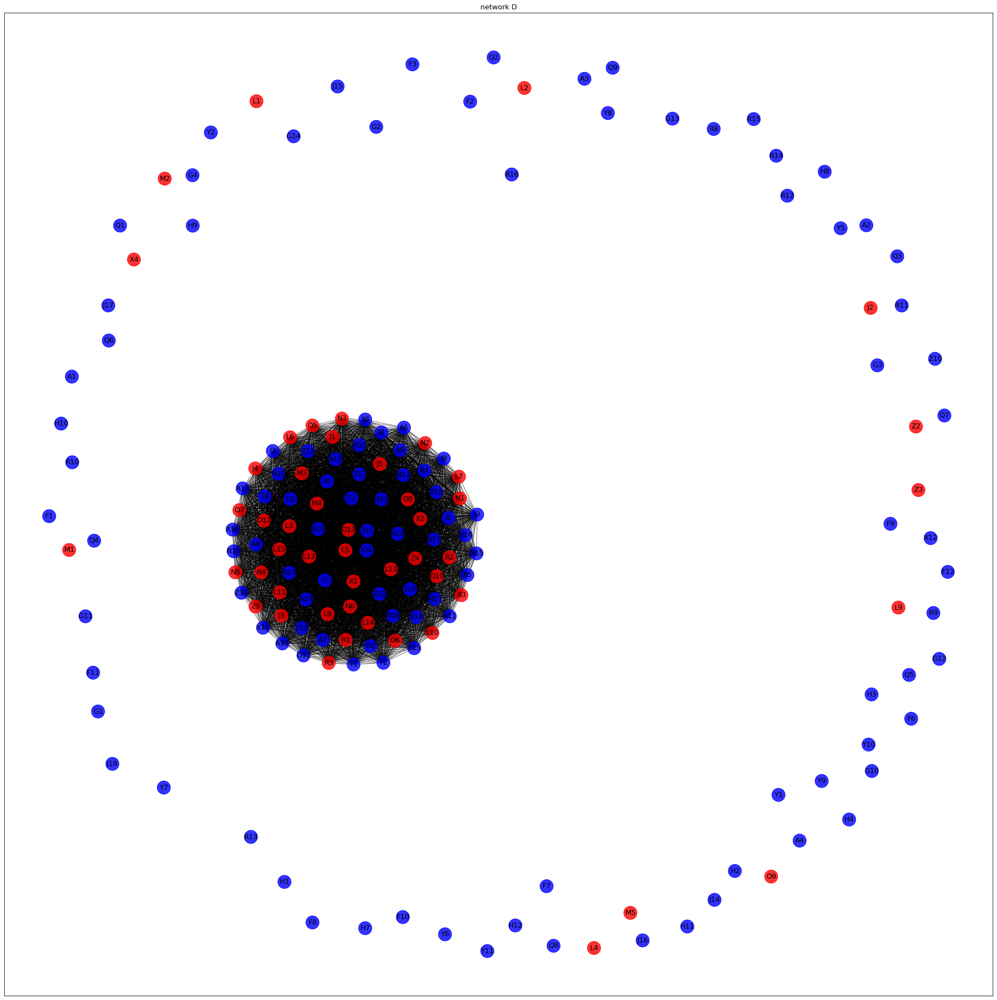

In [23]:
show_graph(D,'D')

NameError: name 'i' is not defined

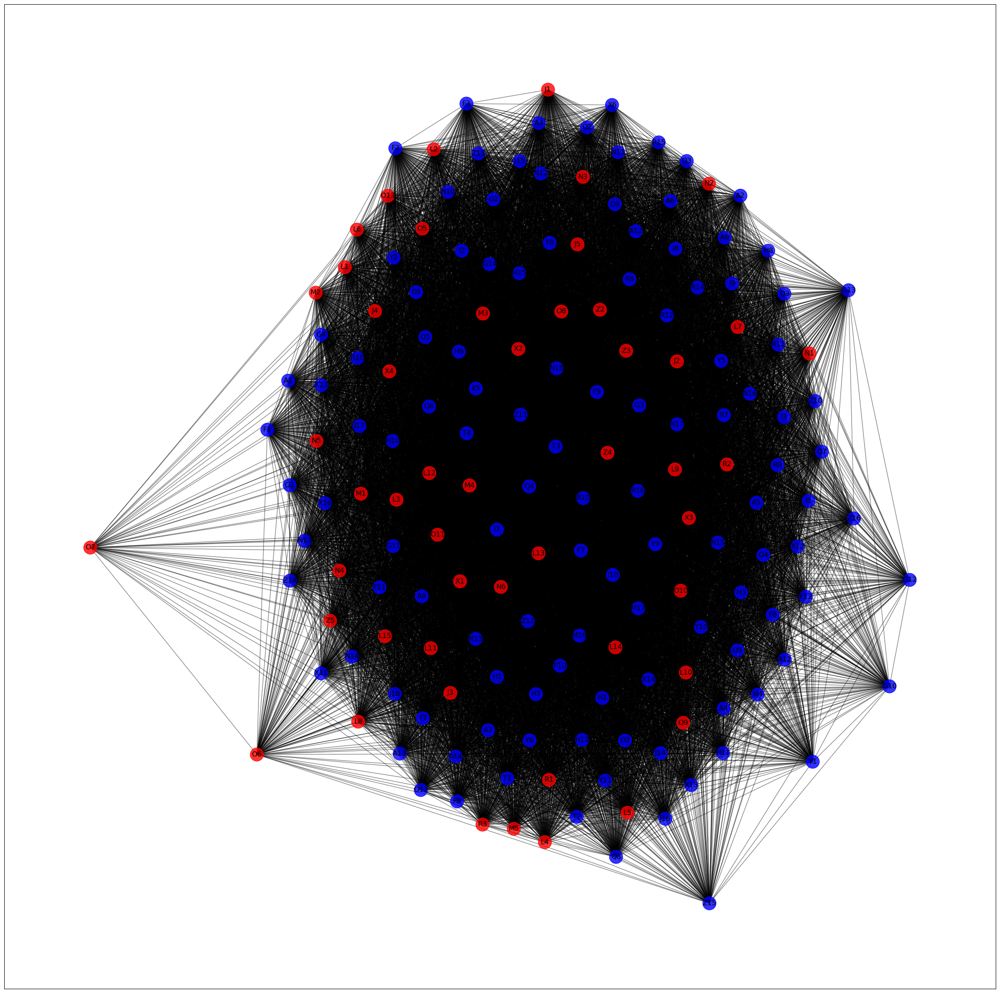

In [24]:
show_graph_weight(A, 'A')


NameError: name 'i' is not defined

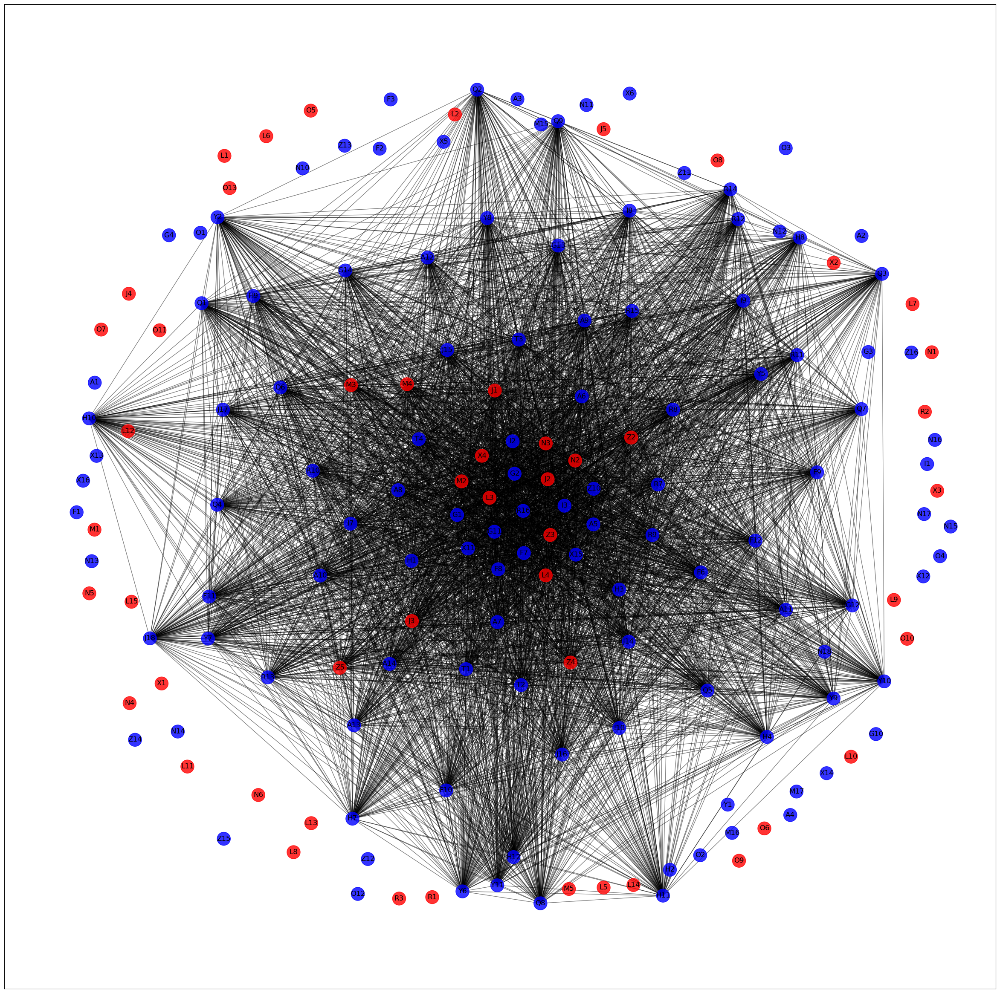

In [25]:
show_graph_weight(F, 'F')

In [26]:
K=new_graph()
ranges = [(3, 7), (12, 150)]
aggiungi_archi_ranges(K, 0.5, ranges)
# Definisci i range all'esterno della funzione
ranges = {
    'delta': (0.4, 4),
    'delta2': (3, 7),
    'teta': (4, 8),
    'alpha': (8, 13),
    'beta': (13, 30),
    'beta1': (12.5, 22.5),
    'gamma1': (30, 50),
    'gamma2': (50, 70),
    'gamma3': (70, 90),
    'gamma4': (90, 150),
    'gamma': (30, 150)
}

# Esempio di utilizzo
L = new_graph()

# Itera su tutte le coppie di file
for file1, file2 in itertools.combinations(total_files, 2):
    # Salta i file non .csv
#     if not (file1.endswith('.csv') and file2.endswith('.csv')):
#         continue
#     if file1.endswith('.ipynb_checkpoints.csv') or file2.endswith('.ipynb_checkpoints.csv'):
#         continue
   # Determina i percorsi dei file
    if file1 in files:
        file_path1 = os.path.join(folder_path, file1 + '.csv')
    else:
        file_path1 = os.path.join(folder_path_N, file1 + '.csv')

    if file2 in files:
        file_path2 = os.path.join(folder_path, file2 + '.csv')
    else:
        file_path2 = os.path.join(folder_path_N, file2 + '.csv')
#     print(f"File path 1: {file1}")
#     print(f"File path 2: {file2}")
    
    # Itera su ciascun valore di range e richiama la funzione legame_ampiezze
    for range_name, (lower_bound, upper_bound) in ranges.items():
        #print(f"Range: {range_name}")
        count = legame_ampiezze_bw(file_path1, file_path2, threshold=0.5, amplitude_threshold=0.3, lower_bound=lower_bound, upper_bound=upper_bound)
        #print(f"Count for {range_name}: {count}")

        if count >= 1:
            L.add_edge(file1, file2, weight=count)


count 0
count 0
0.3136236086945976
0.10967424953643323
count 1
count 1
0.06698001392133612
0.2008125691836682
count 1
0.11844138732267773
0.17266756638511982
count 2
count 2
0.4824682535059619
0.22884475567847584
count 1
count 1
0.4824682535059619
0.22884475567847584
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.33381204437672896
0.07131549361187006
count 1
count 1
0.035862638277890824
0.2531017201983774
count 1
0.2934278121366294
0.133911343999098
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21178951660534828
0.07613442239251089
count 1
count 1
0.2677092466176596
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08894565692131629
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22057579629439505
count 0
0.3074426883274075
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4494629905546397
0.16935751907289465
count 1
co

0.09515695393963597
0.08003666554744449
0.20976218190771156
count 1
count 1
0.20146874774764711
0.14776795335530568
count 1
count 1
0.20146874774764711
0.14776795335530568
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.07542970657700332
0.01700140134570649
count 1
count 1
0.07542970657700332
0.01700140134570649
count 1
0.20311930560712632
count 1
0.20311930560712632
0.2372741172881856
count 0
0.28196209691511953
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.43049402562519123
0.04409137365767091
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4221044382480823
0.14780313591389316
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3945954871356401
0.21439755547487316
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.16696229039215504
0.0863984202098056
count 1
count 1
0.16696229039215504
0.0863984202098056
count 1
0

0.34786239767562677
0.0193277739745632
count 1
0.2899131175303822
0.12950351245870728
count 2
count 2
0.09607588188331206
0.0664808508430923
0.09028222295501553
count 1
count 1
0.17954034748849423
0.12832705673630684
count 1
0.3513469953413395
0.27325834879820654
count 2
count 2
0.17954034748849423
0.12832705673630684
count 1
0.3513469953413395
0.27325834879820654
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.2898678568700168
0.0792798991574637
count 1
count 1
0.2898678568700168
0.0792798991574637
count 1
count 1
count 0
0.4884961393447398
0.2445480435328733
count 0
0.4884961393447398
0.2445480435328733
count 0
count 0
count 0
count 0
count 0
count 0
0.04613526953637992
0.13095029850700968
count 1
count 1
0.04613526953637992
0.13095029850700968
count 1
0.21075511321115759
0.16923864786118248
count 2
count 2
0.21075511321115759
0.16923864786118248
count 1
0.26719944983930777
0.12658738662898927
count 2
count 2
0.48623531477231197
count 0
count 0
count 0
count 0
count

count 0
0.16011142959631908
0.06817799596560636
count 1
count 1
0.16011142959631908
0.06817799596560636
count 1
0.012890106624348086
0.2542315827369883
count 2
count 2
count 0
0.476017299567971
count 0
0.476017299567971
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2912761310474554
0.0342557390438305
count 1
count 1
0.2912761310474554
0.0342557390438305
count 1
0.15497989172565596
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.34035670969477394
0.3973307635630601
0.2981854380053477
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.31751739949573476
0.03091846784390473
count 1
count 1
0.31751739949573476
0.03091846784390473
count 1
0.2539752989201798
count 1
0.3851183272613117
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3072955644913984
0.10518654070780542
count 1
count 1
0.3072955644913984
0.10518654070780542
count 1
0.3138980225601813
count 1
0.01934181133968593

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.03350922508908827
0.1239788565775175
count 1
count 1
0.03350922508908827
0.1239788565775175
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.13499992173536768
0.17179439637409732
count 1
count 1
0.13499992173536768
0.17179439637409732
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.25656629230262595
0.2501090309391484
count 1
count 1
0.25656629230262595
0.2501090309391484
count 1
0.020188435682131356
0.1809897431483033
count 2
count 2
0.0311173756434453
0.05228915101470921
count 1
0.17498642481395166
0.03875622238602183
count 2
count 2
0.16538125960372163
0.18882060519101973
count 1
count 1
0.16538125960372163
0.18882060519101973
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.2738756039550969
0.1539758083503946
count 1
count 1
0.2738756039550969
0.1539758083503946
count 1
0.10183409208924932
0.03353982714

count 0
count 0
0.15410532720586012
0.2046907250889305
count 1
count 1
0.15410532720586012
0.2046907250889305
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3183847671193689
0.24186980016961634
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.061320909686577885
0.01290470840259239
count 1
count 1
0.061320909686577885
0.01290470840259239
count 1
0.0404316539002787
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.28941595679695986
0.23874676508973358
count 1
count 1
0.28941595679695986
0.23874676508973358
count 1
0.005427453595047815
0.045048889332732434
count 2
count 2
0.3997395598561315
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.23352892990610563
0.2388919540912332
count 1
count 1
0.23352892990610563
0.2388919540912332
count 1
0.02250967383258029

count 0
count 0
count 0
count 0
count 0
0.3559974517027662
count 0
0.3559974517027662
0.07441966619117046
0.08657603661861113
count 1
count 1
0.029154579938362346
0.17682720016217424
count 1
0.3689276042023337
0.25285238228802065
count 2
count 2
0.28545086712728995
0.17395030769007302
count 1
count 1
0.28545086712728995
0.17395030769007302
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.005857679777089508
0.03839800874555799
count 1
count 1
0.005857679777089508
0.03839800874555799
count 1
0.03851284889131623
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.13305030172276755
0.1611371278496626
count 1
count 1
0.4691589557171518
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.42001593233125334
count 0
0.4655475606845272
0.025094599571843013
count 1
count 1
0.4655475606845272
0.025094599571843013
count 

count 0
count 0
count 0
count 0
count 0
count 0
0.015124433350453437
count 0
0.015124433350453437
0.4944904277610771
0.12233842456619481
count 1
count 1
0.4568214255417935
0.17423879493796157
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09953826788071218
0.26226807349897374
count 1
count 1
0.09953826788071218
0.26226807349897374
count 1
0.16821872426052042
0.22512435303555745
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.16880094940048984
0.20427213423364599
count 1
count 1
0.16880094940048984
0.20427213423364599
count 1
0.17560896234153134
0.18116306776372781
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2336024167873818
0.26712749111041845
count 1
count 1
0.2336024167873818
0.26712749111041845
count 1
0.10366150269417052
0.01996197252291676
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.28613931988421015
0.205396331811583
coun

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22169500540482634
count 0
0.22169500540482634
0.12849311873928748
0.1700951400715459
count 1
count 1
0.0201361643610678
0.17756370280724898
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2258241391327349
count 0
0.2258241391327349
0.16589725752860662
0.14978029351531752
count 1
count 1
0.10569472436185734
0.10757963986052221
count 1
0.25434926313684336
0.29915516798478325
count 2
count 2
0.3392231870237232
0.050710549011305395
count 1
count 1
0.3392231870237232
0.050710549011305395
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.2930988553795144
count 0
0.2930988553795144
0.10935841168814076
0.1412028426113484
count 1
count 1
0.0971913261164179
0.16786112266168463
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.03567941205062475
0.02319733640653876
count 1
count 1
0.03567941205062475
0.02319733640653876
count 1
0.1380456588041019
0.289

count 0
count 0
count 0
count 0
0.21854025309628078
0.08822670015448164
count 1
count 1
0.21854025309628078
0.08822670015448164
count 1
0.03623544173125204
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1144528638788378
0.2839841025257882
count 1
count 1
0.1144528638788378
0.2839841025257882
count 1
0.03541286354108664
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3245490731046301
count 0
0.3245490731046301
0.21051185370569492
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1512557406485895
0.1995101800477831
count 1
count 1
0.1512557406485895
0.1995101800477831
count 1
0.09581353686952365
0.07746051221724759
count 2
count 2
0.07713386863360405
0.07712849210072292
count 1
0.05028125497734415
0.0945218101387102
count 2
count 2
0.06772071440048144
0.15315089465403542
count 1
count 1
0.06772071440048144
0.15315089465403542
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.12770

0.20835063156337874
0.023853175964959727
count 1
count 1
0.20835063156337874
0.023853175964959727
count 1
0.08600020192736935
0.052053756267558926
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.44903456610719594
0.05867979724137928
count 1
count 1
0.2807315413779552
0.16685016901800676
count 1
count 1
0.2807315413779552
0.16685016901800676
count 1
0.03655504661267539
count 1
0.25450126747436563
0.03968890406001435
count 1
count 1
0.1100393372900399
0.10018498832650202
count 1
0.43695997801711073
0.03155535013446187
count 2
count 2
0.1100393372900399
0.10018498832650202
count 1
0.43695997801711073
0.03155535013446187
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.3960038717496337
0.13854579079133889
count 1
count 1
0.3960038717496337
0.13854579079133889
count 1
0.07257634344012587
count 1
0.24548005446513166
0.09080378869551353
count 1
0.16920636122366872
0.13890140554834662
count 2
count 2
0.11447782067021706
count 0
0.1144778206702

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.30016630108080555
0.16372600561917672
count 1
count 1
0.30016630108080555
0.16372600561917672
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4832949064404417
0.28297007004377694
count 1
count 1
count 0
0.15832954394725363
0.06527922145102405
count 1
count 1
0.15832954394725363
0.06527922145102405
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.07211151008333605
0.25725482882951145
count 1
count 1
0.07211151008333605
0.25725482882951145
count 1
0.17599468666397033
0.28197527495128427
count 2
count 2
0.49708782894068726
0.22160041256926988
count 1
0.4812678473547951
0.2827159049454071
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3304279143152433
0.1824152162859224
count 1
count 1
0.3304279143152433
0.1824152162859224
count 1
0.08173589148486382
count 1
0.33932356728067425
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0

count 0
count 0
count 0
0.17900474238675068
count 0
0.07747989929136612
0.04465548860605473
count 1
count 1
0.07747989929136612
0.04465548860605473
count 1
0.05107951703575875
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.41649904587808084
0.11318852602262641
count 1
count 1
0.2716907256530794
0.12908992487924553
count 1
count 1
0.2716907256530794
0.12908992487924553
count 1
0.47430199207894574
count 1
0.4879388011852388
0.34922521975191323
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15702802442191377
0.012159042559825362
count 1
count 1
0.15702802442191377
0.012159042559825362
count 1
0.14803028857838907
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.47167981164369266
0.007088384992847807
count 1
count 1
0.08776534290213611
0.045836896705502395
count 1
count 1
0.08776534290213611
0.045836896705502395
count 1
0.15542052665939998
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.

count 0
count 0
count 0
0.4515923610793453
0.11898969682121407
count 1
count 1
0.3147027822203423
count 0
0.3147027822203423
0.047506792808247766
count 0
0.19156911017691414
0.03991456428934814
count 1
count 1
0.45782379289896724
0.03563729321692488
count 1
0.05934634106843362
0.059400722872561096
count 2
count 2
0.45782379289896724
0.03563729321692488
count 1
0.05934634106843362
0.059400722872561096
count 2
count 2
count 0
count 0
count 0
count 0
count 0
0.43349613683919497
0.0990460746493591
count 1
count 1
0.2955674620063018
count 0
0.2955674620063018
0.08904230810800495
count 0
0.39633526046510426
0.017001774534355363
count 1
count 1
0.35773390609323563
0.07808099974529892
count 1
0.3359902924426521
0.026504356540193008
count 2
count 2
0.35773390609323563
0.07808099974529892
count 1
0.3359902924426521
0.026504356540193008
count 2
count 2
count 0
count 0
count 0
count 0
count 0
0.4552890827930587
0.08821817003794497
count 1
count 1
0.34495836209675446
count 0
0.34495836209675446
0.0

0.4389822712687357
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.103783924873317
0.015513175956404446
count 1
count 1
0.0035011729714113926
0.06747676447906503
count 1
count 1
0.0035011729714113926
0.06747676447906503
count 1
0.294586613383621
0.1049192895557659
count 2
count 2
0.3566549035389759
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.271468502114641
0.15301872599839594
count 1
count 1
0.271468502114641
0.15301872599839594
count 1
0.008786279689046772
0.2896551337335138
count 2
count 2
0.03973344170974791
0.19556343645183105
count 1
0.05706086546779865
0.10698946366921547
count 2
count 2
count 0
0.05706086546779865
0.10698946366921547
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.10720989079699272
0.27955906821054555
count 1
count 1
0.10720989079699272
0.27955906821054555
count 1
0.06953613197809361
0.2081515868135151
count 2
count 2
0.11040921770466028
0.15164756930524437
count 1
count 1
count 0
count 0

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4684091846759135
0.0033247689242914547
count 1
count 1
0.055356536531061984
0.23459994229581582
count 1
count 1
0.055356536531061984
0.23459994229581582
count 1
0.25090653715173783
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08283359851752703
0.07325271906825392
count 1
count 1
0.08283359851752703
0.07325271906825392
count 1
0.05260649227422842
0.27908526626086605
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.19475105815418736
0.2862473818704041
count 1
count 1
0.19475105815418736
0.2862473818704041
count 1
0.05211483412558149
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09721253272953145
0.23417106197939752
count 1
count 1
0.09721253272953145
0.23417106197939752
count 1
0.05331324582713837
0.25786189892491773
count 2
count 2
0.034693566745030324
0.09882311923539522
count 1
0.266358605079402
0.0339468145

count 0
count 0
count 0
count 0
0.2680179241780074
0.1155777996048366
count 1
count 1
0.2680179241780074
0.1155777996048366
count 1
0.14034694098056555
count 1
0.2059135053117238
0.29627261768846314
count 1
0.2635861671211899
0.08709854141681728
count 2
count 2
count 0
0.2635861671211899
0.08709854141681728
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3648720194980246
0.0905541171923554
count 1
count 1
0.3648720194980246
0.0905541171923554
count 1
0.031216209633518233
0.19467695499358495
count 2
count 2
0.1344696951781561
0.2405703438975344
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.36127237866906103
0.135520154039396
count 1
count 1
0.2678977727337788
0.23786112105159773
count 1
0.3162473549986551
0.07343189903228264
count 2
count 2
count 0
0.31

0.052458148174129526
0.1609413417541541
count 1
0.27463362517774215
0.006366187942055568
count 2
count 2
0.2997631621482775
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.17324426306796248
0.15454081864526348
count 1
count 1
0.019554339988363978
0.025093221693324952
count 1
count 1
0.019554339988363978
0.025093221693324952
count 1
0.16153299713299507
0.029796885816867125
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24785872016941113
0.09506013146592718
count 1
count 1
0.13904547261753653
0.1488302792854137
count 1
count 1
0.13904547261753653
0.1488302792854137
count 1
0.19723484720258622
0.2753859408500601
count 2
count 2
0.15968130298940686
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.17864127979986577
0.11154061017091355
count 1
count 1
0.09478921094383708
0.1407887111948085
count 1
count 1
0.09478921094383708
0.1407887111948085
count 1
0.07094301073562193
count 1
count 0
count 0
count 0
count 0
count 0
coun

count 0
0.4556525453799436
0.11080230302219629
count 1
count 1
0.3276490504442835
count 0
0.3276490504442835
0.11339388055183797
count 0
0.2672395097968092
0.1635868530693596
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3237179920639819
0.18019796741734956
count 1
count 1
count 0
0.03975394756823203
count 0
0.1299653252625852
0.03525166372918154
count 1
0.3323856546808983
0.09307204386420231
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09179688984320045
0.0011610219052666793
count 1
count 1
0.2237186853407067
0.26078849855029773
count 1
count 1
0.2237186853407067
0.26078849855029773
count 1
0.4775411889898198
0.08152922659297712
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.06401110332462956
0.11363255278206985
count 1
count 1
0.06401110332462956
0.11363255278206985
count 1
0.16843651739329335
0.0036659331625230607
count 2
count 2
0.048025759868142615
0.21925478271666865
count 1
count 

count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.18783873176993016
0.04151895680940143
count 1
count 1
0.06662562611564393
0.2895123624358167
count 1
count 1
0.06662562611564393
0.2895123624358167
count 1
0.28138517765991367
0.21418241843619323
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.23234839177734035
0.05957024204479289
count 1
count 1
0.23234839177734035
0.05957024204479289
count 1
0.1363286438809883
0.20957124713448205
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12826100255989736
0.25532764441609945
count 1
count 1
0.12826100255989736
0.25532764441609945
count 1
0.1371512220711537
0.06740018014692051
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.31074093442357054
count 0
0.31074093442357054
0.38307593931793527
0.09845581228059685
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.16506387932964905


count 0
count 0
count 0
count 0
count 0
count 0
0.27023384075762014
0.007167904595809738
count 1
count 1
0.27023384075762014
0.007167904595809738
count 1
0.20263418788260434
count 1
0.006211297018319684
0.27956639439484743
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.35705474871591747
0.12324905305367118
count 1
count 1
0.35705474871591747
0.12324905305367118
count 1
0.2691020127007837
count 1
0.3709077538364358
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22473112537508655
0.030934131693160616
count 1
count 1
0.22473112537508655
0.030934131693160616
count 1
0.07588210436377807
0.1369623382906059
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22193841906522227
0.10479558514812393
count 1
count 1
0.22193841906522227
0.10479558514812393
count 1
0.084271691740887
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.16009081269616132
0.1639569780658423
c

count 0
count 0
0.270306197453027
0.25695821277417963
count 1
count 1
0.270306197453027
0.25695821277417963
count 1
0.05150084425587664
0.1399795577546329
count 2
count 2
0.4951630795459181
0.04620092428501721
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3494189411118862
0.008439665755533454
count 1
count 1
0.3494189411118862
0.008439665755533454
count 1
0.23917668014966154
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2756775433641856
0.13172034343781402
count 1
count 1
0.2756775433641856
0.13172034343781402
count 1
0.24880684984526624
count 1
0.1746204952439374
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2219271143283601
0.22283975535847045
count 1
count 1
0.2219271143283601
0.22283975535847045
count 1
0.13944425693015905
count 1
0.1052745163932336
0.200796952110033
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22959615752856521
0.2995942902190176

count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1530128483285953
0.03174018205103313
count 1
count 1
0.1530128483285953
0.03174018205103313
count 1
0.2519259347428715
0.003941497789559878
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22257907449221204
0.1755056408300817
count 1
count 1
0.22257907449221204
0.1755056408300817
count 1
0.46634100542124113
0.1652300999330566
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2094774809635762
0.26711682153426697
count 1
count 1
0.2094774809635762
0.26711682153426697
count 1
0.45792585995821256
0.2656294378913263
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2397861299957711
0.17551058427353272
count 1
count 1
0.2397861299957711
0.17551058427353272
count 1
0.3144687968900808
0.12888117438382973
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4000626247267247
0.109500

count 0
0.25398569379690716
0.13065597177132215
count 1
count 1
0.025554615457997087
0.24263649652240282
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21640404795015478
0.15247432874193934
count 1
count 1
0.11544977317216798
0.2128338216266652
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05856058029831601
0.15657321291290494
count 1
count 1
0.05856058029831601
0.15657321291290494
count 1
0.01925527660909676
0.22803953133060062
count 2
count 2
0.4085304837974615
0.10160814954707931
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15148348438596582
0.18355600824742702
count 1
count 1
0.15148348438596582
0.18355600824742702
count 1
0.07430952017902914
0.2088616838612819
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.002895645201427044
0.11875628126039217
count 1
count 1
0.002895645201427044
0.11875628126039217
count 1
0.03701608938448

count 0
count 0
0.20443326899879022
0.11522736333989414
count 1
count 1
0.20443326899879022
0.11522736333989414
count 1
0.10746127724806787
0.1643912570835493
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15651242904631602
0.20564780744092914
count 1
count 1
0.15651242904631602
0.20564780744092914
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22533695471916637
0.014245506419975129
count 1
count 1
0.2309081542939797
0.03985864473728373
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05891380784612199
0.01194762605059374
count 1
count 1
0.05891380784612199
0.01194762605059374
count 1
0.13347946630048124
0.09060869897635371
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.28700885495650397
0.23778968273773493
count 1
count 1
0.2870088

count 0
count 0
count 0
count 0
count 0
0.0034505779366336142
0.03744092639355934
count 1
count 1
0.0034505779366336142
0.03744092639355934
count 1
0.13156066129151878
0.11778280490605741
count 2
count 2
0.1661800636019759
0.10070918123663208
count 1
0.20652530165339122
0.01989092225239819
count 2
count 2
count 0
0.20652530165339122
0.01989092225239819
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.040002489322565005
0.09497817873992886
count 1
count 1
0.0947362534684082
0.04500690744570335
count 1
count 1
count 0
0.4774109404034217
0.023474207027381233
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3700586583581078
0.15413497969411782
count 1
count 1
0.2281643310240309
0.04229768459976668
count 1
0.25918648953085643
0.033557564636932824
count 2
count 2
count 

0.25124990424033644
0.21620348177873172
count 1
count 1
0.25124990424033644
0.21620348177873172
count 1
0.21756554509091508
0.16429485337847716
count 2
count 2
0.11702318058853045
0.11402688654480819
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.253228219761767
0.17700332990139855
count 1
count 1
0.253228219761767
0.17700332990139855
count 1
0.30190968529109075
0.037599576601946794
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.23460922252798788
0.16254876432021703
count 1
count 1
0.23460922252798788
0.16254876432021703
count 1
0.0422118427666236
0.17500916353910334
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.25161058713640383
0.11876977616485362
count 1
count 1
0.25161058713640383
0.11876977616485362
count 1
0.28155248430727653
0.06681509090342175
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.16861957479853018


count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.031814639897667085
count 0
0.3708337297907267
0.11132573268438062
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.06939628574441947
count 0
0.2809385720765558
0.081523057788643
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.32652790944154564
0.06392227756455604
count 1
count 1
0.32652790944154564
0.06392227756455604
count 1
0.2665450570854775
0.04330368715285271
count 2
count 2
0.012142138548737691
0.029702614290942897
count 1
0.2446613327400371
0.10341601749132501
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.41945081352919544
0.03693948223003396
count 1
count 1
0.41945081352919544
0.03693948223003396
count 1
0.2114908135155451
0.02412583968353399
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.27086297434465667
0.1017392092170688
count 1
count 1
0.27086297434465667
0.1017392

count 0
0.13412357747005998
0.047091106719823195
count 1
count 1
0.13412357747005998
0.047091106719823195
count 1
0.147014543052026
0.0672580405000236
count 2
count 2
0.16023237829906734
0.08377451188387042
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.31976458506551175
0.13848796826274334
count 1
count 1
0.31976458506551175
0.13848796826274334
count 1
0.21180187796762162
0.17211224589635243
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09166953795512978
count 0
0.09166953795512978
0.17679767766239074
0.12956287033686031
count 1
count 1
0.04535891838752448
0.14384000841290057
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.147556564845984
count 0
0.147556564845984
0.14886055023476263
0.21737388452110906
count 1
count 1
0.029103307469842576
0.0970286361148407
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05808271700249179
0.158060244302445

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.447652402743846
0.13310940263750393
count 1
count 1
0.447652402743846
0.13310940263750393
count 1
0.2917362466909674
0.0726314327741191
count 2
count 2
0.15748855502911852
0.08621355174635337
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.052407692366127634
0.11843746196978788
count 1
count 1
0.052407692366127634
0.11843746196978788
count 1
0.3675533464134446
0.07362622786661177
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.454947116764707
0.19327707451337695
count 1
count 1
0.454947116764707
0.19327707451337695
count 1
0.2732945512343381
0.1840261924282638
count 2
count 2
0.07465753531953645
0.08262096182221867
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3142774094418064
0.23766615472957842
count 1
count 1
0.3142774094418064
0.23766615472957842
count 1
0.053226721202764615


count 0
count 0
count 0
0.12638151512240525
0.08701916988622571
count 1
count 1
0.14406917038364586
0.03600842210806743
count 1
count 1
0.14406917038364586
0.03600842210806743
count 1
0.12053425443376398
0.25651271045910207
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.27125103554918795
0.07212397636287449
count 1
count 1
0.12706780577522991
0.24531011837700323
count 1
count 1
0.12706780577522991
0.24531011837700323
count 1
0.3598748959744169
0.014688456016576978
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3312723028402831
0.09970209526931484
count 1
count 1
0.1294666515226366
0.14574315585889597
count 1
count 1
0.1294666515226366
0.14574315585889597
count 1
0.24694198646567056
0.16856991742058636
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3033121806549881
0.09491224821339028
count 1
count 1
0.34387947183748224
0.08657706128472498
count 1
count 1
0.34387947183748224
0.086577

count 0
count 0
count 0
count 0
count 0
count 0
0.4343368468558557
count 0
0.4343368468558557
0.14771869741155985
0.2557066259996885
count 1
count 1
0.3516143480714682
0.03760719064205631
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.052150483470088105
0.19046261977670564
count 1
count 1
0.052150483470088105
0.19046261977670564
count 1
0.34486746875261787
0.12480723407285144
count 2
count 2
0.05853363744617468
0.07361848143752958
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09760119216637086
0.2843365863520777
count 1
count 1
0.0407724206175617
0.16347982444218356
count 1
count 1
0.0407724206175617
0.16347982444218356
count 1
0.2898132251826855
0.10562938660353272
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.06898276541259762
0.03804232837916466
count 1
count 1
0.10781541856697707
0.2282795514292184
count 1
count 1
0.10781541856697707
0.2282795514292184
count 1
0.40113883474619527
0.08

count 0
count 0
count 0
count 0
count 0
count 0
0.10291788721154038
count 0
0.10291788721154038
0.22507072479373402
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1588049141023946
count 0
0.1588049141023946
0.19713359736610592
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.046834367746081185
0.13416278036636609
count 1
count 1
0.046834367746081185
0.13416278036636609
count 1
0.04109451439567291
0.039928039883842636
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.06310170352234135
0.06885658985080934
count 1
count 1
0.06310170352234135
0.06885658985080934
count 1
0.13309735804230094
0.07827696910565773
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.028998238342568206
0.06877791619522355
count 1
count 1
0.20129183857093036
0.23020381307837123
count 1
count 1
0.20129183857093036
0.23020381307837123
count 1
0.06520268683520847
0.1626616374234606

0.3022730012767276
0.0002951964658111095
count 1
count 1
0.3022730012767276
0.0002951964658111095
count 1
0.06802245986638855
0.2062456146290037
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05852484375366007
0.2542452542529583
count 1
count 1
0.05852484375366007
0.2542452542529583
count 1
0.10818622452897397
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22648064247695565
count 0
0.22648064247695565
0.03417852580338998
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.10524654976669279
count 0
0.10524654976669279
0.22517816278099279
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0991958444823533
0.2938816207903354
count 1
count 1
0.0991958444823533
0.2938816207903354
count 1
0.24934063643254145
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0903522436226023
0.21258275698353746
count 1
count 1
0.090352243622

count 0
0.19223660308417312
0.17914692805723753
count 1
count 1
0.19223660308417312
0.17914692805723753
count 1
0.4136177863047523
0.26386193528412516
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1206972418024943
0.22417345085287899
count 1
count 1
0.1206972418024943
0.22417345085287899
count 1
0.1599949614242684
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.13091907680683068
0.2984415237167797
count 1
count 1
0.13091907680683068
0.2984415237167797
count 1
0.2199176850642699
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21194023632064596
count 0
0.21194023632064596
0.1702879776140085
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2285578346038415
count 0
0.2285578346038415
0.18050793680463872
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1491586951704269
0.08130131725069045
count 1
count 1
0.149158695

count 0
count 0
count 0
0.2717522322632173
count 0
0.154050967994122
0.08407578428954654
count 1
count 1
0.154050967994122
0.08407578428954654
count 1
0.1201629864782836
0.11410821442662122
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.10254900092196984
0.08049494727783735
count 1
count 1
0.10254900092196984
0.08049494727783735
count 1
0.023394728055269987
0.1351327466653114
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.33985012496325906
count 0
0.26827176658366625
count 0
0.26827176658366625
0.12166180572365537
0.13974391796702257
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.16418437736622327
0.11467966529755458
count 1
count 1
0.16418437736622327
0.11467966529755458
count 1
0.12083922753348997
0.2819149849545841
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.27481755961724463
0.03404183501899549
count 1
count 1
0.27481

count 0
count 0
count 0
count 0
0.20648374550483606
count 0
0.20648374550483606
0.10015853777744788
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.49510782281705
count 0
0.49510782281705
0.0074858499703376324
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24107085652529125
count 0
0.24107085652529125
0.0755716354124969
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.18379401490644298
0.06050187919525296
count 1
count 1
0.18379401490644298
0.06050187919525296
count 1
0.4772782405825309
0.13967596074770233
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08671178222024256
count 0
0.08671178222024256
0.0739513424871614
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.13470318672729054
0.2877690186541608
count 1
count 1
0.13470318672729054
0.2877690186541608
count 1
0.056935305194856234
count 1
count 0
count 0
coun

count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.13749685638952158
count 0
0.13749685638952158
0.2408468906518033
0.23953155974962037
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07269538900262962
count 0
0.07269538900262962
0.1688994310044425
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.02015848590580127
count 0
0.02015848590580127
0.11580705398418267
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08166075852533528
count 0
0.08166075852533528
0.12336639256320936
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05264079970921909
count 0
0.05264079970921909
0.1897556610009845
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.050662484187788515
count 0
0.050662484187788515
0.2740998012011602
0.2021788975257035
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.024951807

count 0
count 0
0.12010191042248941
count 0
0.12010191042248941
0.20923485417614351
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08099264695728614
count 0
0.08099264695728614
0.2373014447207904
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.11473993812796301
count 0
0.11473993812796301
0.07022372541135713
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.004004755807736515
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0415864016544889
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.02263720549199011
0.2134340968007491
count 1
count 1
0.02263720549199011
0.2134340968007491
count 1
0.23873517299554692
0.121275633770904
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2489345151627833
count 0
0.11556010957963991
0.18645130146622702
count 1
count 1
0.11556010957963991
0.

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.012811804355740586
0.06555696689522428
count 1
count 1
0.045608118054608404
0.24211591574739177
count 1
count 1
0.045608118054608404
0.24211591574739177
count 1
0.10411383283523445
0.18541088373825598
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.024840430710428185
0.01816064730542344
count 1
count 1
0.15752557769126874
0.029121252945241594
count 1
count 1
0.15752557769126874
0.029121252945241594
count 1
0.0006074935645754564
0.03891251259207795
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05998705226661283
0.08119757283624818
count 1
count 1
0.05998705226661283
0.08119757283624818
count 1
0.001805905266132335
0.2066342510742043
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.29854325688787675
0.11898472826419759
count 1
count 1
0.29854325688787675
0.11898472826419759
count 1
0.016892586851029456
0.2

count 0
count 0
count 0
count 0
count 0
0.26093027028301474
count 0
0.26093027028301474
0.05586164311054986
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.25487956499867526
count 0
0.25487956499867526
0.08002411676209853
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24603596413892426
0.224494859652558
count 1
count 1
0.24603596413892426
0.224494859652558
count 1
0.026616260364027866
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3040305049445342
0.1258871865205311
count 1
count 1
0.3040305049445342
0.1258871865205311
count 1
0.29458011707849163
0.21959730268872324
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.38314324860339344
count 0
0.38314324860339344
0.0039025926729534532
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.30940185085569283
count 0
0.30940185085569283
0.0057275770226512535
count 0
count 0

count 0
count 0
count 0
count 0
0.30484241568674886
0.093213419919711
count 1
count 1
0.30484241568674886
0.093213419919711
count 1
0.040484221813053445
0.27606854855192253
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2000363680329471
0.09028152682843604
count 1
count 1
0.2000363680329471
0.09028152682843604
count 1
0.10874016552507815
0.1792515613163026
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2501876626210633
0.2392818578212097
count 1
count 1
0.2501876626210633
0.2392818578212097
count 1
0.015997042179349386
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.10846053102297759
0.1508492227600513
count 1
count 1
0.10846053102297759
0.1508492227600513
count 1
0.06972280967690736
0.28376666826647323
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.11587361375208172
0.07175845443343754
count 1
count 1
0.11587361375208172
0.0

count 0
count 0
count 0
count 0
count 0
count 0
0.06173822669710116
count 0
0.06173822669710116
0.22071833419783893
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12498571714706586
0.062147384364242164
count 1
count 1
0.12498571714706586
0.062147384364242164
count 1
0.1252006979688698
0.10365550661323386
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22124557443742
0.05728765332435959
count 1
count 1
0.22124557443742
0.05728765332435959
count 1
0.09777335342171156
0.18739677837665258
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.06967821042777622
count 0
0.06967821042777622
0.09938198873779225
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09940450408867552
count 0
0.09940450408867552
0.09631923719284252
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.028258408265942947
count 0
0.028258408265942947

count 0
count 0
count 0
0.1654245674610877
count 0
0.1654245674610877
0.04188786853539739
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.009046955853063032
0.22951739695077222
count 1
count 1
0.009046955853063032
0.22951739695077222
count 1
0.0018245288777185564
0.11248199605198739
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.04435312446762474
count 0
0.04435312446762474
0.11757041596333728
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.10576185224891343
count 0
0.10576185224891343
0.15241715120638855
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24437791967676326
0.1719433164681332
count 1
count 1
0.24437791967676326
0.1719433164681332
count 1
0.11651033390653431
0.020842063324828075
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
cou

count 0
count 0
count 0
count 0
0.09938966850105069
0.0764490182062687
count 1
count 1
0.013219275085408988
0.028046374245643158
count 1
count 1
0.013219275085408988
0.028046374245643158
count 1
0.027161515381639134
0.03638429530821785
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2982428821705425
0.06155382468291748
count 1
count 1
0.0037820895230069596
0.2532721662394275
count 1
count 1
0.0037820895230069596
0.2532721662394275
count 1
0.26650215692229207
0.20543995913430724
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3042804562189285
0.08913194358935783
count 1
count 1
0.26031654682087346
0.15370520372132024
count 1
count 1
0.26031654682087346
0.15370520372132024
count 1
0.15356924741354572
0.05155849773029786
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.27632033403363354
0.08434209653343328
count 1
count 1
0.4747293671357191
0.09453910914714925
count 1
count 1
0.47472936713

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07869941182814877
0.19842466763912991
count 1
count 1
0.07869941182814877
0.19842466763912991
count 1
0.251494729700493
0.09532118107803278
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12459303878772543
0.2949067380320347
count 1
count 1
0.17162231591579857
0.17144187230460783
count 1
count 1
0.17162231591579857
0.17144187230460783
count 1
0.19644048613056064
0.1144990285473515
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.04199091879124306
0.02747217669920765
count 1
count 1
0.0230344767312598
0.23624159929164268
count 1
count 1
0.0230344767312598
0.23624159929164268
count 1
0.30776609569407043
0.139738217444906
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09332135221258708
0.05470064009046638
count 1
count 1
0.05095085474654315
0.11868377079172898
count 1
count 1
0.05095085474654315
0.11868377079172898
count 1


0.16674199029448467
0.2655748468093897
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.31673278768716795
0.045176532382411594
count 1
count 1
0.056805919026062135
0.2678913522513592
count 1
count 1
0.056805919026062135
0.2678913522513592
count 1
0.3575776904560177
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08138421602252688
0.10654412902379728
count 1
count 1
0.08138421602252688
0.10654412902379728
count 1
0.15927764557850832
0.23710308416143366
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1933016756591872
count 0
0.1933016756591872
0.05455631917869841
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0957631502345313
0.2674624719349409
count 1
count 1
0.0957631502345313
0.2674624719349409
count 1
0.05335790747714153
0.21587971682548535
count 2
count 2
0.031580191200120566
0.09862433185178787
count 1
count 1
count 0
count 0
count 0
count 0
count 

count 0
count 0
count 0
0.34628784347271413
0.11957340365271196
count 1
count 1
0.34628784347271413
0.11957340365271196
count 1
0.0970872659519646
count 1
0.030522075560027062
0.03682108004027995
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2056181361498135
0.07518432343651049
count 1
count 1
0.2056181361498135
0.07518432343651049
count 1
0.12298056407960889
count 1
0.40801727889526873
0.013060676294510465
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2309246484510572
0.21253950064671734
count 1
count 1
0.2309246484510572
0.21253950064671734
count 1
0.12035068875055188
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.04044153851164278
0.05782135402235966
count 1
count 1
0.04044153851164278
0.05782135402235966
count 1
0.07865565742069336
0.07329977731252146
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.19334267952022355
0.2511597844510697


count 0
count 0
0.27517563379549026
count 0
0.016790899857873853
0.00930680605254075
count 1
count 1
0.016790899857873853
0.00930680605254075
count 1
0.20402481167585762
0.21007337503213463
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.035409897091652986
count 0
0.035409897091652986
0.05567303084860953
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4036190498686425
0.2893158546528447
count 1
count 1
0.01840853248323704
0.06754035978908568
count 1
count 1
0.01840853248323704
0.06754035978908568
count 1
0.1836676106920434
0.18085786073065968
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.23812592481462946
0.16710732230719294
count 1
count 1
0.23812592481462946
0.16710732230719294
count 1
0.07073470118329706
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4525387451294751
0.22627341688136393
count 1
count 1
0.4525387451294751
0.226273416881363

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4185190392461653
0.017568996593774422
count 1
count 1
0.4185190392461653
0.017568996593774422
count 1
0.17807359812225165
0.06051497862857513
count 2
count 2
0.25913523840555364
0.01882491612259951
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.028548389181114686
0.01129486165020599
count 1
count 1
0.028548389181114686
0.01129486165020599
count 1
0.2791345037461035
0.021498478997238557
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15397349475240407
0.08510360447881393
count 1
count 1
0.15397349475240407
0.08510360447881393
count 1
0.13915986465084096
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1148642312872008
0.020388989612600383
count 1
count 1
0.1148642312872008
0.020388989612600383
count 1
0.16722645519548784
0.28212794430399035
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
co

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1595327071424606
0.041898835948343205
count 1
count 1
0.1595327071424606
0.041898835948343205
count 1
0.45818182765256665
0.11826955303658249
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.02134257209387158
0.11944838727921869
count 1
count 1
0.02134257209387158
0.11944838727921869
count 1
0.25988178277505725
0.033884884718779595
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09057488754278875
0.09354627552293149
count 1
count 1
0.09057488754278875
0.09354627552293149
count 1
0.15516045637524734
0.25820828104911353
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.006963637881867157
0.041469955631924904
count 1
count 1
0.006963637881867157
0.041469955631924904
count 1
0.15396204467369046
0.012661517382831278
count 2
count 2
0.12037625635147897
0.211607760975693
count 1
count 1
count 0
count 0
coun

count 0
count 0
count 0
count 0
count 0
count 0
0.296069467636622
0.0251672681480537
count 1
count 1
0.296069467636622
0.0251672681480537
count 1
0.27966276503958554
0.07200287503126823
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08240653897120964
0.06629218821814398
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.25706200974387716
0.009699092486763483
count 1
count 1
0.4472384352146985
0.06738699813732296
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.16410956691114187
0.14348982845380576
count 1
count 1
0.16410956691114187
0.14348982845380576
count 1
0.21689824508129174
0.14725200923103376
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4491150531417576
0.24504986322806677
count 1
count 1
0.4491150531417576
0.24504986322806677
count 1
0.29090594380687573
0.1826781583683993
count 2
count 2
count 0
count 0
c

count 0
count 0
count 0
0.2536878459685825
0.2919180528775708
count 1
count 1
0.2536878459685825
0.2919180528775708
count 1
0.1646146118600793
0.13633959419676067
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.32325407213219925
0.08467222999645596
count 1
count 1
0.32325407213219925
0.08467222999645596
count 1
0.37902968253844893
0.024949007946736046
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.31015247860356343
0.006938950707729319
count 1
count 1
0.31015247860356343
0.006938950707729319
count 1
0.37061453707542036
0.12534834590500576
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3404611276357583
0.08466728655300493
count 1
count 1
0.3404611276357583
0.08466728655300493
count 1
0.22715747400728858
0.011399917602490817
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4319549137305252
0.06710322119760903
coun

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.044765692674694435
0.06918666934634565
count 1
count 1
0.044765692674694435
0.06918666934634565
count 1
0.20974265594739538
0.2425699295110152
count 2
count 2
0.1504973101414233
0.11986097464526335
count 1
0.258529903216397
0.1682110428617385
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2938099196773849
0.14553312140128583
count 1
count 1
count 0
0.1646436093589907
0.13950001645428944
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2781719110058458
count 0
0.2532255258848588
0.1858045471460663
count 1
count 1
0.2532255258848588
0.1858045471460663
count 1
0.23638089190115075
0.28422439920067344
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.13633300549067817
0.2352791466669384
count 1
count 1
0.30472749295701096
0.021233815578682425
count 1
count 1
0.304727492957

count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.14919434882821658
count 0
0.14919434882821658
0.2876444713426398
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.23819931602794586
count 0
0.37149554678614294
0.06146205080520062
count 1
count 1
0.06166867988044089
count 0
0.06166867988044089
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1290679259751446
count 0
0.12848577515335435
0.1919547435607285
count 1
0.020579456894230574
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08886418812180708
count 0
0.20352699230669202
0.16949538943837894
count 1
0.1761000060493405
count 1
0.42251523063037766
count 0
0.42251523063037766
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.17157416714490648
count 0
0.17628859497352245
0.032878000828400644
count 1
count 1
0.4509916329866357
count 0
0.4509916329866357
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.105106

0.10559100653441611
0.22861407700716008
count 1
0.13120762594333435
0.0951675393337803
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.43478768834380954
0.15159050448440237
count 1
count 1
0.43478768834380954
0.15159050448440237
count 1
0.06999878706342688
0.18616989757216562
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.004008911662157111
0.22159604670953115
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1869907253154457
0.2824888915475583
count 1
count 1
0.25241354334571753
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21115319896699436
0.2584508028388406
count 1
count 1
0.3036960156151256
0.16171632906174072
count 1
count 1
0.3017780090829181
count 0
0.3017780090829181
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1577453425689237
0.23074917981702192
count 1
count 1
0.17720752291719855
0.05454

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12228242028463931
0.17525748253789253
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09213265039373031
0.01396888039439581
count 1
count 1
count 0
0.4735452248921117
0.025710940190124987
count 1
count 1
0.4735452248921117
0.025710940190124987
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08371750493070174
0.08643045756387391
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05973955813743004
0.05031780594362267
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.14505788158580657
0.10602110953874089
count 1
count 1
count 0
0.328315065676529
0.13346715549195842
count 1
count 1
0.328315065676529
0.13346715549195842
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.022812116764197476
0.05024094477153529
count 1
count 1
count 0
0.4

count 0
count 0
0.3009896281062798
0.29389302326994304
count 1
count 1
count 0
0.2998988348484817
0.029662703533829493
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4675735856852483
0.028485891461299317
count 1
count 1
0.37424876427408194
0.1495222655967421
count 1
count 1
0.37424876427408194
0.1495222655967421
count 1
0.41122444441199146
0.004423514636274994
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.300263432796279
0.03196443709682839
count 1
count 1
0.300263432796279
0.03196443709682839
count 1
0.4995867144566164
0.06071334796114147
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4903227560243284
0.01616370459731975
count 1
count 1
0.22884585845026617
0.08303306374629571
count 1
count 1
0.22884585845026617
0.08303306374629571
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3497177177976143
0.016580154660223556
count 1
count 1
count 0


0.028456660080550478
count 0
0.22099823664471963
0.05839892384006273
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08067472997225078
count 0
0.27898308529477767
0.07209376891546515
count 1
0.2791093601106276
0.20201649716580494
count 2
count 2
0.09975555210701437
count 0
0.09975555210701437
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12087846782558831
count 0
0.35402430244811534
0.04963441479311559
count 1
0.4346299092657375
0.18636351621165392
count 2
count 2
0.1274641250704267
count 0
0.1274641250704267
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.03816848880248891
count 0
0.025791284832099137
0.152738975473664
count 1
0.263561478797115
0.012735746291155259
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.10463631362066828
count 0
0.35132776602265636
0.06930598384837794
count 1
count 1
0.2635405129803523
count 0
0.2635405129803523
count 0
count 0
count 0
cou

count 0
count 0
count 0
0.02275193063194969
0.039918962036543104
count 1
count 1
0.40291085348714084
count 0
0.05983113625930159
0.011158698588146443
count 1
count 1
0.05983113625930159
0.011158698588146443
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0014105430195989754
0.015880873327825396
count 1
count 1
0.1531987054737023
0.28157730370700407
count 1
0.4495915934390933
0.03059408184456114
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05199731337847169
0.011820749693993271
count 1
count 1
0.026710212775775233
0.174408544358439
count 1
0.2500056640927628
0.10674421266154077
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21596654333599208
0.20335050693819567
count 1
count 1
count 0
0.3572890820578216
count 0
0.3572890820578216
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0747109810695461
0.24427014939370328
count 1
count 1
count 0
count 0
count 0
coun

count 0
count 0
count 0
count 0
count 0
count 0
0.2934601608780971
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15000309780996535
0.19225212356739252
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.35480053753320195
0.1365488199722743
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1869305391831979
0.1923289847394799
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.25631023633860206
0.007305508942335948
count 1
count 1
0.25631023633860206
0.007305508942335948
count 1
0.16568769289180985
0.1363366280279984
count 2
count 2
0.2709910405872371
0.24245774253133956
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08793513198867409
count 0
0.4544839963688485
0.2079433934365752
count 1
count 1
0.3994884090178932
count 0
0.3994884090178932
count 0
count 0
count 0
count 0


count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.25549774012158455
0.03722223224951726
count 1
count 1
0.25549774012158455
0.03722223224951726
count 1
0.289844058509221
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.18408016577557174
0.15221973309264136
count 1
count 1
0.18408016577557174
0.15221973309264136
count 1
0.37853784015542313
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.40102450126014144
0.144724382746384
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15747691418670673
0.08974602526565256
count 1
count 1
count 0
0.25746678672658785
0.10451657834554862
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4025233205055132
0.1091277

count 0
count 0
count 0
count 0
0.3467694949734206
count 0
0.3467694949734206
0.35481285726901923
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2987780904663726
0.27389035543802365
count 1
count 1
0.2987780904663726
0.27389035543802365
count 1
0.2239262095870016
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24596302545803628
0.2466379917073862
count 1
count 1
0.24596302545803628
0.2466379917073862
count 1
0.0765872809741488
0.27985050313835025
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3241189160687341
count 0
0.3241189160687341
0.22621408954151434
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.48049652767675877
0.23064816289625423
count 1
count 1
0.480496527676

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2927062883276954
0.2518782766972514
count 1
count 1
0.48414376138145165
count 0
0.48414376138145165
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4131308795678259
0.12805008200426293
count 1
count 1
count 0
0.29526347345855086
0.0410460109351094
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.42114970440084765
0.20810066084629497
count 1
count 1
0.48576139400681484
0.2544029321849095
count 1
count 1
0.48576139400681484
0.2544029321849095
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.20824009184994807
0.14073300738735206
count 1
0.49152625308719466
0.04820878497655379
count 2
count 2
0.22922693670894834
0.15483596966680224
count 1
count 1
0.22922693670894834
0.15483596966680224
count 1
0.42167120549045745
0.04689678210340631
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.23620021403524305
0.

0.466509006798562
0.23737236523712468
count 1
count 1
0.466509006798562
0.23737236523712468
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4191991958562895
0.10630170388846061
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.44778045893855345
0.06675105363322231
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12427862741214302
0.05447147630328342
count 1
count 1
0.12427862741214302
0.05447147630328342
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.04423051941231293
0.006655936506703597
count 1
count 1
0.04423051941231293
0.006655936506703597
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.414504916496524
0.127126466905505
count 1
count 1
0.051501967072152155
0.1645707315673839
count 1
count 1
0.051501967072152155
0.1645707315673839
count 1
0.1435577145335536
0.2492409610

count 0
count 0
count 0
0.041963219508365235
count 0
0.041963219508365235
0.026046820273030846
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3843256577080796
count 0
0.3843256577080796
0.06035934931180709
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.32291656610768094
count 0
0.32291656610768094
0.0022773828109379224
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.36053471349895805
count 0
0.36053471349895805
0.02000444870083573
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.11267713650794597
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.39512182451941325
count 0
0.39512182451941325
0.04459135106578671
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.029743046912320992
0.02357390509429358
count 1
count 1
0.029743046912320992
0.02357390509429358
count 1
0.35711525410424727

count 0
count 0
count 0
count 0
count 0
count 0
0.38900276331217665
count 0
0.13389248208832072
count 0
0.13389248208832072
0.004355932494100934
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4014132471794656
count 0
0.07239020946878671
count 0
0.07239020946878671
0.003203406084925753
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.45357950433728833
count 0
0.1014101682849029
count 0
0.1014101682849029
0.0695926745227009
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2792755423555353
count 0
0.10338848380633348
count 0
0.10338848380633348
0.15393681472287657
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24680042438921013
count 0
0.08476948657255434
0.07103883920552256
count 1
count 1
0.08476948657255434
0.07103883920552256
count 1
0.10576102780159058
0.1036783718112746
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15083212628238307
count 0
0.10

count 0
count 0
count 0
count 0
count 0
0.21215084501848258
count 0
0.024379667434592633
0.1027714833997706
count 1
count 1
0.024379667434592633
0.1027714833997706
count 1
0.35189960420166777
0.11301524504525862
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07154580679176847
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.056850608093036215
0.23630032956726055
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.34640702379648225
0.0036358483500258387
count 1
count 1
0.16572276566169641
0.2299421203910238
count 1
count 1
0.16572276566169641
0.2299421203910238
count 1
0.14505653377892536
0.004611171301711181
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.06163537644425343
0.03418471801971723
count 1
count 1
0.06163537644425343
0.03418471801971723
count 1
0.14423395558875995
0.14678223828927273
count 2
count 2
count 0
count 

count 0
0.15531279294957834
count 0
0.15531279294957834
0.19711348591902667
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09346518658051739
count 0
0.09346518658051739
0.16960453480658444
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3328236906359274
count 0
0.3328236906359274
0.0831983652217465
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2714145990355288
count 0
0.2714145990355288
0.14128033172261567
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3090327464268059
count 0
0.3090327464268059
0.12355326583271786
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15526729322333965
0.06971297825704426
count 1
count 1
count 0
0.03088057802560762
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3436198574472611
count 0
0.3436198574472611
0.09896636346776688
count 0
count 0
count 0
count 0
count

0.05057245909869135
0.2471288196500766
count 1
count 1
0.05057245909869135
0.2471288196500766
count 1
0.14833156140928772
0.289304822175092
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.04376393647383603
0.0380279987001213
count 1
count 1
0.0689186735304812
count 0
0.0689186735304812
0.18403341147887886
0.043715767141899065
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.11298137684338139
0.05450847740510767
count 1
count 1
0.024662411856781752
count 0
0.024662411856781752
0.05774157501191457
0.006179971520551497
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12451292664794877
0.14286407980332072
count 1
count 1
0.21887323821849503
count 0
0.21887323821849503
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22188705028047684
0.22409274285127356
count 1
count 1
0.1042105369873294
count 0
0.1042105369873294
0.2568513806260624
0.06043752781247935
count 1
count 

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.43868519273534545
0.25690049713781427
count 1
count 1
0.43868519273534545
0.25690049713781427
count 1
0.32074971371084793
0.19573964221862727
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.48719645583822047
0.2377580113185206
count 1
count 1
0.48719645583822047
0.2377580113185206
count 1
0.08460388054167911
0.21660454726395162
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09722580577316986
0.266621869562501
count 1
count 1
0.09722580577316986
0.266621869562501
count 1
0.37260422132667603
0.2556210468952882
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22265091134445925
count 0
0.22265091134445925
0.2326295822314135
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.18354164787925598
0.2757159975248954
count 1
count 1
0.18354164787925598
0.2757159975248954
count 

count 0
count 0
count 0
count 0
count 0
count 0
0.01773616280142143
0.19845901429885082
count 1
count 1
0.01773616280142143
0.19845901429885082
count 1
0.08247994614521126
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.17489871130337153
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2099238663505476
0.11723916173730842
count 1
count 1
0.2099238663505476
0.11723916173730842
count 1
0.18396509445567677
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.010189621532902038
0.11207987611944137
count 1
count 1
0.010189621532902038
0.11207987611944137
count 1
0.04976476019611731
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.499271794474236
0.2550768691724884
count 1
count 1
0.499271794474236
0.2550768691724884
count 1
0.0003196048814233521
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1088117851713779
count

count 0
count 0
count 0
count 0
count 0
0.11247820596427793
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.45427550610570044
0.28240999740326334
count 1
count 1
0.45427550610570044
0.28240999740326334
count 1
0.00311561304917074
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.46194454930590556
count 0
0.46194454930590556
0.018245554538680153
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.051315207367472304
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.11876957431608925
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4276851266441555
0.07949266310346026
count 1
count 1
count 0
0.14803409345251417
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3460074157395656
0.06040324180823908
count 1
count 1
0.3460074157395656
0.06040324180823908
count 1
0.15870997292147138
count 1
count

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09555921180743088
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.06626640712857323
0.12606293524304846
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3986604523187802
0.2329936304214818
count 1
count 1
0.3986604523187802
0.2329936304214818
count 1
0.0019895365834514678
0.029245948007428524
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4488117469068964
0.08399329942870815
count 1
count 1
0.4488117469068964
0.08399329942870815
count 1
0.12274767112097607
0.18745872334806535
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3070846153088107
0.17242593448986654
count 1
count 1
0.3070846153088107
0.17242593448986654
count 1
0.03702781926471932
0.13376105495759916
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
c

count 0
count 0
0.2962187556296483
0.17081565350229067
count 1
count 1
0.2962187556296483
0.17081565350229067
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.37309564379836146
0.04461708155368793
count 1
count 1
0.37309564379836146
0.04461708155368793
count 1
0.3739860663425869
0.10309015761085227
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08079251873721027
0.04677977998923222
count 1
count 1
0.08079251873721027
0.04677977998923222
count 1
0.015169645322939296
0.2079443630071811
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1473025283731717
0.2726218366763734
count 1
count 1
0.1473025283731717
0.2726218366763734
count 1
0.05017384562817018
0.09373075322603164
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09141550148231747
0.2

count 0
count 0
count 0
0.0753053431135049
0.1459579664560673
count 1
count 1
0.0753053431135049
0.1459579664560673
count 1
0.1737448020877963
0.1754173733767006
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1006118554147486
0.008602789245860443
count 1
count 1
0.1006118554147486
0.008602789245860443
count 1
0.1711149267587393
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08987125452466582
0.27896364391493744
count 1
count 1
0.08987125452466582
0.27896364391493744
count 1
0.12941989542888077
0.05703751029073256
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.32365547255653215
0.030017494558491897
count 1
count 1
0.32365547255653215
0.030017494558491897
count 1
0.32950266422794705
0.0008780368081318102
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.13224643815957116
0.13917310005754402
count 1
count 1
count 0
count 0

count 0
0.3377384835234736
0.011789177118167515
count 1
count 1
0.3377384835234736
0.011789177118167515
count 1
0.32077463788705884
0.1982292577444058
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.36804713255566845
0.07981706014256673
count 1
count 1
0.36804713255566845
0.07981706014256673
count 1
0.17731757481892707
0.061480994236909225
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3821150145421637
0.005777690641791011
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.39715892583548573
0.04339359175555302
count 1
count 1
0.39715892583548573
0.04339359175555302
count 1
0.21424501619215963
0.06155785540899661
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05798381250053897
0.0635412758476468
count 1
count 1
0.05798381250053897
0.0635412758476468
count 1
0.13837321588284812
0.005565498697515103
count 2
count 2
c

count 0
count 0
0.35913817421934624
count 0
0.35913817421934624
0.22659982300134196
0.19779197307462693
count 1
count 1
0.4172367015295553
0.07323814984214749
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4299967626217498
count 0
0.4299967626217498
0.20510870547605098
0.14502593306236922
count 1
count 1
0.3603095012501356
0.06191358919190115
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05627370272553556
0.04984185899242277
count 1
count 1
0.05627370272553556
0.04984185899242277
count 1
0.08805168875978531
0.2295932362232218
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.010473286710802832
0.1519078831098195
count 1
count 1
0.010473286710802832
0.1519078831098195
count 1
0.12975936098059027
0.1149414270755571
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3418531423195219
0.1341231072939184
count 1
count 1
0.3418531423195219
0.134

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24290168820062963
0.040606935313523884
count 1
count 1
0.24290168820062963
0.040606935313523884
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05763225804586547
0.2460182630612291
count 1
count 1
0.05763225804586547
0.2460182630612291
count 1
0.05727311630079601
0.00869814684277781
count 2
count 2
0.2787443700669936
0.03233889828085257
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3422881859781741
0.12302881562893297
count 1
count 1
0.3422881859781741
0.12302881562893297
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24762253208867957
0.19012271468054287
count 1
count 1
0.24762253208867957
0.19012271468054287
count 1
0.2727830527347468
0.06785494779696677
count 2
count 2
0.1453162925113709
0.029629675434915903
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2524375630

count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.14384960118231582
0.14359037332776392
count 1
count 1
0.14384960118231582
0.14359037332776392
count 1
0.14712970933938863
0.2679340911835961
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.17894506983594116
0.1576706937752519
count 1
count 1
0.17894506983594116
0.1576706937752519
count 1
0.2002409301311614
0.050991581703857314
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1233827618196166
count 0
0.1233827618196166
0.18953254247197115
0.021338997129413784
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12550796036632317
count 0
0.12550796036632317
0.13286522843797766
0.07873198451874508
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15772808609497524
count 0
0.15772808609497524
0.13115000457506376
0.09451431449103698
count 1
count 1
count 0
count 0
count 0
coun

count 0
count 0
0.11443319816410558
0.054576434741836266
count 1
count 1
0.11443319816410558
0.054576434741836266
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.14179084437698286
count 0
0.14179084437698286
0.24325592370782534
0.23835938433867
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08318682110271514
count 0
0.08318682110271514
0.026718876630965838
0.21468194286355824
count 1
count 1
0.05319138166997206
0.020957724690801705
count 1
0.15382861803277592
0.01319016023466446
count 2
count 2
0.08059009762951419
0.18318664722449807
count 1
count 1
0.08059009762951419
0.18318664722449807
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.019939330652750442
0.12199677424969835
count 1
count 1
0.019939330652750442
0.12199677424969835
count 1
0.0687987595980033
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3661706222372363
0.12685650528958092
count 1
cou

0.18109753001666817
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.059667246045437494
0.13991959024493372
count 1
count 1
0.059667246045437494
0.13991959024493372
count 1
0.0008684443789386265
0.03794635505229338
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.056874539735573215
0.27564930708621826
count 1
count 1
0.056874539735573215
0.27564930708621826
count 1
0.007521142998170305
0.15394815451927069
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.004973066633487733
count 0
0.004973066633487733
0.03503009411061253
0.2205425740802507
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.43126194384993255
count 0
0.43126194384993255
0.12143626369545046
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3698528522495339
count 0
0.3698528522495339
0.0633542971945813
count 0
0.08357064643699275
0.14826128577802233
count 1
0.03477

0.39357067906913734
count 0
0.39357067906913734
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.38699099365800915
count 0
0.38699099365800915
0.06269370818744235
count 0
0.1293253663834122
0.1356699058777071
count 1
0.0783395485305931
0.1945958630573923
count 2
count 2
0.014492429999785728
0.011513670364841744
count 1
count 1
0.014492429999785728
0.011513670364841744
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.39466003685821427
count 0
0.39466003685821427
0.07782364967695177
count 0
0.18192387709650504
0.04457493942330082
count 1
0.1751565691533763
0.1304549308479519
count 2
count 2
0.005135294046013428
0.04092381893491659
count 1
count 1
0.005135294046013428
0.04092381893491659
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.43832502450403776
count 0
0.43832502450403776
0.11089330250574392
count 0
0.14782023426755408
0.20029304118217794
count 1
0.06514903632945845
0.23980856413951823
count 2
count 2
0.31241406521587045
count 0
0.312414

count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4077205341569581
0.024093876165283135
count 1
count 1
0.4077205341569581
0.024093876165283135
count 1
0.17565028232607283
count 1
0.49811483417280655
0.11210488155580389
count 1
count 1
0.31704542605420905
count 0
0.31704542605420905
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.41794236916129446
0.09836194902918383
count 1
count 1
0.41794236916129446
0.09836194902918383
count 1
0.11572755868607132
count 1
0.1323383182511808
0.13273000788340727
count 1
0.14464837914125717
0.14968810778374753
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.49896352867510974
0.15062575669095513
count 1
count 1
0.49896352867510974
0.15062575669095513
count 1
0.16535726613633273
count 1
0.4215863989596933
0.09501168299819174
count 1
count 1
0.2433780598029145
count 0
0.2433780598029145
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1551373069457025
0.16368471076543822
count 1
count 1
0

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.022556618707260334
0.18045788866533563
count 1
count 1
0.022556618707260334
0.18045788866533563
count 1
0.2908226898180244
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2528736702747021
0.24630645364281456
count 1
count 1
0.058604023274267725
0.06847146510000113
count 1
count 1
0.058604023274267725
0.06847146510000113
count 1
0.2165370470768595
0.02367744147511175
count 2
count 2
count 0
0.1640244098108532
0.013861914883211313
count 1
0.46776691414366667
0.0655884974035672
count 2
count 2
0.1640244098108532
0.013861914883211313
count 1
0.46776691414366667
0.0655884974035672
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.12185151372423242
count 0
0.12185151372423242
0.31205468330582864
count 0
count 0
c

count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.13681777774349513
0.0030041582686568535
count 1
count 1
0.13681777774349513
0.0030041582686568535
count 1
0.27828601781843787
0.017816810258419302
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2894710994729497
0.05156176783558952
count 1
count 1
0.2894710994729497
0.05156176783558952
count 1
0.3646921874032758
0.1866422778406749
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4094242836478492
0.06579150756055263
count 1
count 1
0.22806200787255104
0.17172606313378513
count 1
count 1
0.22806200787255104
0.17172606313378513
count 1
0.30661022090240664
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3977517886979052
0.09993701438135005
count 1
count 1
0.26568015526382815
0.23037454903513255
count 1
count 1
0.26568015526382815
0.23037454903513255
count 1
0.32433728679230445
count 1
count 0
count 0
count 0
count 0
count 0
count 0
c

0.3726919760645524
0.1693924855527189
count 1
0.4056820551147702
0.10562697910430319
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4113930591969055
0.09129155309767878
count 1
count 1
0.2989505783168518
0.02923247635937143
count 1
count 1
0.2989505783168518
0.02923247635937143
count 1
0.4153122248103749
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.41079854264175797
0.18076037168117143
count 1
count 1
0.2452001492810263
0.061886935561284995
count 1
count 1
0.2452001492810263
0.061886935561284995
count 1
0.3059496318952677
0.13358603578306116
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.39394191844193394
0.08999080839230356
count 1
count 1
0.2528691924812314
0.13864147042183217
count 1
count 1
0.2528691924812314
0.13864147042183217
count 1
0.3210795733847771
0.24827891859494855
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22430728053845694
0.023593240

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24585210944487823
count 0
0.24585210944487823
count 0
count 0
0.2310111678543052
0.14172360608723178
count 1
count 1
0.2310111678543052
0.14172360608723178
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.2327505159162424
count 0
0.2327505159162424
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2630591649484373
count 0
0.2630591649484373
0.4809741718551894
count 0
count 0
0.4956857014357361
0.04922028747371421
count 1
0.45490806931066885
count 1
0.4956857014357361
0.04922028747371421
count 1
0.45490806931066885
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.4233356596793909
0.270453137448295
count 1
count 1
0.4233356596793909
0.270453137448295
count 1
count 1
count 0
0.03548910858740939
0.26859890628721234
count 1
0.08578100863872251
0.033967390785398344
count 2
0.25133558462188077
0.1483111442787699
count 3
0.4121106888581494
count 3
0.03548910858740939
0.26

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.172167110258028
0.027254122917830692
count 1
count 1
0.045997459348495084
0.007983514814889459
count 1
count 1
0.045997459348495084
0.007983514814889459
count 1
0.2498994845713396
0.20068577265837728
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21142198398039458
count 0
0.21142198398039458
0.22121223745537844
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.492645690004899
0.19477677520275005
count 1
count 1
0.10460363942356476
0.20723832696478595
count 1
count 1
0.10460363942356476
0.20723832696478595
count 1
0.1532453085519343
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.43486102122944903
count 0
0.43486102122944903
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3953326015723677
0.19356468509518787
count 1
count 1
0.3953326015723677
0.19356468509518787
count 1
0.12714083891417438

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12048051563424522
count 0
0.2506708389978298
count 0
0.2506708389978298
0.40345863477697996
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3435993396649031
count 0
0.1407347677294073
count 0
0.1407347677294073
0.495461478423608
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0025446326808182818
count 0
0.0025446326808182818
0.2971614335460986
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.10937282695584205
count 0
0.10937282695584205
0.19244010714628867
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.011834301531186142
count 0
0.011834301531186142
0.1912416954447318
count 0
0.46859070194415686
0.1293735016240838
count 1
0.16366067446383248
0.10483162528221346
count 2
count 2
0.19859297233551487
0.2561194502012257
count 1
count 1
0.19859297233551487
0.2561194502012257
count 1
count 1
count 0
co

count 0
0.1060913511647259
0.017193846416428293
count 1
count 1
0.1060913511647259
0.017193846416428293
count 1
0.10314791823450165
0.28062192038967626
count 2
count 2
0.27657110768985227
0.06014810145083438
count 1
0.23388276819719245
0.07207808073559274
count 2
count 2
0.3763991018067152
0.1509274455818277
count 1
count 1
0.3763991018067152
0.1509274455818277
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.1675000789460146
0.07878822933835927
count 1
count 1
0.1675000789460146
0.07878822933835927
count 1
0.06830118299145038
0.23163513717600281
count 2
count 2
0.12836245459849316
0.0683672817375438
count 1
0.0903938163329503
0.21027695476999675
count 2
count 2
0.02824120450642731
0.044906050071409354
count 1
0.38071905645742277
0.0043566591366968055
count 2
count 2
0.02824120450642731
0.044906050071409354
count 1
0.38071905645742277
0.0043566591366968055
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.1826396929796621
count 0
0.1826396929796621
0.10

count 0
count 0
count 0
count 0
count 0
count 0
0.04843441805695203
count 0
0.06582389120998133
0.27180782768292666
count 1
count 1
0.06582389120998133
0.27180782768292666
count 1
0.08302194413887509
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12304887515840068
count 0
0.053667241419191214
0.1480707700908379
count 1
count 1
0.053667241419191214
0.1480707700908379
count 1
0.04732009406928395
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.053831434788855326
count 0
0.009410979745491765
0.1561123381814431
count 1
count 1
0.009410979745491765
0.1561123381814431
count 1
0.17361193053624824
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2913257382801855
count 0
0.20362180610720504
0.0716779019082523
count 1
count 1
0.20362180610720504
0.0716779019082523
count 1
0.35176957857845625
count 1
0.3576135508816627
0.2973266406352826
count 1
0.452772582807345
count 1
count 0
count 0
count 0
count 0
count 0
count 0
co

0.4130272816426288
count 0
0.4130272816426288
0.1311610607200322
count 0
0.16665762540231732
0.13303647068067104
count 1
0.15075677383732966
0.17122241978861996
count 2
count 2
0.41857204897448774
0.18162696775237752
count 1
count 1
0.41857204897448774
0.18162696775237752
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.19890814705297144
count 0
count 0
0.20480099370363813
count 0
0.30393180993654134
0.004701281340492969
count 1
0.09763362486233618
0.04570639591957004
count 2
count 2
0.05691876467618151
0.03553619664834873
count 1
0.23482729172608074
0.1536376733385501
count 2
count 2
0.05691876467618151
0.03553619664834873
count 1
0.23482729172608074
0.1536376733385501
count 2
count 2
count 0
count 0
count 0
count 0
count 0
0.03301295516781
count 0
0.1383404541423614
0.03611255082595388
count 1
count 1
0.1383404541423614
0.03611255082595388
count 1
0.23298624771794962
count 1
0.3953149266352316
0.15846523713437843
count 1
count 1
0.4869141086256512
count 0
0.4869141086256512


0.4453921963896663
0.04070923456496267
count 1
0.36728599195780554
0.0063079664392455825
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.11401234078094724
0.02292445874906157
count 1
count 1
0.11401234078094724
0.02292445874906157
count 1
0.15015877221176321
0.04515848962137614
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.42426327177757805
0.14375894600393746
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0815904885324592
0.04287235762956243
count 1
count 1
0.0815904885324592
0.04287235762956243
count 1
0.03278974810578639
0.12942189546589766
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.27935520951264703
0.13329280173059743
count 1
count 1
0.27935520951264703
0.13329280173059743
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
c

count 0
count 0
count 0
count 0
count 0
count 0
0.08374830929774735
0.046125641017553676
count 1
count 1
0.08374830929774735
0.046125641017553676
count 1
0.162716840489173
0.17807315629059062
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.10673480064166707
count 0
0.10673480064166707
0.12102180915931449
0.2093425359392116
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3405190186735334
0.007505357213201336
count 1
count 1
0.3405190186735334
0.007505357213201336
count 1
0.33790075049751334
0.15142698884034722
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.14064452442913744
0.013131925590935012
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.19882402428594936
0.08912320629584247
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.20855911794805326
0.1761624538150608
c

0.36770362316911065
0.117344855357711
count 1
count 1
0.36770362316911065
0.117344855357711
count 1
0.32079169708052113
0.05447510586234294
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3546020296404748
0.025733674653525718
count 1
count 1
0.3546020296404748
0.025733674653525718
count 1
0.31237655161749256
0.045924232095926776
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3849106786726697
0.11733991191425996
count 1
count 1
0.3849106786726697
0.11733991191425996
count 1
0.16891948854936079
0.0908240314115698
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3737169282725974
0.14652733500668802
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.414022471952487
0.08091644352724625
count 1
count 1
0.414022471952487
0.08091644352724625
count 1
0.20584692992259335
0.09074717023948242
count 2
count 2
count 0
count 0
cou

count 0
count 0
count 0
count 0
count 0
0.31850141251297925
0.10829941022055678
count 1
count 1
0.24950398270336294
count 0
0.24950398270336294
0.21204724341470804
0.23530009482601089
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3203625711057665
count 0
0.3203625711057665
0.19055612588941706
0.18253405481375318
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.053360488790447747
0.05649705851255149
count 1
count 1
0.053360488790447747
0.05649705851255149
count 1
0.10260426834641923
0.19208511447183785
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09916090480518047
0.045568965604845246
count 1
count 1
0.09916090480518047
0.045568965604845246
count 1
0.14431194056722418
0.07743330532417314
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2322189508035386
0.027784189788944147
count 1
count 1
0.2322189508035386
0.027784189

count 0
count 0
count 0
count 0
0.41741287695302187
0.0381524054915694
count 1
count 1
0.41741287695302187
0.0381524054915694
count 1
0.4077612820109273
0.049064658057886845
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4600985034977523
0.05461942984369372
count 1
count 1
0.4600985034977523
0.05461942984369372
count 1
0.3586630297315798
0.0511947830035302
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0558210069763323
0.28464364733395
count 1
count 1
0.0558210069763323
0.28464364733395
count 1
0.055885484886314174
0.20411308038592313
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21219861858435696
0.17222974362641263
count 1
count 1
0.21219861858435696
0.17222974362641263
count 1
0.09959788229943012
0.0749147823246652
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.17689244996979525
count 0
0.17689244996979525
0.2153

count 0
count 0
count 0
count 0
count 0
count 0
0.37194290601056057
count 0
0.37194290601056057
0.34398956269745007
0.017780956591733066
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3026802244907829
0.2805297886318616
count 1
count 1
0.3026802244907829
0.2805297886318616
count 1
0.351379800778461
0.026180328680096565
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.23787875710389095
count 0
0.23787875710389095
0.27943234113110016
0.18738142392090762
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1853418540070626
0.28165398620979865
count 1
count 1
0.1853418540070626
0.28165398620979865
count 1
0.22633996411084034
0.23526620544282295
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2468441266265966
count 0
0.2468441266265966
0.23389930268986703
0.20594181302778836
count 1
count 1
count 0
count 0
count 0
count 0
count 0


count 0
count 0
count 0
0.3289834172838182
0.25142472006007477
count 1
count 1
0.3289834172838182
0.25142472006007477
count 1
0.3817834261444757
0.0016430844474344397
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2104812433691956
0.09029717440036844
count 1
count 1
0.2104812433691956
0.09029717440036844
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1709528237121143
0.26509836192967284
count 1
count 1
0.1709528237121143
0.26509836192967284
count 1
0.4078878957822356
0.11752115781441486
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2194640868149893
0.24595587611037917
count 1
count 1
0.2194640868149893
0.24595587611037917
count 1
0.0025343015297085714
0.1383860628597392
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1705065632500613
0.2748197343543596
count 1
count 1
0.1705065632500613
0.2748197343543596
count 1
0.4

count 0
count 0
count 0
count 0
0.30664428954832434
0.20355332535396808
count 1
count 1
0.21738402379895216
0.24250048191052098
count 1
count 1
0.21738402379895216
0.24250048191052098
count 1
0.03535897857223258
count 1
0.4670179564323398
0.17636355784568103
count 1
count 1
0.300607110280243
count 0
0.300607110280243
count 0
count 0
count 0
count 0
count 0
count 0
0.4111745904387889
0.1686394350269662
count 1
count 1
0.33265635417063066
0.2141961036838531
count 1
count 1
0.33265635417063066
0.2141961036838531
count 1
0.07377241148056868
count 1
0.032963365507157505
0.4298794131047856
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.44992435463388647
0.06445814059453969
count 1
count 1
0.3103868857882466
0.10691488296969265
count 1
count 1
0.3103868857882466
0.10691488296969265
count 1
0.11397614933390621
count 1
0.10800458266049517
0.28439689647885935
count 1
0.2743588639496757
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3795779089297633
0.0365742

count 0
count 0
count 0
count 0
count 0
0.087929126933175
0.07062985428166346
count 1
count 1
0.087929126933175
0.07062985428166346
count 1
0.09520309992823695
0.12089531618453186
count 2
count 2
count 0
0.18636565185494547
0.0339083950921939
count 1
count 1
0.18636565185494547
0.0339083950921939
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.14585509109869133
0.23835128419176588
count 1
count 1
0.14585509109869133
0.23835128419176588
count 1
0.3637194597285909
0.17881086328339624
count 2
count 2
0.0909470572702098
0.29703453920112466
count 1
count 1
count 0
0.0909470572702098
0.29703453920112466
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.3815207629427313
count 0
0.3815207629427313
0.16646323366021498
count 0
count 0
0.4489812443941634
count 0
0.49774334202384196
0.23803622839765026
count 1
0.4489812443941634
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.3746930354035989
count 0
0.3746930354035989
0.17300531505487182
0.2411146458279

count 0
count 0
count 0
count 0
count 0
0.06427848827940608
0.0035016942067630508
count 1
count 1
0.06427848827940608
0.0035016942067630508
count 1
0.18747736916831403
0.25766891390414504
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08289748551318521
count 0
0.08289748551318521
0.07222047335615311
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.06589612090476926
0.05473185952978188
count 1
count 1
0.06589612090476926
0.05473185952978188
count 1
0.16712016818449982
0.22845339960267008
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21462677148489773
0.04771775705849901
count 1
count 1
0.19063833639309724
0.15429882204788914
count 1
count 1
0.19063833639309724
0.15429882204788914
count 1
0.05418725867575347
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4050511567079429
0.21346491662206013
count 1
count 1
0.4050511567079429
0.2134649166220601

0.36204860737883937
count 0
0.36204860737883937
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.32252018772175806
0.014381989484823055
count 1
count 1
0.32252018772175806
0.014381989484823055
count 1
0.2107325536227318
0.12897542254590988
count 2
count 2
count 0
0.06813572367539322
count 0
0.06813572367539322
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.37103145082463307
0.004760496334470621
count 1
count 1
0.37103145082463307
0.004760496334470621
count 1
0.19462104062979524
0.10811051750058553
count 2
count 2
0.10180628452282647
0.049291222857497985
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.018939199240417537
0.02410336190950979
count 1
count 1
0.018939199240417537
0.02410336190950979
count 1
0.2625870612385599
0.06909401786924896
count 2
count 2
count 0
0.06038385187848938
0.2747738924122727
count 1
count 1
0.06038385187848938
0.2747738924122727
count 1
count 1
count 0
count 0
count 0
count 0
count

count 0
count 0
0.02927508445964211
0.27444511610805655
count 1
count 1
0.02927508445964211
0.27444511610805655
count 1
0.1016901979856355
0.09103142098086281
count 2
count 2
0.1016901979856355
0.09103142098086281
count 1
0.22206721969143572
0.10666622857969543
count 2
count 2
count 0
0.01595281850065966
0.2662377893888186
count 1
count 1
0.01595281850065966
0.2662377893888186
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.30142444280328107
0.08587213536299576
count 1
count 1
0.30142444280328107
0.08587213536299576
count 1
0.08786688543187626
0.11618624176354875
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15583410308794887
0.24874405085716766
count 1
count 1
0.15583410308794887
0.24874405085716766
count 1
0.18765773013805287
0.2288691284160428
count 2
count 2
0.18765773013805287
0.2288691284160428
count 1
0.03842173011718231
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.26036440397841343
0.213830160530

count 0
count 0
count 0
count 0
count 0
0.1176554205940743
0.05699850078718527
count 1
count 1
0.1176554205940743
0.05699850078718527
count 1
0.09214034838328722
0.09449187738522713
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.11612879743779203
0.25198263768624407
count 1
count 1
0.11612879743779203
0.25198263768624407
count 1
0.3667822112735406
0.1524074244840915
count 2
count 2
count 0
0.043591697196834645
count 0
0.043591697196834645
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.351794469281832
count 0
0.351794469281832
0.1695259852051647
0.2907024877335037
count 1
count 1
count 0
0.46042078707903933
count 0
0.46042078707903933
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3449667417426996
count 0
0.3449667417426996
0.1699425635099221
0.21471120702859625
count 1
count 1
0.4024677885600596
0.07518237209927747
count 1
count 1
0.20749634248585735
0.09258866487816686
count 1
count 1
0.20749634248585735
0.09258866487816

count 0
count 0
count 0
count 0
count 0
count 0
0.09598309746173594
0.029070492589618024
count 1
count 1
0.09598309746173594
0.029070492589618024
count 1
0.1061959805130881
0.10457019832830994
count 2
count 2
0.18758891532065292
0.008635931176403489
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09400478194030537
0.010129659287715143
count 1
count 1
0.09400478194030537
0.010129659287715143
count 1
0.19054012071326376
0.2312654751048403
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1126237791740845
count 0
0.1126237791740845
0.06915772181120339
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09562241456566856
0.06836321302426007
count 1
count 1
0.09562241456566856
0.06836321302426007
count 1
0.17018291972944954
0.20204996080336535
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.06381658502452225
0.09290848256169859
count 1
count 1
0.063816585

0.4248522726197983
0.27967285217911275
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.36325479480637757
count 0
0.12381596440979337
0.2866236565549506
count 1
count 1
0.12381596440979337
0.2866236565549506
count 1
0.14757550535098218
0.1370305483981219
count 2
count 2
count 0
0.18571108159491878
0.10091633724575383
count 1
count 1
0.18571108159491878
0.10091633724575383
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.33766721060046834
count 0
0.05654124816301387
0.18633180627064327
count 1
count 1
0.05654124816301387
0.18633180627064327
count 1
0.09103665951051632
0.1284530974941528
count 2
count 2
0.3477971108644482
0.2893754323246771
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.31396069149190353
0.1648927351345736
count 1
count 1
0.31396069149190353
0.1648927351345736
count 1
0.11972390662647747
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.20714234693507372
0.012923005879253

0.31532064249267133
0.1741577295196004
count 1
0.020467077317028348
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.43059297286434983
0.14585335129293253
count 1
count 1
0.43059297286434983
0.14585335129293253
count 1
0.08866431273577291
count 1
0.05406919414601319
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.40832350448196575
0.03857213057877207
count 1
count 1
0.40832350448196575
0.03857213057877207
count 1
0.12886805058911044
count 1
0.02097202300732448
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.31863108055339584
0.01418099301228537
count 1
count 1
0.31863108055339584
0.01418099301228537
count 1
0.04615807156601104
count 1
0.35884356427289
0.2341617895638235
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4054519885116932
0.10190015544557607
count 1
count 1
0.4054519885116932
0.10190015544557607
count 1
0.1126258963841904
count 1
0.018275486581865508
count 

0.3187034372488027
0.27830711038227474
count 1
0.20797696057246995
0.23931571854866296
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3978161809076619
0.029788563363628562
count 1
count 1
0.3978161809076619
0.029788563363628562
count 1
0.08270056383306823
0.208304937783236
count 2
count 2
0.22254870443905794
0.04350738259178133
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3240747831599613
0.11037144582971892
count 1
count 1
0.3240747831599613
0.11037144582971892
count 1
0.09233073352867294
count 1
0.1780117720106329
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2703243541241358
0.20149085775037534
count 1
count 1
0.2703243541241358
0.20149085775037534
count 1
0.017031859386434256
count 1
0.2473577508613367
0.15539234727900908
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2779933973243409
0.2782453926109225
count 1
count 1
0.2779933973243409
0.2

count 0
count 0
0.27097631428798774
0.1968545384381768
count 1
count 1
0.27097631428798774
0.1968545384381768
count 1
0.3098648891046478
0.26456626072708667
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2578747207593519
0.2884657191423621
count 1
count 1
0.2578747207593519
0.2884657191423621
count 1
0.30144974364161925
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2881833697915468
0.19685948188162783
count 1
count 1
0.2881833697915468
0.19685948188162783
count 1
0.15799268057348748
0.2282173351778598
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4484598645225004
0.13084921525920468
count 1
count 1
0.4484598645225004
0.13084921525920468
count 1
0.3627901202967241
0.1725140315827416
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3172951630713641
0.23328295026864154
count 1
count 1
0.3172951630713641
0.23328295026864154
coun

count 0
count 0
count 0
count 0
count 0
0.05129288499720275
0.14010517886848728
count 1
count 1
0.05129288499720275
0.14010517886848728
count 1
0.19349220570107395
0.28295865575775747
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.022692446480600204
0.257663007368401
count 1
count 1
0.022692446480600204
0.257663007368401
count 1
0.2818544757456989
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09411002082661302
count 0
0.09411002082661302
0.370548257391901
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4735713723834518
count 0
0.4735713723834518
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.37372305989621424
count 0
0.37372305989621424
0.2931603942358363
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.29838140358872245
0.081236

count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.14526092300841675
0.21727834509422816
count 1
count 1
0.14526092300841675
0.21727834509422816
count 1
0.023727561438828815
count 1
0.15300894131670972
0.02612758287988015
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.48762902066761526
0.19225466268174696
count 1
count 1
0.48762902066761526
0.19225466268174696
count 1
0.14783558917525497
0.1363277862195914
count 2
count 2
0.08156513118314201
0.029574690911048584
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.47789175821079777
0.07717098526540245
count 1
count 1
0.2149932087387647
0.03228391375698525
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.17755919960045574
0.2628221517301492
count 1
count

count 0
count 0
count 0
count 0
count 0
count 0
0.08059025190881464
0.23263834076152268
count 1
count 1
0.1350207170987039
0.05028002202820314
count 1
count 1
0.1350207170987039
0.05028002202820314
count 1
0.03578383822142328
0.052732150629069774
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0681797680415257
count 0
0.07351844447916989
0.029402138924832566
count 1
count 1
0.07351844447916989
0.029402138924832566
count 1
0.04334317680044997
0.02340775821403518
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.016013510883702953
count 0
0.10253840329528607
0.03851578970905578
count 1
count 1
0.10253840329528607
0.03851578970905578
count 1
0.10973244523822512
0.06701111158104311
count 2
count 2
0.13019430287379663
0.03944528818805626
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.19031747286545597
count 0
0.10451671881671665
0.07771594158638895
count 1
count 1
0.10451671881671665
0.0777159415863

0.1924312729244435
0.2585430031223792
count 1
count 1
0.14198025259400815
0.11874552397196947
count 1
count 1
0.14198025259400815
0.11874552397196947
count 1
0.09457312423565334
0.1660121842414196
count 2
count 2
0.2904024984175919
0.24129421296021736
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.11543919073488151
0.2324790174332474
count 1
count 1
0.11543919073488151
0.2324790174332474
count 1
0.1232603713516145
0.26442428737483514
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1280473068224275
0.09102035083745985
count 1
count 1
0.0086208461780517
0.08050928817792702
count 1
count 1
0.0086208461780517
0.08050928817792702
count 1
0.19122730025505863
0.18089097036631874
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4913153948178808
0.06683564630832894
count 1
count 1
0.4913153948178808


count 0
count 0
count 0
0.012060111386873018
count 0
0.012060111386873018
0.31329571625052477
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.27656396592534094
count 0
0.27656396592534094
0.22062302844341453
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.02252699963358218
count 0
0.02252699963358218
0.2887088138855738
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.40233787179815206
0.07630190316868024
count 1
count 1
0.40233787179815206
0.07630190316868024
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.13183207467146651
count 0
0.13183207467146651
0.2870885209602383
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08384067016441854
0.27196899468073354
count 1
count 1
0.08384067016441854
0.27196899468073354
count 1
0.15620187327822066
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
coun

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.30020461541704435
count 0
0.30020461541704435
0.33650357103628625
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.27118465660092816
count 0
0.27118465660092816
0.4028928394740614
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.44650458445860597
0.10697074401036133
count 1
count 1
0.2692063410794976
count 0
0.2692063410794976
0.48723697967423707
0.18091278092801755
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07957138228613947
0.07808832168275615
count 1
count 1
0.2878253383132767
0.028836969057451256
count 1
count 1
0.2878253383132767
0.028836969057451256
count 1
0.22753913714976992
0.03169595921303259
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.31806116838545373
0.06319312815940492
count 1
count 1
0.2708239737048608
0.2524815714276194
count 1
count 1
0.2708239737048608
0.25248157

0.25157158649660794
0.23545100447983458
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07350306599767586
0.05633994356695382
count 1
count 1
0.3255569179744109
0.11789317597992088
count 1
count 1
0.3255569179744109
0.11789317597992088
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.044921802915411924
0.016789293311715525
count 1
count 1
0.3969744923204237
0.0028956751367967826
count 1
count 1
0.3969744923204237
0.0028956751367967826
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09568323531130218
0.01595456594582778
count 1
count 1
0.3392160477140971
0.052550115545993314
count 1
count 1
0.3392160477140971
0.052550115545993314
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22407965019610687
0.12547969529078706
count 1
count 1
0.17070690088964113
0.004734575749413494
count 1
count 1
0.17070690088964113
0.004734575749413494
count 1
count 1
count 0
coun

count 0
count 0
0.21464462699368703
count 0
0.21464462699368703
0.3945024451953243
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.35859562789547006
0.08912140972765137
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.25337497491143246
0.1925148184233434
count 1
count 1
0.25337497491143246
0.1925148184233434
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0681055447566683
0.09411037995140958
count 1
count 1
0.0681055447566683
0.09411037995140958
count 1
0.18703247728138628
0.12363957391833491
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.35276147268897695
0.028879067480886533
count 1
count 1
0.35276147268897695
0.028879067480886533
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2580958187994824
0.03821483157072336
count 1
count 1
0.2580958187994824
0.03821483157072336
count 1
0

count 0
count 0
count 0
count 0
0.15432288789311865
0.008317509782055588
count 1
count 1
0.15432288789311865
0.008317509782055588
count 1
0.2768890703199789
0.15299266410803902
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.16847178312513833
0.005762810665432383
count 1
count 1
0.16847178312513833
0.005762810665432383
count 1
0.33000029111175166
0.06394984537169979
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.11290947510881377
0.20183240718599993
count 1
count 1
0.11290947510881377
0.20183240718599993
count 1
0.3192919034525614
0.09360242994614332
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.11503467365552034
0.28947818863789454
count 1
count 1
0.11503467365552034
0.28947818863789454
count 1
0.2626245894185679
0.19367341159430218
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1472547993841724
0.28388144367386314


count 0
count 0
0.2427574184240373
0.27557379514006186
count 1
count 1
0.29341563169936435
0.04951590857140342
count 1
count 1
0.29341563169936435
0.04951590857140342
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.11436100353923262
0.16604866579510258
count 1
count 1
0.12490648487490841
0.09733144836798324
count 1
count 1
0.12490648487490841
0.09733144836798324
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1418327970579878
0.00984206199835036
count 1
count 1
count 0
0.27410449956581484
0.09860045638256132
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2856544071958038
0.07707893425154211
count 1
count 1
0.03242185224848804
0.065796816378624
count 1
count 1
0.03242185224848804
0.065796816378624
count 1
0.11736902410597683
0.08426340584452152
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12437181621054294
0.05792084050769475
count 1
count 1
0.39336

0.23340454331064464
0.08687147335482948
count 1
0.14146840814942774
0.037654953667029645
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3994854003653874
0.11189515576731068
count 1
count 1
0.3994854003653874
0.11189515576731068
count 1
0.030094742464656044
0.17510602997895663
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.36015091150019884
0.2342628309331456
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08941557929822785
0.04132766671890842
count 1
count 1
0.08941557929822785
0.04132766671890842
count 1
0.2991386816042132
0.23525762602563827
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3131238451003515
0.11616727926249748
count 1
cou

count 0
count 0
count 0
count 0
count 0
count 0
0.16290807248358075
0.023547586481333482
count 1
count 1
0.16290807248358075
0.023547586481333482
count 1
0.11287307136570934
0.11541630143232151
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2184703804999053
0.21961718300190103
count 1
count 1
0.2184703804999053
0.21961718300190103
count 1
0.1021646837065191
0.14506888600676504
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21634518195319874
count 0
0.21634518195319874
0.0454973696725256
0.2451398676549239
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.18412505622454667
count 0
0.18412505622454667
0.043782145809611706
0.2609221976272158
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2536912823881634
0.09442039660864943
count 1
count 1
0.2536912823881634
0.09442039660864943
count 1
0.17063292486875792
0.099633595483719

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.13433588441972422
0.1249770860128745
count 1
count 1
0.4562863404836275
0.07954667255208214
count 1
count 1
0.4562863404836275
0.07954667255208214
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4274872042537916
0.08692099624989247
count 1
count 1
count 0
0.39147352367179167
0.014337050538039797
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.01746098084744485
0.06776290250604511
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3550596094537293
0.054115562595230315
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05867529170455743
0.19297381404156422
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.41749171272420504
0.08811960864523538
count 1
count 1
count 0
count 0
count 0
cou

count 0
0.3825949504062329
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4067574240577816
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.35334956765971093
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.486944901337111
0.029234454039785973
count 1
count 1
0.486944901337111
0.029234454039785973
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1520066095313206
0.12255955298857035
count 1
count 1
0.1520066095313206
0.12255955298857035
count 1
0.40783215767825176
0.2192840929788602
count 2
count 2
0.40783215767825176
0.2192840929788602
count 1
0.3306358999686365
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4235998460102546
0.1659514883759705
count 1
count 1
0.4235998460102546
0.1659514883759705
count 1
0.48157355542595237
count 1
0.48157355542595237
0.3210057302730318
count 0
count 0
count 0
count 0
count 0
co

count 0
count 0
count 0
count 0
count 0
count 0
0.2717098169825132
0.16426295999956686
count 1
0.22347581287509843
count 1
0.22347581287509843
0.31497991430290906
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4436624841279704
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4864184705120671
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.17739419197371986
0.18388126690477158
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2869756866863922
0.22623219902722447
count 1
count 1
0.2869756866863922
0.22623219902722447
count 1
0.28392562696584633
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15277207390099523
0.07616503208124925
count 1
count 1
0.15277207390099523
0.07616503208124925
count 1
0.21757697872613235
0.16409850917142954
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.19545770044572564
0.09263205643337358
count 1
count 1
0.19545770044572564
0.09263205643337358
count 1
0.16847872644678485
0.2643579502328466
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.20881979607569434
count 0
0.20881979607569434
0.1342988183984808
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.052442184467669684
0.2102423702160925
count 1
count 1
0.052442184467669684
0.2102423702160925
count 1
0.09058642098536485


count 0
count 0
count 0
count 0
count 0
count 0
0.18083363244306083
0.09992788909377914
count 1
count 1
0.07929894904496404
count 0
0.07929894904496404
0.03615566082604538
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.19324411631034977
0.20671608530308383
count 1
count 1
0.017796676425430036
count 0
0.017796676425430036
0.043714999405072064
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24541037346817252
0.25672737857522854
count 1
count 1
0.04681663524154622
count 0
0.04681663524154622
0.11010426784284721
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0711064114864195
0.184552287539816
count 1
count 1
0.048794950762976796
0.2922306932412927
count 1
count 1
0.048794950762976796
0.2922306932412927
count 1
0.19444840804302288
0.20199083368549609
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.45496955525832594
0.15566986521221082
count 1
count 1
0.030175953529197663
0.04732

count 0
count 0
count 0
0.43559362676414093
count 0
0.43559362676414093
0.21770359249744065
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.48410488986701594
0.283968502700059
count 1
count 1
0.48410488986701594
0.283968502700059
count 1
0.1876500017550864
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09413423980196534
count 0
0.09413423980196534
0.26955810011326875
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21955934537325472
count 0
0.21955934537325472
0.12958346101800622
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.18045008190805145
count 0
0.18045008190805145
0.1576500515626531
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21419737307872833
count 0
0.21419737307872833
0.009427667746780166
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07564663735040078
count 0
c

0.19560690021489968
0.1794184427481511
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3860900101543141
count 0
0.3860900101543141
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.32679239705200835
0.2718960051586361
count 1
count 1
0.026959527229099223
0.26309210695030055
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.31591341598466904
0.17263924166709016
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4879143274607003
count 0
0.4879143274607003
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count

count 0
count 0
count 0
0.47977930315786743
count 0
0.30064399309448575
0.2846182699547564
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.45507993784707157
count 0
0.45507993784707157
0.4279247955420393
count 0
0.3879390139308381
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3151988455547947
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.48304033848786165
0.2695700850054852
count 1
count 1
0.48304033848786165
0.2695700850054852
count 1
count 1
count 

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2792377680026057
0.12481799461741705
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.35824261513106537
0.0071663456762012245
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3971417740027552
0.021695503333319266
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.32252731690130654
0.2279054467778714
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3917447572708519
0.24438592548285776
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15425045377952173
0.047

count 0
count 0
count 0
count 0
0.09562347608560984
0.25618134844417817
count 1
count 1
0.09562347608560984
0.25618134844417817
count 1
0.19990993322938078
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.45803633242793396
0.07379005702830099
count 1
count 1
0.26725916666525684
count 0
0.26725916666525684
count 0
0.48077298189747886
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4669934114829024
count 0
0.4669934114829024
0.4245734047288696
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.022088761458431527
count 0
0.022088761458431527
0.37512824941417566
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.13736109183011003
count 0
0.13736109183011003
0.2659968593613744
count 0
0.3287334264341464
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.11509162344772594
count 0
0.11509162344772594
0.22579312150803688
count 0
0.2536922092808087
count 0
coun

count 0
count 0
0.030842902125721494
count 0
0.030842902125721494
0.2623304385684744
count 0
0.4526760042987661
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.022907526910104004
count 0
0.022907526910104004
0.37169303148358157
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.015238483709898887
count 0
0.015238483709898887
0.35656308999407216
count 0
0.46942347243637705
0.20043979946370083
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.028426503935924607
count 0
0.028426503935924607
0.32349343716528
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0992083232955645
count 0
0.0992083232955645
0.25603907021666306
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.016597062514129846
0.07342700205372132
count 1
count 1
0.3292862114872479
count 0
0.3292862114872479
0.22677455108023814
count 0
count 0
count 0
count 0
count 0
count 0
count 0
coun

0.10568260639019211
0.2748726612379685
count 1
count 1
0.10568260639019211
0.2748726612379685
count 1
0.27924943272532143
count 1
0.23576259622451268
0.050183058069031894
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.026283466956777524
0.010312746594787647
count 1
count 1
0.026283466956777524
0.010312746594787647
count 1
0.3085422374041791
0.08698202586633919
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07852258069702422
0.0073808535035126965
count 1
count 1
0.07852258069702422
0.0073808535035126965
count 1
0.3767981811162038
0.009834961369280748
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.028371286108908045
0.15638118449628635
count 1
count 1
0.028371286108908045
0.15638118449628635
count 1
0.25206097341177625
0.14837781397135608
count 2
count 2
0.4140510717436374
0.22067108235147614
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count

0.1866289958703149
0.26621678411938277
count 1
count 1
0.1866289958703149
0.26621678411938277
count 1
0.19995731796878147
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.013105248947330672
0.2610574985015157
count 1
count 1
0.013105248947330672
0.2610574985015157
count 1
0.065756983709222
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.47597692399400326
count 0
0.47597692399400326
0.01631182839452805
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09281956165827321
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.13302329951161074
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4792873620547278
0.21571576902267697
count 1
count 1
0.4792873620547278
0.21571576902267697
count 1
0.05031332048851134
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1167811453066907
cou

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.13204186993940947
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3227125452593329
0.20938086419031343
count 1
count 1
0.3227125452593329
0.20938086419031343
count 1
0.14271774940836668
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3422162849412649
0.020997850334744328
count 1
count 1
0.3422162849412649
0.020997850334744328
count 1
0.032272639639523426
0.20956840794459008
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.23205673820853168
0.26432918564107233
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22402864853983662
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.18273307460643728
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12117008849854827
count 0
0.12117008849

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.028871865437690047
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.10251179842129599
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.011163991072187684
count 0
0.011163991072187684
0.3352754430002918
0.2987346061168904
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.14854359094388947
0.027438547165732352
count 1
count 1
0.14854359094388947
0.027438547165732352
count 1
0.026170771403765336
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21802690248872736
0.23684138735428917
count 1
count 1
0.21802690248872736
0.23684138735428917
count 1
0.1551445088313752
0.25773616644965447
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.16037409571824846
count 0
0.16037409571824846
0.08806146483900879
count 0
count 0
count 0
count 0
count

count 0
count 0
count 0
count 0
0.4393746344878271
0.1230779430139588
count 1
count 1
0.4393746344878271
0.1230779430139588
count 1
0.33801322290264313
0.10595486079339722
count 2
count 2
0.33801322290264313
0.10595486079339722
count 1
0.08177694500145982
count 1
0.05079744901967587
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2437726511883609
0.04822832395343457
count 1
count 1
0.2437726511883609
0.04822832395343457
count 1
0.11144296333554582
0.11063176521149476
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2409799448784966
0.08750139288784997
count 1
count 1
0.2409799448784966
0.08750139288784997
count 1
0.10305337595843689
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.17913233850943566
0.14666278580556835
count 1
count 1
0.17913233850943566
0.14666278580556835
count 1
0.07554442484599466
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.34784205067267

count 0
0.19327013083414268
0.1756447319024267
count 1
count 1
0.19327013083414268
0.1756447319024267
count 1
0.029137944759263235
0.025219626410458384
count 2
count 2
0.42883542781810746
0.2265102029383641
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.25126467163975263
0.2742524050344536
count 1
count 1
0.25126467163975263
0.2742524050344536
count 1
0.23882591195520053
0.16631013083374402
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4686690715284505
0.009129045852655615
count 1
count 1
0.4686690715284505
0.009129045852655615
count 1
0.33037741529861187
0.02573385801580741
count 2
count 2
0.33037741529861187
0.02573385801580741
count 1
0.05185161245033765
0.28131052549815494
count 2
count 2
0.15347576883751657
0.05752536485109694
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.19707583504951653
0.2976400872171965
count 1
count 1
0.19707583504951653
0.2976400872171965
count 1
0.25663601755

count 0
count 0
count 0
0.19043595515030187
0.2844110137945409
count 1
count 1
0.19043595515030187
0.2844110137945409
count 1
0.27060079225888867
0.29196001097043744
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22074460418249675
0.19280477653380668
count 1
count 1
0.22074460418249675
0.19280477653380668
count 1
0.1271437291907569
0.15521174746294086
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3810210989134504
0.12679450991138352
count 1
count 1
0.3810210989134504
0.12679450991138352
count 1
0.3319411689139935
0.09950844386782265
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24985639746231403
0.2292282449208204
count 1
count 1
0.24985639746231403
0.2292282449208204
count 1
0.16407117056398945
0.15528860863502825
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08931871587263274
0.2090805608287266
count 1
count 1
0

count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.40613260677440177
count 0
0.40613260677440177
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.18136107062704365
0.2318165402266894
count 1
count 1
0.2056392818484758
count 0
0.2056392818484758
0.23822811176177883
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4044798946577015
0.016171778147684
count 1
count 1
0.09570321058005327
count 0
0.09570321058005327
0.33023095540840686
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.04248692446853575
0.15816886480909254
count 1
count 1
0.04248692446853575
0.15816886480909254
count 1
0.13193091053089745
0.28830756396846
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15440438410519608
count 0
0.15440438410519608
0.02720958413108754
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05686585868054017
count 0
0.05686585868054017
0.026

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.307390551918723
0.1711981394380072
count 1
count 1
0.307390551918723
0.1711981394380072
count 1
0.12443400099957547
count 1
0.10376084278937903
0.01440767429262202
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.16672084459582237
0.12680905922180574
count 1
count 1
0.16672084459582237
0.12680905922180574
count 1
0.09563382903199802
count 1
0.33477851166591677
0.06428943062741244
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.19202735689706607
0.2641642364320126
count 1
count 1
0.19202735689706607
0.2641642364320126
count 1
0.09300395370294101
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0015442469576516515
0.006196618237064411
count 1
count 1
0.0015442469576516515
0.006196618237064411
count 1
0.05130892237308249
0.12450425711954782
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 

0.022106391696117278
0.060931541837836
count 1
0.2313715467234685
0.261277854839161
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0034873944623381448
count 0
0.0034873944623381448
0.028326295800998658
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.49136615683917606
0.2279675441227491
count 1
count 1
0.020488759070754092
0.11916509557438093
count 1
count 1
0.020488759070754092
0.11916509557438093
count 1
0.21101434573965427
0.23206234053768604
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.42130980064886625
0.028341901700099648
count 1
count 1
0.2770232163686206
0.2187320580924882
count 1
count 1
0.2770232163686206
0.2187320580924882
count 1
0.09808143623090793
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.49143603668346625
0.2778981526666592
count 1
count 1
0.49143603668346625
0.2778981526666592
count 1
0.020684034851594646
count 1
count 0
count 

count 0
count 0
count 0
count 0
0.06744568073510582
0.04032987413508926
count 1
count 1
0.06744568073510582
0.04032987413508926
count 1
0.30648123879371436
0.07270295880426492
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1928707863063952
0.03347886869351868
count 1
count 1
0.1928707863063952
0.03347886869351868
count 1
0.16650659969845183
0.26490616468072936
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15376152284119193
0.031235746172694867
count 1
count 1
0.15376152284119193
0.031235746172694867
count 1
0.19457319024309871
0.230923464496964
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1875088140118688
0.12382132845948146
count 1
count 1
0.1875088140118688
0.12382132845948146
count 1
0.027495470933665445
0.19457925545417964
count 2
count 2
0.4515180779310004
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.03872349866995

count 0
0.11049040936861942
0.2764977062722336
count 1
count 1
0.11049040936861942
0.2764977062722336
count 1
0.4569209079404608
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3626621127613543
0.08949716432639043
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.37236012644429817
count 0
0.37236012644429817
0.1425942827297808
0.1339381004887823
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.39766663874554187
0.25837122182181727
count 1
count 1
0.39766663874554187
0.25837122182181727
count 1
0.14522415805883782
0.02102270807358675
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.20718352880612745
count 0
0.20718352880612745
0.18691918938869634
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.026600689225738883
0.21975093801746493
count 1
count 1
0.026600689225738883
0.21975093801746493
coun

count 0
count 0
0.05378529372131613
count 0
0.05378529372131613
0.012850698532510307
0.2115255540793468
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.040683700192680305
0.2379792554577893
count 1
count 1
0.040683700192680305
0.2379792554577893
count 1
0.004435553069481735
0.11112621612107709
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07099234922487518
count 0
0.07099234922487518
0.13902150999865004
0.24787447962857367
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2312688439558288
count 0
0.2312688439558288
0.06577592972458657
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.10010414250469246
0.29316202433150984
count 1
count 1
0.10010414250469246
0.29316202433150984
count 1
0.10209406862541748
0.2477976184564863
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2390709708302543
cou

count 0
0.39112527388185736
0.038216035744367716
count 1
count 1
0.39112527388185736
0.038216035744367716
count 1
0.2855212908617144
0.1937033790684053
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2734699384783923
0.044047450431237145
count 1
count 1
0.2734699384783923
0.044047450431237145
count 1
0.4916444527995818
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.28160040782160056
0.25831332924927164
count 1
count 1
0.28160040782160056
0.25831332924927164
count 1
0.234265795350999
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08128223492926612
count 0
0.08128223492926612
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2810164797469117
count 0
0.2810164797469117
0.45892926685048785
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.20806569319442225
count 0
0.20806569319442225
0.4094841115357939
count 0
count 

0.2114484879505536
0.045118494000701226
count 1
count 1
0.2114484879505536
0.045118494000701226
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.29056123160941283
0.2936370410193474
count 1
count 1
0.29056123160941283
0.2936370410193474
count 1
0.3063164703856973
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21681983386171222
count 0
0.21681983386171222
0.2966863006900926
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.16306940482588672
count 0
0.16306940482588672
0.4060488936051998
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.17073844802609184
count 0
0.17073844802609184
0.3909189521156904
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21440343567191533
count 0
0.21440343567191533
0.35784929928689824
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.28518525503155523
count 

count 0
count 0
count 0
count 0
count 0
count 0
0.1074543510389665
0.009512834308606166
count 1
count 1
0.1074543510389665
0.009512834308606166
count 1
0.411154043237822
0.07822534589584951
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15760564562708268
0.15851316530137982
count 1
count 1
0.15760564562708268
0.15851316530137982
count 1
0.2864168355333945
0.23643812123648633
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.01587851402899698
0.07008053024022143
count 1
count 1
0.01587851402899698
0.07008053024022143
count 1
0.3721366873896512
0.18274045284602014
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.20845563074606233
0.1525271469532674
count 1
count 1
0.20845563074606233
0.1525271469532674
count 1
0.38634522161351637
0.0654671945219798
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24203693403680937
count 0
0.2

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4363871742620331
0.26397853660099013
count 1
count 1
0.4363871742620331
0.26397853660099013
count 1
0.07809109295706573
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1453986998289709
0.10979535185415834
count 1
count 1
0.1453986998289709
0.10979535185415834
count 1
0.2713110012940714
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.14260599351910663
0.24552506869544288
count 1
count 1
0.14260599351910663
0.24552506869544288
count 1
0.26292141391696244
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08075838715004569
count 0
0.08075838715004569
0.23541246280452022
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.34553049006639913
count 0
0.34553049006639913
0.14900629321968228
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2841213984660005
count 0
0.2841

count 0
0.1929914495083409
0.14156248331076515
count 1
count 1
0.1929914495083409
0.14156248331076515
count 1
0.05215448885538976
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21249518919027288
0.0888162312142926
count 1
count 1
0.21249518919027288
0.0888162312142926
count 1
0.162599598624233
0.10838984149558861
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.03718449994477524
0.16315061919207086
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.02915641027608018
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4576560873777238
count 0
0.4576560873777238
0.012139163657319152
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.008551007252443732
count 0
0.008551007252443732
0.35009612057392836
0.2727539290908493
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
co

count 0
count 0
count 0
0.07026549569747331
count 0
0.07026549569747331
0.18804517673600696
0.018917473795823092
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3802270690853984
count 0
0.3802270690853984
0.22213581285385686
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.36109174887135786
count 0
0.36109174887135786
0.26367132815361405
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4104826489618105
count 0
0.4104826489618105
0.1660003728260664
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09236043984246045
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.14088508682317968
count 0
0.14088508682317968
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.01882249519289747
0.04037983371381593
count 1
count 1
0.01882249519289747
0.04037983371381593
count 1
0.22104300966752177


count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.31388504220934443
count 0
0.31388504220934443
0.05843267214055725
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3618764467163924
0.27148585528997593
count 1
count 1
0.3618764467163924
0.27148585528997593
count 1
0.07245397554146038
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.41469151172472873
0.2442334915593385
count 1
count 1
0.41469151172472873
0.2442334915593385
count 1
0.21979290415431318
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.02505624886265867
0.09416632461336327
count 1
count 1
0.02505624886265867
0.09416632461336327
count 1
0.2817097015376655
0.21346078094556642
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.06774187540738907
0.1106333489654876
count 1
count 1
0.06774187540738907
0.1106333489654876
count 1
0.232611449258318
count 1
count 0
count 0
count 0
c

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.17651077580131336
count 0
0.17651077580131336
0.25858113085455603
0.25135310545963296
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.02492521938605763
0.01779344919400394
count 1
count 1
0.15789177856753422
0.02932010844820887
count 1
count 1
0.15789177856753422
0.02932010844820887
count 1
0.001116711669911119
0.03874436531858283
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.37270733128553557
0.0028982556706527163
count 1
count 1
0.17489314317595017
0.2519984320368618
count 1
count 1
0.17489314317595017
0.2519984320368618
count 1
0.2382239298707418
0.2805686197611079
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22981600710393546
0.03047637457709307
count 1
count 1
0.4314276004738167
0.15243146951875453
count 1
count 1
0.4314276004738167
0.15243146951875453
count 1
0.12529102036199546
0.12668715835709854
cou

count 0
count 0
count 0
count 0
count 0
0.018856903097594024
0.003954928921798384
count 1
count 1
0.12016019890640006
0.11741003658916327
count 1
count 1
0.12016019890640006
0.11741003658916327
count 1
0.3678501386871451
0.1585770447468402
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.009724359984669917
0.04350557917703668
count 1
count 1
0.04874262456038725
0.0024125357460391683
count 1
count 1
0.04874262456038725
0.0024125357460391683
count 1
0.45654392033334723
0.04808123855256685
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15032939821138402
0.07624943843457999
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2787258130961887
0.18577456777953927
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.23855620462126392
0.037787155427949415
count 1
count 1
0.23855620462126392
0.037787155427949415
count 1
0.01869849

count 0
count 0
count 0
count 0
0.17080539144847595
0.11859326237456091
count 1
count 1
0.17080539144847595
0.11859326237456091
count 1
0.08703369515342718
0.1495760397146535
count 2
count 2
0.17121993856669349
0.19744949845306792
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.46208455222755607
0.14361694478704212
count 1
count 1
0.46208455222755607
0.14361694478704212
count 1
0.0845294554606566
0.06318494393133278
count 2
count 2
0.09977612843312578
0.14174722466213918
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.04673748328470495
0.06235769201158631
count 1
count 1
0.04673748328470495
0.06235769201158631
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4145856244961994
0.12234174488552174
count 1
count 1
0.23320420598874847
0.13903800181620252
count 1
count 1
0.489816501902105
0

0.29310010784497464
0.13957762797376283
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.04475438455540193
count 0
0.04475438455540193
0.22132037935060378
0.25149571098286216
count 1
count 1
0.3344567288933078
0.22495264690067085
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07765819274116748
0.2592642836727225
count 1
count 1
0.07765819274116748
0.2592642836727225
count 1
0.1082197513058567
0.2280650131080506
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.04183293988800507
count 0
0.04183293988800507
0.14392160137544785
0.017524041925142342
count 1
count 1
0.12498773624437653
0.2342280353265913
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0024233217856943767
count 0
0.0024233217856943767
0.01762976490848356
0.05505983754648991
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1917875045760189
count 

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3754706830833623
count 0
0.3754706830833623
0.15775159005224726
count 0
count 0
0.010830121727725128
count 0
0.010830121727725128
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.42486158317381495
count 0
0.42486158317381495
0.0600806347246996
count 0
0.30193307654183954
0.2624099723047548
count 1
0.31441744830116214
0.2760540450708334
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.013559298258906338
count 0
0.16465889200761552
0.13407478296457676
count 1
0.0660270496014963
0.05912522936264342
count 2
count 2
0.2555117370116964
0.2916556468495744
count 1
count 1
0.2555117370116964
0.2916556468495744
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.12650615261117526
count 0
0.12650615261117526
0.4242279431626814
0.1763326723319406
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.033201429404901894
0.120538

count 0
count 0
0.009130153027139265
count 0
0.33798578455984973
0.04868249295791571
count 1
0.4769127345331672
0.12135359577326632
count 2
count 2
0.20478938434069782
0.1679149994330409
0.024886317742973674
count 1
count 1
0.20478938434069782
0.1679149994330409
0.024886317742973674
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.10753643900429743
0.23292653933735252
count 1
count 1
0.10753643900429743
0.23292653933735252
count 1
0.18408975530986638
0.20180960424510364
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.11032914531416171
count 0
0.11032914531416171
0.17570016793275745
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.17217675168322266
count 0
0.17217675168322266
0.14819121682031522
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.061785047235477286
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.11986

count 0
0.04350884721505732
0.11639746544406726
count 1
count 1
0.04005219423858186
0.15378505346797677
count 1
0.29289361176547857
0.21640707212205879
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3114727039295211
0.07513229180013514
count 1
count 1
count 0
0.29853795341816713
0.2151687588165645
count 1
0.37547067517495947
count 1
0.29853795341816713
0.2151687588165645
count 1
0.37547067517495947
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.02079517952398291
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.011165009828378203
count 0
0.14169852596735133
0.061286804656800586
count 1
0.10172318866390562
count 1
0.3698788247451077
count 0
0.3698788247451077
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1205276027434854
count 0
0.07235254711664751
0.2108849268680162
count 1
0.09507334476749207
0.11633972211812615
count 2
count 2
0.009199424324243921
0.13377965211554

count 0
count 0
0.0914243785896689
0.06411076960141937
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2619903743200256
0.07207430246206048
count 1
count 1
0.2619903743200256
0.07207430246206048
count 1
0.26119385348533886
0.008118412889937865
count 2
count 2
0.28433302205004374
0.22183425164087733
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.007571028604854924
count 0
0.4411420149060419
0.18731990254611297
count 1
count 1
0.3407372803782387
0.24824302944662768
count 1
0.26253247695158066
0.13524242545466425
count 2
count 2
0.3407372803782387
0.24824302944662768
count 1
0.26253247695158066
0.13524242545466425
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.06749375224485643
count 0
0.07536549898441613
0.20794502887371635
count 1
0.1279145829043582
0.07143196684448139
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.017864044794595024


count 0
count 0
count 0
count 0
count 0
count 0
0.2611778781030081
0.02754656127020727
count 1
count 1
0.2611778781030081
0.02754656127020727
count 1
0.38535021910275
0.17506506233409613
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.18976030375699526
0.08745093957291683
count 1
count 1
0.18976030375699526
0.08745093957291683
count 1
0.47404400074895214
0.2855608685283695
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2573786574485828
0.1474365444472283
count 1
count 1
0.013607562677364626
0.475419209289873
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.19218770354912618
count 0
0.19218770354912618
0.10148514831046551
0.07036074722066665
count 1
count 1
0.48961022367388196
count 0
0.07855720763

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.014260628998727043
0.011304401173404699
count 1
count 1
0.014260628998727043
0.011304401173404699
count 1
0.25441745109411595
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.17622248094068738
0.2816652558424817
count 1
count 1
0.17622248094068738
0.2816652558424817
count 1
0.21272241976425743
0.1307973587442559
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4100066989725537
0.02731588263094764
count 1
count 1
0.4100066989725537
0.02731588263094764
count 1
0.2462001398925704
0.18871290584312028
count 2
count 2
count 0
0.019012691939234827
count 0
0.019012691939234827
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.048943913824194496
count 0
0.2807367606904947
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2905246348908923
0.25101668838762503
count 1
count 1
0.21712226182019556
0.163853245603185

count 0
0.3464080935635483
0.011650805386246077
count 1
count 1
0.3464080935635483
0.011650805386246077
count 1
0.12898631145099682
0.26988208287252213
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.40197040157987285
0.20772040190681362
count 1
count 1
0.40197040157987285
0.20772040190681362
count 1
0.13969469911018706
0.2402294982980786
count 2
count 2
count 0
0.26412975328466537
0.2737114111361203
count 1
count 1
0.26412975328466537
0.2737114111361203
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.3998452030331663
0.29536618335870823
count 1
count 1
0.3998452030331663
0.29536618335870823
count 1
0.19636201314418056
0.14015851664991974
count 2
count 2
count 0
0.26412975328466537
0.24706812269553252
count 1
count 1
0.26412975328466537
0.24706812269553252
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.3676250773045142
0.28976943839467684
count 1
count 1
0.3676250773045142
0.28976943839467684
count 1
0.19807

count 0
count 0
count 0
0.16255535021437773
0.03203963985387137
count 1
count 1
0.2680857435715769
0.26679984067857987
count 1
0.057532413169600005
0.04393604725681133
count 2
count 2
0.4578010874189715
count 0
0.4578010874189715
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.27317280927423493
0.10145604343073877
count 1
count 1
0.27317280927423493
0.10145604343073877
count 1
0.03459342112668029
count 1
0.4924001425435094
0.17528085311970631
count 1
count 1
0.43972987977812217
0.09331470767454508
count 1
count 1
0.43972987977812217
0.09331470767454508
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.36609571336188473
0.0744732480962167
count 1
count 1
0.36609571336188473
0.0744732480962167
count 1
0.02046082244325209
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21750787417734596
0.13927297508325154
count 1
count 1
0.21750787417734596
0.13927297508325154
count 1
0.0908647871202577
count 1
count 0
count 0
count 0
count 0
co

count 0
0.17665028644223746
0.04820481382503772
count 1
count 1
0.17665028644223746
0.04820481382503772
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.31624382438628196
0.2559938160063675
count 1
count 1
0.31624382438628196
0.2559938160063675
count 1
0.15804776483810734
0.15890251751851503
count 2
count 2
0.3383572837517459
count 0
0.4861266435255036
0.03583852719056946
count 1
count 1
0.4861266435255036
0.03583852719056946
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.25483509660499326
0.19439943308443652
count 1
count 1
0.25483509660499326
0.19439943308443652
count 1
0.1928945000811586
0.10991573430484158
count 2
count 2
0.19014863066038679
count 0
0.3089720832497278
0.16589541412571496
count 1
count 1
0.3089720832497278
0.16589541412571496
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15698768278130437
count 0
count 0
0.04634479932007274
0.025505068219609406
count 1
count 1
0.04634479932007274
0.025505068219609406
co

0.10012181889124205
0.016213294175204673
count 1
count 1
0.10012181889124205
0.016213294175204673
count 1
0.003584847209954667
0.04600151237577599
count 2
count 2
0.003584847209954667
0.04600151237577599
count 1
0.05612913698728228
count 1
0.04385193253363795
0.2959343005507957
count 1
0.08865109211134659
0.1510983814467739
count 2
count 2
0.046667515219823485
0.42152350498584035
0.2882269043912977
0.1145889202379049
count 1
count 1
0.046667515219823485
0.42152350498584035
0.2882269043912977
0.1145889202379049
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.23366273540163807
0.13216172258219494
count 1
count 1
0.23366273540163807
0.13216172258219494
count 1
0.026864617850857364
count 1
0.16449009564058592
0.19661930663358085
0.12901217926197273
count 1
count 1
0.03919770069194861
0.36513853121476814
0.1917837741662325
0.08386473985991838
count 1
count 1
0.03919770069194861
0.36513853121476814
0.1917837741662325
0.08386473985991838
count 1
count 1
count 0
count 0
count

count 0
count 0
count 0
count 0
count 0
count 0
0.059604507402650775
0.06573694012550035
count 1
count 1
0.059604507402650775
0.06573694012550035
count 1
0.20803888142895754
count 1
count 0
0.18428355731304968
0.14726440454808376
0.0929588986411547
count 1
count 1
0.18428355731304968
0.14726440454808376
0.0929588986411547
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.07156019404848557
0.16817067513493722
count 1
count 1
0.07156019404848557
0.16817067513493722
count 1
0.0401688830789535
count 1
count 0
0.003146912642568722
0.0034098524660501894
count 1
0.22924162838582163
0.26339214952268103
count 2
count 2
0.003146912642568722
0.0034098524660501894
count 1
0.22924162838582163
0.26339214952268103
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.41073530738343234
0.14802299104284344
count 1
count 1
0.41073530738343234
0.14802299104284344
count 1
0.31244934899605425
count 1
0.11238264505141338
0.06890539919273486
count 0
0.039117421938096086
0.12084393

count 0
count 0
count 0
0.309857937666548
0.020872884652293533
count 1
count 1
0.309857937666548
0.020872884652293533
count 1
0.4024463988511222
0.22643260487620132
count 2
count 2
0.2223187254216903
0.12157407031950918
count 0
0.03007567478553952
0.0753603295644023
count 1
0.17368753194241826
0.269974039811931
count 2
0.08329007831372692
0.22684018943377726
count 3
count 3
0.03007567478553952
0.0753603295644023
count 1
0.17368753194241826
0.269974039811931
count 2
0.08329007831372692
0.22684018943377726
count 3
count 3
count 0
count 0
count 0
count 0
count 0
count 0
0.18443283209525863
0.09468162748090148
count 1
count 1
0.18443283209525863
0.09468162748090148
count 1
0.2624717597558597
0.11117651860879296
count 2
count 2
0.03950791088717054
0.056760671911508354
0.1462765679952236
count 1
count 1
0.036363881819497124
0.03578371530150015
count 1
0.1555836236000001
0.2900247254451145
count 2
count 2
0.036363881819497124
0.03578371530150015
count 1
0.1555836236000001
0.2900247254451145
c

count 0
0.12544611467332434
count 0
0.12544611467332434
0.17165134040319874
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1450596824533612
0.05213622977691479
count 1
count 1
0.1450596824533612
0.05213622977691479
count 1
0.23167555769217074
0.06816418584841166
count 2
count 2
0.4139450482260614
count 0
0.0841995406989966
0.16935739001994943
count 1
0.2586393769983921
0.08682536157119891
count 2
0.15292014244230856
0.13151538750854197
count 3
0.4249017640521586
0.24004635214082537
count 4
count 4
0.0841995406989966
0.16935739001994943
count 1
0.2586393769983921
0.08682536157119891
count 2
0.15292014244230856
0.13151538750854197
count 3
0.4249017640521586
0.24004635214082537
count 4
count 4
count 0
count 0
count 0
count 0
count 0
count 0
0.19305108696040918
0.13990721075200874
count 1
count 1
0.19305108696040918
0.13990721075200874
count 1
0.3625622053741884
0.1293129188473099
count 2
count 2
0.12355869957241694
count 0
count 0
0.12355869957241694
cou

count 0
count 0
count 0
count 0
0.2577169025591357
0.002905993432205989
count 1
count 1
0.2577169025591357
0.002905993432205989
count 1
0.25202068295535796
0.2419253705265021
count 2
count 2
0.25202068295535796
0.2419253705265021
count 1
0.20221064899435692
count 1
0.40234076649964123
count 0
0.0687723441207524
0.23985004815136612
count 1
count 1
0.0687723441207524
0.23985004815136612
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.08808226465565872
0.06349157424690954
count 1
count 1
0.08808226465565872
0.06349157424690954
count 1
0.29568567060118145
count 1
0.29568567060118145
0.23528030182314907
count 0
count 0
0.24877701514113149
0.2233803952602127
count 1
0.21302772371513612
0.16397113191800372
count 2
0.18762160241245596
0.03317563753294994
count 3
count 3
0.24877701514113149
0.2233803952602127
count 1
0.21302772371513612
0.16397113191800372
count 2
0.18762160241245596
0.03317563753294994
count 3
count 3
count 0
count 0
count 0
count 0
count 0
0.3301964813104732
0.10799

count 0
count 0
count 0
0.23190200639036895
count 0
0.23190200639036895
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.26221065542256383
0.23317950396604825
count 1
count 1
0.26221065542256383
0.23317950396604825
count 1
0.36210524746476924
count 1
count 0
0.09668217844540195
0.06346194440198882
count 1
0.005457136985569377
0.1520300284162026
count 2
0.2206983325515779
count 2
0.09668217844540195
0.06346194440198882
count 1
0.005457136985569377
0.1520300284162026
count 2
0.2206983325515779
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.42248715015351745
0.1671692373436251
count 1
count 1
0.42248715015351745
0.1671692373436251
count 1
count 1
count 0
0.21160430284448495
count 0
0.21160430284448495
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2913224487023811
0.26960297235306196
count 1
count 1
0.2913224487023811
0.26960297235306196
count 1
0.3990326888380018
count 1
count 0
0.26783313684897436
count 0
0.26783313684897436
count 0

0.4340125117035756
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.39448409204649426
0.09028078499051795
count 1
count 1
0.39448409204649426
0.09028078499051795
count 1
0.008271914523754198
0.20923821232630058
count 2
count 2
0.19360404009320398
count 0
0.06726196112100169
count 0
0.06726196112100169
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4429953551493693
0.10942327080981162
count 1
count 1
0.4429953551493693
0.10942327080981162
count 1
0.41362550877628124
0.18837330728097623
count 2
count 2
0.46671197759713756
count 0
0.1055072154039518
0.10496113842089638
count 1
0.0363031789617132
0.15629741796705154
count 2
0.4309969596769676
0.18908720333217044
count 3
count 3
0.1055072154039518
0.10496113842089638
count 1
0.0363031789617132
0.15629741796705154
count 2
0.4309969596769676
0.18908720333217044
count 3
count 3
count 0
count 0
count 0
count 0
count 0
count 0
0.05302470508431867
0.08055941256583121
count 1
count 1
0.05302470508431867


count 0
count 0
count 0
count 0
count 0
count 0
0.018592424571036048
0.16187931203468064
count 1
count 1
0.018592424571036048
0.16187931203468064
count 1
0.224332140474079
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.006714087730207652
0.2992344892448875
count 1
count 1
0.006714087730207652
0.2992344892448875
count 1
0.221702265145022
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.18376902220920677
0.028873634575810492
count 1
count 1
0.18376902220920677
0.028873634575810492
count 1
0.18000723381516348
0.21067811914877588
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4175532402410731
count 0
0.4175532402410731
0.27891532584166434
0.26859366624764025
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08165909977328845
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.25780944894179836
co

count 0
count 0
0.4619449002402094
0.2280202183481812
count 1
count 1
0.4619449002402094
0.2280202183481812
count 1
0.22790491320520978
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4327023529284464
0.27349332008129945
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4910566935200267
0.2644436867351949
count 1
count 1
0.4910566935200267
0.2644436867351949
count 1
0.26483235457844234
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1518815801850799
0.24429600264310114
count 1
count 1
0.1518815801850799
0.24429600264310114
count 1
0.08778587749656541
0.27328112813702354
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.46481542507174733
0.19926947984745969
count 1
count 1
0.46481542507174733
0.19926947984745969
count 1
0.16583694738391852
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4750372600760

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4888618217621179
0.09071104197957158
count 1
count 1
0.4888618217621179
0.09071104197957158
count 1
0.05173734725867796
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.42701421539305695
0.0315496490618532
count 1
count 1
0.42701421539305695
0.0315496490618532
count 1
0.02422839614623573
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24082507138967513
0.04966799553441792
count 1
count 1
0.24082507138967513
0.04966799553441792
count 1
0.0007253381766121336
0.017007960505079467
count 2
count 2
0.0007253381766121336
0.017007960505079467
count 1
0.0621777734386022
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08809008021746001
0.046994372650433824
count 1
count 1
0.08809008021746001
0.046994372650433824
count 1
0.06213442977701078
0.13717225580327508
count 2
count 2
0.06213442977701078
0.13717225580327508
count 1
0.0040958069377330375
0.1

0.054611746049478604
0.08045397345902217
count 0
0.1942880238689444
0.11600962051837627
count 1
0.3342166502882744
0.03595600153680323
count 2
count 2
0.4198673451406325
0.09571679041448877
count 1
0.3652064399119759
0.2736213811312327
count 2
0.015932501445508507
count 2
0.4198673451406325
0.09571679041448877
count 1
0.3652064399119759
0.2736213811312327
count 2
0.015932501445508507
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.0033827947561313465
count 0
0.0033827947561313465
0.1875098832554416
count 0
0.2937448307149779
0.22183336363023898
0.2860367459896427
count 1
count 1
0.2525182748599839
0.18538991639515678
count 1
0.25435895352342364
0.15308129657197522
count 2
0.4870078374130564
0.2811055165813734
count 2
0.2525182748599839
0.18538991639515678
count 1
0.25435895352342364
0.15308129657197522
count 2
0.4870078374130564
0.2811055165813734
count 2
count 0
count 0
count 0
count 0
count 0
0.36165209224545025
0.2670167142512332
count 1
count 1
0.36165209224545025
0.26701

0.026745687405854923
0.01882828010352089
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.19477160154870532
0.24940316955253294
count 1
count 1
0.19477160154870532
0.24940316955253294
count 1
0.18766713290899073
count 1
0.18766713290899073
0.09993719097898168
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.13512753810926625
count 0
0.13512753810926625
0.04682597018720891
count 0
count 0
0.10356940760068767
0.08002591614866006
0.032928536905250105
count 1
0.01605398886389864
0.2575340013339913
count 2
0.27139416967287744
count 2
0.10356940760068767
0.08002591614866006
0.032928536905250105
count 1
0.01605398886389864
0.2575340013339913
count 2
0.27139416967287744
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.0795652300929417
0.2458154815645256
count 1
count 1
0.0795652300929417
0.2458154815645256
count 1
0.05753435784639915
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0816904286396

0.3948000770731266
0.241792134295296
count 1
count 1
0.3948000770731266
0.241792134295296
count 1
0.1492691054127393
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1446645835798872
count 0
0.1446645835798872
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.10513616392280589
0.22811849242569793
count 1
count 1
0.10513616392280589
0.22811849242569793
count 1
0.17537357505049922
count 1
0.24722390514914672
0.21582603734210704
count 1
0.005224171170532088
0.06209599064827653
count 2
count 2
0.14972318335435197
0.06360173175521477
count 1
0.23247138660484978
0.11409853605327935
count 2
0.06928955093088618
0.27193417912386775
count 3
0.3833340396230014
count 3
0.14972318335435197
0.06360173175521477
count 1
0.23247138660484978
0.11409853605327935
count 2
0.06928955093088618
0.27193417912386775
count 3
0.3833340396230014
count 3
count 0
count 0
count 0
count 0
count 0
count 0
0.1536474270256809
0.2472609782449916
count 1
coun

count 0
count 0
count 0
count 0
0.4644282200302534
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.25956057604200566
0.1616695589854269
count 1
count 1
0.25956057604200566
0.1616695589854269
count 1
0.061101321934883934
count 1
0.2989609328345235
0.28513554934364915
count 1
0.055935328774056714
count 1
0.20276102569495613
0.49735854190359774
0.13723026036953279
count 1
0.4802509063886511
0.04771621235321
count 2
0.3536002666471987
0.20809562939420978
count 3
0.05144789567874497
0.28640808097413295
count 4
count 4
0.20276102569495613
0.49735854190359774
0.13723026036953279
count 1
0.4802509063886511
0.04771621235321
count 2
0.3536002666471987
0.20809562939420978
count 3
count 3
count 0
count 0
count 0
count 0
count 0
count 0
0.2115691715349577
0.24944053996052085
count 1
count 1
0.2115691715349577
0.24944053996052085
count 1
0.0697853257471337
count 1
0.03999391601407076
0.4815684190244216
count 0
0.46559935687502474
0.02812109555065856
count 1
0.247444

count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.014471445123948268
0.05640821744030955
count 1
count 1
0.014471445123948268
0.05640821744030955
count 1
0.10651818970438853
0.035481905463213614
count 2
count 2
0.10651818970438853
0.035481905463213614
count 1
0.003666420792900027
0.28446095002087923
count 2
count 2
0.12394257786461971
0.03143045514912679
count 1
0.13449822377400622
0.044890668651113685
count 2
count 2
0.21137214399843884
0.035018730923725316
count 1
0.3658194167703108
0.1311568186008394
count 2
0.33902865388256487
0.05032594931338874
count 3
0.17926095223925032
0.023998120520578148
count 4
0.0
0.05446512990494501
count 5
count 5
0.21137214399843884
0.035018730923725316
count 1
0.3658194167703108
0.1311568186008394
count 2
0.33902865388256487
0.05032594931338874
count 3
0.17926095223925032
0.023998120520578148
count 4
count 4
count 0
count 0
count 0
count 0
count 0
0.015065961679095796
0.0330606011431831
count 1
count 1
0.015065961679095796
0.0330606011431831
co

count 0
count 0
count 0
count 0
count 0
count 0
0.09024130065824076
0.21448927922553107
count 1
count 1
0.09024130065824076
0.21448927922553107
count 1
0.07239480253731223
count 1
0.07239480253731223
0.009194199073819576
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.25039986848094475
count 0
0.25039986848094475
0.06230541986559235
count 0
count 0
0.351954962332929
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1948375604646202
0.21751110333785773
count 1
count 1
0.1948375604646202
0.21751110333785773
count 1
0.051597032206402105
count 1
count 0
0.22412547592543497
0.27449699995684185
0.21385454094423384
count 1
0.21519939751655315
0.10850582658615071
count 2
0.16434870597241513
count 2
0.22412547592543497
0.27449699995684185
0.21385454094423384
count 1
0.21519939751655315
0.10850582658615071
count 2
0.16434870597241513
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.19696275901132676
0.12986532188596311
count 1
count 1
0.

count 0
count 0
count 0
count 0
count 0
count 0
0.25840049546554056
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.029392253208208707
count 0
0.029392253208208707
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.010136166448872608
0.19981411419903006
count 1
count 1
0.010136166448872608
0.19981411419903006
count 1
0.2845049651033005
count 1
count 0
0.15028836571508108
0.3395758387395098
count 0
0.15028836571508108
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.038375096654002405
0.21895660001832373
count 1
count 1
0.038375096654002405
0.21895660001832373
count 1
0.12084862914922656
count 1
0.13476965002998398
0.1087022581451329
count 0
0.013054269592007728
0.2750223438669188
0.06775820397368015
count 1
0.20217408915399204
0.10528802817683847
count 2
0.03327587974105484
0.148736617251223
count 3
0.3541144961660514
0.20929148359246863
count 4
count 4
0.013054269592007728
0.2750223438669188
0.06775820397368015


count 0
count 0
0.37101814036295977
0.1854015117881298
count 1
count 1
0.37101814036295977
0.1854015117881298
count 1
0.016418689473832515
count 1
0.03898703974751072
0.1391453883212943
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.33571197174839806
0.1523094102938911
count 1
count 1
0.33571197174839806
0.1523094102938911
count 1
0.13216457655945124
count 1
0.17427541423219317
0.06436710053225081
count 1
0.012703220873845567
0.2766581552338341
count 2
count 2
0.4119680573294868
count 0
0.4119680573294868
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.27430324396710937
0.09071502737196013
count 1
count 1
0.27430324396710937
0.09071502737196013
count 1
0.1670113118025025
count 1
0.3224840673235523
0.192882483720629
count 1
0.1307857309903966
count 1
0.007327751016344308
0.17314473661352991
0.1278560564647604
count 1
0.2002683168124122
0.0019298104018448115
count 2
0.18304076165218675
0.08886516284048618
count 3
0.008782990471541297
0.147279910954868

count 0
count 0
count 0
0.2267635010420328
0.28946674294847874
count 1
count 1
0.2267635010420328
0.28946674294847874
count 1
0.10075065987208731
count 1
0.07298969621353102
0.07417408655878521
count 1
0.010321638018377044
count 1
0.4473462768688776
0.4393012264844387
0.0947216594719471
count 1
count 1
0.4473462768688776
0.4393012264844387
0.0947216594719471
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.09343829385446423
0.16053877748023826
count 1
count 1
0.09343829385446423
0.16053877748023826
count 1
0.09903343869692094
count 1
0.11005352538336766
0.12907887462680467
count 1
0.1668100826428205
count 1
0.45325604161728705
count 0
0.45325604161728705
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.06606747161713233
count 0
0.06606747161713233
0.09100534902822588
count 0
0.16488013386468658
0.0269824729121505
count 1
0.0469278079683626
0.018790486687503716
count 2
count 2
0.005714729239446825
0.12579738136375773
count 1
0.04792423057416073
0.17953077945431

0.26531682200089257
0.27820293455729417
count 1
count 1
0.13420964415186987
0.1195846683026387
count 1
0.22426938730926338
0.1567418743976497
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.026026615340729364
0.08014899343400639
count 1
count 1
0.026026615340729364
0.08014899343400639
count 1
0.04323635202665432
0.20455616347500194
count 2
count 2
0.023931258707619918
0.24048460967207863
count 1
0.19500491957305854
0.27862267229923
count 2
count 2
0.19835691769617192
0.20932414070835137
count 1
0.2688215676331147
0.0307879541762226
count 2
0.21902969573470799
0.13287783437514555
count 3
0.01590788794285558
0.17245885757143942
count 4
0.35176695025592153
0.20209780529001087
count 5
count 5
0.19835691769617192
0.20932414070835137
count 1
0.2688215676331147
0.0307879541762226
count 2
0.21902969573470799
0.13287783437514555
count 3
0.01590788794285558
0.17245885757143942
count 4
count 4
count 0
count 0
count 0
count 0
count 0
count 0
0.00940901705753383
0.08499309

0.20926295175190113
0.08133968153438786
count 1
count 1
0.20926295175190113
0.08133968153438786
count 1
0.0975774427124172
count 1
0.32895493947941645
0.03725498072403355
count 1
count 1
0.3506823387367781
0.2121153141266907
count 1
0.07967425255628768
0.13937927133232547
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.18101667547977485
0.19543845694684947
count 1
count 1
0.18101667547977485
0.19543845694684947
count 1
0.03135847310879658
count 1
0.3480496748038977
0.2393032881392242
count 1
count 1
0.37541589018885446
0.23796801531455258
count 1
0.03878113519967741
0.22433064763956168
count 2
count 2
0.37541589018885446
0.23796801531455258
count 1
0.03878113519967741
0.22433064763956168
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.1851216459380698
0.07949656753490686
count 1
count 1
0.1851216459380698
0.07949656753490686
count 1
0.06894011895554897
count 1
0.2581545170897268
0.2691059630349618
count 1
count 1
0.43740449421056127
0.2046371

count 0
count 0
count 0
count 0
0.21193046935534365
0.23576627531563243
count 1
count 1
0.21193046935534365
0.23576627531563243
count 1
0.20606478893433433
count 1
0.4377935132789421
0.08757145687565426
count 1
0.10780336967072124
0.20686506703679353
count 2
count 2
0.32691187091175244
0.2676462336217965
count 1
0.32465579141194567
0.00900538950383556
count 2
0.001192518004152987
0.04935546745643116
count 3
count 3
0.32691187091175244
0.2676462336217965
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.11180599375522782
count 0
0.3986178829424194
0.18696072523245721
count 1
count 1
0.3927283614455668
count 0
0.3927283614455668
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4738001864310224
0.1165375825558419
count 1
count 1
0.4738001864310224
0.1165375825558419
count 1
0.10826183627634567
count 1
count 0
0.29387262410136117
count 0
0.29387262410136117
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4991066987322661
0.25389275976604875
count 

count 0
count 0
count 0
count 0
0.18313071778303414
0.10778565388918082
count 1
count 1
0.18313071778303414
0.10778565388918082
count 1
0.18174341772002034
count 1
0.48986911266358213
0.07329451563997491
count 1
count 1
0.4202508219997263
0.2902899984006667
count 1
0.034837356367436456
0.15053272864467448
count 2
0.3741473740121215
0.0728363409825894
count 3
0.32465579141194567
0.09500293767668216
count 4
count 4
0.4202508219997263
0.2902899984006667
count 1
0.034837356367436456
0.15053272864467448
count 2
0.3741473740121215
0.0728363409825894
count 3
count 3
count 0
count 0
count 0
count 0
count 0
count 0
0.15575989554570224
count 0
0.15575989554570224
0.17371532805132528
count 0
count 0
0.4678807643951153
0.1523393362831218
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.10808982107398801
count 0
0.10808982107398801
0.13241975411792595
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3581172735561795
0.21316463545151798
count

count 0
count 0
count 0
count 0
count 0
count 0
0.06366580858784054
0.02739586984294895
count 1
count 1
0.06366580858784054
0.02739586984294895
count 1
0.03947362699644508
0.026051106225294607
count 2
count 2
0.4037468459878344
0.038111219405299046
count 1
count 1
0.3466372053972968
0.18966606508808503
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08028340687103608
0.032239969327628626
count 1
count 1
0.08028340687103608
0.032239969327628626
count 1
0.029253667805814842
0.22241186620927178
count 2
count 2
0.3977452003365105
0.13793121722507706
count 1
count 1
0.4743569284222815
0.11403878512851684
count 1
0.39003118644155066
0.04137598178600488
count 2
0.3459126395839256
0.12712988408726567
count 3
count 3
0.4743569284222815
0.11403878512851684
count 1
0.39003118644155066
0.04137598178600488
count 2
0.3459126395839256
0.12712988408726567
count 3
count 3
count 0
count 0
count 0
count 0
count 0
count 0
0.0008842674376214887
0.2967998839708095
count 1
count 1
0

0.2673381955561931
0.1259241858562019
count 1
0.239650277267085
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.34132352703399604
0.2434820143561156
count 1
count 1
0.34132352703399604
0.2434820143561156
count 1
0.3280125473117099
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.41274110138000886
count 0
0.41274110138000886
0.41670632895791204
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3234494386545119
count 0
0.3234494386545119
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15494029183005598
count 0
0.15494029183005598
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.19321990833700564
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1848303209598967
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15732136984745448
count 0
co

count 0
count 0
0.14474309206850045
0.2815995926958239
count 1
count 1
0.14474309206850045
0.2815995926958239
count 1
0.05263900024219659
count 1
0.3780379787984316
0.10510256051006106
count 1
count 1
0.36890012082643153
0.2756645984284196
count 1
0.23739854841883812
count 1
0.36890012082643153
0.2756645984284196
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.0867485512628905
count 0
0.0867485512628905
0.32060285695666035
count 0
count 0
0.09374856907746931
0.1186995406536342
count 1
0.4907015183275121
count 1
0.09374856907746931
0.1186995406536342
count 1
0.4907015183275121
count 1
count 0
count 0
count 0
count 0
count 0
0.0292944370406234
0.11394889716130319
count 1
count 1
0.0292944370406234
0.11394889716130319
count 1
0.007635807604031264
0.13168871880920463
count 2
count 2
0.007635807604031264
0.13168871880920463
count 1
0.029925332551122175
count 1
0.20427321785719244
0.2740873985973282
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2

0.42437517326825347
0.0027677512055390707
count 1
0.11687703342487676
count 1
0.11687703342487676
0.15192125380473964
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.13758605365612153
0.09633535246260294
count 1
count 1
0.13758605365612153
0.09633535246260294
count 1
0.09753578688996889
count 1
0.09753578688996889
0.03315578272223707
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2252588841282881
count 0
0.2252588841282881
0.08626700351400984
count 0
count 0
0.24453811500020528
0.2689828907163516
0.05472718123381437
count 1
0.019747669778354293
0.2595772186311782
count 2
count 2
0.24453811500020528
0.2689828907163516
0.05472718123381437
count 1
0.019747669778354293
0.2595772186311782
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.16969657611196354
0.17355790749050126
count 1
count 1
0.16969657611196354
0.17355790749050126
count 1
0.0755586158548196
count 1
count 0
0.46422216494836377
0.06807591988552808
cou

count 0
count 0
0.3343303243200886
0.02972025192862482
count 1
count 1
0.3343303243200886
0.02972025192862482
count 1
0.18570790309455276
count 1
0.25175078472003776
0.06497600757864586
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21439515021051392
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.48493142309214843
0.16953456022127167
count 1
count 1
0.48493142309214843
0.16953456022127167
count 1
0.28236207911395805
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.054533237560865366
count 0
0.054533237560865366
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.015004817903784051
0.1558609183516736
count 1
count 1
0.015004817903784051
0.1558609183516736
count 1
0.308466548751718
count 1
count 0
0.11966742363680538
0.293732823452432
count 1
0.37964035870854573
count 1
0.11966742363680538
0.293732823452432
count 1
0.37964035870854573
count 1
count 

0.11950492762121634
0.12282462648307302
count 1
count 1
0.11950492762121634
0.12282462648307302
count 1
0.014946089763598458
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.02116477970168429
0.07843554626687155
count 1
count 1
0.02116477970168429
0.07843554626687155
count 1
0.23501391979517194
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.004141732599559411
0.2157907234770784
count 1
count 1
0.004141732599559411
0.2157907234770784
count 1
0.23238404446611494
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.186341377339855
0.054570131191998605
count 1
count 1
0.186341377339855
0.054570131191998605
count 1
0.1906890131362564
0.14732500814679383
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.42012559537172134
0.25441100728143073
count 1
count 1
0.42012559537172134
0.25441100728143073
count 1
0.2682335465205714
0.2052405552456582
count 2
count 2


0.4936290486506749
0.18099992096738582
count 1
count 1
0.4936290486506749
0.18099992096738582
count 1
0.2755141338995353
0.265920373846523
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15445393531572815
0.16085223687529204
count 1
count 1
0.15445393531572815
0.16085223687529204
count 1
0.07710409817547248
0.2099280171350415
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4673877802023956
0.11582571407965059
count 1
count 1
0.4673877802023956
0.11582571407965059
count 1
0.17651872670501145
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.47760961520673195
0.041557641215749896
count 1
count 1
0.47760961520673195
0.041557641215749896
count 1
0.11659600306500995
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.16622571051527135
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1560057513246411

count 0
count 0
count 0
count 0
0.005632285019787631
count 0
0.005632285019787631
0.12350961402051297
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.03705334152494277
count 0
0.03705334152494277
0.07441136174116547
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3672241549964772
0.11786216504184921
count 1
count 1
0.3672241549964772
0.11786216504184921
count 1
0.22836618310410017
0.26070770150822764
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21084654338845255
0.23027606874938655
count 1
count 1
0.21084654338845255
0.23027606874938655
count 1
0.18465378569098423
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24615271200301425
0.10743485333263436
count 1
count 1
0.24615271200301425
0.10743485333263436
count 1
0.0689078986053655
0.2198881320453887
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3075

0.20719930968375966
0.14828774572418635
count 1
count 1
0.20719930968375966
0.14828774572418635
count 1
0.1003810433374035
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.18858031244998053
count 0
0.18858031244998053
0.15931679918706365
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.20558167705839647
0.20652129946073128
count 1
count 1
0.20558167705839647
0.20652129946073128
count 1
0.08002384235358928
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.462116134356263
count 0
0.462116134356263
0.03290906715515707
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15167453823765964
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.35373428365285164
count 0
0.35373428365285164
0.09856331744588687
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4092965916691762
0.155104439584954
count 1


count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4262888772164448
0.04855760956693267
count 1
count 1
0.4262888772164448
0.04855760956693267
count 1
0.08640616958483793
0.2044590880990942
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.36487978561604617
0.16872190486512828
count 1
count 1
0.36487978561604617
0.16872190486512828
count 1
0.02832420308396877
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4024979330073233
0.2273703907664757
count 1
count 1
0.4024979330073233
0.2273703907664757
count 1
0.04605126897386658
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.13872395678097682
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4370850440277785
0.19098315824323198
count 1
count 1
0.4370850440277785
0.19098315824323198
count

count 0
count 0
count 0
0.02454651305003619
0.08260346325949364
count 1
count 1
0.02454651305003619
0.08260346325949364
count 1
0.014428876672294422
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.06880277472373564
0.09064503135009883
count 1
count 1
0.06880277472373564
0.09064503135009883
count 1
0.11186295979466987
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12540805163797764
0.006210595076908021
count 1
count 1
0.12540805163797764
0.006210595076908021
count 1
0.4135185493200346
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.010745350406812015
0.12314147739632819
count 1
count 1
0.010745350406812015
0.12314147739632819
count 1
0.08724684581947795
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05851733111296564
0.18113741666165595
count 1
count 1
0.05851733111296564
0.18113741666165595
count 1
0.09463708390048886
count 1
count 0
count 0
count 0


count 0
count 0
count 0
count 0
0.31075412563045024
0.022696268344587267
count 1
count 1
0.31075412563045024
0.022696268344587267
count 1
0.07598608133995732
0.08673042470561043
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.14220505094357794
0.2647952956518278
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.10462340509682555
0.24297693868121062
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21865139299447733
count 0
0.21865139299447733
0.09252536624423247
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.31157429708212714
count 0
0.31157429708212714
0.037471122674300084
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.16298645789758837
0.2827132593262345
count 1
count 1
0.16298645789758837
0.2827132593262345
count 1
0.14879673223780987
count 1
count 0
count 0
count 0
count 0
coun

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12082702085577512
0.21734871871681527
count 1
count 1
0.12082702085577512
0.21734871871681527
count 1
0.08322087659160271
0.22095425338830843
count 2
count 2
0.08322087659160271
0.22095425338830843
count 1
0.04098986771149438
0.2922692569449781
count 2
count 2
0.04056415632316046
0.005466650662166117
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15076621562315884
0.0711623226477256
count 1
count 1
0.15076621562315884
0.0711623226477256
count 1
0.0094794788439021
0.08079424419496095
count 2
count 2
0.0094794788439021
0.08079424419496095
count 1
0.05062003740709908
0.12575283911402302
count 2
count 2
0.3599963201265304
count 0
0.25151173313228803
count 0
0.25151173313228803
count 0
count 0
count 0
count 0
count 0
count 0
0.15136073217830637
0.018306495935767053
count 1
count 1
0.15136073217830637
0.018306495935767053
count 1
0.0442709501919234
0.010325167725695472
count 2
count 2
0.0442709501919

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.02354140969297447
count 0
0.02354140969297447
0.05421401863062236
0.025019001907029548
count 1
count 1
0.06055283118783983
0.14091663967129708
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.013319574688638092
0.2850063605416855
count 1
count 1
0.013319574688638092
0.2850063605416855
count 1
0.005708705009379145
0.011767457341727017
count 2
count 2
0.4263293471094656
0.1202915133436937
count 1
count 1
0.023584441382414667
0.20682979784337086
count 1
count 1
0.023584441382414667
0.20682979784337086
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.06770158482517719
0.2327425528799142
count 1
count 1
0.06770158482517719
0.2327425528799142
count 1
0.04392100244088226
0.06495619142992948
count 2
count 2
0.13708126640095308
0.15800983822890924
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08431918310837272
0.23758665236459386
count 1
count 1

count 0
count 0
count 0
count 0
0.32748521489184856
count 0
0.32748521489184856
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15897606806739262
count 0
0.15897606806739262
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.011672494949944046
0.03414550682079742
count 1
count 1
0.011672494949944046
0.03414550682079742
count 1
0.03761814739127711
0.058648485901347414
count 2
count 2
0.03761814739127711
0.058648485901347414
count 1
0.01772706588989781
0.13947660073319756
count 2
count 2
0.021125948350828594
0.09796151622128324
count 1
0.014040655648695832
0.0855302363373811
count 2
count 2
0.0377993965741279
0.1158195102342825
count 1
0.036383611119227055
0.052550982279935654
count 2
count 2
0.0377993965741279
0.1158195102342825
count 1
0.036383611119227055
0.052550982279935654
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.32624222470349107
0.04121485659372648
count 1
count 1
0.32624222470349107
0.0412148565937

0.04575471994641944
0.012591379900315225
count 1
0.04356316301861973
0.03269977444099936
count 2
count 2
0.26292793084675026
0.18703600393036535
count 1
count 1
0.26292793084675026
0.18703600393036535
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.015482365205915283
0.024199300831750925
count 1
count 1
0.015482365205915283
0.024199300831750925
count 1
0.024807184608680366
0.033084592711952965
count 2
count 2
0.024807184608680366
0.033084592711952965
count 1
0.014469352482370468
0.1475527537955461
count 2
count 2
0.09835323065951229
0.10368634635472151
count 1
0.14038018364140292
0.03144115776844103
count 2
count 2
0.2825556548925494
0.134598514630607
count 1
count 1
0.2825556548925494
0.134598514630607
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.18511700310939228
0.04219826684736461
count 1
count 1
0.18511700310939228
0.04219826684736461
count 1
0.06847217225450386
0.09817230001181798
count 2
count 2
0.06847217225450386
0.09817230001181798
count 1
0.04753900531

count 0
count 0
count 0
count 0
count 0
count 0
0.12911067642557583
count 0
0.12911067642557583
0.10200296894175143
0.27414558597974925
count 1
count 1
0.33801575252270055
0.053249602779830596
count 1
count 1
0.48616867740746983
count 0
0.48616867740746983
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.14572827470877137
count 0
0.14572827470877137
0.09178300975112119
count 0
0.33201410687137667
0.04657039503994742
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.06632913527535678
count 0
0.06632913527535678
0.06249020507226355
count 0
0.2935112141183893
0.09675208967816484
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.03847691237844497
count 0
0.03847691237844497
0.005765738639761153
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.030098799740484683
count 0
0.030098799740484683
0.011674382209671208
count 0
0.011674382209671208
0.11897146906466638
count 0
0.15372563135225192
0.12391

count 0
count 0
0.22038515966779126
count 0
0.22038515966779126
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.28862407731221396
0.017433629307620935
count 1
count 1
0.28862407731221396
0.017433629307620935
count 1
0.09267268780711024
0.11224916191633394
count 2
count 2
0.1668455882744233
0.13339323677801396
count 1
0.21320239789039164
0.11357080655367291
count 2
count 2
0.18357520030194152
0.15393982456256605
count 1
0.4153593049672324
0.06908334998177784
count 2
count 2
0.18357520030194152
0.15393982456256605
count 1
0.4153593049672324
0.06908334998177784
count 2
count 2
count 0
count 0
count 0
count 0
count 0
0.06719830418603934
0.04537232993951257
count 1
count 1
0.06719830418603934
0.04537232993951257
count 1
0.0345871110204552
0.03638723252324372
count 2
count 2
0.0345871110204552
0.03638723252324372
count 1
0.02458690236495098
0.09811022949676329
count 2
count 2
0.034709546459929186
0.1398513726963504
count 1
0.0316672040650694
0.18937048175245

count 0
count 0
count 0
0.17344450815944823
0.07634377366816203
count 1
count 1
0.17344450815944823
0.07634377366816203
count 1
0.030854024863226748
0.03952381411047057
count 2
count 2
0.030854024863226748
0.03952381411047057
count 1
0.02981193942126481
0.021927293767960876
count 2
count 2
0.043123639479732745
0.25059281073891704
count 1
0.01633199516878925
count 1
0.07279310094346236
0.2128124185466893
count 1
0.21302772371513612
0.2996398231095139
count 2
count 2
0.07279310094346236
0.2128124185466893
count 1
0.21302772371513612
0.2996398231095139
count 2
count 2
count 0
count 0
count 0
count 0
count 0
0.06866970849536624
0.09514166624267961
count 1
count 1
0.06866970849536624
0.09514166624267961
count 1
0.10163584422286664
count 1
0.10163584422286664
0.09726630636988176
0.19660682248944816
count 1
count 1
0.17582221998604908
0.20790242552162397
count 1
count 1
0.4234714150149834
count 0
0.4234714150149834
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.33171373241455004
co

count 0
count 0
count 0
count 0
count 0
0.3920050415547509
count 0
0.3920050415547509
0.001316017094646682
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0738597902953666
0.0731587654094712
count 1
count 1
0.0738597902953666
0.0731587654094712
count 1
0.058487523228120786
0.09440489514402284
count 2
count 2
0.058487523228120786
0.09440489514402284
count 1
0.03277461902320322
0.010313766154829596
count 2
count 2
0.21913183633113142
0.16734282594681016
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09195601453551694
0.053215143237616225
count 1
count 1
0.09195601453551694
0.053215143237616225
count 1
0.03935220301408027
0.22072788962777778
count 2
count 2
0.03935220301408027
0.22072788962777778
count 1
0.07431013432296041
0.05757953349167644
count 2
count 2
0.42389798661932154
0.14443003619181738
count 1
count 1
0.24292734483499956
0.10905499153540538
count 1
count 1
0.24292734483499956
0.10905499153540538
count 1
count 1
count 0
coun

count 0
count 0
count 0
count 0
count 0
count 0
0.24064426963458452
count 0
0.011715200956322391
0.2839136925490333
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.385745461692121
count 0
0.385745461692121
0.06213327521068113
count 0
0.08600516889251786
0.0654323117776574
count 1
0.31103921618792185
0.14650569974764593
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.018420877797565183
count 0
0.16509999693733945
0.282399910886463
count 1
0.25213411462635626
0.2260045869638434
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09732500928805354
count 0
0.04816245704236444
0.00198764107963878
count 1
0.12569194717890753
0.09609287477558937
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.44540817690429524
0.22325768396586976
count 1
count 1
0.44540817690429524
0.22325768396586976
count 1
0.1321717445311048
count 1
0.19637111013372355
0.130503

count 0
count 0
count 0
0.042285916379958266
0.015204500851936587
count 1
count 1
count 0
0.02686099698630695
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2797802198712884
0.21257705806036498
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3771543435038165
0.2938057211083178
count 1
count 1
count 0
0.22597080260045477
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.33496098563690024
count 0
count 0
0.23336104068146568
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.26389809729447933
count 0
count 0
0.16141358103410486
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.180769446407687
count 0
count 0
0.10832120401384504
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.16835896254039806
count 0
count 0
0.11588054259287173
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.11619270538257531

count 0
count 0
count 0
count 0
count 0
0.0577233048105934
0.15034308388114948
count 1
count 1
count 0
0.25332824107158824
count 0
0.3158848625948547
0.2805362746014364
count 1
0.22611751690756776
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.03696307133117216
count 0
count 0
0.18624519707922182
count 0
0.2053895257110181
0.1312395269130917
count 1
0.4730942211828779
0.2686777447370776
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.06666449421966192
count 0
count 0
0.22364933586854097
count 0
0.33122041443394323
0.06125546396636494
count 1
0.132375345750825
0.280594534506756
count 2
count 2
0.16216697698998672
count 0
0.16216697698998672
count 0
count 0
count 0
count 0
count 0
count 0
0.09225207842557115
count 0
count 0
0.1671104900280751
count 0
0.128334363955668
0.12153694676752735
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.19579773714403625
count 0
count 0
count 0
count 0
count 0
count 0
co

0.1540659105090576
0.17751403028056423
count 0
count 0
0.03520858888825984
count 0
0.03520858888825984
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1472381829699252
count 0
0.1472381829699252
0.16195451843452258
count 0
0.05086899983678528
0.05055069626784814
count 0
0.07565166196031115
0.10235857427947082
0.13576308117293667
count 1
0.3688442021182716
count 1
0.07565166196031115
0.10235857427947082
0.13576308117293667
count 1
0.3688442021182716
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.2135596620604625
count 0
0.2135596620604625
0.12179075377193715
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07144582417015322
count 0
0.07144582417015322
0.19579845249752115
count 0
count 0
0.4563989522202405
0.10980234185246834
count 1
count 1
0.4563989522202405
0.10980234185246834
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.04978826854010965
0.15685934618983244
count 1
count 1
0.04978826854010965
0.156859346189832

count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2612293424310925
count 0
0.2612293424310925
0.04023541857168578
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.32273161505062653
count 0
0.32273161505062653
0.047794757150712464
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.29371165623451034
count 0
0.29371165623451034
0.11418402558848761
count 0
0.1640098734026214
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.29173334071307977
count 0
0.29173334071307977
0.19852816578866328
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3103523379468589
count 0
0.3103523379468589
0.06116967673580387
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.29335097333844296
count 0
0.29335097333844296
0.17817096480484906
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.10123679914490324
0.21405676406461804
count 1


0.4972117437009125
0.16162840223784158
count 1
count 1
0.4972117437009125
0.16162840223784158
count 1
0.36537338979834555
count 1
0.41665723646789843
count 0
0.043586137974569894
count 0
0.043586137974569894
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3375041616848353
count 0
0.3375041616848353
0.05626871820181911
count 0
0.19327385241326134
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.26802085013999744
count 0
0.26802085013999744
0.18524245562942898
count 0
0.1837488207803606
0.2869944105197728
count 1
0.018752085047893274
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.32567365691047634
0.03258483148338365
count 1
count 1
0.32567365691047634
0.03258483148338365
count 1
0.11815941163706256
count 1
0.07325348389652397
0.13769766283142815
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.32154452318256777
0.10167898104247097
count 1
count 1
0.32154452318256777
0.10167898104247097
count 1

count 0
count 0
count 0
count 0
count 0
0.49631069560188745
count 0
0.49631069560188745
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3750766028916246
count 0
0.3750766028916246
0.4065054206899523
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3690258976072851
count 0
0.3690258976072851
0.38234294703840366
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3601822967475341
0.27215864926675426
count 1
count 1
0.3601822967475341
0.27215864926675426
count 1
0.4357508034364743
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.41817683755314405
0.17355097613472736
count 1
count 1
0.41817683755314405
0.17355097613472736
count 1
0.16778694672201055
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4972895812120033
count 0
0.4972895812120033
0.45846447112754873
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 

0.4741204567932762
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07234687226917824
count 0
0.07234687226917824
0.03633321537168843
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08736070974689891
0.2493998716477721
count 1
count 1
0.08736070974689891
0.2493998716477721
count 1
0.34543788696821487
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1568440212917368
count 0
0.1568440212917368
0.216464149540605
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0991912145212579
count 0
0.0991912145212579
0.2835471935329714
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.10332034824916647
count 0
0.10332034824916647
0.24614305474365228
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.17059506449594597
count 0
0.17059506449594597
0.30268190058411815
count 0
count 0
count 0
count 0
count 0
count 

0.1610249050618
0.018103309583237248
count 1
count 1
0.1610249050618
0.018103309583237248
count 1
0.0825320103825522
0.1329939201165109
count 2
count 2
count 0
0.12722981349708107
0.22792454177808974
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07275931297006633
0.2908778288901921
count 1
count 1
0.07275931297006633
0.2908778288901921
count 1
0.3763905492742756
0.19090946721537527
count 2
count 2
count 0
0.1437440563964909
0.2936747826906059
count 1
0.12435630078172721
0.3005460916299789
0.17992752360799713
0.2475719813366999
count 2
0.49490106787965615
0.2163288530136399
count 3
count 3
0.1437440563964909
0.2936747826906059
count 1
0.12435630078172721
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.3084249848141063
count 0
0.3084249848141063
0.17913432320589973
count 0
0.4329748713639372
0.17316220904165203
count 1
count 1
0.36026842787938307
0.138958220875395
0.13903308592566432
0.17992752360799713
0.29258447772311147
count 1
0.36364443231156685

count 0
0.4081340213607074
0.15221369307333354
count 1
count 1
0.4081340213607074
0.15221369307333354
count 1
0.4857770135841877
0.1735902124146742
count 2
count 2
0.43445792281584694
0.15916564739706818
count 1
0.46249625220152524
0.10097636672851978
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2934713201295418
0.035282810753913374
count 1
count 1
0.2934713201295418
0.035282810753913374
count 1
0.159505310083631
0.27637614088403684
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22420863860976414
0.022713128511414382
count 1
count 1
0.22420863860976414
0.022713128511414382
count 1
0.16689554816464192
0.2324148556122072
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15940717122287218
0.04014222836535808
count 1
count 1
0.15940717122287218
0.04014222836535808
count 1
0.09494808851728109
0.07121376037139615
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count

0.14848295116867316
0.2951646692906005
count 1
0.018555943892079263
0.20613956215175655
count 2
count 2
0.16473531220340654
0.017575913101031126
count 1
count 1
0.3885909276332171
0.2027695393999025
count 1
0.44855210432125503
0.26252675810470105
count 2
count 2
0.3885909276332171
0.2027695393999025
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.04367690351487141
0.29809656238187543
count 1
count 1
0.04367690351487141
0.29809656238187543
count 1
0.04969999981994544
count 1
count 0
0.398398209118243
0.1559820573852191
count 1
count 1
0.398398209118243
0.1559820573852191
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.09382819810298759
0.14909623138910177
count 1
count 1
0.09382819810298759
0.14909623138910177
count 1
0.0750372078844821
0.14474377404673966
count 2
count 2
0.21364328752503248
0.0928596120118872
count 1
0.11841629107514429
0.22491659774199935
count 2
count 2
0.2805623381308173
0.04297005353056971
count 1
0.2586393769983921
0.26010059787

0.06407457672825245
0.16210590282850568
count 1
count 1
0.06407457672825245
0.16210590282850568
count 1
0.16478383050838552
count 1
0.4089283435234279
0.11765543989324811
count 1
0.2326951428768158
0.11191053946652829
count 2
count 2
0.27697313144239644
0.12949982871332466
count 1
count 1
0.27697313144239644
0.12949982871332466
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.028848327359397352
0.18908869816302776
count 1
count 1
0.028848327359397352
0.18908869816302776
count 1
0.10972958693845314
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.11973951182514142
0.12428897117599291
count 1
count 1
0.11973951182514142
0.12428897117599291
count 1
0.22105519650196293
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.19372484330294437
0.2418467996759066
count 1
count 1
0.19372484330294437
0.2418467996759066
count 1
0.30941746654658786
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
co

0.0026710534211424886
0.2751700729562785
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.10719199226246179
0.034449751313238686
count 1
count 1
0.10719199226246179
0.034449751313238686
count 1
0.010716186835415975
0.054511600016711514
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.17781349396815394
0.06711028346102232
count 1
count 1
0.17781349396815394
0.06711028346102232
count 1
0.06329151189016802
0.01908545087934599
count 2
count 2
count 0
0.20895422516584006
0.1368307496756378
count 1
count 1
0.20895422516584006
0.1368307496756378
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.05657940125789107
0.28031908117873505
count 1
count 1
0.05657940125789107
0.28031908117873505
count 1
0.1277081250874348
0.04180739395868116
count 2
count 2
0.16392168420643394
0.1698515560828735
count 1
count 1
0.28378398016403494
0.07760615006275007
count 1
0.0031240137895913733
0.19680771425450239
count 2
count 2
count 0
count

count 0
count 0
count 0
count 0
count 0
count 0
0.2163639452526258
0.08705993314498717
count 1
count 1
0.2163639452526258
0.08705993314498717
count 1
0.1803016977580656
0.008495361734382811
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.18734398643650962
0.07794628236076395
count 1
count 1
0.18734398643650962
0.07794628236076395
count 1
0.24669096619584074
0.08192350806069548
count 2
count 2
0.020796007565706986
0.15161242826195043
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.18536567091507905
0.038746130483430785
count 1
count 1
0.18536567091507905
0.038746130483430785
count 1
0.3310351063960164
0.20861878483722585
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.20398466814885818
count 0
0.20398466814885818
0.07133726387154926
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.18698330354044224
0.019487423253114144
count 1
count 1
0.1

count 0
0.04583679359593962
0.061325250414007826
count 1
count 1
0.04583679359593962
0.061325250414007826
count 1
0.05584943979753554
0.08359504104784143
count 2
count 2
0.04532372929542028
0.14322689589705018
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09589033800214608
0.14975788547516622
count 1
count 1
0.09589033800214608
0.14975788547516622
count 1
0.14156929165379228
0.13729270943830763
count 2
count 2
0.06621473568274006
0.13425674721006953
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3202244827772054
count 0
0.3202244827772054
0.15577782587765743
0.25456596776234797
count 1
count 1
count 0
0.26131783431665845
0.04876017873579119
count 1
count 1
0.26131783431665845
0.04876017873579119
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.1302680820056663
count 0
0.1302680820056663
0.18986846199550733
count 0
0.39705524862797503
0.28461360882264675
count 1
count 1
0.07561392443756709
0.18139447

count 0
count 0
count 0
0.4824333871321178
0.1336001425938509
count 1
count 1
0.4824333871321178
0.1336001425938509
count 1
0.4524043534126312
0.045920657385059016
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07815589061069783
0.09642407489640537
count 1
count 1
0.07815589061069783
0.09642407489640537
count 1
0.14962680856736554
0.10699763999733392
count 2
count 2
0.36080836848223363
count 0
0.4808009339633852
0.09950097403000502
count 1
0.44237654907780666
0.05859070629976593
count 2
count 2
0.4808009339633852
0.09950097403000502
count 1
0.44237654907780666
0.05859070629976593
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.2345335022187225
0.01598982881113198
count 1
count 1
0.2345335022187225
0.01598982881113198
count 1
0.1933392059804815
0.1720302227132544
count 2
count 2
0.28171354043741204
0.0007715188622903213
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.19922733360416078
count 0


0.2299229319987015
0.008872905496759564
count 1
0.07788707780972803
0.027833136130362313
count 2
count 2
0.2106470548015551
0.21647201457456067
count 1
count 1
0.3467211372788537
0.1356109401249297
count 1
count 1
0.3467211372788537
0.1356109401249297
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.20255210976136961
count 0
0.20255210976136961
0.0859151674784231
0.25733571796418353
count 1
count 1
0.15582044632023617
count 0
0.10082017509898655
0.056132265238812096
0.2737920183258753
count 1
count 1
0.10082017509898655
0.056132265238812096
0.2737920183258753
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.15488203528965538
count 0
0.15488203528965538
0.12721074141182243
0.2294189969669107
count 1
count 1
0.19614964375611876
0.23285313172220068
count 1
count 1
0.07451800184483304
0.17622701787842843
0.11881420339006699
count 1
0.3363224658080135
0.00918915648934071
count 2
count 2
0.07451800184483304
0.17622701787842843
0.11881420339006699
count 1
cou

0.41624597113610484
0.13515503085346126
count 1
0.37600450909407
0.032885716086778594
count 2
0.3260617822591385
0.1273749257677892
count 3
count 3
0.41624597113610484
0.13515503085346126
count 1
0.37600450909407
0.032885716086778594
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.05712956600051289
0.18307321767614404
count 1
count 1
0.05712956600051289
0.18307321767614404
count 1
0.3279255761148159
0.14147680548366193
count 2
count 2
count 0
0.26740465329732466
0.006787573997208973
count 1
count 1
0.26740465329732466
0.006787573997208973
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.006978271412396708
0.034072886683370385
count 1
count 1
0.006978271412396708
0.034072886683370385
count 1
0.20318836841038834
0.016735969856974897
count 2
count 2
0.48105944264775147
0.17573430599195294
count 1
count 1
0.41155589395173564
0.11979957785185835
count 1
count 1
0.41155589395173564
0.11979957785185835
count 1
count 1
count 0
count 0
count 0
count 0
count 0


count 0
0.3615918699766896
0.24649124184238058
count 1
count 1
0.3615918699766896
0.24649124184238058
count 1
0.35187579712461314
0.25317773844381
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.20521425836866491
0.13407733813484324
count 1
count 1
0.20521425836866491
0.13407733813484324
count 1
0.3081633997114972
0.02585012426677835
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24052042698322662
count 0
0.24052042698322662
0.19241751262587847
0.2939973079066489
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3019291547645153
count 0
0.3019291547645153
0.1575707773828272
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.04821061716116137
0.07650325765220423
count 1
count 1
0.04821061716116137
0.07650325765220423
count 1
0.19347759468268144
0.11749005699393766
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 

count 0
count 0
count 0
count 0
count 0
count 0
0.1829480274301929
0.12348643306157214
count 1
count 1
0.1829480274301929
0.12348643306157214
count 1
0.2828264132075766
0.1747164156269836
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.19994939203860884
0.1578321074234985
count 1
count 1
0.19994939203860884
0.1578321074234985
count 1
0.04348577166692369
0.0671078388155415
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.45648384933647534
0.05826514490539125
count 1
count 1
0.45648384933647534
0.05826514490539125
count 1
0.15641868117567004
0.08677362258846788
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2751841522581726
0.18136131137432532
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.348101998633064
0.013179370778708233
count 1
count 1
0.348101998633064
0.013179370778708233
count 1
0.22207293146639984
0.0355

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.40427749652142
0.23002421749025626
count 1
count 1
0.40427749652142
0.23002421749025626
count 1
0.30277754484526564
0.15291829738239293
count 2
count 2
0.32275441714424424
0.13740799280138738
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24789988491339532
0.11761031378271891
count 1
count 1
0.24789988491339532
0.11761031378271891
count 1
0.2590651474321497
0.1261095653281954
count 2
count 2
0.26384931558267866
0.05790910558518991
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.283206053527957
count 0
0.283206053527957
0.14331926034653097
0.19373786684523187
count 1
count 1
0.13740714813522992
0.18782081777344395
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3446147813092457
count 0
0.3446147813092457
0.10847252510347971
0.2427246500589053
count 1
count 1
0.006081803729012236
0.04962194373903994
count 1
count 1
count 

count 0
count 0
count 0
count 0
count 0
count 0
0.24227433568727186
0.23879878868525228
count 1
count 1
0.24227433568727186
0.23879878868525228
count 1
0.05837445860393764
0.06432816022917986
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24425265120870243
0.19959863680791912
count 1
count 1
0.24425265120870243
0.19959863680791912
count 1
0.025969681596238026
0.0623671165473505
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2256336539749233
0.13995345741369647
count 1
count 1
0.2256336539749233
0.13995345741369647
count 1
0.23372816092822912
0.27497585668840063
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24263501858333925
0.1413650830713742
count 1
count 1
0.24263501858333925
0.1413650830713742
count 1
0.005612480612423809
0.033151602245875544
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.49916947588120575
0.0417

0.18790207431378914
0.00677668762367567
count 1
0.1352386894288271
0.15514317726014326
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.11648449996777632
0.10822081321944843
count 1
count 1
0.11648449996777632
0.10822081321944843
count 1
0.22393247107502923
0.2656389834544166
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15637761160802466
0.11241390370753734
count 1
count 1
0.15637761160802466
0.11241390370753734
count 1
0.043712397413115944
0.2790278627105883
count 2
count 2
0.0790948280448216
0.05890510156156559
0.07949888721619747
count 1
count 1
0.1341085761109344
0.09993195908684704
count 1
count 1
0.05890510156156559
0.07949888721619747
count 1
0.1341085761109344
0.09993195908684704
count 2
count 2
count 0
count 0
count 0
c

count 0
0.08431042159731028
count 0
0.08431042159731028
0.1580636764253187
count 0
0.17562347485825747
0.1931007184222331
count 1
0.3979020860856064
0.02115418537496705
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12797540924313378
count 0
0.12797540924313378
0.12499402359652656
count 0
0.20972711768720842
0.05176726218324568
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.19875722860277367
0.015304714743892056
count 1
count 1
0.19875722860277367
0.015304714743892056
count 1
0.05753965664790961
count 1
0.42867297715299024
0.009076876965952607
count 1
count 1
0.11076464243266848
0.10136270096975508
0.12519508648262967
count 1
count 1
0.11076464243266848
0.10136270096975508
0.12519508648262967
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.42883511679445707
0.10146492495031101
count 1
count 1
0.42883511679445707
0.10146492495031101
count 1
0.028275137511484694
count 1
0.30803481404604227
0.073322581

count 0
count 0
count 0
count 0
count 0
0.0772933385609571
0.1624390609363564
count 1
count 1
0.0772933385609571
0.1624390609363564
count 1
0.15370313057625395
0.2333792462869989
count 2
count 2
count 0
0.3087246172206708
0.06652446192248807
count 1
0.10417366240342929
0.029155835011483333
count 2
0.49083351733119684
0.15991900667150905
count 3
count 3
0.3087246172206708
0.06652446192248807
count 1
0.10417366240342929
0.029155835011483333
count 2
0.49083351733119684
0.15991900667150905
count 3
count 3
count 0
count 0
count 0
count 0
count 0
count 0
0.06419174503232128
0.2540502416405417
count 1
count 1
0.06419174503232128
0.2540502416405417
count 1
0.14528798511322538
count 1
count 0
0.015387348829239755
0.2330829954376341
count 1
count 1
0.015387348829239755
0.2330829954376341
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.09450039406451616
0.16244400437980744
count 1
count 1
0.09450039406451616
0.16244400437980744
count 1
0.0018309220450936081
0.19703032073777205
c

0.2663022503455279
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2267738306884466
0.019545285404277135
count 1
count 1
0.2267738306884466
0.019545285404277135
count 1
0.35200241089592144
0.08659192257150827
count 2
count 2
count 0
0.12931945881384976
0.25165106668483617
count 0
0.12931945881384976
0.25165106668483617
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2752850937913216
0.03868777122357081
count 1
count 1
0.2752850937913216
0.03868777122357081
count 1
0.0533511833566056
0.06572701752618393
count 2
count 2
0.16970307888601077
0.4622732971831027
0.004482521300070985
count 1
count 1
0.06808682122870025
0.16911551746990305
count 1
count 1
0.06808682122870025
0.16911551746990305
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.114685556273729
0.009823912979590399
count 1
count 1
0.114685556273729
0.009823912979590399
count 1
0.40385691851174954
0.026710517894847352
count 2
count 2
count 0
0.1370713306107536
0.21824689

0.4421520175174445
0.2640206935202887
0.0043054361521814855
count 1
count 1
count 0
0.38563463801585485
count 0
0.38563463801585485
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4353242899783121
0.24574800949023867
count 1
count 1
0.4353242899783121
0.24574800949023867
count 1
0.07544785519479813
0.08029671685708895
count 2
count 2
0.34810503858861885
0.053330096106464
count 1
0.44645302031396916
0.0431722309850846
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07452644494792438
0.008792441228530734
count 1
count 1
0.07452644494792438
0.008792441228530734
count 1
0.03528409053221271
0.21784963360135923
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3595319311785401
0.11035247600279174
count 1
count 1
0.3595319311785401
0.11035247600279174
count 1
0.1092917892577967
0.25327578273872475
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.23829783846827723
count 

count 0
count 0
0.19845004828072366
0.07517162916443254
count 1
count 1
0.19845004828072366
0.07517162916443254
count 1
0.07538208058590712
0.09108390694663537
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1963248497340171
0.16281741061632715
count 1
count 1
0.1963248497340171
0.16281741061632715
count 1
0.01871476655191362
0.19115488859479424
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.16410472400536502
0.15722066565229575
count 1
count 1
0.16410472400536502
0.15722066565229575
count 1
0.016999542688999725
0.20693721856708613
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.23367095016898176
0.05002515722881906
count 1
count 1
0.23367095016898176
0.05002515722881906
count 1
0.1974155279893699
0.045648616423589417
count 2
count 2
count 0
0.1746160411097364
0.03340749716435898
count 1
count 1
0.1746160411097364
0.03340749716435898
count 1
count 1
count 0
cou

0.42267986195355256
0.2625269180267811
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.38315144229647125
0.09286861830326021
count 1
count 1
0.38315144229647125
0.09286861830326021
count 1
0.3082900134828055
0.19243594013908005
count 2
count 2
count 0
0.004789117297084644
count 0
0.004789117297084644
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.43166270539934626
0.07372613248396653
count 1
count 1
0.43166270539934626
0.07372613248396653
count 1
0.09706358076972155
0.2133008451844044
count 2
count 2
0.24879790693083237
0.011091251002717684
count 1
0.40336819562153714
0.07501636591612648
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.04169205533429565
0.10258999072794694
count 1
count 1
0.04169205533429565
0.10258999072794694
count 1
0.3601445210986336
0.252317344815741
count 2
count 2
count 0
0.002962754499819198
count 0
0.002962754499819198
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0

count 0
count 0
count 0
count 0
count 0
count 0
0.19771282139056812
0.01060931687771216
count 1
count 1
0.19771282139056812
0.01060931687771216
count 1
0.013735333416093454
count 1
0.09405435963646802
0.2167757320193432
count 1
0.30937183769937526
0.135707942556464
count 2
count 2
0.4714816294360151
0.04377287200751212
count 1
count 1
0.4714816294360151
0.04377287200751212
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.20538186459077323
0.08736385173825933
count 1
count 1
0.20538186459077323
0.08736385173825933
count 1
0.0013946080734159594
count 1
0.04145584892337517
0.1256807655649369
count 1
0.21255481707659207
0.07156701034702362
count 2
count 2
0.45185390539021597
0.008664617292246213
count 1
count 1
0.45185390539021597
0.008664617292246213
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.24904685223659673
0.21862074446203028
count 1
count 1
0.24904685223659673
0.21862074446203028
count 1
0.03446426090220811
count 1
0.07555949175232612
0.1191872

count 0
count 0
count 0
0.09449148299715038
count 0
0.09449148299715038
0.15440158415794691
0.18193439466121686
count 1
count 1
0.4507399288031593
0.22772505679220434
count 1
count 1
0.30451785282053123
0.23821142222031266
count 1
count 1
0.30451785282053123
0.23821142222031266
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.21844236188951704
count 0
0.21844236188951704
0.09922124072253702
count 0
0.27473510815292634
0.19321070769743998
count 1
0.278181530257541
0.09675779668189044
count 2
count 2
0.13994377338202035
count 0
0.13994377338202035
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22866419689385342
0.2847222113896688
count 1
count 1
0.22866419689385342
0.2847222113896688
count 1
0.03929851708253551
count 1
0.0910414077686994
0.21383583402504336
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3096853564076687
0.2324584037278975
count 1
count 1
0.3096853564076687
0.2324584037278975
count 1
0.08892822453279692
count 

count 0
count 0
count 0
count 0
0.3501397719256767
count 0
0.3501397719256767
0.03590681729985423
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4680196019051195
count 0
0.4680196019051195
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.28275017175035533
count 0
0.28275017175035533
0.207469967913938
0.24771316446827374
count 1
count 1
0.4400043757787895
0.20275344454867916
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.18009669355723723
0.14885570811823
count 1
0.09450742005258306
0.1214314268396306
count 2
count 2
0.18009669355723723
0.14885570811823
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.47274044579316943
count 0
0.47274044579316943
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.027319649316804195
count 0
0.027319649316804195
0.12176345615493123
0.1875615684215921
count 1
count 1
0.495125033235604

count 0
count 0
count 0
0.04753974292507657
count 0
0.04753974292507657
0.0662606519304152
0.22373163423996623
count 1
count 1
0.24949437111002126
0.11870839716184378
count 1
0.14110736900877363
0.08533295386775208
count 2
count 2
0.4400185258525333
0.10115676165353271
count 1
count 1
0.4400185258525333
0.10115676165353271
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.3677415378215736
0.2512538048521984
count 1
count 1
0.3677415378215736
0.2512538048521984
count 1
0.26604475049942344
0.16897085654348398
count 2
count 2
0.43253759270691994
0.06380360909382432
count 1
0.2975958136332171
0.10278678776474326
count 2
count 2
0.44592829060094274
0.054022811344253796
count 1
count 1
0.44592829060094274
0.054022811344253796
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.3403707155842417
count 0
0.3403707155842417
0.2580166608307284
0.060531725290337235
count 1
count 1
0.48736420118823887
0.2198649566327795
count 1
0.1777135389587592
count 1
0.001613021776

0.3464153260311722
0.047602125951449636
count 1
0.32579065056345513
0.1362343569690081
count 2
count 2
0.1910291666798276
0.21434186198813687
count 1
0.0956768310195848
0.158644010640983
count 2
0.01876137892229579
0.13480764477699037
count 3
0.19894864959504233
0.08359369473095324
count 4
0.3605499407274628
0.054817894335142725
count 5
0.4173880080626624
0.0006589998243988759
count 6
count 6
0.1910291666798276
0.21434186198813687
count 1
0.0956768310195848
0.158644010640983
count 2
0.01876137892229579
0.13480764477699037
count 3
0.19894864959504233
0.08359369473095324
count 4
count 4
count 0
count 0
count 0
count 0
count 0
count 0
0.26489422690957554
0.1757081202906462
count 1
count 1
0.26489422690957554
0.1757081202906462
count 1
0.11355500058521795
0.1806379050778828
count 2
count 2
0.3404136803798483
0.14742212377122765
count 1
0.45849471342077486
0.039137799249781224
count 2
count 2
0.39182218417838754
0.12222840192789608
count 1
0.41127080076938327
0.10946191047028542
count 2
0.4

count 0
count 0
count 0
0.031293001044531366
0.1644324204697486
count 1
count 1
0.031293001044531366
0.1644324204697486
count 1
0.09764385021934796
0.18710955272986918
count 2
count 2
0.48520752445812043
0.10951709402590659
count 1
0.4251666629217645
count 1
0.16190567194171734
0.2006799112459693
count 1
0.4742842066915607
0.2150171127524656
count 2
0.059116633377502836
0.11975743708058495
count 3
0.24720069623089103
0.025309900888055736
count 4
count 4
0.16190567194171734
0.2006799112459693
count 1
0.4742842066915607
0.2150171127524656
count 2
0.059116633377502836
0.11975743708058495
count 3
count 3
0.36832650338854833
0.05854232590584291
count 1
count 1
count 0
count 0
count 0
0.36832650338854833
0.05854232590584291
count 1
count 1
count 0
0.06504029221520824
0.009375345837572269
count 1
count 1
0.06504029221520824
0.009375345837572269
count 1
0.06943386909008531
0.15076534368708483
count 2
count 2
0.006470872155864171
0.15562750299659545
count 1
count 1
0.4028010123589745
0.06767446

count 0
count 0
count 0
count 0
0.130123064930447
count 0
count 0
0.3187937318946954
count 0
0.3187937318946954
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3781757751688213
0.18388756384734783
count 1
count 1
0.3781757751688213
0.18388756384734783
count 1
0.1407989443994042
count 1
0.28161519786128153
0.34322872108940317
0.13308585898905712
count 1
count 1
0.2633908440713757
0.09684083219563533
count 1
count 1
0.34322872108940317
0.13308585898905712
count 1
0.2633908440713757
0.09684083219563533
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.39767951485075326
0.046491150677709925
count 1
count 1
0.39767951485075326
0.046491150677709925
count 1
0.03035383463056096
0.2367425138742938
count 2
count 2
0.2619538148023359
0.46210426132270044
0.10093298029834497
count 1
count 1
0.4044036246660401
0.06620822926706449
count 1
count 1
0.4044036246660401
0.06620822926706449
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2301379331995692


count 0
count 0
count 0
count 0
count 0
count 0
0.4308288117480359
0.10950930838237305
count 1
count 1
0.4308288117480359
0.10950930838237305
count 1
0.01990056510551863
0.1221933499567518
count 2
count 2
count 0
0.47781034389915966
0.015481186551377313
count 1
count 1
0.47781034389915966
0.015481186551377313
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.48098010633615207
0.039491022610400606
count 1
count 1
0.48098010633615207
0.039491022610400606
count 1
0.1048366425989089
0.2804061252973886
count 2
count 2
0.3493229810516336
0.2815216188508245
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.33925297473806637
0.04894161245075779
count 1
count 1
0.33925297473806637
0.04894161245075779
count 1
0.019116790742652157
0.22670845690692243
count 2
count 2
0.3702139874389534
0.27255147016384385
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.11491882996300706
0.2715492896442466
count 1
count 1
0.1149188299

0.32643665983269265
count 0
0.32643665983269265
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.33248736511703214
count 0
0.33248736511703214
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.34133096597678314
0.2863055404040207
count 1
count 1
0.34133096597678314
0.2863055404040207
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2833364251711732
0.18769786727199378
count 1
count 1
0.2833364251711732
0.18769786727199378
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.20422368151231396
count 0
0.20422368151231396
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.27796507926001457
count 0
0.27796507926001457
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.33171550829584007
count 0
0.33171550829584007
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
coun

count 0
count 0
count 0
count 0
0.39761733739538485
count 0
0.39761733739538485
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4367266008605881
count 0
0.4367266008605881
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.40297930968991125
count 0
0.40297930968991125
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.012699682458235273
count 0
0.012699682458235273
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.00859471199994033
count 0
0.00859471199994033
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.49508204232588415
0.28808286713326847
count 1
count 1
0.49508204232588415
0.28808286713326847
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.40215913823823435
0.2611000717987464
count 1
count 1
0.40215913823823435
0.2611000717987464
count 1
count 1
count 0
count 0
count 0
count 0
co

count 0
0.05762054383388637
count 0
0.05762054383388637
0.05054669291679037
count 0
0.047359825409449385
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.009950469362172143
count 0
0.009950469362172143
0.009251118983391038
0.28032816876133815
count 1
count 1
0.007030627973566794
0.2829381707901435
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4562566252679954
count 0
0.4562566252679954
0.32870583793321817
0.18834561782356818
count 1
count 1
0.3928762362781004
0.0021695966883763518
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.41733016767215414
0.2514954589465095
count 1
count 1
0.41733016767215414
0.2514954589465095
count 1
0.3058498348112604
0.18831076705152938
count 2
count 2
0.4342328573264336
0.08320542223853167
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3844263594863886
0.11564733888568035
count 1
count 1
0.3844263594863886
0.11564733888568035
cou

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.06747854893015326
count 0
0.06747854893015326
0.20074553021314667
count 0
count 0
0.37086658257116234
count 0
0.37086658257116234
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08661386914419378
count 0
0.08661386914419378
0.24228104551290386
count 0
count 0
0.08544310045284753
0.27896423727334607
count 1
count 1
0.08544310045284753
0.27896423727334607
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.03722296905374112
count 0
0.03722296905374112
0.1446100901853562
count 0
0.4017092049749653
count 0
0.32102632833773015
0.1418993945294611
count 1
count 1
0.32102632833773015
0.1418993945294611
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.16540209344560353
count 0
0.16540209344560353
0.07097015720175026
count 0
0.2644350204407413
0.27582200762671594
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
c

count 0
count 0
count 0
count 0
0.43187386289457663
0.20396865326836178
count 1
count 1
0.43187386289457663
0.20396865326836178
count 1
count 1
0.035507764819152854
count 0
0.3915893377813866
0.19183968162595022
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.44071746375432763
0.12266978946156382
count 1
count 1
0.44071746375432763
0.12266978946156382
count 1
count 1
0.2350936941654833
count 0
0.11892908786995804
0.2313627928909261
count 1
0.3322498383476429
0.2581057466969767
count 2
0.47652343314511825
0.16436988429175337
count 3
count 3
0.11892908786995804
0.2313627928909261
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.3827229229487177
0.02406211632953692
count 1
count 1
0.3827229229487177
0.02406211632953692
count 1
count 1
0.3209563197530301
0.09010677552306401
count 1
count 1
0.042400512413813374
0.3779862667534104
0.2995220488397372
0.3103244531197795
count 0
0.042400512413813374
0.3779862667534104
count 0
count 0
count 0
count 0
co

0.08459983937388493
0.1554744757805686
0.10349040943283594
count 1
count 1
0.08459983937388493
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.40015063057009925
0.20852855619480604
count 1
count 1
0.40015063057009925
0.20852855619480604
count 1
count 1
0.4000727230266037
0.12426048408296975
count 1
count 1
0.15786527540403839
0.18294920985112206
count 1
0.21993407373291163
0.09373618418740115
count 2
count 2
0.15786527540403839
0.18294920985112206
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.319129471056284
0.26079236385657734
count 1
count 1
0.319129471056284
0.26079236385657734
count 1
count 1
count 0
0.01093247312259038
0.26604252067487977
0.17624932117477332
count 1
count 1
0.01093247312259038
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.30251187277308844
0.25594826437189766
count 1
count 1
0.30251187277308844
0.25594826437189766
count 1
count 1
count 0
0.21172549062115031
0.2710841100461261
count 1
0.04326070266439075
0.11576942975191784

0.20992341101047973
0.19879842245363577
count 1
count 1
0.20992341101047973
0.19879842245363577
count 1
0.2776417253630141
0.07299793086570883
count 2
count 2
count 0
0.4446178449009395
0.04945948796540822
count 1
count 1
0.4446178449009395
0.04945948796540822
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.3311575037207426
count 0
0.3311575037207426
0.46864136234061693
0.13389077570373598
count 1
count 1
0.2020618349718344
0.08996832976596458
count 1
count 1
0.29574110578115764
0.03451769313259767
count 1
0.11166508335979586
0.04337591781762473
count 2
0.15123634871016378
0.046892981272127265
count 3
0.28766756345657285
0.06582362346673953
count 4
count 4
0.29574110578115764
0.03451769313259767
count 1
0.11166508335979586
0.04337591781762473
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.3372082090050821
0.13687475421675188
count 1
count 1
0.3372082090050821
0.13687475421675188
count 1
0.4928038359921656
0.10985268699501827
count 2
count 2
count 0


count 0
count 0
0.18632626136009023
count 0
count 0
count 0
count 0
0.18632626136009023
count 0
count 0
0.1583008417855254
0.10442611240099708
count 1
count 1
0.1583008417855254
0.10442611240099708
count 1
0.13659275543936467
0.04257700630508143
count 2
count 2
count 0
0.02685186654651517
0.03728117349872573
count 1
0.28155388017968264
0.17268212858656184
count 1
0.300960782650769
0.16571794873587647
count 1
0.02685186654651517
0.03728117349872573
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.28946554323666174
0.0019923773915602183
count 1
count 1
0.28946554323666174
0.0019923773915602183
count 1
0.3044627537893687
0.09835717107228703
count 2
count 2
count 0
0.1709693584520302
0.05908757760847916
count 1
0.11461323141971747
0.08506909956719344
count 2
0.12979679622290163
0.18536966726752002
count 3
count 3
0.1709693584520302
0.05908757760847916
count 1
0.11461323141971747
0.08506909956719344
count 2
0.12979679622290163
0.18536966726752002
count 3
count 3
3.552713678

0.39200332018824824
0.06515247288249881
0.34116655704016097
0.28627504961816364
count 1
count 1
0.39200332018824824
0.06515247288249881
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4998028862139341
0.05735321713920172
count 1
count 1
0.4998028862139341
0.05735321713920172
count 1
count 1
0.2160221924752932
0.012595070308823786
count 1
count 1
0.47146394980048
0.07018175124152126
count 1
count 1
0.47146394980048
0.07018175124152126
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.4068799821262843
0.030370421804679637
count 1
count 1
0.4068799821262843
0.030370421804679637
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.03531981289988195
0.08773074014212678


count 0
count 0
count 0
count 0
count 0
0.07435653841922907
0.18621482793408262
count 1
count 1
0.07435653841922907
0.18621482793408262
count 1
0.13648421730235594
0.10472847313003619
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.19384767104840162
count 0
0.19384767104840162
0.10078236723276479
0.14086058190315676
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.14959140937470217
count 0
0.14959140937470217
0.22707420369972908
0.17839637752450432
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.34380223573641544
count 0
0.34380223573641544
0.2983073054149754
0.021352892763213838
count 1
count 1
0.009149027755448458
0.13189699547593392
count 1
0.13204262760288188
0.15385453711534952
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22913953450524982
0.2694138713893368
count 1
count 1
0.22913953450524982
0.2694138713893368
count 1
0

0.3478297234014498
0.14031059763165388
count 1
0.13182442471593347
0.08982616982698133
count 2
count 2
count 0
0.21596816941859487
0.05771568395908133
count 1
count 1
count 0
count 0
count 0
0.21596816941859487
0.05771568395908133
count 1
count 1
count 0
0.29221387622637973
0.2035263059880038
count 1
count 1
0.29221387622637973
0.2035263059880038
count 1
0.23531845674014917
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21281473679296514
0.06103360865517704
count 1
count 1
0.21281473679296514
0.06103360865517704
count 1
0.20602565206129153
0.05390224250029618
count 2
count 2
count 0
0.4046716222068767
0.07509922823891202
count 1
0.34377638642577324
0.028164625821233358
count 2
count 2
0.4046716222068767
0.07509922823891202
count 1
0.34377638642577324
0.028164625821233358
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.1080086891391634
0.06396550174645199
count 1
count 1
0.1080086891391634
0.06396550174645199
count 1
0.137769708349266

count 0
0.4826395687636884
count 0
0.4826395687636884
0.25741629484863715
0.16026204116245957
count 1
count 1
0.4695594257552589
0.05064155900320966
count 1
0.021803410235904153
count 1
0.38804984418493227
0.2543921912935758
count 1
0.4387638315393332
0.20610228148563436
count 2
0.00010129012247617197
0.13952912947730134
count 3
0.3685806872187811
0.09331762673469068
count 4
count 4
0.38804984418493227
0.2543921912935758
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.48674453922198335
count 0
0.48674453922198335
0.21983464900188476
0.18208039813307675
count 1
count 1
0.27730146696811353
0.2782492694562162
count 1
count 1
0.009868240784379978
0.13304206570722954
0.2966286769122376
count 1
0.3208046100423587
0.29625052020085973
count 2
0.4570972768268895
count 2
0.009868240784379978
0.13304206570722954
0.2966286769122376
count 1
0.3208046100423587
0.29625052020085973
count 2
0.4570972768268895
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.000257208896039529

count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2529480150238772
0.22707070489197712
count 1
count 1
0.2529480150238772
0.22707070489197712
count 1
0.13281540852062257
0.07925604277037124
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05873718866216393
count 0
0.05873718866216393
0.3925661005940819
0.23629952753166172
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.17339988989332955
0.19457425884574775
count 1
count 1
0.17339988989332955
0.19457425884574775
count 1
0.06629439709352525
0.1335135990622991
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2426625714131072
0.13657831958042
count 1
count 1
0.2426625714131072
0.13657831958042
count 1
0.07368463517453616
0.17747488433412872
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3074640387999992
0.19943367645719245
count 1
count 1
0.3074640387999992
0.19943367

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1301927301783108
0.268815713468447
count 1
count 1
count 0
0.23587679494422176
count 0
0.23587679494422176
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.27516086407421625
0.28968061851377136
count 1
count 1
0.22861316284552657
0.05564599616287946
count 1
0.4516676257986507
0.07269328779963669
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3748362326538288
0.13086826530291795
count 1
count 1
0.3748362326538288
0.13086826530291795
count 1
0.1820472377941389
count 1
count 0
0.2436286667411256
count 0
0.2436286667411256
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.04207259869887636
count 0
count 0
0.26173257508354375
count 0
0.26173257508354375
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.46115207475991493
0.13996239326531235
count 1
count 1
0.46115207475991493
0.139

count 0
count 0
count 0
count 0
0.2193312345739269
0.09331343694215555
count 1
count 1
0.2193312345739269
0.09331343694215555
count 1
0.168712628538489
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1578289619543929
0.11419132004552612
count 1
count 1
0.1578289619543929
0.11419132004552612
count 1
0.1762719671175157
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.18684892077050907
0.10507766926130291
count 1
count 1
0.18684892077050907
0.10507766926130291
count 1
0.24266123555529084
0.22237656272435036
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.18882723629193965
0.06587751738396974
count 1
count 1
0.18882723629193965
0.06587751738396974
count 1
0.3270053757554665
0.09568128594782
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.17020823905816052
0.27367457683764584
count 1
count 1
0.17020823905816052
0.27367457683764584
count 1
0.0

0.2763337881278787
0.21787815950404354
count 1
count 1
0.2763337881278787
0.21787815950404354
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05691033036204285
count 0
count 0
0.23273465082818134
0.2983579373223302
count 1
count 1
0.23273465082818134
0.2983579373223302
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09449197620879524
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.26212692597171827
0.04720353495287277
count 1
count 1
0.26212692597171827
0.04720353495287277
count 1
0.29164074754985325
0.01477802219302049
count 2
count 2
0.422415456581934
0.040879275950101324
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3550498300593681
0.07418633028739485
count 1
count 1
0.3550498300593681
0.07418633028739485
count 1
0.23658650397992087
0.03395586966233921
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2064619908748293
0.00

count 0
count 0
0.07231991885134637
0.03138845862179718
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.36066872256227533
0.000346404212841378
count 1
count 1
0.36066872256227533
0.000346404212841378
count 1
0.12543113964311914
0.248330968101536
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4162310305785999
0.19641600073340892
count 1
count 1
0.4162310305785999
0.19641600073340892
count 1
0.1147227519839289
0.2779835526759795
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.41410583203189333
0.28406178218530354
count 1
count 1
0.41410583203189333
0.28406178218530354
count 1
0.058055437949935396
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.38188570630324126
0.27846503722127214
count 1
count 1
0.38188570630324126
0.27846503722127214
count 1
0.0563402140870215
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
coun

0.25070140468264857
0.18198653914099072
count 1
count 1
0.25070140468264857
0.18198653914099072
count 1
0.05010810504144736
0.06191286934575746
count 2
count 2
count 0
0.19426936495703195
count 0
0.19426936495703195
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3086959454882585
0.2805942122730176
count 1
count 1
0.3086959454882585
0.2805942122730176
count 1
0.3180719617559111
0.12961688789844494
count 2
count 2
count 0
0.13062448529110426
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.38780868914711775
0.032075665254371444
count 1
count 1
0.38780868914711775
0.032075665254371444
count 1
0.027394437350372947
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.31406729139941714
0.10808434393897604
count 1
count 1
0.31406729139941714
0.10808434393897604
count 1
0.01776426765476824
count 1
count 0
0.47295959257559517
0.0757819178183361
0.11294866910098822
count 1
count 1
0.47295959257559517
count 0
count 0
count 0
count 0
count 0

count 0
count 0
0.43845237276195625
0.13313631714994756
count 1
count 1
0.43845237276195625
0.13313631714994756
count 1
0.2526951191132829
0.06281520093252357
count 2
count 2
count 0
0.22032637633910035
0.13166714633369025
count 1
count 1
0.22032637633910035
0.13166714633369025
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.3072876713108199
0.23557005215938442
count 1
count 1
0.3072876713108199
0.23557005215938442
count 1
0.08482512076327886
0.11859536569972917
count 2
count 2
count 0
0.07620888443358531
0.03529839522648537
count 1
count 1
0.07620888443358531
0.03529839522648537
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.031887442024126855
0.21542236806729065
count 1
count 1
0.031887442024126855
0.21542236806729065
count 1
0.2677931113117289
0.06260300898824767
count 2
count 2
count 0
0.25467076249598897
count 0
0.25467076249598897
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.28104640286254057
0.1703958452716492
count 1
count 1
0.2

count 0
count 0
count 0
0.10411751258715718
count 0
0.10411751258715718
0.4806432585753422
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.46356388062290765
count 0
0.46356388062290765
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.23566567184403997
0.1464875442373721
count 1
count 1
0.23566567184403997
0.1464875442373721
count 1
0.1972562260683759
0.1382950632494122
count 2
count 2
0.2889538887555698
0.09045286528321039
count 1
0.4055049663628303
0.03875567615066178
count 2
count 2
0.4022867914085886
0.05037745240773628
count 1
0.1615130057043146
0.047239932073376734
count 2
0.0
0.04501249638641158
count 3
0.1312566355680893
0.011412037323008772
count 4
0.2791561699073526
0.008744520672967049
count 5
count 5
0.40679628475363216
0.058998310803474396
count 1
count 1
0.4700131040971165
0.010477826246126476
count 1
count 1
count 0
cou

0.48089333433077375
0.10938646430991206
0.017319254800701067
count 1
count 1
0.2874708373036601
0.07645630363862654
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3662306330996081
count 0
0.3662306330996081
0.21688523919064462
0.08546667366866156
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.29696795157983047
0.2681647003787777
count 1
count 1
0.29696795157983047
0.2681647003787777
count 1
0.2094950011096337
0.04150538839683193
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2321664841929385
count 0
0.2321664841929385
0.28144246075699453
0.11969570684397912
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.17962958109611016
0.26928889795671473
count 1
count 1
0.17962958109611016
0.26928889795671473
count 1
0.33453483777725435
0.16758048836589445
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
cou

count 0
0.15512277763202142
0.26027307424277246
count 1
count 1
0.15512277763202142
0.26027307424277246
count 1
0.4242392978452125
count 1
0.037596938789507206
0.24106170251074754
count 1
count 1
0.30245422021786084
0.4950295996641998
0.31972603367166386
0.45508002078752696
0.29961678371422096
0.2682421168438349
count 1
count 1
0.037596938789507206
0.24106170251074754
count 1
0.30245422021786084
0.4950295996641998
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.07572363819860684
0.004286840400408387
count 1
count 1
0.07572363819860684
0.004286840400408387
count 1
0.3949464931663549
0.015230094936381278
count 2
count 2
0.4120264869456456
count 0
0.39644819196229264
0.1985663075435511
0.1480060126912761
count 0
0.39644819196229264
0.1985663075435511
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.029082409455194913
0.007218733491683338
count 1
count 1
0.029082409455194913
0.007218733491683338
count 1
0.3266905494543302
0.11204708217200121
count 2
count 2
count 0
count

count 0
count 0
count 0
count 0
0.13683388969831878
0.12877192606168641
count 1
count 1
0.13683388969831878
0.12877192606168641
count 1
0.2116067187658901
0.1597613143755483
count 2
count 2
0.3440666562722363
0.21227443295219484
count 1
count 1
0.42071718783888734
count 0
0.42071718783888734
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.04391098561066897
0.10178913072716433
count 1
count 1
0.04391098561066897
0.10178913072716433
count 1
0.2666609623358225
0.14058346690622958
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.19249882479520775
0.16658885771419918
count 1
count 1
0.19249882479520775
0.16658885771419918
count 1
0.1553353527723127
0.11534427800867508
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2664841562730107
0.04903102921428548
count 1
count 1
0.2664841562730107
0.04903102921428548
count 1
0.06697308272768776
0.17163411133354156
count 2
count 2
count 0
count 0
count 0
count 0

count 0
count 0
count 0
count 0
count 0
count 0
0.44711330885762735
count 0
0.44711330885762735
0.1281488323390434
0.2816956839433633
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09244698226945225
0.03610662891017036
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21873881873641654
0.00142916671117721
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.30664269037828795
0.15561431805011328
count 1
count 1
0.0014830514519097449
0.01399656164458385
count 1
0.42113170354186025
0.19624341954250563
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.019629013122268724
0.052828389580750645
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.01223877504125781
0.09678967485258028
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 

count 0
count 0
count 0
count 0
0.09716049249521408
count 0
0.09716049249521408
0.23720303096746687
count 0
count 0
0.1374528587007262
0.061609026196654426
count 1
0.33010391016524565
0.2850165244302494
count 2
0.10215888596678369
0.32265450496527137
count 2
0.1374528587007262
0.061609026196654426
count 1
0.33010391016524565
0.2850165244302494
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.08054289421201855
count 0
0.08054289421201855
0.22698307177683663
count 0
count 0
0.06334015879783372
0.15372248625689522
count 1
0.08256075773692473
0.020460613806868366
0.2594975961708679
count 2
count 2
0.44439322354313937
0.18206339170727315
count 1
0.06334015879783372
0.15372248625689522
count 2
0.08256075773692473
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.15994203364543313
0.1422007038369637
count 1
count 1
0.15994203364543313
0.1422007038369637
count 1
0.197690267097979
0.12306496831303093
count 2
count 2
count 0
0.1869710990776401
0.4555343082971497
0.309519

0.11398776878358508
0.21149926403857222
count 0
count 0
0.3716672961326317
0.2335012647637077
count 1
0.0354772786977513
0.44619303692031664
0.23333967076251128
0.23833177739076206
count 2
count 2
0.3716672961326317
0.2335012647637077
count 1
0.0354772786977513
count 1
0.2061219913270449
0.2933570415433522
count 1
count 1
count 0
count 0
count 0
0.2061219913270449
0.2933570415433522
count 1
count 1
count 0
0.37249956154235875
0.2752594702990585
count 1
count 1
0.37249956154235875
0.2752594702990585
count 1
0.014350492697514206
0.021466251126136093
count 2
count 2
count 0
0.08329529643698663
count 0
0.08329529643698663
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.27957665745470894
0.24827667496453643
count 1
count 1
0.27957665745470894
0.24827667496453643
count 1
0.06940473626744659
0.0022884036568173727
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4281644966392477
count 0
0.4281644966392477
0.0419208732960632
0.02295078524073712

count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.44028558131849493
count 0
0.44028558131849493
0.2113197163760434
0.20570440323845585
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24702156644563456
0.0398846517947371
count 1
count 1
0.4518499151075961
0.09000727248822127
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12072972997867026
0.07742044741608467
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4993420739626
0.02373237617282875
count 1
0.366644498138017
0.11007676824777951
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3198395355928181
0.023162891124156815
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.327229773673829
0.020798394147672816
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.

0.07371516667288613
count 0
0.07371516667288613
0.11248547693825017
count 0
0.32704761189740417
0.05780485895368237
count 1
count 1
0.30994835333599724
0.18563166863182878
count 1
0.22722823714921248
0.0929481895576636
0.19005029321114097
count 2
count 2
0.30994835333599724
0.18563166863182878
count 1
0.22722823714921248
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.15311430610630072
0.08159651371650156
count 1
count 1
0.15311430610630072
0.08159651371650156
count 1
0.14177828161710782
0.04707368760812347
count 2
count 2
0.26058706626691475
0.026676314620290853
count 1
count 1
0.12189869506713791
0.36773967094019966
count 0
0.12189869506713791
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.25792035376010247
0.07866462062522661
count 1
count 1
0.25792035376010247
0.07866462062522661
count 1
0.21003422532913252
0.04974329962749646
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2077690591719863
0.22766495161800027
count 1
c

0.009351969009308903
0.2025354210029109
count 1
count 1
count 0
0.36567183400322634
0.21465528017859636
count 1
count 1
0.36567183400322634
0.21465528017859636
count 1
0.3251180560175726
0.09745753183104355
count 2
count 2
0.34404419237667483
0.01777783133099131
count 1
0.328546896940324
0.10281013794726857
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.27274892991557653
0.18767248484407428
count 1
count 1
0.27274892991557653
0.18767248484407428
count 1
0.2700638124476402
0.07827968436172483
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4213367691001153
0.25247221183110913
count 1
count 1
0.4213367691001153
0.25247221183110913
count 1
0.38138942201115
0.053040495464170334
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.49532210057791826
0.13491438333119543
count 1
count 1
0.49532210057791826
0.13491438333119543
count 1
0.46975169205577494
0.10933032878903681
count 2


count 0
count 0
count 0
count 0
0.33662805545557006
0.007187724721622324
count 1
count 1
0.33662805545557006
0.007187724721622324
count 1
0.21505666864923345
0.08014878803342473
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.20546335400443372
0.09524601028781454
count 1
count 1
0.20546335400443372
0.09524601028781454
count 1
0.047186670299229405
0.13592895280063033
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.13371175933051305
0.07509832619572077
count 1
count 1
0.13371175933051305
0.07509832619572077
count 1
0.30543156177577835
0.07993659608914883
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.17922208555615438
0.03007180340007931
count 1
count 1
0.17922208555615438
0.03007180340007931
count 1
0.051808736895294416
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.18944392056049075
0.04419626946382138
count 1
count 1
0.189443

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07517891032738167
count 0
0.07517891032738167
0.19057341544120732
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.004397090967741768
0.017366142448637656
count 1
count 1
0.004397090967741768
0.017366142448637656
count 1
0.12311904849259037
count 1
count 0
0.4563989522202405
0.1201349886239953
count 1
count 1
0.4563989522202405
0.1201349886239953
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.22568079722394163
0.10352635265505661
count 1
count 1
0.22568079722394163
0.10352635265505661
count 1
0.09385452935616545
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2347810315395451
0.01596100736191708
count 1
count 1
0.2347810315395451
0.01596100736191708
count 1
0.08317864988720824
0.09008512818164871
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21527729185761313
0.21441770716314068
count 

count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.014540406156309693
0.00509995764866833
count 1
count 1
0.014540406156309693
0.00509995764866833
count 1
0.1361094518106185
count 1
count 0
0.30447245473608575
0.1871125772668174
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0020771921268858407
0.009944057133348005
count 1
count 1
0.0020771921268858407
0.009944057133348005
count 1
0.14632941100124874
0.29619633772625875
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07732194730652875
0.27450397177652885
count 1
count 1
0.07732194730652875
0.27450397177652885
count 1
0.17562221568010639
0.12590537827351234
count 2
count 2
count 0
0.4214082912342221
0.02064489235435296
count 1
0.10720544962628864
0.0669721472963003
count 2
count 2
0.4214082912342221
0.02064489235435296
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.1821279949603305
0.2774358648678038
count 1
count 1
0.1821279949603305
0.277435

count 0
count 0
0.048471580572678086
0.06636044668142782
count 1
count 1
0.048471580572678086
0.06636044668142782
count 1
0.06158922013320112
count 1
0.24787034605698288
count 0
0.2512965598461516
count 0
0.2512965598461516
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.005278848463147412
0.024758965239228603
count 1
count 1
0.005278848463147412
0.024758965239228603
count 1
0.047773372781906076
count 1
0.3172163249076867
0.20175220263774207
count 1
count 1
0.1277816892232
0.008383290198035631
count 1
count 1
0.1277816892232
0.008383290198035631
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.002390194737057705
0.10151350009977578
count 1
count 1
0.002390194737057705
0.10151350009977578
count 1
0.03264343129239666
count 1
0.26461781419459385
0.29284716909214836
count 1
count 1
0.14740941326899915
0.060820779497793964
count 1
count 1
0.14740941326899915
0.060820779497793964
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.0460551823828812
0.2

count 0
0.2974831528508659
count 0
0.2974831528508659
0.18843962352375954
0.1762555900645415
count 1
count 1
count 0
0.21432438483778427
0.13701205443000752
count 1
0.289922923415844
0.041741642875622986
count 2
0.27239718161660065
0.14014896015720707
count 3
count 3
0.21432438483778427
0.13701205443000752
count 1
0.289922923415844
0.041741642875622986
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.015450692035801517
count 0
0.015450692035801517
0.0651832013567244
count 0
0.05157314288170767
0.2253172269596453
count 1
count 1
0.45931954527719476
0.26578655689476705
0.17346928807832107
count 1
count 1
0.45931954527719476
0.26578655689476705
0.17346928807832107
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.025672527040137894
0.27057256302815236
count 1
count 1
0.025672527040137894
0.27057256302815236
count 1
0.005260477716722889
count 1
0.3142033730399181
0.2046921006320419
count 1
count 1
0.479223851596025
0.2587550432840917
count 1
0.3591963798963

count 0
count 0
count 0
count 0
count 0
count 0
0.07654264985721859
0.056820080397986805
count 1
count 1
0.07654264985721859
0.056820080397986805
count 1
0.0005490944812214238
0.20543093149743363
count 2
count 2
0.37784149051844196
count 0
0.21457665043570628
0.26620889699921335
count 1
0.48955338167912643
0.24822538084675294
count 2
count 2
0.21457665043570628
0.26620889699921335
count 1
0.48955338167912643
0.24822538084675294
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.3137369773744574
0.0572786950144748
count 1
count 1
0.3137369773744574
0.0572786950144748
count 1
0.06676806408484204
0.027366060551216265
count 2
count 2
0.3969362258429232
0.24359174705011188
count 1
count 1
0.028587061201324815
0.03584457240287264
0.20607692764985774
count 1
count 1
0.028587061201324815
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3178419478327523
0.05866319439746781
count 1
count 1
0.3178419478327523
0.05866319439746781
count 1
0.02918641823808965
0.04918441752183

count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.35669955715329316
0.15840519064170344
count 1
count 1
0.35669955715329316
0.15840519064170344
count 1
0.06570338987948166
0.24971847380568235
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3124432954795937
0.15036362255109825
count 1
count 1
0.3124432954795937
0.15036362255109825
count 1
0.060588446587482636
0.2872542694270299
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.46479306252722186
0.13021078466573943
count 1
count 1
0.3012370648818905
0.09063012411824811
count 1
0.2102693725741389
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.39199142061014136
0.11786717650486889
count 1
count 1
0.39199142061014136
0.11786717650486889
count 1
0.13852135902666518
0.23299671313510206
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3227287390903637
0.05987123723954113
count 1
c

0.0499628506880736
0.21258030353964497
count 1
count 1
0.0499628506880736
0.21258030353964497
count 1
0.039539894949045085
0.16276013440282178
count 2
count 2
count 0
0.2015123642387575
0.1834474164450972
count 1
0.44293847238736817
0.23460025449889343
count 2
count 2
0.2015123642387575
0.1834474164450972
count 1
0.44293847238736817
0.23460025449889343
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.05484319696572815
0.21551219663091992
count 1
count 1
0.05484319696572815
0.21551219663091992
count 1
0.028716048762979618
0.2595771216384417
count 2
count 2
count 0
0.3503536820775377
count 0
0.3503536820775377
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.004691902377611967
0.06651186563814626
count 1
count 1
0.004691902377611967
0.06651186563814626
count 1
0.09602115894144791
0.10136434629780489
count 2
count 2
0.3468641454589889
0.16139513529070726
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.14641903397569767
0.15494450

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.29224494378354393
0.1592624339249511
count 1
count 1
0.29224494378354393
0.1592624339249511
count 1
0.28843351548962204
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.36366251812955674
0.2742599347680752
count 1
count 1
0.36366251812955674
0.2742599347680752
count 1
0.37712729713582416
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.37252802190496404
0.22460549435887867
count 1
count 1
0.37252802190496404
0.22460549435887867
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2040188750805081
0.2724210341554585
count 1
count 1
0.2040188750805081
0.2724210341554585
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05799454080560995
0.0986076731320269
count 1
count 1
0.05799454080560995
0.0986076731320269
count 1
0.26796385671446377
0.1915297572442024
count 2
count 2
0.4

0.05929880831882173
0.19009072169318586
count 1
0.03546292228428438
0.05549169727912939
count 2
count 2
count 0
0.27513853403843846
count 0
0.27513853403843846
count 0
0.44187230421930224
0.08202295698457901
count 1
0.08870446786588815
0.14294757802297742
count 2
count 2
count 0
count 0
count 0
0.44187230421930224
0.08202295698457901
count 1
0.08870446786588815
0.14294757802297742
count 2
count 2
count 0
0.010267417844795013
0.017155101187928956
count 1
count 1
0.010267417844795013
0.017155101187928956
count 1
0.249877992962654
0.2167802994226261
count 2
count 2
count 0
0.2693655820805496
0.29140986621021714
count 1
0.20662297280320985
0.17409342837748198
count 2
count 2
0.2693655820805496
0.29140986621021714
count 1
0.20662297280320985
0.17409342837748198
count 2
count 2
0.07232890917725854
0.01925822451002812
count 1
0.3890595614243253
0.022140175920972283
count 2
count 2
count 0
count 0
count 0
0.07232890917725854
0.01925822451002812
count 1
0.3890595614243253
0.022140175920972283
c

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3214636292676225
count 0
0.3214636292676225
0.03836965335680187
count 0
0.23381980323838647
0.10422903850896237
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.43252916901671234
count 0
0.43252916901671234
0.3994175880647859
0.028160136526780732
count 1
count 1
0.46542693333338647
0.058937479965909034
count 1
0.08987999136992109
count 1
0.4887865640025222
count 0
0.4887865640025222
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2728215870006352
0.02275877761898215
count 1
count 1
0.2728215870006352
0.02275877761898215
count 1
0.09031291646825945
0.05703502322871945
count 2
count 2
0.31575936863282905
0.15027740793688782
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2033382754557973
0.18664406256957466
count 1
count 1
0.2033382754557973
0.18664406256957466
count 1
0.21928665389586932
0.06915857619401666
count 2
count 2
0.061263304560792875
0.

count 0
count 0
count 0
count 0
count 0
0.28340134292379293
0.07796357011815314
count 1
count 1
0.28340134292379293
0.07796357011815314
count 1
0.3418413718876927
0.2914625277781634
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.35481891726980574
0.19296107096127724
count 1
count 1
0.35481891726980574
0.19296107096127724
count 1
0.4305351535338948
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.38137162276471503
0.1433066305520807
count 1
count 1
0.38137162276471503
0.1433066305520807
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2128624759402591
0.19112217034866053
count 1
count 1
0.2128624759402591
0.19112217034866053
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07911274365885923
0.24851854701864617
count 1
count 1
0.07911274365885923
0.24851854701864617
count 1
0.2906775244055382
count 1
count 0
count 0
count 0
count 0


0.07916350965963659
count 0
0.3566962067617716
0.04074297335765742
count 1
0.1556806585139725
0.0889439213265053
count 2
0.18754971735028647
0.09343946931003533
count 3
0.1470763854236381
0.1550313499546379
count 4
0.18204238845346055
0.103086302030853
count 5
0.1632674288292364
0.07284207792833097
count 6
0.06959630617278378
0.03775545352517806
count 7
0.17730112576162327
0.017815255046275347
count 8
count 8
count 0
count 0
count 0
0.3566962067617716
0.04074297335765742
count 1
0.1556806585139725
0.0889439213265053
count 2
0.18754971735028647
0.09343946931003533
count 3
0.1470763854236381
0.1550313499546379
count 4
0.18204238845346055
0.103086302030853
count 5
0.1632674288292364
0.07284207792833097
count 6
0.06959630617278378
0.03775545352517806
count 7
0.17730112576162327
0.017815255046275347
count 8
count 8
count 0
0.0850732233957796
0.29429513978924415
count 1
count 1
0.0850732233957796
0.29429513978924415
count 1
0.30171155513583425
0.12025572999278111
count 2
count 2
count 0
0.06

count 0
count 0
count 0
0.03058844608625577
count 0
0.03058844608625577
0.17655813705986922
count 0
0.3566769880124294
0.37696639307341506
count 0
0.44930243479610077
0.13271082717786242
count 1
0.009298481672487924
count 1
0.44930243479610077
0.13271082717786242
count 1
0.009298481672487924
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.011453125872215253
count 0
0.011453125872215253
0.13502262176011204
count 0
0.1519108377242393
0.02947479235150574
0.2777010364219281
count 1
count 1
0.007007248227909102
0.060198537354485104
count 1
0.015167092598616705
0.10620284616793363
count 2
0.2863130194429999
count 2
0.007007248227909102
0.060198537354485104
count 1
0.015167092598616705
0.10620284616793363
count 2
0.2863130194429999
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.060844025962667914
count 0
0.060844025962667914
0.2326935770876597
count 0
count 0
0.14786336905818942
count 0
0.14786336905818942
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.26346908

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.27159323647893396
0.28851104136454087
count 1
count 1
0.27159323647893396
0.28851104136454087
count 1
0.07374139774770061
0.14016000919334748
count 2
count 2
0.07374139774770061
0.14016000919334748
count 1
0.009630169695604707
count 1
0.40056047644969084
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2721877530340815
0.19904222278104822
count 1
count 1
0.2721877530340815
0.19904222278104822
count 1
0.1274918267835261
0.2312794211140039
count 2
count 2
0.1274918267835261
0.2312794211140039
count 1
0.09973242321950249
0.23921301488736435
count 2
count 2
0.46990645530039465
0.11188496468722775
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2890443772339055
0.2898117860699161
count 1
count 1
0.2890443772339055
0.2898117860699161
count 1
0.11982278358332099
count 1
0.11982278358332099
0.08460248172999307
count 0
0.4173079445873018
0.20297993114163404
count 1
count 1
count 0
count 

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.10676228628457718
0.13832018001727775
count 1
count 1
0.10676228628457718
0.13832018001727775
count 1
0.013224150919127986
0.2672502550379485
count 2
count 2
0.10111698751100029
0.13544998900913097
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0965404512802408
0.06405210715337706
count 1
count 1
0.0965404512802408
0.06405210715337706
count 1
0.04669857272087352
0.28050179960325106
count 2
count 2
0.46689350343262603
0.11482486268152758
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.015519291766425525
0.011788299491605758
count 1
count 1
0.015519291766425525
0.011788299491605758
count 1
0.0029311347293878853
0.2273130655150486
count 2
count 2
0.17764542272411354
0.15254318756674312
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.001098306516770009
0.016632398976285434
count 1
count 1
0.001098306516770009
0.016632398976

0.0005945165551475284
0.08946881858349265
count 1
count 1
0.0005945165551475284
0.08946881858349265
count 1
0.0537504290358255
0.09111941192065642
count 2
count 2
0.0537504290358255
0.09111941192065642
count 1
0.10936259291510719
0.17880908117163674
count 2
count 2
0.06934597885070382
0.2721717315248168
count 1
0.006649843896413543
count 1
0.3790782490693516
count 0
0.3790782490693516
count 0
count 0
count 0
count 0
count 0
count 0
0.01745114075497156
0.001300744705375223
count 1
count 1
0.01745114075497156
0.001300744705375223
count 1
0.04608138583562038
0.1678739467812036
count 2
count 2
0.04608138583562038
0.1678739467812036
count 1
0.09423265142559778
0.06411619835974935
count 2
count 2
0.016747468137610966
0.18107676507041048
count 1
0.09016717672636965
count 1
0.39870597311515077
count 0
0.39870597311515077
count 0
count 0
count 0
count 0
count 0
count 0
0.18708577865844855
0.06769831238449076
count 1
count 1
0.18708577865844855
0.06769831238449076
count 1
0.0024163981897968867
0

count 0
count 0
count 0
count 0
count 0
count 0
0.345954733423544
count 0
0.345954733423544
0.25002884365696065
count 0
0.42603154801739507
0.2831210562976779
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.03302088853687657
0.27848018921062523
count 1
count 1
0.03302088853687657
0.27848018921062523
count 1
0.0035939812235232793
0.15077184102105257
count 2
count 2
0.29944348893869055
0.24860670720291356
count 1
count 1
0.19889014053193677
0.25967226559555723
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.022799053532540192
0.20421211634672454
count 1
count 1
0.022799053532540192
0.20421211634672454
count 1
0.05632874241647823
0.13752029645575004
count 2
count 2
0.0663330269829352
0.26923183353051694
count 1
0.22963777156826382
count 1
0.22792729174987336
0.2449766868365284
0.15216774474099104
count 1
0.4958214853892535
0.07951534165448315
count 2
count 2
0.22792729174987336
0.2449766868365284
0.15216774474099104
count 1
0.495

0.12997114446145908
0.02828387969725632
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2652653968017793
0.12363914169590262
count 1
count 1
0.2652653968017793
0.12363914169590262
count 1
0.005178843951640921
count 1
0.14906587978594033
0.23033218711244696
count 1
0.49417257456855346
0.11709712252331606
count 2
count 2
0.06123616846066682
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.26937036726007424
0.00769725228396001
count 1
count 1
0.26937036726007424
0.00769725228396001
count 1
0.032402801895111466
count 1
0.05917072207176943
0.2601348620081846
count 1
0.23867451783634408
0.18825870968865122
count 2
count 2
0.20642466606130228
0.21689453211534016
count 1
0.06065782839956313
0.002035853654658415
count 2
0.1672734393162223
0.2500696213634378
count 3
count 3
0.20642466606130228
0.21689453211534016
count 1
0.06065782839956313
0.002035853654658415
count 2
0.1672734393162223
0.2500696213634378
count 3
count 3
count 0
count 0
count 0

0.39183158099634774
0.18696638474372484
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.03669414027111273
0.18550282834340592
count 1
count 1
0.03669414027111273
0.18550282834340592
count 1
0.11076645394979856
count 1
count 0
0.39183158099634774
0.16032309630313707
count 1
count 1
0.39183158099634774
0.16032309630313707
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.0689142659997648
0.19109957330743732
count 1
count 1
0.0689142659997648
0.19109957330743732
count 1
0.11248167781271246
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.000651960163851939
count 0
0.000651960163851939
0.3268967484910821
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.012449633364783885
count 0
0.012449633364783885
0.3184816030280535
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.017859015667410993
count 0
0.017859015667410993
0.17502453995992173
count 0
count 0
count 0
co

count 0
count 0
count 0
count 0
0.19132693467083417
0.24573024823178613
count 1
count 1
0.19132693467083417
0.24573024823178613
count 1
0.23066330059692142
count 1
0.46662164953696816
0.06393784654315038
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.06590182909954478
0.1719215054031782
count 1
count 1
0.06590182909954478
0.1719215054031782
count 1
0.09068866150165888
0.16780636152054118
count 2
count 2
0.2838108350024484
0.24717858058891817
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.10501109256474805
0.23663612026939174
count 1
count 1
0.10501109256474805
0.23663612026939174
count 1
0.11875525204630577
0.20178906170430655
count 2
count 2
count 0
0.09506434881884473
count 0
0.09506434881884473
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07126380139407118
0.08157904563721541
count 1
count 1
0.07126380139407118
0.08157904563721541
count 1
0.0483224672631275
0.2381332707470909
count 2
count 2
0.0606251

0.1221638865371606
0.27219824137121584
count 1
count 1
0.1221638865371606
0.27219824137121584
count 1
0.22499437807732114
count 1
0.22499437807732114
0.08137203155887818
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09780029294093584
count 0
0.09780029294093584
0.028260810767105404
count 0
count 0
0.42050035097086
0.09513808810378332
count 1
count 1
0.42050035097086
0.09513808810378332
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.04223798492461128
count 0
0.04223798492461128
0.03896919842629565
count 0
count 0
0.4114593050421469
0.23940387404348318
count 1
count 1
0.4114593050421469
0.23940387404348318
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.044363183471317846
0.2622573632039531
count 1
count 1
0.044363183471317846
0.2622573632039531
count 1
0.09563651246028915
count 1
count 0
0.4114593050421469
0.2127605856028954
count 1
count 1
0.4114593050421469
0.2127605856028954
count 1
count 1
count 0
count 0
count

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3113467826373997
0.04423480508530098
count 1
count 1
0.3113467826373997
0.04423480508530098
count 1
0.0994114953772387
count 1
0.13231841164832936
0.04925542204203648
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3154517530956946
0.1601766944972436
count 1
count 1
0.3154517530956946
0.1601766944972436
count 1
0.061829849530486314
count 1
0.04242325393415847
0.0790580969377741
count 1
0.3288416945627137
0.2205101054974712
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1710355772302492
count 0
0.1710355772302492
0.1353189218105717
count 0
0.25065745669113504
0.19028376901736
count 1
0.22109086115039567
0.0012932051209535445
count 2
count 2
0.29240032802064064
0.059007170581907964
count 1
count 1
0.29240032802064064
0.059007170581907964
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.0781126731425994
count 0
0.0781126731425994
0.0802646

count 0
count 0
count 0
count 0
0.020382655342743305
count 0
0.020382655342743305
0.004834256180327401
count 0
0.015481916016373276
0.20979741547071562
count 0
0.30908390560314025
0.26529617962528107
count 1
count 1
0.30908390560314025
0.26529617962528107
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.06063850417107197
count 0
0.06063850417107197
0.05446396363058881
count 0
0.2737661646921392
0.2953047241803697
count 1
count 1
0.2046483702351054
0.2980883367053426
count 1
count 1
0.2046483702351054
0.2980883367053426
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.0772561024542675
count 0
0.0772561024542675
0.04424400443995857
count 0
0.26776451904081533
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.002143036979147084
count 0
0.002143036979147084
0.01495119976110093
count 0
0.26313856330090424
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.10694908463294883
count 0
0.10694908463294883
0.05330474

0.23038394057180334
0.001405135086720577
count 1
0.03994039860538212
count 1
0.3761296861778245
0.14593489557665507
count 1
count 1
0.11178786159439191
0.05038265681389831
0.07852947281684841
count 1
count 1
0.11178786159439191
0.05038265681389831
0.07852947281684841
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.21088020088987136
0.23178384961177834
count 1
count 1
0.21088020088987136
0.23178384961177834
count 1
0.07050471116346113
count 1
0.3957910692367701
0.0863038158497832
count 1
count 1
0.029224919000272465
0.02514300049559992
0.13228032842462323
count 1
count 1
0.029224919000272465
0.02514300049559992
0.13228032842462323
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.10932159400662567
0.10285588414353786
count 1
count 1
0.10932159400662567
0.10285588414353786
count 1
0.12927938740554712
count 1
count 0
0.023315154251863035
0.14529372120394513
0.040378516773284245
count 1
count 1
0.023315154251863035
count 0
count 0
count 0
count 0
count 0
c

count 0
0.05601966019269611
0.11173845250127634
count 1
count 1
0.05601966019269611
0.11173845250127634
count 1
0.2641680184162398
count 1
count 0
0.1376160420932262
0.2742591004377566
0.22404470190006975
0.045069219807661653
count 1
0.08327315549786718
0.18669375583395176
count 2
0.24386843115169654
0.3577080557237977
count 2
0.1376160420932262
0.2742591004377566
0.22404470190006975
0.045069219807661653
count 1
0.08327315549786718
0.18669375583395176
count 2
0.24386843115169654
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.07514504125844024
0.2141721875107132
count 1
count 1
0.07514504125844024
0.2141721875107132
count 1
0.09629802006623578
count 1
count 0
0.4183765923432716
count 0
0.4183765923432716
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.414320154593387
0.19402450341861943
count 1
count 1
0.414320154593387
0.19402450341861943
count 1
0.256320212008772
count 1
0.15623457758505133
0.15755649130408145
count 0
0.007550093281727399
0.23991471428086797
count

count 0
count 0
count 0
count 0
count 0
0.22712694277041656
0.01603449976108806
count 1
count 1
0.22712694277041656
0.01603449976108806
count 1
0.23440921331322429
count 1
0.3389108263313716
0.09549511898572038
count 1
count 1
0.17459991485586457
0.21084990666167425
count 1
0.37175625314325345
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1933796515997397
0.13902257487108827
count 1
count 1
0.1933796515997397
0.13902257487108827
count 1
0.06733149400379101
count 1
0.13982582597088467
0.04938471001503153
count 1
0.06430770971576472
0.06510654881026035
count 2
count 2
0.3341301576716127
0.45576909937448384
count 0
0.3341301576716127
0.45576909937448384
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.19689997563193629
0.2531213502835499
count 1
count 1
0.19689997563193629
0.2531213502835499
count 1
0.0011125244001704004
count 1
0.12073109064640342
0.25143301743022217
count 1
0.07373764727671706
0.09997881080238435
count 2
count 2
0.29053102037191536
0.2914724

count 0
count 0
count 0
count 0
0.3646433717621358
count 0
0.3646433717621358
0.17356312262471008
count 0
count 0
0.4948599357303394
0.029658880331805193
count 1
0.18241848236558056
0.13861208933299096
count 2
0.004251809803662354
0.24133935415580066
count 3
0.060635208344894664
0.20828666764982362
count 4
count 4
0.4948599357303394
0.029658880331805193
count 1
0.18241848236558056
0.13861208933299096
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.3343347227299409
0.26390892933011845
count 1
count 1
0.3343347227299409
0.26390892933011845
count 1
0.030106059556578302
count 1
count 0
0.40331782155459805
0.18117897819202256
0.023512571652512193
count 1
0.4613605679227142
0.20085723084547613
count 2
count 2
0.40331782155459805
0.18117897819202256
0.023512571652512193
count 1
0.4613605679227142
0.20085723084547613
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.1740582279989873
0.1978986627076953
count 1
count 1
0.1740582279989873
0.1978986627076953
count

count 0
0.15355002300313547
0.14015269617388182
count 1
count 1
0.15355002300313547
0.14015269617388182
count 1
0.0816263208680903
count 1
0.1383317351600315
0.26341839034228975
count 1
0.48573797295190957
count 1
0.4636968210382868
0.10074035977869311
count 1
0.24436084449937567
0.06056974656848002
count 2
0.12971900996612007
0.0746446113652599
count 3
0.04598271763221007
0.16598026127508092
count 4
0.1486579993410757
0.23353747359616595
count 5
count 5
0.4636968210382868
0.10074035977869311
count 1
0.24436084449937567
0.06056974656848002
count 2
0.12971900996612007
0.0746446113652599
count 3
count 3
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.37558178100026485
count 0
0.3868088210622762
0.14693525701437604
count 1
0.31819337695309
count 1
0.06927337547748813
0.19145099927234988
0.20755031854166717
0.017766200147018907
count 1
0.22132147389747914
0.17436574502097546
count 2
0.10849369585250557
0.14297544957385888
count 3
0.00639592613535811
0.15837334126151248
count 4
0.

count 0
count 0
count 0
0.15043103815852898
0.044841918517512624
count 1
count 1
0.15043103815852898
0.044841918517512624
count 1
0.2059475982022585
0.08106470467480065
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09789413506170064
0.016889240781322812
count 1
count 1
0.09789413506170064
0.016889240781322812
count 1
0.15285522118199868
0.033179923152885316
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15939640768123464
0.003988642322047764
count 1
count 1
0.15939640768123464
0.003988642322047764
count 1
0.16041455976102537
0.06250431556791991
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.13037644886511845
0.005125008462175451
count 1
count 1
0.13037644886511845
0.005125008462175451
count 1
0.22680382819880052
0.1529231853629982
count 2
count 2
0.0015880463292248237
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12839813334368788

count 0
count 0
count 0
count 0
0.2632569452058142
count 0
0.2632569452058142
0.1358906878806172
count 0
count 0
0.12228425605796467
0.08985751348521376
count 1
count 1
0.12228425605796467
0.08985751348521376
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.18723561957705748
count 0
0.18723561957705748
0.1699813239984671
count 0
0.41943930252290684
0.18649449515146888
count 1
count 1
0.21464750269626087
0.14029714004121985
count 1
0.3623380386693462
0.12147872200591436
count 2
count 2
0.21464750269626087
0.14029714004121985
count 1
0.3623380386693462
0.12147872200591436
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.16810029936301696
count 0
0.16810029936301696
0.2115168392982243
count 0
count 0
0.3433670078775304
0.1634754559712075
count 1
count 1
0.3433670078775304
0.1634754559712075
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.21749119945346962
count 0
0.21749119945346962
0.11384588397067663
count 0
0.1915378172472515
0.149543

0.320201794896497
0.12892796546824048
count 1
0.19978409856900825
0.054760777696482243
count 2
count 2
0.18304322159689868
0.05490478806801946
count 1
0.15648844462444345
0.017453833896991178
count 2
count 2
0.0059097647484094296
0.047133950309278916
count 1
0.0043013603546135926
0.023298947465018927
count 2
count 2
0.0059097647484094296
0.047133950309278916
count 1
0.0043013603546135926
0.023298947465018927
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.29283097265916513
count 0
0.29283097265916513
0.1917560089003132
0.28426335953030346
count 1
count 1
0.2378698300782176
0.10115655947093571
count 1
0.036606169949985556
count 1
0.4416315476294308
0.3100245833648394
count 0
0.4416315476294308
0.3100245833648394
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2451608981874509
count 0
0.2451608981874509
0.15046043496691386
0.25634663853303064
count 1
count 1
0.197540632642335
0.03852367092037945
count 1
0.0008680710149704396
0.187659800295636
count 2
count 2
0

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2827606848877462
0.2250581389665367
count 1
count 1
0.2827606848877462
0.2250581389665367
count 1
0.025445578111773948
0.1273073152914117
count 2
count 2
count 0
0.01872852453669971
0.05922491055664292
count 1
count 1
0.01872852453669971
0.05922491055664292
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.1677318798951255
count 0
0.1677318798951255
0.05953621422962385
count 0
0.43910068558185245
0.045744216274969385
count 1
count 1
0.35566028329092525
0.1709297429697907
count 1
0.15780750902502305
0.05622912702470373
count 2
count 2
0.35566028329092525
0.1709297429697907
count 1
0.15780750902502305
0.05622912702470373
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.14859655968108498
count 0
0.14859655968108498
0.10107172952938104
count 0
count 0
0.202354227282866
0.19410805889977834
count 1
count 1
0.202354227282866
0.19410805889977834
count 1
count 1
count 0
count 0
count 0
count 0
cou

count 0
0.29201136894351887
0.1199269952292017
count 1
count 1
0.29201136894351887
0.1199269952292017
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.027370822237331893
count 0
0.027370822237331893
0.00802808966869506
0.22950258183382122
count 1
count 1
0.05482660848131893
0.15606134753895518
count 1
0.11988227467445789
count 1
0.44754131237784023
count 0
0.44754131237784023
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07504089670904612
count 0
0.07504089670904612
0.04932366360209439
0.2015858608365484
count 1
count 1
0.014497411045436337
0.016381117147640012
count 1
0.15735651563941389
0.17020596639864483
count 2
count 2
0.4212391391236867
0.17711242834112806
count 1
count 1
0.4212391391236867
0.17711242834112806
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3872806205187036
0.10960330989877842
count 1
count 1
0.3854094532062309
0.26438745695412713
count 1
count 1
count 0
count 0
count 0
count 0
count 0

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2252296766807822
0.18206809298789395
count 1
count 1
count 0
0.01281875978829028
0.10635886086592183
count 1
count 1
0.01281875978829028
0.10635886086592183
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.15246991500137153
count 0
0.15246991500137153
0.2593203127986321
count 0
count 0
0.3497505185425158
0.12379579266051177
count 1
0.15350614867040946
0.0329301795596848
count 2
0.3741473740121215
0.08169696056585712
count 3
count 3
0.3497505185425158
0.12379579266051177
count 1
0.15350614867040946
0.0329301795596848
count 2
0.3741473740121215
0.08169696056585712
count 3
count 3
count 0
count 0
count 0
count 0
count 0
count 0
0.17160523521541204
count 0
0.17160523521541204
0.3008558280983893
count 0
count 0
0.20826399203127544
0.14697410859049942
count 1
count 1
0.4910583549954399
0.16416070785299297
count 1
0.20826399203127544
0.14697410859049942
count 2
count 2
count 0
count 0
count 0
count 0
co

count 0
count 0
0.35181571890007834
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.35920595698108926
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4627657504996261
count 0
0.4627657504996261
0.28725849733372844
0.16706973443186512
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.41022884740279775
count 0
0.41022884740279775
0.23416612031346862
0.11918495290994979
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.47173112002233175
count 0
0.47173112002233175
0.2417254588924953
0.1485093453249844
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.44271116120621556
count 0
0.44271116120621556
0.30811472733027045
0.23892821512006268
count 1
count 1
0.25911925946638803
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.440732845684785
count 0
0.440732845684785
0.3924588675

count 0
0.351257512771852
count 0
0.351257512771852
0.202993052788222
0.2942974164976748
count 1
count 1
0.34613000271483507
0.20576920480854355
count 1
0.4029432413731229
0.2320763010980187
count 2
count 2
0.27815698177680126
0.2288877292292888
0.005958921554171326
count 0
0.27815698177680126
0.2288877292292888
0.005958921554171326
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21720158701208714
count 0
count 0
0.4603600721661305
0.4316893337391896
count 0
0.4603600721661305
0.4316893337391896
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12509909276403963
0.02167316554547316
count 1
count 1
0.12509909276403963
0.02167316554547316
count 1
0.25129222312993704
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.14423441297808015
0.10464982893828179
count 1
count 1
0.14423441297808015
0.10464982893828179
count 1
0.29282773842969423
count 1
count 0
0.2392773203465648
0.2049173240864849
count 1
0.014039615605710765
0.005958921554

count 0
count 0
count 0
0.41509567602791186
0.29350207552268337
count 1
count 1
0.41509567602791186
0.29350207552268337
count 1
0.2459629234003291
0.1391530134345923
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3625587729310835
count 0
0.3625587729310835
0.19287054638006929
0.09126823191267697
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4240610455506175
count 0
0.4240610455506175
0.20042988495909597
0.12059262432771156
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.39504108673450133
count 0
0.39504108673450133
0.2668191533968711
0.21101149412278986
count 1
count 1
0.21879006203050544
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.39306277121307076
count 0
0.39306277121307076
0.3511632935970468
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4116817684468499
count 0
0.4116817684468499
0.09146545

0.21297514709241128
0.03013831975062864
count 1
0.09605460816262834
0.250039055739375
count 2
0.17859560553241138
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.04717343841591326
0.26284598461616326
count 1
count 1
0.04717343841591326
0.26284598461616326
count 1
0.15386120916874724
count 1
0.4087398329485321
0.12121902617675051
count 1
0.38138988816408315
0.10850662039522863
count 2
count 2
0.41501999594531647
0.10344340082691261
count 1
0.17859560553241138
0.29143284133935055
count 2
count 2
0.41501999594531647
0.10344340082691261
count 1
0.17859560553241138
0.29143284133935055
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.15545162408343138
0.12786871108047926
count 1
count 1
0.15545162408343138
0.12786871108047926
count 1
0.0802212761851413
count 1
0.2714656484143081
0.007116163163427558
count 1
0.1329994894644173
0.10842219531296138
count 2
count 2
0.053366711647010234
0.04264737027711618
count 1
0.1610180470023721
count 1
0.053366711647010234
0.042647

0.07183026578160678
0.2627160828330678
count 1
0.13595663116670487
0.023465548646850354
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.04328954889870085
count 0
0.047660866847565764
0.13897902524097905
count 1
count 1
0.047660866847565764
0.13897902524097905
count 1
0.10025478109711372
0.2690546036800433
count 2
count 2
0.4180878440893512
0.09465040735282848
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1125069892682462
count 0
0.0034046051738663152
0.14702059333158424
count 1
count 1
0.0034046051738663152
0.14702059333158424
count 1
0.226546617564078
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12498731422308396
0.17183136289184642
count 1
count 1
0.1976154315355796
0.06258615705839343
count 1
count 1
0.1976154315355796
0.06258615705839343
count 1
0.2988348915506265
0.14954691454010038
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22236143785561202
0.09060269

count 0
count 0
count 0
count 0
0.24704498407377562
0.031790876817443525
count 1
count 1
0.11060785719438826
0.06736323506503172
count 1
count 1
0.11060785719438826
0.06736323506503172
count 1
0.08629712452230986
0.11399435263744284
count 2
count 2
0.020908606677366492
0.20954992536079242
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4569031854826151
0.2545836989269583
count 1
count 1
0.1468115861345014
count 0
0.1468115861345014
0.05760987740634871
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07343359567309538
0.19931352910236289
count 1
count 1
0.03999324157767159
0.2666180472149282
count 1
count 1
0.03999324157767159
0.2666180472149282
count 1
0.010357051497095426
0.2329088019702955
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4994714190753422
count 0
0.4994714190753422
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4599429994182609
0.2529444053453

count 0
count 0
count 0
count 0
0.3178548984783065
count 0
0.3178548984783065
0.33144325005743447
0.22751113716962745
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.021320214856640263
0.2852509458435417
count 1
count 1
0.021320214856640263
0.2852509458435417
count 1
0.021174982017573285
0.17151878045814595
count 2
count 2
0.30830279416415607
0.18674919318338468
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.29161363003002716
0.24022442304790026
count 1
count 1
0.29161363003002716
0.24022442304790026
count 1
0.23244784286291065
count 1
0.41717224279192955
0.22126354227814904
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.30183546503436354
0.16595635018399957
count 1
count 1
0.30183546503436354
0.16595635018399957
count 1
0.17252511922290914
count 1
0.051395726870303804
0.20063841595054566
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.382856

count 0
count 0
count 0
count 0
0.14388054675963202
0.045426952105797724
count 1
count 1
0.03181805591747722
0.026327301767863465
count 1
count 1
0.03181805591747722
0.026327301767863465
count 1
0.009129779369835056
0.024179867671943356
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1314700628923431
0.1522151483151024
count 1
count 1
0.029684216702056787
0.04720518487123404
count 1
count 1
0.029684216702056787
0.04720518487123404
count 1
0.0015704407908083695
0.005144524743091239
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07930380573452034
0.20222644158724712
count 1
count 1
0.0006642578859406001
0.038091534087010825
count 1
count 1
0.0006642578859406001
0.038091534087010825
count 1
0.06481882764696678
0.09556339453816953
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.25360776771627336
0.1300513505518346
count 1
count 1
0.0013140576354899736
0.0011086177903223415
count 1
count 1

count 0
count 0
count 0
count 0
count 0
0.12093207754628121
0.055533568032423375
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08335043169952883
0.07735192500304056
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0746137473152686
0.11418967012716486
count 1
count 1
0.0746137473152686
0.11418967012716486
count 1
0.11379833964152919
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1675366514029184
0.14117246546168694
count 1
count 1
0.1675366514029184
0.14117246546168694
count 1
0.05874409607159681
0.2839840876001807
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.01894881221837963
0.07637273847465209
count 1
count 1
0.01894881221837963
0.07637273847465209
count 1
0.1700697056351066
0.2587448987026262
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05503651925942332
0.193930566974

count 0
count 0
count 0
count 0
count 0
count 0
0.05378005193891022
0.11865810432422652
count 1
count 1
0.14451768083774486
0.05305999187892674
count 1
count 1
0.14451768083774486
0.05305999187892674
count 1
0.100175407618317
0.15285827458984702
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.14846642808067578
0.29859363244350856
count 1
count 1
0.08686487406726595
0.24100179001934197
count 1
count 1
0.08686487406726595
0.24100179001934197
count 1
0.03309236362595058
count 1
0.4742343991673348
0.29449775256805655
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.17816785096916554
count 0
0.09099400779517453
0.17190764046025464
count 1
count 1
0.09099400779517453
0.17190764046025464
count 1
0.07049650241526972
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.20375543517507477
count 0
0.15826872404195402
0.07161579017594732
count 1
count 1
0.15826872404195402
0.07161579017594732
count 1
0.01395765657480385

count 0
count 0
count 0
count 0
count 0
count 0
0.3624061461676673
count 0
0.3624061461676673
0.02104855163843755
0.12449413502420814
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.25760009851386556
count 0
0.25760009851386556
0.08930449535046225
0.027677147788588208
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.30775139310198174
0.21687548818924451
count 1
count 1
0.30775139310198174
0.21687548818924451
count 1
0.03543271235396528
0.18588992312922503
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.16602426150389604
count 0
0.16602426150389604
0.05028713950229147
0.13219225473875884
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.058309883271163265
count 0
0.058309883271163265
0.06449567372615661
0.0149189964147185
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.39218268151170

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.49497634529771517
count 0
0.49497634529771517
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21522167427478056
count 0
0.21522167427478056
0.300515912655011
0.02200671669008436
count 1
count 1
0.18344472976835569
0.12974968529391262
count 1
0.34153335594777623
0.2722963480545069
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4942160138954934
count 0
0.15429558563331192
0.1923605241382989
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
c

0.3026320276906027
0.28719395162691175
count 1
count 1
0.3026320276906027
0.28719395162691175
count 1
0.1583012121529226
0.0042974966392597125
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.35819433570692727
0.0911243551063442
count 1
count 1
0.35819433570692727
0.0911243551063442
count 1
0.16900959981211283
0.03395008121370324
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3560691371602207
0.0034785736544495904
count 1
count 1
0.3560691371602207
0.0034785736544495904
count 1
0.22567691384610633
0.1340210628618621
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.32384901143156863
0.009075318618480988
count 1
count 1
0.32384901143156863
0.009075318618480988
count 1
0.22739213770902023
0.149803392834154
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3934152375951854
0.2163211414995958
count 1
count 1
0.3934152375951854
0

0.15419153922921325
0.008035682683767753
count 1
count 1
0.11733837048372031
0.001124197577937025
count 1
count 1
0.11733837048372031
0.001124197577937025
count 1
0.12503983666762064
0.20908587676272639
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.16660202309650218
0.11482387889307244
count 1
count 1
0.05583609786418631
0.0220020806813076
count 1
count 1
0.05583609786418631
0.0220020806813076
count 1
0.11748049808859395
0.1797614843476918
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21876828025432493
0.16483517216521715
count 1
count 1
0.0848560566803025
0.012888429897084386
count 1
count 1
0.0848560566803025
0.012888429897084386
count 1
0.051091229650818804
0.0893426145526135
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.04446431827257191
0.09266008112980462
count 1
count 1
0.08683437220173307
0.02631172198024878
count 1
count 1
0.08683437220173307
0.02631172198024878
count 1


count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4736330482028972
0.015431426702188777
count 1
count 1
0.4736330482028972
0.015431426702188777
count 1
0.05650809500377463
0.09134082913431829
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3488454992487524
0.11220573417964264
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1321736612407216
0.005710054277502041
count 1
count 1
0.1321736612407216
0.005710054277502041
count 1
0.10836260261960273
0.1512222338109792
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.257598766812011
0.0680986885511059
count 1
count 1
0.257598766812011
0.0680986885511059
count 1
0.0316120364756598
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21848950334680772
0.0033840736848923525
count 1
count 1
0.218489503

count 0
count 0
count 0
0.3084565708711864
0.26396277481647956
count 1
count 1
0.1834454981729916
0.14763681579027388
count 1
count 1
0.1834454981729916
0.14763681579027388
count 1
0.27204559420639995
0.02802742692613802
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.02373791615691445
0.2267842355420937
count 1
count 1
0.02373791615691445
0.2267842355420937
count 1
0.03705907739012648
0.05716773282936216
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.20617479248388593
0.2415258238634469
count 1
count 1
0.04574539538792344
0.017381395353536888
count 1
count 1
0.04574539538792344
0.017381395353536888
count 1
0.09191466003748339
0.06902586659337395
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3008611686256515
0.06159029574416486
count 1
count 1
0.011907411382555466
0.2766803865447318
count 1
count 1
0.011907411382555466
0.2766803865447318
count 1
0.024831616045116967
0.190057

count 0
count 0
count 0
count 0
count 0
0.08604207895988303
0.17573012755057604
count 1
count 1
0.08604207895988303
0.17573012755057604
count 1
0.14340538943215542
0.17226795025527775
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2268917659267844
0.1307036047549346
count 1
count 1
0.2268917659267844
0.1307036047549346
count 1
0.11021743544832852
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.23711360093112077
0.0564355318910339
count 1
count 1
0.23711360093112077
0.0564355318910339
count 1
0.05029471180832701
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.31813476044493605
0.004171724229262597
count 1
count 1
0.31813476044493605
0.004171724229262597
count 1
0.09992441925858842
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3347523587281316
0.009015823713942273
count 1
count 1
0.3347523587281316
0.009015823713942273
count 1
0.08970446006795

count 0
0.2683164582112214
0.18032728291557565
count 1
count 1
0.2683164582112214
0.18032728291557565
count 1
0.3317169483798068
0.23520797892886414
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2552148646825856
0.27193846361976093
count 1
count 1
0.2552148646825856
0.27193846361976093
count 1
0.32330180291677824
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.28552351371478046
0.18033222635902668
count 1
count 1
0.28552351371478046
0.18033222635902668
count 1
0.17984473984864646
0.19885905337963727
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4458000084457341
0.11432195973660353
count 1
count 1
0.4458000084457341
0.11432195973660353
count 1
0.38464217957188307
0.14315574978451906
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.31463530699459774
0.2167556947460404
count 1
count 1
0.31463530699459774
0.2167556947460404
count

0.14851328949052256
0.24208644225866838
count 1
count 1
0.14851328949052256
0.24208644225866838
count 1
0.1146002205831147
0.12900640318518342
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.20407559750684712
0.04601684573810083
count 1
count 1
0.20407559750684712
0.04601684573810083
count 1
0.12530860824230494
0.09935381861073989
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.20195039896014055
0.04162893571379378
count 1
count 1
0.20195039896014055
0.04162893571379378
count 1
0.18197592227629844
0.0007171630374189775
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.16973027323148848
0.03603219074976238
count 1
count 1
0.16973027323148848
0.03603219074976238
count 1
0.18369114613921234
0.016499493009710875
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.23929649939510522
0.17121363213135243
count 1
count 1
0.239296499395

count 0
count 0
0.1481692593464956
0.1729153195412101
count 1
count 1
0.16391539148802536
0.1955499443334512
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0752780052012092
0.15228120421417568
count 1
count 1
0.0752780052012092
0.15228120421417568
count 1
0.04897951199456241
0.20759854053132987
count 2
count 2
0.12916531913726814
0.0843242722538653
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.47639722143772234
count 0
0.168200909288859
0.17926399954869776
count 1
count 1
0.168200909288859
0.17926399954869776
count 1
0.006074731575369974
0.18842069306201115
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.01961307010432023
0.11446427256166292
count 1
count 1
0.01961307010432023
0.11446427256166292
count 1
0.10525087798813981
0.16318150416445665
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05437226137348272
0.2320221010615766
count 1
count 

count 0
0.13165513114507466
0.029695795665141134
count 1
count 1
0.13165513114507466
0.029695795665141134
count 1
0.036798356480369776
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.16540242231575153
0.18475287029731746
count 1
count 1
0.16540242231575153
0.18475287029731746
count 1
0.20387607578980305
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.27009504539342366
0.27779223934712327
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.23251339954667127
0.29961059631774045
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07329968967977862
0.11308105233684251
count 1
count 1
0.07329968967977862
0.11308105233684251
count 1
0.03536462820561326
0.0809032637547995
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3020932594559693
count 0
0.16622259376742843
0.1400638476713646
count 1
count 1
0.16

count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.18938339184405706
count 0
0.18938339184405706
0.1948328954994505
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1502741283788538
count 0
0.1502741283788538
0.22289948604409737
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.18402141954953066
count 0
0.18402141954953066
0.0558217667346641
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.010397202868956512
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.027184442977795875
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09191868691355776
0.22647104188477307
count 1
count 1
0.09191868691355776
0.22647104188477307
count 1
0.2243332143188539
0.13170547638625063
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22398270728877612
count 0
0.18484159100120756
0.1994882465502

count 0
count 0
0.046956921664351725
0.07883522143929167
count 1
count 1
0.046956921664351725
0.07883522143929167
count 1
0.09546689305406009
0.15935938173342112
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1723820272356411
0.1526439642678996
count 1
count 1
0.1723820272356411
0.1526439642678996
count 1
0.044507746041202445
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.13327276377043784
0.08792934940168606
count 1
count 1
0.13327276377043784
0.08792934940168606
count 1
0.01644115549655556
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.16702005494111472
0.2429864240338624
count 1
count 1
0.16702005494111472
0.2429864240338624
count 1
0.18351887480598883
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24973784440960944
0.24857672504564832
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0

count 0
count 0
count 0
count 0
0.23120433409942098
0.22958619975813654
count 1
count 1
0.23120433409942098
0.22958619975813654
count 1
0.12000440033332627
0.2541938379738884
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4567728027193896
0.21902839345428848
count 1
count 1
0.2888571408698999
count 0
0.2888571408698999
0.052921356340959846
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4270713798308998
0.245483712857407
count 1
count 1
0.2847280071419913
count 0
0.2847280071419913
0.09032549513027899
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4014837956249906
0.24136732558862484
count 1
count 1
0.21745329089521181
count 0
0.21745329089521181
0.03378664928981312
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.409767330696132
0.26531306125017906
count 1
count 1
0.4748727342241015
0.0030374404077937456
count 1
count 1
0.4748727342241015
0.0030374404077937456
count 1
0.062

count 0
count 0
0.13678032107173
0.09024931606888048
count 1
count 1
0.13678032107173
0.09024931606888048
count 1
0.2381271804763303
0.11689522993138457
count 2
count 2
0.2381271804763303
0.11689522993138457
count 1
0.023130085023417735
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.379854312074416
0.028462594870226177
count 1
count 1
0.379854312074416
0.028462594870226177
count 1
0.06258976683283901
0.2905797112873101
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07679830105670415
0.17330645296326974
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.19221380657655596
0.18909326997269815
count 1
count 1
0.19221380657655596
0.18909326997269815
count 1
0.1536958920666036
count 1
0.1536958920666036
0.11088893717455406
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2103100308167063
0.20903689214455312
count 1
count 1
0.2103100308167063
0.20903689

count 0
count 0
count 0
0.137102058687959
0.0344443982968512
count 1
count 1
0.137102058687959
0.0344443982968512
count 1
0.16856122907653948
0.020489358428537052
count 2
count 2
count 0
0.4494387368775641
0.03844046274990909
count 1
0.3151082779186929
0.07120630758072821
count 2
0.27429613769188066
0.08333189008075681
count 3
0.0018146141507280333
count 3
0.4494387368775641
0.03844046274990909
count 1
0.3151082779186929
0.07120630758072821
count 2
count 2
0.3571186338250385
0.28255168715058154
count 1
count 1
count 0
count 0
count 0
0.3571186338250385
0.28255168715058154
count 1
count 1
count 0
0.20207305464698777
0.054592082388944974
count 1
count 1
0.20207305464698777
0.054592082388944974
count 1
0.18405700299846828
0.07648171514001856
count 2
count 2
count 0
0.3358714072398872
0.30574552853473946
0.01917169282956266
count 1
0.40097769304441755
0.1386925693241814
count 2
count 2
0.3358714072398872
0.30574552853473946
0.01917169282956266
count 1
0.40097769304441755
0.1386925693241814

count 0
count 0
count 0
count 0
count 0
0.018867448346659543
count 0
0.018867448346659543
0.0049317150065126825
count 0
count 0
0.3059977941326615
0.1483685353987685
count 1
0.20134723478113514
0.06779116864694856
count 2
0.2687731103703612
0.19875014850992567
count 3
0.43881642229739626
0.14612075259996793
count 4
0.36616753635221855
0.050742446836481214
count 5
0.012234635591834575
0.0452369254773366
count 6
count 6
0.3059977941326615
0.1483685353987685
count 1
0.20134723478113514
0.06779116864694856
count 2
0.2687731103703612
0.19875014850992567
count 3
count 3
count 0
count 0
count 0
count 0
count 0
count 0
0.4091470755783355
count 0
0.4091470755783355
0.0711506846101333
0.2801033657557763
count 1
count 1
count 0
0.06283408249563038
0.1975929839459738
count 1
0.1587131050891024
0.10441178003414275
count 2
0.3558497988404774
0.13095912535581622
count 3
0.4131911307935958
0.09024153740839136
count 4
count 4
0.06283408249563038
0.1975929839459738
count 1
0.1587131050891024
0.104411780

0.29057373916854345
0.24357142960874967
count 1
count 1
count 0
0.16505007599672084
0.27781894352715053
count 1
count 1
count 0
count 0
count 0
0.16505007599672084
0.27781894352715053
count 1
count 1
count 0
0.06552031722769147
0.022182918472080426
count 1
count 1
0.06552031722769147
0.022182918472080426
count 1
0.0010652894171760963
count 1
count 0
0.21517395982287724
0.4216128397832648
0.15568521128290147
count 1
0.17515523473102235
0.2266686632378878
count 2
count 2
0.21517395982287724
count 0
0.16505007599672084
0.2458064286235127
count 1
count 1
count 0
count 0
count 0
0.16505007599672084
0.2458064286235127
count 1
count 1
count 0
0.14654147674150675
0.030080889189690874
count 1
count 1
0.14654147674150675
0.030080889189690874
count 1
0.04856441803308531
count 1
count 0
0.41400723123660654
0.22807327283172718
count 1
0.43499841913705595
0.07260769743091
count 2
count 2
0.41400723123660654
0.22807327283172718
count 1
0.43499841913705595
0.07260769743091
count 2
count 2
0.3414975168

0.2785849536110163
0.2094980958532267
count 1
count 1
count 0
0.3576897380203059
0.18972645015860412
count 1
count 1
0.3576897380203059
0.18972645015860412
count 1
0.022860651104190666
0.27226913815195
count 2
count 2
count 0
0.19367133413430615
0.41123658974536426
0.1554809320891959
count 1
0.09983840624587614
0.15896979725290183
count 2
0.24006104173655984
0.10778993262611891
count 3
count 3
0.19367133413430615
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12879759230563792
0.10626435847607485
count 1
count 1
0.12879759230563792
0.10626435847607485
count 1
0.17428812023686735
0.10824472192058998
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.035874688217988115
0.13324715381059693
count 1
count 1
0.035874688217988115
0.13324715381059693
count 1
0.11923387666693497
0.08906687445127126
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1844625274025269
0.06844742682356209
count 1
count 1
0.1844

0.0745817215612945
count 0
0.0745817215612945
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.01892091351580749
count 0
0.01892091351580749
0.11587160358242077
0.16060147136520175
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.03123038107230869
0.18090046848856556
count 1
count 1
0.03123038107230869
0.18090046848856556
count 1
0.008865604122006765
0.002388696024564929
count 2
count 2
count 0
0.14632416348957378
0.2402831902037424
count 1
0.025602961208484487
0.2066634857112249
count 2
count 2
0.14632416348957378
0.2402831902037424
count 1
0.025602961208484487
0.2066634857112249
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.11049675052577701
0.26933310354972395
count 1
count 1
0.11049675052577701
0.26933310354972395
count 1
0.07685424773424998
0.05608636441503112
count 2
count 2
count 0
0.1789029005655216
0.28970680045718306
count 1
0.025602961208484487
0.09935682863690065
count 2
0.22313758593083932
count 2
0.1789

count 0
0.2563226603336233
0.2736510367753704
count 1
count 1
0.2563226603336233
0.2736510367753704
count 1
0.3755890703090632
0.2201885005267421
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3277402346796361
count 0
0.3277402346796361
0.4642828519552653
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4084503053548847
count 0
0.4084503053548847
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.23994115853042874
count 0
0.23994115853042874
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.06956622616361674
0.20724582288111482
count 1
count 1
0.06956622616361674
0.20724582288111482
count 1
0.21441507067836962
0.16128860214349672
count 2
count 2
count 0
0.4596661599114853
0.018421445952565563
count 1
0.26896324372834357
0.12237407934591449
count 2
0.08734862580032754
0.19543167665187788
count 3
0.25871831721710237
0.2130512449132862
count 4
count 4


count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.38770786726165607
0.229995418473954
count 1
count 1
0.38770786726165607
0.229995418473954
count 1
0.1972190722526017
0.2139126688035029
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.28088952270482626
0.07802568921863362
count 1
count 1
0.28088952270482626
0.07802568921863362
count 1
0.26518600115604585
0.1303793517949865
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.25857513794818754
count 0
0.25857513794818754
count 0
count 0
count 0
count 0
0.3780948719882602
0.166860787056879
count 1
0.34983173214748575
0.12564495396847253
count 2
count 2
count 0
count 0
count 0
0.3780948719882602
0.166860787056879
count 1
0.34983173214748575
0.12564495396847253
count 2
count 2
count 0
0.21904671829110622
0.06435204734903555
count 1
count 1
0.21904671829110622
0.06435204734903555
count 1
0.29129047079380577
0.014501278428006081
count 2
coun

count 0
count 0
count 0
count 0
0.05626701395077216
0.117058231636193
count 1
count 1
0.05626701395077216
0.117058231636193
count 1
0.3320018981237043
0.015095199193996933
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.00611571936265598
0.031942099356580655
count 1
count 1
0.00611571936265598
0.031942099356580655
count 1
0.20726469041927675
0.1431175761466399
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.14784285096074168
0.05649053570457774
count 1
count 1
0.14784285096074168
0.05649053570457774
count 1
0.2929845422755335
0.0894199077561737
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.372176995735801
0.2790982128980666
count 1
count 1
0.372176995735801
0.2790982128980666
count 1
0.30719307649939864
0.02785335056786664
count 2
count 2
count 0
0.42998565411691203
0.003724432848509096
count 1
count 1
0.42998565411691203
0.003724432848509096
count 1
count 1
c

0.12442216838188447
0.24688885628712776
count 1
count 1
0.12442216838188447
0.24688885628712776
count 1
0.21581804507916313
count 1
count 0
0.4842256901864985
0.027012279663758854
count 1
0.3922020643678046
0.006684529040638765
count 2
0.28600199705240215
0.0937564075889501
count 3
0.13182442471593347
0.08693112097867406
count 4
count 4
0.4842256901864985
0.027012279663758854
count 1
count 1
0.21450285915688383
0.04330062067992735
count 1
count 1
count 0
count 0
count 0
0.21450285915688383
0.04330062067992735
count 1
count 1
count 0
0.14103976666508
0.24204475680244808
count 1
count 1
0.14103976666508
0.24204475680244808
count 1
0.22603800426979337
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.06164062723166541
0.02251515784073277
count 1
count 1
0.06164062723166541
0.02251515784073277
count 1
0.255330808948651
0.18212112599989272
count 2
count 2
count 0
0.050984691154496886
0.20737800522464678
count 1
count 1
0.050984691154496886
0.20737800522464678

count 0
0.31367373863990977
count 0
count 0
0.013092359835874312
0.10301881136462221
count 1
count 1
0.013092359835874312
0.10301881136462221
count 1
0.12199068946129277
count 1
count 0
0.39699236170950414
0.11407910458596415
count 1
0.2318794440954477
0.23669298101250558
count 2
0.1659051934861182
0.21903367638519988
count 3
0.14002617920221994
0.26851240872497684
count 4
count 4
0.39699236170950414
0.11407910458596415
count 1
count 1
0.31367373863990977
count 0
count 0
count 0
count 0
0.31367373863990977
count 0
count 0
0.09411351934968959
0.1552826190263935
count 1
count 1
0.09411351934968959
0.1552826190263935
count 1
0.07236098201103136
count 1
count 0
0.35310288784284083
0.022483904808218824
0.11288267075619007
count 1
0.15955336010179622
0.035232861848726316
count 2
0.2540971503123437
0.1541798440251334
count 3
0.2631882138073216
0.13834046888697937
count 4
0.29304967653650493
0.17308618387963648
count 5
count 5
0.35310288784284083
0.022483904808218824
0.11288267075619007
count 

count 0
count 0
count 0
count 0
0.18122554969745508
0.018937371360627786
count 1
count 1
0.18122554969745508
0.018937371360627786
count 1
0.295213520280984
0.09915835694677089
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08830264560980527
0.008045423973894295
count 1
count 1
0.08830264560980527
0.008045423973894295
count 1
0.24015927671105164
0.07998050947745217
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.23689048479434405
0.05675430301314055
count 1
count 1
0.23689048479434405
0.05675430301314055
count 1
0.3514848862745614
0.05474132057989767
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.310875816272147
0.06080352548677315
count 1
count 1
0.310875816272147
0.06080352548677315
count 1
0.43984715631918636
0.11103115390476415
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3822933906181598
0.17580102632989725
coun

0.4645593741230476
0.14467629580435126
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.011525361550058122
0.27850708397693413
count 1
count 1
0.011525361550058122
0.27850708397693413
count 1
count 1
count 0
count 0
count 0
0.2768996920112343
0.24263886800354317
count 1
0.3166947349079763
0.24080488935354616
count 2
count 2
count 0
count 0
count 0
0.2768996920112343
0.24263886800354317
count 1
0.3166947349079763
0.24080488935354616
count 2
count 2
count 0
0.028003058107023193
0.07688845235310715
count 1
count 1
0.028003058107023193
0.07688845235310715
count 1
count 1
count 0
0.24106927421119373
0.03417499919123834
0.2870379279927082
count 1
0.027848693278247794
0.1345630811219315
count 2
0.14434234172348326
0.008480568520879528
count 3
0.3941567968667776
0.1642405823238171
count 4
0.28414177506169835
0.2679352191641068
count 5
0.22416227458631255
count 5
0.24

0.08161932435306785
0.18686198792872755
count 1
0.11950838257489416
count 1
count 0
0.49579785301768986
0.26749817709493406
count 1
0.31509904623984397
0.02838642595539298
count 2
0.04475766727560426
0.19165044329396153
count 3
0.2947943973160747
count 3
0.49579785301768986
0.26749817709493406
count 1
0.31509904623984397
0.02838642595539298
count 2
0.04475766727560426
0.19165044329396153
count 3
count 3
count 0
count 0
count 0
count 0
count 0
count 0
0.0022201849196532564
0.0776979267144533
count 1
count 1
0.0022201849196532564
0.0776979267144533
count 1
0.1488011872537518
0.04544972366448352
count 2
count 2
count 0
0.3721669127378835
0.09079105455131575
count 1
0.1935230766040128
0.14596120117735278
count 2
0.12625110002480966
count 2
0.3721669127378835
0.09079105455131575
count 1
0.1935230766040128
0.14596120117735278
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.10258586273414849
0.08062981980572825
count 1
count 1
0.10258586273414849
0.08062981980572825
count 1


count 0
count 0
count 0
count 0
0.3231556798910038
0.11929459565954215
count 1
count 1
0.3231556798910038
0.11929459565954215
count 1
0.19370010124048243
count 1
0.3596985210344599
0.01388922276716098
count 1
0.49582894158108815
0.07993582391620802
count 2
count 2
0.48265366823505573
0.05732644928622932
count 1
0.14487199505859039
0.03740900582324791
count 2
0.06612562654028054
0.09170007483905618
count 3
count 3
0.48265366823505573
0.05732644928622932
count 1
0.14487199505859039
0.03740900582324791
count 2
0.06612562654028054
0.09170007483905618
count 3
count 3
count 0
count 0
count 0
count 0
count 0
count 0
0.4041768394048191
0.17155840332131345
count 1
count 1
0.4041768394048191
0.17155840332131345
count 1
0.24332980869074383
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4207944376880146
0.16671430383663377
count 1
count 1
0.4207944376880146
0.16671430383663377
count 1
0.2331098495001136
count 1
count 0
0.3173359749552862
0.009961624781998246
coun

0.07317283526078544
0.07303008730806049
count 1
0.03579409557278623
0.11065681611929179
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.000812496217017511
0.04452774119185321
count 1
count 1
0.000812496217017511
0.04452774119185321
count 1
0.12415636561741117
0.16694664944415827
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07223007056303032
0.1595252420349773
count 1
count 1
0.07223007056303032
0.1595252420349773
count 1
0.2128501472636133
0.2774424556384316
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4954513226470345
0.1576863414223606
count 1
count 1
0.4954513226470345
0.1576863414223606
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.010221835004336377
0.07426807286390069
count 1
count 1
0.010221835004336377
0.07426807286390

count 0
count 0
count 0
count 0
count 0
0.08663136959849371
0.19767809572810346
count 1
count 1
0.08663136959849371
0.19767809572810346
count 1
0.20364523564028936
0.19584360167112536
count 2
count 2
count 0
0.47048679330752385
0.08406361130011575
count 1
0.2815639321453034
0.051256492230291606
count 2
0.17977728531401738
0.03698438162947504
count 3
0.304601040231546
0.03152574313753487
count 4
0.4706483040537286
0.01245964877629202
count 5
0.4460328814799617
0.013484140015745716
count 6
count 6
0.47048679330752385
0.08406361130011575
count 1
0.2815639321453034
0.051256492230291606
count 2
0.17977728531401738
0.03698438162947504
count 3
0.304601040231546
0.03152574313753487
count 4
count 4
count 0
count 0
count 0
count 0
count 0
count 0
0.12574063306369698
0.13296348086188992
count 1
count 1
0.12574063306369698
0.13296348086188992
count 1
0.23171182618493624
0.22982630185489072
count 2
count 2
0.0034961807999813743
count 0
0.4266022048728395
0.03154850279827315
count 1
0.29020196483337

count 0
count 0
count 0
count 0
0.31338842018486357
0.10861754435222437
count 1
count 1
0.31338842018486357
0.10861754435222437
count 1
0.06632801143846034
count 1
0.20034167540983105
0.09611743253114824
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24390510864002568
0.10078529583633244
count 1
count 1
0.24390510864002568
0.10078529583633244
count 1
0.1953017488660702
count 1
0.17668099778379087
0.06471279949675424
count 1
0.18055030128475025
0.11338712633734627
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3015579154105046
count 0
0.3015579154105046
0.1282187048737038
count 0
0.06618566089995426
0.08458394819159043
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.297428781682596
count 0
0.297428781682596
0.16562284366302293
count 0
0.1920165496228794
0.1545680111383172
count 1
0.274292472441493
0.09370147244834737
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
coun

count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05214032602021845
count 0
0.05214032602021845
0.15858603737481403
count 0
count 0
0.0466351318898397
0.12139056474189125
count 1
0.20685772145324322
0.26488805348432987
count 2
0.2046483702351054
count 2
0.4628635180652019
0.13071313864872813
count 1
0.0466351318898397
0.12139056474189125
count 2
0.20685772145324322
0.26488805348432987
count 3
0.2046483702351054
count 3
count 0
count 0
count 0
count 0
count 0
count 0
0.002749425929765792
count 0
0.002749425929765792
0.06091508204726637
count 0
0.30812015522734804
0.24900587836966448
count 1
count 1
0.2046483702351054
count 0
0.2046483702351054
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.19987563656957885
0.23153624797030214
count 1
count 1
0.19987563656957885
0.23153624797030214
count 1
0.012724850936339571
0.2276552187864822
count 2
count 2
0.17084597069312402
0.12067068902948641
count 1
0.31855084203406925
0.02833620188141861
count 2
count 2
0.2197067268495818
0.

count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09127448324221543
count 0
0.09127448324221543
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07939913943341459
0.26455991464318085
count 1
count 1
0.07939913943341459
0.26455991464318085
count 1
0.029292804678857642
count 1
0.3744295481561384
0.10069918300900671
count 1
count 1
0.12363094027980637
0.1767071225436183
count 1
0.42104549734088437
0.18176899361979615
count 2
count 2
0.12363094027980637
0.1767071225436183
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.18420518708721634
0.2674918077344558
count 1
count 1
0.18420518708721634
0.2674918077344558
count 1
0.09754874839088234
count 1
count 0
0.025210377558973818
count 0
0.025210377558973818
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.13405389249910016
0.11849147674168214
count 1
count 1
0.13405389249910016
0.11849147674168214
count 1
0.027188459313545188
count 1
0.17828847551912475
0.17048802428244425
count

count 0
0.49302450825104494
count 0
0.49302450825104494
0.4459599967637269
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24316603178347584
0.27658510546241455
count 1
count 1
0.24316603178347584
0.27658510546241455
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0746568849590199
count 0
0.0746568849590199
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.10480604765380175
0.002931893091274951
count 1
count 1
0.10480604765380175
0.002931893091274951
count 1
0.0682559437120247
0.09681698723561993
count 2
count 2
count 0
0.14884131783878018
0.12836745685625228
count 1
count 1
0.14884131783878018
0.12836745685625228
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.05465475306568557
0.1460684379014987
count 1
count 1
0.05465475306568557
0.1460684379014987
count 1
0.05648126399240283
0.06139578810501689
count 2
count 2
0.2831516032785508
0.24249251084303047
count 1
c

count 0
count 0
count 0
count 0
count 0
0.1540560243924345
0.05984073061581352
count 1
count 1
0.1540560243924345
0.05984073061581352
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05015129458811618
0.14900033099277366
count 1
count 1
0.05015129458811618
0.14900033099277366
count 1
0.12473720770442753
0.15821277534063682
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09157583700996952
0.06056769593161526
count 1
count 1
0.09157583700996952
0.06056769593161526
count 1
0.03901735584817079
0.10451510695017063
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3159099817850288
0.16203998126187358
count 1
count 1
0.3159099817850288
0.16203998126187358
count 1
0.024808821624305644
0.012758151373869708
count 2
count 2
count 0
0.0921352437698193
0.022464505261798884
count 1
count 1
0.0921352437698193
0.022464505261798884
count 1
count 1
count 0
count 0
count 0
count 0
co

0.14632416348957733
0.2397296283717259
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.2769732854827742
0.03754577578763385
count 1
count 1
0.2769732854827742
0.03754577578763385
count 1
0.1329262190116367
0.13069774650470567
count 2
count 2
0.0953837158717672
0.20450378387903
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.20748997393793633
0.17185706440092297
count 1
count 1
0.20748997393793633
0.17185706440092297
count 1
0.2618999564392466
0.004504147081969556
count 2
count 2
0.28163895732185473
0.173099150844636
count 1
0.009234074208318788
0.2469195666695665
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.26514278070841524
count 0
0.26514278070841524
0.19481691244688015
0.2635871262698062
count 1
count 1
0.17114362043801812
0.02380240315629134
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.26101364698050666
count 0
0.26101364698050666
0.2322210512361993
0.243272

count 0
count 0
count 0
count 0
count 0
count 0
0.3458346061911062
0.18024182541736333
count 1
count 1
0.3458346061911062
0.18024182541736333
count 1
0.19263259505588515
0.07823232100464128
count 2
count 2
0.02856099833317316
0.1549013874399643
count 1
0.09179262610451744
0.11826768709544666
count 2
count 2
0.05827684495192109
0.05794269487618209
count 1
0.0363031789617132
0.22226599719854878
count 2
0.24337535726451165
0.2941251109211889
count 3
count 3
0.05827684495192109
0.05794269487618209
count 1
0.0363031789617132
0.22226599719854878
count 2
0.24337535726451165
0.2941251109211889
count 3
count 3
count 0
count 0
count 0
count 0
count 0
count 0
0.04413604387394443
0.20910568366134374
count 1
count 1
0.04413604387394443
0.20910568366134374
count 1
0.26457550681247
0.11724882063597786
count 2
count 2
count 0
0.22230696113234316
count 0
0.22230696113234316
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08128906169734496
0.2829144264899517
count 1
count 1
0.08128906169734496

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.018096224240150338
0.01994362217185497
count 1
count 1
0.018096224240150338
0.01994362217185497
count 1
0.01913532021404052
0.12632299448375495
count 2
count 2
0.01913532021404052
0.12632299448375495
count 1
0.041535515299757186
0.06789329964650603
count 2
count 2
0.20476615028819012
0.02291278975499278
count 1
0.3474916007219093
0.08111628454313002
count 2
count 2
0.45630968302400987
0.07251228982337732
count 1
count 1
0.45630968302400987
0.07251228982337732
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.00369672171371338
0.03077152678326911
count 1
count 1
0.00369672171371338
0.03077152678326911
count 1
0.030255579876412142
0.11629071444346462
count 2
count 2
0.030255579876412142
0.11629071444346462
count 1
0.05613544002779047
0.1031468636221553
count 2
count 2
0.22790148527565535
0.03695113898140168
count 1
0.4917828730429221
0.009437075401879547
count 2
count 2
count 0
count

count 0
count 0
count 0
count 0
count 0
0.4096359977014732
count 0
0.4096359977014732
0.09678184391740974
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1298286629515406
count 0
0.1298286629515406
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09030024329445929
count 0
0.09030024329445929
0.12288631355516966
count 0
0.1053899121584081
0.27251671593647675
count 1
0.19758274244926533
0.05376028108056197
count 2
count 2
0.409248706442245
0.061589647285456905
count 1
0.4716632475296567
0.1451856066866295
count 2
0.3767400788018058
0.12035964129145427
count 2
0.409248706442245
0.061589647285456905
count 1
0.4716632475296567
0.1451856066866295
count 2
0.3767400788018058
0.12035964129145427
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.1388115063973343
count 0
0.1388115063973343
0.2824672806973574
count 0
count 0
0.45915745717144496
0.055419165733948006
count 1
0.20662416587328636
0.18291111762315637
count 2
0.2

count 0
count 0
count 0
count 0
0.4736574840380836
count 0
0.4736574840380836
0.39526487390709075
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.26253305599643717
count 0
0.26253305599643717
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09402390917198122
count 0
0.09402390917198122
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.23192110222078144
0.18135898932261624
count 1
count 1
count 0
0.43778724142158776
count 0
count 0
0.4299953439494697
count 0
0.4299953439494697
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12868256982506132
count 0
0.08193956539444258
0.2545064464458502
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12963932383348098
0.2037959402756489
count 1
count 1
count 0
0.2576563072526712
count 0
0.29508310779917934
0.22310181341145618
count 1
0.21556032075161902
0.2305589984361882
count 2
count 2
count 0
count 0
count 0
count 0


count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.33713353413290736
0.207108098982154
count 1
count 1
0.33713353413290736
0.207108098982154
count 1
0.20364358049005205
count 1
0.03846985677560433
0.19961504942274122
count 1
count 1
0.29676723217750656
count 0
0.29676723217750656
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.37088082530358424
0.05205102434997766
count 1
count 1
0.37088082530358424
0.05205102434997766
count 1
0.3707212997994853
0.28533077975475074
count 2
count 2
0.019105720330200526
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.43694026940310593
0.10726590880853337
count 1
count 1
0.49811177375337934
0.04367715097823943
count 1
0.009675782769248187
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.39935862355635354
0.12908426577915055
count 1
count 1
0.2458222739629612
count 0
0.1936713341343026
count 0
0.1936713341343026
count 0
count 0
count 0
count 0
count 0
count 0
count 

count 0
count 0
0.4026146050851631
count 0
0.4026146050851631
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3630861854280818
0.06090538822542435
count 1
count 1
0.3630861854280818
0.06090538822542435
count 1
0.036540894613652064
0.0008343995131188109
count 2
count 2
0.38024862445729823
0.019056358078763047
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4115974485309568
0.08004787404471803
count 1
count 1
0.4115974485309568
0.08004787404471803
count 1
0.368812699638875
0.020030505532205534
count 2
count 2
0.2321869526013618
0.009227614717691068
count 1
0.07488343591238689
0.14929196734803796
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.021626798465906205
0.051184015800737614
count 1
count 1
0.021626798465906205
0.051184015800737614
count 1
0.08839540222948017
0.05904700516354211
count 2
count 2
0.2929536036209459
0.12571074804560478
count 1
count 1
count 0
count 0
count 0
count 0


count 0
0.10311087214926662
count 0
0.10311087214926662
0.00759998715666832
count 0
0.49225956515933866
0.25669671169557073
count 1
0.2666033370035361
0.11422785450509654
count 2
count 2
0.19141440904713392
0.06829690790129833
count 1
count 1
0.19141440904713392
0.06829690790129833
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.19603377623691642
count 0
0.19603377623691642
0.04745425641326406
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.04744593705237765
count 0
0.04744593705237765
0.06387135315024572
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0265393944254253
count 0
0.0265393944254253
0.15223362319487066
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09795696877143811
count 0
0.09795696877143811
0.24092740484107278
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0

count 0
count 0
count 0
0.2785399873105199
0.18754621688885553
count 1
count 1
0.2785399873105199
0.18754621688885553
count 1
0.2010267906064609
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2672457602100815
0.26497682135586853
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22966411436332912
0.2867951783264857
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.18643725467454697
0.11028770574530444
count 1
count 1
0.18643725467454697
0.11028770574530444
count 1
0.032515343022271104
0.09371868174605424
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3643634254989978
0.1739957901958089
count 1
count 1
0.2793601587621968
0.13727050107982652
count 1
count 1
0.2793601587621968
0.13727050107982652
count 1
0.08756958659220349
0.07454083427673552
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
coun

count 0
count 0
0.17470760502437344
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22162371279243054
0.269045304896231
count 1
count 1
0.22162371279243054
0.269045304896231
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05311456596797459
count 0
0.05311456596797459
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3899706500650506
0.02886385824398041
count 1
count 1
0.3899706500650506
0.02886385824398041
count 1
0.45720810186835514
0.039016499631336576
count 2
count 2
count 0
0.4656823183968548
0.11379599845249544
count 1
0.23821270581862564
0.06833083820859898
count 2
0.03958679149685196
0.007606920013568441
count 3
0.07195709536232542
0.04711040697365387
count 4
0.10743237629960234
0.026759652365319297
count 5
count 5
0.4656823183968548
0.11379599845249544
count 1
0.23821270581862564
0.06833083820859898
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
0.2645455

0.49736416813938433
0.05466337433671775
count 1
0.11042467951936175
0.07501172007090062
count 2
0.26786983377452245
0.0772086573596571
count 3
count 3
count 0
count 0
count 0
count 0
count 0
count 0
0.005361972294526396
0.09034245976596278
count 1
count 1
0.005361972294526396
0.09034245976596278
count 1
0.13901112876478638
0.07032690922654972
count 2
count 2
0.22318566939169315
0.0032907287613577196
count 1
0.20971947373861966
0.06992836226181065
count 2
count 2
0.32382652427128633
0.08037031911661074
count 1
0.1898292179886436
0.029943860934031008
count 2
0.19879927518516993
0.041483116690600674
count 3
0.17134838607448089
0.06327182164763823
count 4
0.19404781196195486
0.02512568192403819
count 5
0.1212329400446599
0.09523606935490925
count 6
0.08703820087704273
0.03086706934397121
count 7
0.0
0.023384597490557546
count 8
count 8
0.32382652427128633
0.08037031911661074
count 1
0.1898292179886436
0.029943860934031008
count 2
0.19879927518516993
0.041483116690600674
count 3
0.171348386

count 0
count 0
0.004104970458294943
0.11594188941194261
count 1
count 1
0.004104970458294943
0.11594188941194261
count 1
0.03758164584675239
0.02181835697061718
count 2
count 2
0.08989515771417089
0.029802674895737624
count 1
0.2554980567322094
0.07116158716533516
count 2
count 2
0.3781816034005523
0.08195558344100728
count 1
count 1
0.3781816034005523
0.08195558344100728
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.4823823598676489
count 0
0.4823823598676489
0.2347304171878104
count 0
0.3829758683394644
0.14102834697532352
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3894594557799991
count 0
0.3894594557799991
0.17967617361787802
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2910017831813878
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.37936405322601274
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0

In [38]:
# Definisci i range all'esterno della funzione
ranges = {
    #'delta': (0.4, 4),
    'delta2': (3, 7),
#     'teta': (4, 8),
#     'alpha': (8, 13),
    'beta': (13, 30),
#   'beta1': (12.5, 22.5),
#     'gamma1': (30, 50),
#     'gamma2': (50, 70),
#     'gamma3': (70, 90),
#     'gamma4': (90, 150),
    'gamma': (30, 150)
}

# Esempio di utilizzo
M = new_graph()

# Itera su tutte le coppie di file
for file1, file2 in itertools.combinations(total_files, 2):
    # Salta i file non .csv
#     if not (file1.endswith('.csv') and file2.endswith('.csv')):
#         continue

   # Determina i percorsi dei file
    if file1 in files:
        file_path1 = os.path.join(folder_path, file1+ '.csv')
    else:
        file_path1 = os.path.join(folder_path_N, file1+ '.csv')

    if file2 in files:
        file_path2 = os.path.join(folder_path, file2+ '.csv')
    else:
        file_path2 = os.path.join(folder_path_N, file2+ '.csv')
#     print(f"File path 1: {file1}")
#     print(f"File path 2: {file2}")
    
    # Itera su ciascun valore di range e richiama la funzione legame_ampiezze
    for range_name, (lower_bound, upper_bound) in ranges.items():
        #print(f"Range: {range_name}")
        count = legame_ampiezze_bw(file_path1, file_path2, threshold=0.5, amplitude_threshold=0.3, lower_bound=lower_bound, upper_bound=upper_bound)
        #print(f"Count for {range_name}: {count}")

        if count >= 1:
            M.add_edge(file1, file2, weight=count)

count 0
0.4824682535059619
0.22884475567847584
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4494629905546397
0.16935751907289465
count 1
count 1
count 0
count 0
0.43821464129822907
0.19325498300897426
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09076940232305475
0.17845033288080092
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24943311989947325
0.2263708311159336
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.35906731141545656
0.12003191361095933
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.48090838176420103
0.14431581232836865
count 1
count 1
count 0
count 0
count 0
count 0
cou

0.40153284509596743
0.10652804294765783
count 1
0.2290238309073489
count 1
0.3775882761651914
0.17163856983538406
count 1
0.34063277028655037
0.1090767671289532
count 2
count 2
count 0
0.37758115697745387
0.15587221448112754
count 1
0.02639876840800426
count 1
count 0
count 0
count 0
0.30924621651402795
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.14858606804626096
0.21032908801132777
count 1
count 1
count 0
count 0
0.18811448770334227
0.14506644831871351
count 1
count 1
0.44968450927477477
0.16044211539558084
count 1
count 1
count 0
0.13960322460046726
0.12592396249941984
count 1
count 1
0.25662464273548835
0.2509720959128252
count 1
count 1
count 0
count 0
count 0
count 0
0.4041487690942285
0.2285965635720082
count 1
count 1
count 0
count 0
0.44325803255943175
0.16388194870579464
count 1
count 1
0.14440878548218805
0.28425732696824024
count 1
co

count 0
count 0
count 0
0.20009724092432712
0.029666204261006968
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.38839599681480763
0.27452779325819865
count 1
count 1
count 0
count 0
0.47648003380711756
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4366864915251254
0.07111129963681506
count 1
count 1
count 0
count 0
0.4868377861132416
0.0778890313559586
count 1
count 1
0.026897873502356617
0.10411613407274789
count 1
count 1
count 0
0.3451106545151559
0.0105436037051998
count 1
count 1
0.0056808635735912105
0.15353974432618855
count 1
count 1
count 0
0.12077650974009657
0.23315128089868864
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.10487997734077048
count 0
count 0
count 0
0.25677330695753575
0.2543925544098311
count 1
count 1
count 0
0.0501569186143902
count 0
0.17322203699193395
0.135613494298978
count 1
count 1
count 0
0.20986450063046735
0.04034325556832474
count 1
count 1
count 0
count 0
0.2793478

count 0
0.24340429620962478
0.27093783210932887
count 1
count 1
0.07285600844649487
0.11222707571911883
count 1
count 1
count 0
0.2870692838554483
count 0
0.244693350815389
count 0
count 0
0.3578511032150882
0.02641832325952198
count 1
count 1
0.15544622226266824
0.28262530613609993
count 1
count 1
count 0
count 0
0.07891763727765166
0.2571471208616565
count 1
count 1
count 0
0.12746716264328484
0.027823458346242558
count 1
count 1
count 0
count 0
0.1469709023252168
0.2582021728713003
count 1
count 1
count 0
count 0
0.46717269722171384
0.12927420740305984
count 1
count 1
0.4334937150805551
0.022296237693296028
count 1
count 1
count 0
0.43980187498438195
count 0
0.11845658574667084
0.2829983238317838
count 1
0.35002990804836287
count 1
count 0
0.3921318005126677
count 0
0.14475875900082436
0.10821931949592756
count 1
0.23993568428002376
0.223534699199182
count 2
count 2
count 0
0.0740752941174998
0.19167608193763896
count 1
count 1
count 0
count 0
0.035148836521658566
0.0648081191654003

count 0
count 0
0.42798093116095703
count 0
count 0
count 0
count 0
count 0
count 0
0.2413334682670527
0.23246796149072235
count 1
count 1
count 0
count 0
0.21255469426851903
0.1410710999478022
count 1
count 1
count 0
count 0
0.015540352841862948
0.08477095673933899
count 1
count 1
count 0
count 0
0.04034667404899128
0.08491614574083861
count 1
count 1
count 0
count 0
0.16529260779948451
count 0
count 0
count 0
0.055356536531061984
0.23459994229581582
count 1
count 1
count 0
count 0
0.08283359851752703
0.07325271906825392
count 1
count 1
count 0
count 0
0.19475105815418736
0.2862473818704041
count 1
count 1
count 0
count 0
0.09721253272953145
0.23417106197939752
count 1
count 1
count 0
count 0
0.3357687373507954
0.1963839065514481
count 1
count 1
count 0
count 0
0.2181134019473303
0.19055249186457868
count 1
count 1
count 0
count 0
0.33695694435266255
0.023713386953455817
count 1
count 1
count 0
count 0
0.025925698398204133
0.12514568417158056
count 1
count 1
count 0
count 0
0.22565994

0.048397239795775704
0.021348897608095108
count 1
count 1
count 0
count 0
0.11925582819817926
0.034223781010326526
count 1
count 1
count 0
count 0
0.254467231698035
count 0
count 0
count 0
0.3002676477127677
0.25214126162283
count 1
count 1
count 0
count 0
0.03111220789595137
0.2699260374387311
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.06353406014443941
count 0
count 0
count 0
0.42447975818954564
count 0
count 0
count 0
count 0
count 0
count 0
0.2448346412384641
0.2999447259697874
count 1
count 1
count 0
count 0
0.20905352129710764
0.20854786442686724
count 1
count 1
count 0
count 0
0.01904152581327434
0.017294192260273955
count 1
count 1
count 0
count 0
0.03684550107757989
0.01743938126177358
count 1
count 1
count 0
count 0
0.1687937807708959
count 0
count 0
count 0
0.058857709502473377
count 0
count 0
count 0
0.07933242554611564
0.14072948354731896
count 1
count 1
count 0
count 0
0.19124988518277597
count 0
count 0
count 0
0.09371135975812006
count 0
count 0
count 0
0

count 0
count 0
0.15148348438596582
0.18355600824742702
count 1
count 1
count 0
count 0
0.002895645201427044
0.11875628126039217
count 1
count 1
count 0
count 0
0.07108968627637591
0.23631410976030587
count 1
count 1
count 0
count 0
0.14250726062238872
count 0
count 0
count 0
count 0
count 0
count 0
0.4251741325876761
count 0
count 0
count 0
0.37867839291163374
0.1265403422121496
count 1
count 1
count 0
count 0
0.38992674216804435
0.15043780614822921
count 1
count 1
count 0
count 0
0.30389070394955553
0.14951181923619306
count 1
count 1
count 0
count 0
0.2342430216517224
0.16234990881724976
count 1
count 1
count 0
count 0
0.24782849761339687
0.13450239007457387
count 1
count 1
count 0
count 0
0.27001911961964087
0.1863101359539393
count 1
count 1
count 0
count 0
0.1672923315032424
0.039682380349076674
count 1
count 1
count 0
count 0
0.10338578992942526
0.04778305637967328
count 1
count 1
count 0
count 0
0.05862009725473083
0.02140361296667237
count 1
count 1
count 0
count 0
count 0
cou

count 0
count 0
0.34305945554574446
0.2874655906448177
count 1
count 1
count 0
count 0
0.23897206632830148
0.09170818827351113
count 1
count 1
count 0
count 0
0.20002987065516642
0.057013312043038944
count 1
count 1
count 0
count 0
0.27577494309805317
0.17618211075151624
count 1
count 1
count 0
count 0
0.1339840987210703
count 0
count 0
count 0
0.19258812199533804
count 0
count 0
count 0
0.25583561244530273
0.05418533650181789
count 1
count 1
count 0
count 0
0.09039567913918312
0.04932560546193532
count 1
count 1
count 0
count 0
0.06117168487046065
count 0
count 0
count 0
0.03144539120956136
count 0
count 0
count 0
0.15910830356417982
count 0
count 0
count 0
0.22996689196658338
count 0
count 0
count 0
0.14375616792963086
0.007171453050616172
count 1
count 1
count 0
count 0
0.1895565839443636
0.09489457106678056
count 1
count 1
count 0
count 0
0.1418232716643555
0.07710979525087946
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.17424512391284352
0.011312978872255464
count 1
c

count 0
count 0
0.20383647125174864
count 0
count 0
count 0
0.26708396170171333
0.0780828004378975
count 1
count 1
count 0
count 0
0.07914732988277251
0.07322306939801493
count 1
count 1
count 0
count 0
0.07242003412687126
count 0
count 0
count 0
0.04269374046597196
count 0
count 0
count 0
0.17035665282059043
count 0
count 0
count 0
0.24121524122299398
count 0
count 0
count 0
0.13250781867322026
0.016726010885463438
count 1
count 1
count 0
count 0
0.17830823468795298
0.11879203500286017
count 1
count 1
count 0
count 0
0.1530716209207661
0.10100725918695908
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.18549347316925413
0.035210442808335074
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12287522821364938
0.0709885706559028
count 1
count 1
count 0
count 0
0.33101293432192236
0.16238543219882295
count 1
count 1
count 0
count 0
0.10291788721154038
count 0
count 0
count 0
0.1588049141023946
count 0
count 0
count 0
0.046834367746081185
0.1341627

count 0
count 0
count 0
0.09945743495076531
0.034284455896298915
count 1
count 1
count 0
count 0
0.46040313299587154
0.05613598820473609
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.2089112664321382
0.07006258374386665
count 1
count 1
count 0
count 0
0.24497689610343354
0.1614594452867868
count 1
count 1
count 0
count 0
0.016881848993051563
count 0
count 0
count 0
0.07276887588390579
count 0
count 0
count 0
0.13287040596457
0.13508876727840224
count 1
count 1
count 0
count 0
0.022934334696147474
0.06793060293877318
count 1
count 1
count 0
count 0
0.11525580035244154
0.22927782616633507
count 1
count 1
count 0
count 0
0.22717325998910187
0.016283163364184894
count 1
count 1
count 0
count 0
0.12963473456444596
0.06835948325519148
count 1
count 1
count 0
count 0
0.3681909391857099
0.10614663868314089
count 1
count 1
count 0
count 0
0.2505356037822448
0.11197805337001032
count 1
count 1
count 0
count 0
0.30453474251774804
count 0
count 0
count 0
0.058347900233118644
count 0
co

count 0
count 0
0.003121193586072657
count 0
count 0
count 0
0.20251808826240314
0.12225067769734554
count 1
count 1
count 0
count 0
0.09258201699398061
0.08076869251982988
count 1
count 1
count 0
count 0
0.045608118054608404
0.24211591574739177
count 1
count 1
count 0
count 0
0.15752557769126874
0.029121252945241594
count 1
count 1
count 0
count 0
0.05998705226661283
0.08119757283624818
count 1
count 1
count 0
count 0
0.29854325688787675
0.11898472826419759
count 1
count 1
count 0
count 0
0.18088792148441168
0.12481614295106702
count 1
count 1
count 0
count 0
0.37418242481558117
count 0
count 0
count 0
0.011299782064714492
count 0
count 0
count 0
0.18843446275293108
count 0
count 0
count 0
0.30064771018840286
count 0
count 0
count 0
0.41592004056008136
count 0
count 0
count 0
0.3936505721776973
count 0
count 0
count 0
0.30395814824912737
count 0
count 0
count 0
0.3907790562074247
count 0
count 0
count 0
0.19100681788357932
count 0
count 0
count 0
0.18821411157371504
count 0
count 0
co

count 0
0.04339522861460665
0.019275026734679734
count 1
count 1
count 0
count 0
0.4043409266597129
0.07114541736635527
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.26497347276829686
0.055053154582247465
count 1
count 1
count 0
count 0
0.18891468976727488
0.14645001612516761
count 1
count 1
count 0
count 0
0.0391803573431071
count 0
count 0
count 0
0.016706669547747133
count 0
count 0
count 0
0.18893261230072866
0.15009819644002143
count 1
count 1
count 0
count 0
0.07899654103230613
0.052921173777153996
count 1
count 1
count 0
count 0
0.05919359401628288
0.2142683970047159
count 1
count 1
count 0
count 0
0.1711110536529432
0.0012737342025657128
count 1
count 1
count 0
count 0
0.0735725282282873
0.0533500540935723
count 1
count 1
count 0
count 0
0.3121287328495512
0.09113720952152171
count 1
count 1
count 0
count 0
0.19447339744608616
0.09696862420839114
count 1
count 1
count 0
count 0
0.3605969488539067
count 0
count 0
count 0
0.002285693896959984
count 0
count 0
count 0
0

count 0
count 0
0.0957631502345313
0.2674624719349409
count 1
count 1
count 0
count 0
0.3343193548557952
0.22967531650699147
count 1
count 1
count 0
count 0
0.21666401945233016
0.22384390182012204
count 1
count 1
count 0
count 0
0.3384063268476627
0.009578023002087543
count 1
count 1
count 0
count 0
0.024476315903203982
0.0918542742160372
count 1
count 1
count 0
count 0
0.22421056072084955
0.08669498859817015
count 1
count 1
count 0
count 0
0.2648716122204844
0.22969198165121718
count 1
count 1
count 0
count 0
0.3801439425921629
0.2013876034245493
count 1
count 1
count 0
count 0
0.3578744742097788
0.09410638271038885
count 1
count 1
count 0
count 0
0.2681820502812089
0.04135325911933141
count 1
count 1
count 0
count 0
0.3550029582395062
0.15743440757719285
count 1
count 1
count 0
count 0
0.2267829158514978
0.0032512228303610557
count 1
count 1
count 0
count 0
0.2239902095416335
0.1389809396716456
count 1
count 1
count 0
count 0
0.16214260317257256
0.19814233258936398
count 1
count 1
co

count 0
count 0
0.06956278974403585
0.009748166612193465
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.03714093749554781
0.07554498299081747
count 1
count 1
count 0
count 0
0.3238047605495584
0.16596542709185247
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.3455096388784513
0.039766855143249735
count 1
count 1
count 0
count 0
0.10837852365712042
0.051630006399670414
count 1
count 1
count 0
count 0
0.11971652345326156
0.2774720630868116
count 1
count 1
count 0
count 0
0.06382949656240733
0.27761725208831123
count 1
count 1
count 0
count 0
0.2694687784108831
0.24491820616551863
count 1
count 1
count 0
count 0
0.1595327071424606
0.041898835948343205
count 1
count 1
count 0
count 0
0.02134257209387158
0.11944838727921869
count 1
count 1
count 0
count 0
0.09057488754278875
0.09354627552293149
count 1
count 1
count 0
count 0
0.006963637881867157
0.041469955631924904
count 1
count 1
count 0
count 0
0.23159256673939677
0.0036828002039754892
count 1
count 1
count 0
count

count 0
count 0
count 0
count 0
0.20628923974300584
0.09742482491903992
count 1
count 1
0.46753637273712023
0.04408758239870281
count 1
count 1
count 0
0.3480800841199887
count 0
0.2425340570378065
0.16743454627735677
count 1
count 1
count 0
0.289476060845721
count 0
0.38694627510760604
0.22727422962320087
count 1
count 1
count 0
0.22622857039575628
0.024571949330658427
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.42089249797059836
0.2212846920743088
count 1
count 1
0.3622757901606839
0.03570840425046207
count 1
count 1
count 0
0.45061879163149765
0.23491604556878698
count 1
count 1
count 0
count 0
0.3229558792768792
0.28962744446522937
count 1
count 1
count 0
count 0
0.25209729087447563
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3402409111767035
0.0016474905815968555
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.3078190589282155
0.06744430696022086
count 1
count 1
count 0
count 0
0.05312663911689075
0.15786475106125586
count 1
co

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.20845983321016437
0.25499121649241197
count 1
count 1
count 0
count 0
0.2599618002823165
0.09042048492502808
count 1
count 1
count 0
count 0
0.09423903462062011
0.13952163546599572
count 1
count 1
count 0
count 0
0.1983264238380631
0.05623576690531085
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.1615235470683114
0.028238155572694268
count 1
count 1
0.08244298296368413
0.031055659151023818
count 1
count 1
count 0
0.30331439144529426
count 0
count 0
count 0
0.24471036817102654
count 0
0.16303308059319832
0.21424230637552188
count 1
count 1
count 0
0.18146287772106184
0.09375861867700408
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.3761268052959039
0.15209802272796313
count 1
count 1
count 0
count 0
0.4058530989568032
0.16572937622244133
count 1
count 1
0.002853114388285505
0.04559173684848794
count 1
count 1
count 0
0.27819018660218475
0.22044077511888371
count 1
count 1
count 0
co

0.4772507393322494
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.38514800669627647
0.04251866459788367
count 1
count 1
0.3799786050303382
0.012972307504032443
count 1
count 1
count 0
0.4780709107839263
0.01553586926336159
count 1
count 1
count 0
count 0
0.3294830715993875
0.08033559625039643
count 1
count 1
count 0
count 0
0.25549774012158455
0.03722223224951726
count 1
count 1
count 0
count 0
0.18408016577557174
0.15221973309264136
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1586637175764185
0.04792049823513267
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.49267768695265524
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2682979090924018
0.05841841926984159
count 1
count 1
count 0
count 0
0.4198652731020456
count 0
count 0
count 0
0.3901389794411463
count 0
count 0
count 0
count 0
count 0

0.08701538529184472
0.18415705656446946
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.05459353304335668
0.11836024018584546
count 1
count 1
count 0
count 0
0.30635216500174955
0.027939796084810453
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.3629622344262602
0.1541383680334132
count 1
count 1
count 0
count 0
0.09092592810931155
0.24553522957633334
count 1
count 1
count 0
count 0
0.13716911900107043
count 0
count 0
count 0
0.0812820921102162
count 0
count 0
count 0
0.286921373958692
0.051012982988855704
count 1
count 1
count 0
count 0
0.17698530269026946
0.15200638722831972
count 1
count 1
count 0
count 0
0.03879516764168045
count 0
count 0
count 0
0.07312229199497988
0.10035894765373143
count 1
count 1
count 0
count 0
0.024416233429676026
0.15243526754473802
count 1
count 1
count 0
count 0
0.2141399711915879
0.19022242297268743
count 1
count 1
count 0
count 0
0.09648463578812283
0.19605383765955686
count 1
count 1
count 0
count 0
0.45858571051187
count 0
count 

count 0
0.2714145990355288
count 0
count 0
count 0
0.3090327464268059
count 0
count 0
count 0
count 0
count 0
count 0
0.3436198574472611
count 0
count 0
count 0
0.08124501398447315
0.1409968264730903
count 1
count 1
count 0
count 0
0.1892607831422124
0.2950450523514174
count 1
count 1
count 0
count 0
0.23725218764926037
0.20727407137632348
count 1
count 1
count 0
count 0
0.2900672526575967
0.18002170764568604
count 1
count 1
count 0
count 0
0.1496805079297907
0.02995454069971082
count 1
count 1
count 0
count 0
0.1923661344745211
0.046421565051835145
count 1
count 1
count 0
count 0
0.21191136204689887
0.2764457825420914
count 1
count 1
count 0
count 0
0.05553375043887421
0.16403187883455406
count 1
count 1
count 0
count 0
0.09083991905343591
count 0
count 0
count 0
0.1522486468347246
count 0
count 0
count 0
0.19789112509095208
0.10645779835191505
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.43499881858507994
0.13148148076439625
count 1
count 1
count 0
count 0
count 0
count 

count 0
count 0
0.010189621532902038
0.11207987611944137
count 1
count 1
count 0
count 0
0.499271794474236
0.2550768691724884
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.007617266402253797
0.02863611035163227
count 1
count 1
count 0
count 0
0.010409972712118076
0.1643658271929168
count 1
count 1
count 0
count 0
0.07225757908117902
0.2235272201106352
count 1
count 1
count 0
count 0
0.49854645629762384
0.27208482967756786
count 1
count 1
count 0
count 0
0.4371373646972252
count 0
count 0
count 0
0.4747555120885023
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.08447775167722327
count 0
count 0
count 0
0.3549835488039088
0.06510293196039363
count 1
count 1
count 0
count 0
0.4029749533109568
0.02266804901470032
count 1
count 1
count 0
count 0
0.4557900183192931
0.04992041274533776
count 1
count 1
count 0
count 0
0.016042257731905707
0.19998757969131298
count 1
count 1
count 0
co

0.4687191198839713
0.21156426689049024
count 1
count 1
count 0
count 0
0.10583647713310462
count 0
count 0
count 0
0.09389776768454094
count 0
count 0
count 0
0.395184405256793
count 0
count 0
count 0
count 0
count 0
count 0
0.4881872672460874
count 0
count 0
count 0
0.3984948433175175
0.2624955490119092
count 1
count 1
count 0
count 0
0.48531575127581483
count 0
count 0
count 0
0.09647012281518919
0.22439351272293884
count 1
count 1
count 0
count 0
0.0936774165053249
count 0
count 0
count 0
0.03182981013626396
count 0
count 0
count 0
0.39445906708018086
count 0
count 0
count 0
0.3330499754797822
count 0
count 0
count 0
0.3706681228710593
count 0
count 0
count 0
count 0
count 0
count 0
0.4052552338915145
count 0
count 0
count 0
0.019609637540219715
0.17518154449280754
count 1
count 1
count 0
count 0
0.25089615958646583
0.2608603343317002
count 1
count 1
count 0
count 0
0.2988875640935138
0.17308935335660625
count 1
count 1
count 0
count 0
0.35170262910185013
0.1458369896259688
count 1


count 0
0.24290168820062963
0.040606935313523884
count 1
count 1
count 0
count 0
0.05763225804586547
0.2460182630612291
count 1
count 1
count 0
count 0
0.3422881859781741
0.12302881562893297
count 1
count 1
count 0
count 0
0.24762253208867957
0.19012271468054287
count 1
count 1
count 0
count 0
0.25243756302129405
0.17545077401282683
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3491306824588021
count 0
count 0
count 0
0.11534646442693575
0.11870400575805817
count 1
count 1
count 0
count 0
0.12031920741710422
0.02778353847931392
count 1
count 1
count 0
count 0
0.11349147987797181
0.032820651641148224
count 1
count 1
count 0
count 0
0.24730636515241589
0.28736110235991763
count 1
count 1
count 0
count 0
0.03769912107819984
count 0
count 0
count 0
0.08353497163206303
count 0
count 0
count 0
0.08958567691640251
count 0
count 0
count 0
0.09842927777615351
0.2456986050904968
count 1
count 1
count 0
count 0
0.04043473697054356
0.1470

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2324455866803241
0.010575110965141299
count 1
count 1
count 0
count 0
count 0
count 0
0.22336725073192554
0.05774464878172836
count 1
count 1
count 0
count 0
0.17917217366665383
0.017094963761860704
count 1
count 1
count 0
count 0
0.038502466343753206
0.061484043978062175
count 1
count 1
count 0
count 0
0.0638089786449969
0.07587113323214467
count 1
count 1
count 0
count 0
0.1266741312944175
0.19448972143693233
count 1
count 1
count 0
count 0
0.36045834932628384
0.11449141703649701
count 1
count 1
0.12318156577223327
count 0
count 0
count 0
0.3808309185036407
count 0
count 0
count 0
0.287086211061256
0.10712474257563098
count 1
count 1
count 0
0.2284984486008037
0.054165679565362446
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.39226984212115656
count 0
0.14227411922298572
0.019896960562877375
count 1
count 1
count 0
0.3862191368368171
0.09380204610273957
count 1
count 1
count 0
count 0
0.377375535977

count 0
count 0
count 0
0.3916462274221022
count 0
0.11822544036561311
0.11296431516088745
count 1
count 1
count 0
count 0
0.4776248430946026
0.13392207484379526
count 1
0.4786139881767859
0.08249992801622774
count 2
count 2
count 0
count 0
0.05892914209220734
0.07124856428412407
count 1
0.2572934386575305
0.03945408528576344
count 2
0.42113303601619734
0.06102877088226055
count 3
count 3
count 0
0.08157640635494268
count 0
count 0
count 0
0.3209630180436367
count 0
0.1842707854967376
0.18314533261437127
count 1
count 1
count 0
0.18029331072073607
0.2703224977572176
count 1
count 1
0.15992330304955082
0.09669657229291051
count 1
count 1
count 0
0.20559982302197977
count 0
count 0
count 0
0.015116713082565347
0.13731682029834746
count 1
count 1
0.30610738497782286
0.1656345371190886
count 1
count 1
count 0
0.21866750494930098
count 0
0.16898155471896814
0.308591766485943
count 0
count 0
0.45433317679334095
count 0
0.08943477248320342
0.12025361745177676
count 1
0.32923951127128603
0.290

count 0
count 0
count 0
count 0
count 0
0.326711699465398
count 0
count 0
count 0
0.12717646307017372
count 0
count 0
count 0
0.10091858404020826
0.21213009263691263
count 1
count 1
count 0
count 0
0.04503155714935403
0.211984903635413
count 1
count 1
count 0
count 0
0.2506708389978298
count 0
count 0
count 0
0.1407347677294073
count 0
count 0
count 0
0.0025446326808182818
count 0
count 0
count 0
0.10937282695584205
count 0
count 0
count 0
0.011834301531186142
count 0
0.19859297233551487
0.2561194502012257
count 1
count 1
count 0
0.25039050615245007
count 0
0.10428195195354384
0.0609206654737946
count 1
0.40274229115912163
0.021883000911492978
count 2
count 2
count 0
0.132735170748985
count 0
0.2227843553409823
0.10795529119694436
count 1
count 1
count 0
0.42233517555100786
0.2731876624227958
count 1
count 1
count 0
count 0
0.05945253280014118
0.17175536520467105
count 1
count 1
0.14422714770425316
0.09758721986178465
count 1
count 1
count 0
0.1402817120175044
0.1769146508225381
count 

0.29834041335649
count 0
0.3405899451360739
0.11474022368873449
count 1
count 1
count 0
0.15661328175840428
count 0
0.30801120806012605
0.06531661343529382
count 1
count 1
count 0
0.06772086301665503
count 0
0.4305058458828057
0.20528772228158498
count 1
count 1
count 0
0.38277170176621667
0.25630797907915426
count 1
count 1
0.30191413845053816
0.11102032038338194
count 1
0.14561708100628934
0.1201202178022785
count 2
count 2
count 0
0.36363638155217615
count 0
0.20942309406324
0.04804524717483627
count 1
0.4918999468910812
0.10188738370665007
count 2
count 2
count 0
0.4130272816426288
count 0
0.41857204897448774
0.18162696775237752
count 1
count 1
count 0
count 0
0.05691876467618151
0.03553619664834873
count 1
0.23482729172608074
0.1536376733385501
count 2
count 2
count 0
0.1383404541423614
0.03611255082595388
count 1
count 1
0.4869141086256512
count 0
count 0
0.021367127873715752
count 0
count 0
count 0
0.09085043941855364
0.20113076196976465
count 1
count 1
count 0
count 0
0.0331976

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.17572472833442454
0.269960003314477
count 1
count 1
count 0
count 0
0.3011498339057139
count 0
count 0
count 0
0.26204057044051066
0.2790541312768714
count 1
count 1
count 0
count 0
0.29578786161118753
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.20368512897521462
0.13627728327488775
count 1
count 1
count 0
count 0
0.29660803306286443
0.10929448794036567
count 1
count 1
count 0
count 0
0.14802019387832566
0.17409421492740051
count 1
count 1
count 0
count 0
0.0740348624005227
0.05653638642748682
count 1
count 1
count 0
count 0
0.002617288054509892
0.05846111441563728
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15156736400964377
0.2507163724448498
count 1
count 1
count 0
count 0
0.019503045935796326
0.016774451740737106
count 1
0.12184107034874447
0.264347725939328
count 2
count 2
count 0
count 0
0.24950398270336294
count 0
count 0
count 0
0.3203625

count 0
0.435801761840648
0.0994549908047544
count 1
count 1
count 0
count 0
0.3289834172838182
0.25142472006007477
count 1
count 1
count 0
count 0
0.2104812433691956
0.09029717440036844
count 1
count 1
count 0
count 0
0.1709528237121143
0.26509836192967284
count 1
count 1
count 0
count 0
0.2194640868149893
0.24595587611037917
count 1
count 1
count 0
count 0
0.1705065632500613
0.2748197343543596
count 1
count 1
count 0
count 0
0.04508145767877192
count 0
count 0
count 0
0.08419072114397519
0.283913862316754
count 1
count 1
count 0
count 0
0.050443429973298315
count 0
count 0
count 0
0.33983619725837766
count 0
count 0
count 0
0.3439411677166726
count 0
count 0
count 0
0.14254616260927122
0.14113701431477033
count 1
count 1
count 0
count 0
0.049623258521621416
0.11415421898024825
count 1
count 1
count 0
count 0
0.1982110977061602
0.1789539459672831
count 1
count 1
count 0
count 0
0.27219642918396314
0.06139611746736939
count 1
count 1
count 0
count 0
0.34361400352997595
0.05360138337575

count 0
count 0
0.09821880447680265
count 0
count 0
count 0
0.09408967074889407
count 0
count 0
count 0
0.026814954502114574
0.19996315976512147
count 1
count 1
count 0
count 0
0.28423439783100424
0.1512613816400954
count 1
count 1
count 0
count 0
0.17741605327417442
0.0007083476152249801
count 1
count 1
count 0
count 0
0.36204860737883937
count 0
count 0
count 0
0.32252018772175806
0.014381989484823055
count 1
count 1
0.06813572367539322
count 0
count 0
0.37103145082463307
0.004760496334470621
count 1
count 1
count 0
count 0
0.018939199240417537
0.02410336190950979
count 1
count 1
0.06038385187848938
0.2747738924122727
count 1
count 1
count 0
0.10648590633087185
0.09791210473811773
count 1
count 1
0.04227994353607123
0.29482457804545614
count 1
count 1
count 0
0.06737664286566858
0.033197489871904184
count 1
count 1
count 0
count 0
0.10112393403634545
0.1882545645040805
count 1
count 1
0.14754927445257238
0.26488071711142513
count 1
count 1
count 0
0.4914035612680214
count 0
0.1092207

count 0
0.2148099722049679
0.11471601609469595
count 1
count 1
count 0
count 0
0.17055371053126844
0.10667444800409076
count 1
count 1
count 0
count 0
0.3647645368929817
0.19110888427728157
count 1
count 1
count 0
count 0
0.2501018356618161
0.0741780019578614
count 1
count 1
count 0
count 0
0.18083915414203844
0.01618206269253364
count 1
count 1
count 0
count 0
0.11603768675514647
0.0790374195693061
count 1
count 1
count 0
count 0
0.06350078365831813
0.017306260270470664
count 1
count 1
count 0
count 0
0.12500305627785213
0.03818414337384124
count 1
count 1
count 0
count 0
0.09598309746173594
0.029070492589618024
count 1
count 1
count 0
count 0
0.09400478194030537
0.010129659287715143
count 1
count 1
count 0
count 0
0.1126237791740845
count 0
count 0
count 0
0.09562241456566856
0.06836321302426007
count 1
count 1
count 0
count 0
0.06381658502452225
0.09290848256169859
count 1
0.16091204273219795
0.16793017554236733
count 2
count 2
count 0
count 0
0.3506057046366542
0.000659118695365279

count 0
count 0
0.08714705985034943
0.06000461719825356
count 1
count 1
count 0
count 0
0.04289079817664998
0.051963049107648374
count 1
count 1
count 0
count 0
0.23710162453836325
0.13639748538083918
count 1
count 1
count 0
count 0
0.12243892330719763
0.019466603061419008
count 1
count 1
count 0
count 0
0.053176241787419976
0.03852933620390875
count 1
count 1
count 0
count 0
0.011625225599471989
0.024326020672863713
count 1
count 1
count 0
count 0
0.06416212869630034
0.03740513862597172
count 1
count 1
count 0
count 0
0.0026598560767663315
0.016527255522601147
count 1
count 1
count 0
count 0
0.03167981489288252
0.025640906306824363
count 1
count 1
count 0
count 0
0.03365813041431309
0.06484105818415753
count 1
count 1
count 0
count 0
0.015039133180533959
count 0
count 0
count 0
0.032040497788949907
0.12307461192070246
count 1
count 1
count 0
count 0
0.2885749550868164
0.22264157443880972
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.18019310438340508
0.26772734856549274
co

count 0
0.027967790225753575
0.039088165705416955
count 1
count 1
count 0
count 0
0.1662430361359597
0.12352260197860776
count 1
count 1
count 0
count 0
0.05158033490479408
0.006591719659187589
count 1
count 1
count 0
count 0
0.01768234661498358
0.05140421960614017
count 1
count 1
count 0
count 0
0.08248381400187554
0.011451137270632294
count 1
count 1
count 0
count 0
0.1350207170987039
0.05028002202820314
count 1
count 1
count 0
count 0
0.07351844447916989
0.029402138924832566
count 1
count 1
count 0
count 0
0.10253840329528607
0.03851578970905578
count 1
count 1
count 0
count 0
0.10451671881671665
0.07771594158638895
count 1
count 1
count 0
count 0
0.08589772158293751
count 0
count 0
count 0
0.10289908619135346
0.13594949532293388
count 1
count 1
count 0
count 0
0.35943354348921996
0.23551645784104114
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.25105169278580863
0.28060223196772416
count 1
count 1
count 0
count 0
0.3066140008021332
0.08453263544715661
count 1
count 1
co

0.2990175235489856
count 0
count 0
count 0
0.2317428073022061
count 0
count 0
count 0
0.48916225063109575
0.15595204931730589
count 1
count 1
count 0
count 0
0.38234390607426594
count 0
count 0
count 0
0.15712075457874786
0.03380011588781695
count 1
count 1
count 0
count 0
0.11759233492166654
count 0
count 0
count 0
0.16610359802454155
count 0
count 0
count 0
0.22386705204050905
count 0
count 0
count 0
0.09844194646921967
count 0
count 0
count 0
0.13755120993442294
count 0
count 0
count 0
0.10380391876374606
count 0
count 0
count 0
0.2864757084679299
count 0
count 0
count 0
0.29058067892622486
count 0
count 0
count 0
0.19590665139971897
0.19763407282732182
count 1
count 1
count 0
count 0
0.10298374731206916
0.17065127749279974
count 1
count 1
count 0
count 0
0.25157158649660794
0.23545100447983458
count 1
count 1
count 0
count 0
0.3255569179744109
0.11789317597992088
count 1
count 1
count 0
count 0
0.3969744923204237
0.0028956751367967826
count 1
count 1
count 0
count 0
0.3392160477140

count 0
0.4133079409645255
count 0
count 0
count 0
0.3910384725821414
count 0
count 0
count 0
0.3013460486535715
0.27709394203454085
count 1
count 1
count 0
count 0
0.38816695661186884
count 0
count 0
count 0
0.19361891747913518
0.2389919057455705
count 1
count 1
count 0
count 0
0.1908262111692709
count 0
count 0
count 0
0.12897860480020995
count 0
count 0
count 0
0.29731027241623487
count 0
count 0
count 0
0.23590118081583622
count 0
count 0
count 0
0.27351932820711333
count 0
count 0
count 0
count 0
count 0
count 0
0.30810643922756853
count 0
count 0
count 0
0.11675843220416571
0.16058315147017588
count 1
count 1
count 0
count 0
0.15374736492251984
0.27545872735433186
count 1
count 1
count 0
count 0
0.2017387694295678
0.1876877463792379
count 1
count 1
count 0
count 0
0.25455383443790414
0.16043538264860047
count 1
count 1
count 0
count 0
0.18519392614948327
0.01036821570262525
count 1
count 1
count 0
count 0
0.22787955269421367
0.026835240054749576
count 1
count 1
count 0
count 0
0.

count 0
0.486944901337111
0.029234454039785973
count 1
count 1
count 0
count 0
0.1520066095313206
0.12255955298857035
count 1
0.40783215767825176
0.2192840929788602
count 2
count 2
count 0
count 0
0.4235998460102546
0.1659514883759705
count 1
0.48157355542595237
count 1
count 0
count 0
0.4241943625654021
0.07648266979247786
count 1
count 1
count 0
count 0
0.44105098676522614
0.16725223308134574
count 1
count 1
count 0
count 0
0.48398995361574926
count 0
count 0
count 0
0.36857140801388866
0.062164360849619626
count 1
0.41320813425610936
0.22996189358456043
count 2
count 2
count 0
count 0
0.2440486930333794
0.24125767423168298
count 1
0.18313024606442596
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3038865402494837
0.12710600944102257
count 1
count 1
count 0
count 0
0.3312573624868156
count 0
count 0
count 0
0.3789274369585298
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count

count 0
count 0
0.33465216833968103
0.04609087444235538
count 1
count 1
count 0
count 0
0.22984612068587928
0.04315898135108043
count 1
count 1
count 0
count 0
0.27999741527399546
0.19215931234385408
count 1
count 1
count 0
count 0
0.13827028367590977
0.10372667728269569
count 1
count 1
count 0
count 0
0.08606386109914954
0.11888099991079315
count 1
count 1
count 0
count 0
0.36442870368372215
count 0
count 0
count 0
0.34529338346968164
count 0
count 0
count 0
0.3946842835601343
count 0
count 0
count 0
count 0
count 0
count 0
0.1566834522248559
count 0
count 0
count 0
0.0030241297912212417
0.15461353655622023
count 1
count 1
count 0
count 0
0.07250744133605913
count 0
count 0
count 0
0.014854634565580227
count 0
count 0
count 0
0.0189837682934888
count 0
count 0
count 0
0.0862584845402683
count 0
count 0
count 0
0.17116095878862136
0.13746761739443425
count 1
count 1
count 0
count 0
0.06434261423179155
0.2894373466497546
count 1
count 1
count 0
count 0
0.47512204642122224
0.052284547810

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0


count 0
0.09335115685249828
0.11638871772236037
count 1
count 1
count 0
count 0
0.24193899603703706
0.1811884447093952
count 1
count 1
count 0
count 0
0.31592432751484
0.06363061620948152
count 1
count 1
count 0
count 0
0.3873419018608528
0.051366884633642584
count 1
count 1
count 0
count 0
0.34884863817366796
0.0017124442244460525
count 1
count 1
count 0
count 0
0.180339491349212
0.04952798402102587
count 1
count 1
count 0
count 0
0.22809504711038198
0.2258420566871412
count 1
count 1
count 0
count 0
0.17220802021952775
0.22598724568864081
count 1
count 1
count 0
count 0
0.37784730206800354
0.29654821256518904
count 1
count 1
count 0
count 0
0.267911230799581
0.09352884234801362
count 1
count 1
count 0
count 0
0.129721095750992
0.06781838087954828
count 1
count 1
count 0
count 0
0.017803636114331667
0.1451762819226019
count 1
count 1
count 0
count 0
0.11534216153898758
0.09309996203159532
count 1
count 1
count 0
count 0
0.12321404308227635
0.0553128066036459
count 1
count 1
count 0
co

count 0
count 0
0.36327757880957723
0.1710529504365076
count 1
count 1
count 0
count 0
0.2226078714866766
0.12666387022030612
count 1
count 1
count 0
count 0
0.2479143837879203
0.26401904743051297
count 1
count 1
count 0
count 0
0.05743127384850588
0.0063418072385640345
count 1
count 1
count 0
count 0
0.17635294418336045
count 0
count 0
count 0
0.4120186160274004
count 0
count 0
count 0
0.405190888488268
count 0
count 0
count 0
0.04439304345788031
0.13398223463300585
count 1
count 1
count 0
count 0
0.32939852968849603
0.03242219985874484
count 1
count 1
count 0
count 0
0.20816443697823317
0.1807865978589679
count 1
count 1
count 0
count 0
0.20211373169389368
0.09434586809562873
count 1
count 1
count 0
count 0
0.19327013083414268
0.1756447319024267
count 1
count 1
count 0
count 0
0.25126467163975263
0.2742524050344536
count 1
count 1
count 0
count 0
0.4686690715284505
0.009129045852655615
count 1
0.33037741529861187
0.02573385801580741
count 2
count 2
count 0
count 0
0.19707583504951653

count 0
0.2664416586061451
0.28215490895724404
count 1
count 1
count 0
count 0
0.3101066462519686
count 0
count 0
count 0
0.3808884656116085
0.015201246411606806
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.15050452503980516
0.016606381498327383
count 1
count 1
count 0
count 0
0.17000826472173713
0.24698509602338514
count 1
count 1
count 0
count 0
0.49021005961823416
0.11805713055514466
count 1
count 1
count 0
count 0
0.46283923738090227
count 0
count 0
count 0
0.41516916290918804
count 0
count 0
count 0
0.05103793172097948
0.20289315878555414
count 1
count 1
count 0
count 0
0.012111474125138244
0.07602519601331548
count 1
count 1
count 0
count 0
0.020792334060627304
0.05982292404751366
count 1
count 1
count 0
count 0
0.09869879856854524
0.06391413354457509
count 1
count 1
count 0
count 0
0.054442536894845794
0.0558725654539699
count 1
count 1
count 0
count 0
0.24865336325655907
0.1403070017271607
count 1
count 1
count 0
count 0
0.13399066202539345
0.023376119407740537
cou

0.21334407262184651
count 0
count 0
count 0
0.14606935637506702
count 0
count 0
count 0
0.4034887997039567
count 0
count 0
count 0
0.29667045514712687
count 0
count 0
count 0
0.24279420550588693
0.11708867536401257
count 1
count 1
count 0
count 0
0.2032657858488056
count 0
count 0
count 0
0.2517770489516806
count 0
count 0
count 0
0.13819360111336998
count 0
count 0
count 0
0.012768495542080593
count 0
count 0
count 0
0.05187775900728386
count 0
count 0
count 0
0.01813046783660699
count 0
count 0
count 0
0.372149159395069
count 0
count 0
count 0
0.37625412985336393
count 0
count 0
count 0
0.1102332004725799
count 0
count 0
count 0
0.01731029638493009
count 0
count 0
count 0
0.16589813556946886
count 0
count 0
count 0
0.23988346704727181
0.2687819672317504
count 1
count 1
count 0
count 0
0.3113010413932846
0.1537844663886263
count 1
count 1
count 0
count 0
0.42488949864123615
0.20343890679782284
count 1
count 1
count 0
count 0
0.2563803518167802
0.15562336700124302
count 1
count 1
count

0.11191745963666033
0.21299466280215018
count 1
count 1
count 0
count 0
0.014378934212004424
0.1609183429111436
count 1
count 1
count 0
count 0
0.25293513883326835
0.12313118748319418
count 1
count 1
count 0
count 0
0.13527980342980328
0.11729977279632475
count 1
count 1
count 0
count 0
0.4197905428701896
0.09696610602170974
count 1
count 1
count 0
count 0
0.056907900119322896
0.1983984032398345
count 1
count 1
count 0
count 0
0.14282634469832267
0.19323911762196744
count 1
count 1
count 0
count 0
0.34625582824301127
count 0
count 0
count 0
0.46152815861468977
count 0
count 0
count 0
0.4392586902323057
0.20065051173418613
count 1
count 1
count 0
count 0
0.3495662663037358
0.1478973881431287
count 1
count 1
count 0
count 0
0.4363871742620331
0.26397853660099013
count 1
count 1
count 0
count 0
0.1453986998289709
0.10979535185415834
count 1
count 1
count 0
count 0
0.14260599351910663
0.24552506869544288
count 1
count 1
count 0
count 0
0.08075838715004569
count 0
count 0
count 0
0.34553049

count 0
0.4682441165143931
count 0
count 0
count 0
0.04337924508265889
0.07678504255943785
count 1
count 1
count 0
count 0
0.31388504220934443
count 0
count 0
count 0
0.3618764467163924
0.27148585528997593
count 1
count 1
count 0
count 0
0.41469151172472873
0.2442334915593385
count 1
count 1
count 0
count 0
0.02505624886265867
0.09416632461336327
count 1
count 1
count 0
count 0
0.06774187540738907
0.1106333489654876
count 1
count 1
count 0
count 0
0.3365356211140309
count 0
count 0
count 0
0.18015800950600624
0.2282436627482065
count 1
count 1
count 0
count 0
0.21546417812056795
count 0
count 0
count 0
0.27687290590185665
count 0
count 0
count 0
0.07326686602382004
0.1706695822655675
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24955325658505245
0.12512577562964644
count 1
count 1
count 0
count 0
0.15298616781352692
0.1999653881732355
count 1
count 1
count 0
count 0
0.012316460490626291
0.2443544683894

count 0
0.07699393485522688
0.2973558177597333
count 1
count 1
count 0
count 0
0.07897225037665745
0.25815566588240013
count 1
count 1
count 0
count 0
0.060353253142878316
0.08139642833921545
count 1
count 1
count 0
count 0
0.07735461775129426
0.1999221121458552
count 1
count 1
count 0
count 0
0.33388907504916077
0.10035514962774794
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.22550722434574944
0.05526937550106492
count 1
count 1
0.1464525750518444
0.01871853380786087
count 1
count 1
count 0
0.281069532362074
0.25133897202163247
count 1
count 1
count 0
count 0
0.27894433381536743
count 0
count 0
count 0
0.24672420808671536
count 0
count 0
count 0
0.3162904342503321
0.12614218562838087
count 1
count 1
count 0
count 0
0.3031888407216963
0.034531004924195585
count 1
count 1
count 0
count 0
0.33349748975389115
0.12613724218492983
count 1
count 1
count 0
count 0
0.4937739844848448
0.19214750880735298
count 1
count 1
count 0
count 0
0.36260928303370843
0.08971377379791612
count 

count 0
count 0
count 0
count 0
0.49857962492082386
0.02870320143576155
count 1
count 1
0.44265255406653026
0.16683156206958927
count 1
count 1
count 0
count 0
0.23630799318253004
0.05381955821493989
count 1
0.3320850005669591
0.22666591944487374
count 2
count 2
count 0
0.40700378791085434
0.03186449449585371
count 1
count 1
0.2037292561065822
0.004395947961499225
count 1
0.3320850005669591
0.1193592623705495
count 2
count 2
count 0
0.18266964313579503
0.19074318269763513
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.31370504601678384
0.10896591264863087
count 1
0.08915765573195955
0.08000438279515709
count 2
count 2
count 0
count 0
0.3142900970209439
0.24254763322617212
count 1
count 1
count 0
count 0
0.04736318727736233
0.09645686212214333
count 1
0.1679149994330409
0.13175467242705713
count 2
count 2
count 0
0.11205005201008866
count 0
0.38263215667210737
0.2935491865866658
count 1
count 1
count 0
0.2717576340261658
0.08275135376937826
count 1
count 1
count 0
cou

0.33152825073953096
0.24423289143272242
count 1
count 1
0.032637478892837635
0.2637291523715043
count 1
count 1
count 0
0.36527554191020783
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4578010874189715
count 0
count 0
0.27317280927423493
0.10145604343073877
count 1
count 1
0.43972987977812217
0.09331470767454508
count 1
count 1
count 0
0.36609571336188473
0.0744732480962167
count 1
count 1
count 0
count 0
0.21750787417734596
0.13927297508325154
count 1
count 1
count 0
count 0
0.143522542699543
0.02171514658333784
count 1
count 1
count 0
count 0
0.0721049683535302
0.09328235425978626
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.43031830020171524
0.09178057148872742
count 1
0.3628826427508667
0.10143229721812475
count 2
count 2
0.4902751263080596
0.022177988772660306
count 1
count 1
count 0
count 0
count 0
count 0
0.24520911265412426
0.06607950623783854
count 1
0.07353471462717831
0.23927000465330472
count 2
count 2
0.09293746645620793
0.

count 0
0.4009680476772921
0.13734593973552567
count 1
count 1
count 0
count 0
0.3314847361324542
0.07205690045303115
count 1
count 1
count 0
count 0
0.3891375429029331
count 0
count 0
count 0
0.38500840917502455
0.2970245327922125
count 1
count 1
count 0
count 0
0.31773369292824505
0.1967326825079052
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.4683347917003049
0.0025221296419912775
count 1
count 1
count 0
count 0
0.0711298689527089
count 0
count 0
count 0
0.03160144929562758
0.011151512227606797
count 1
count 1
0.056785716898144045
0.0618213783716719
count 1
0.1814394037393221
0.13793853867621664
count 1
count 0
0.0801127123985026
0.007990973591686878
count 1
count 1
0.32150278413235256
0.15850935122517829
count 1
count 1
count 0
0.309857937666548
0.020872884652293533
count 1
count 1
0.03007567478553952
0.0753603295644023
count 1
0.17368753194241826
0.269974039811931
count 2
0.08329007831372692
0.22684018943377726
count 3
count 3
count 0
0.18443283209525863
0.09468162748

0.42248715015351745
0.1671692373436251
count 1
count 1
0.21160430284448495
count 0
count 0
0.2913224487023811
0.26960297235306196
count 1
count 1
0.26783313684897436
count 0
count 0
0.047852664632565656
0.2494552882609682
count 1
count 1
count 0
count 0
0.26508118025410177
0.20442876546532673
count 1
count 1
0.380682476128948
0.08973514411104844
count 1
0.18234763075853522
0.23312606544749226
count 2
0.27715088289285816
0.19909643948176825
count 3
count 3
count 0
0.27530301525843814
0.13016069260142604
count 1
count 1
0.17629402915792625
0.19282085489209067
count 1
count 1
count 0
0.3563241747722534
0.07789688493965474
count 1
count 1
0.30701510987765346
0.07184859205494287
count 1
0.4497850662882428
0.23827435382822504
count 2
0.017026767822649447
0.2649126991723927
count 3
0.3802516926533741
0.2716670976293285
count 4
count 4
count 0
0.37294177305544896
0.08274098442433442
count 1
count 1
0.46646575800361845
0.1987642113723549
count 1
0.2230754695733701
0.19164126217857724
count 2
co

count 0
count 0
0.25275894990196424
0.07540012694796416
count 1
count 1
count 0
count 0
0.3781840554732536
0.0015913841193562206
count 1
count 1
count 0
count 0
0.33907479200805035
0.06630599898556977
count 1
count 1
count 0
count 0
0.3728220831787272
0.08875107564660656
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2807193505427543
0.20908284698755342
count 1
count 1
count 0
count 0
0.3736422546304041
0.2360656423220755
count 1
count 1
count 0
count 0
0.22505441544586535
0.17126591533504065
count 1
count 1
count 0
count 0
0.1510690839680624
0.28882374383495435
count 1
count 1
count 0
count 0
0.07965150962204959
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.10453030089046456
0.03491389032700187
count 1
0.1152723303716785
0.02830437822666787
count 2
count 2
count 0
count 0
0.14328006508556212
0.1390951847594284
count 1
0.09300286198929442
0.13558559894082833
count 2
count 2
0.48418391051081855
0.07143056271033377
count 1
co

count 0
count 0
0.2668518832181439
0.015801655595467423
count 1
count 1
0.18895697456769156
0.17843963449859507
count 1
count 1
count 0
0.48714091506619095
0.00219489305646281
count 1
count 1
count 0
count 0
0.3274333330501138
count 0
count 0
count 0
0.2579500215052759
0.16721310420027358
count 1
count 1
count 0
count 0
0.3156028282757548
0.12684867769799513
count 1
count 1
count 0
count 0
0.31147369454784624
0.0577545281389078
count 1
count 1
0.42308383959804097
count 0
count 0
0.24419897830106674
0.042537322145399514
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.3948000770731266
0.241792134295296
count 1
count 1
count 0
count 0
0.1446645835798872
count 0
count 0
count 0
0.10513616392280589
0.22811849242569793
count 1
count 1
0.14972318335435197
0.06360173175521477
count 1
0.23247138660484978
0.11409853605327935
count 2
0.06928955093088618
0.27193417912386775
count 3
0.3833340396230014
count 3
count 0
0.1536474270256809
0.2472609782449916
count 1
count 1
count 0
count 0
0.

0.4524729231279325
count 0
count 0
count 0
0.1395390782412651
count 0
0.49924396112490754
0.2910487914513181
count 1
0.19889014053193677
0.20520713569061222
count 2
count 2
count 0
0.12931724323692873
0.23969402180993815
count 1
count 1
0.4392994357483122
count 0
count 0
0.04829608372311345
0.18743021414816685
count 1
count 1
0.425576594873613
0.3982503380459832
0.2397163748827129
count 1
0.08832209563762561
0.2779660474325496
count 2
count 2
count 0
0.031678485439917914
0.19227431363284653
count 1
count 1
count 0
count 0
0.1110776248733325
count 0
0.03499066098601844
0.0053260899943072815
count 1
count 1
count 0
0.21588367252713425
count 0
count 0
count 0
0.04653902041348923
0.16573237793901807
count 0
0.07780131243586119
0.23871916490520562
count 0
count 0
0.30745950953710377
count 0
0.045222575359913364
0.23871916490520562
0.29002420117222893
count 1
0.4455494464185037
0.18883708274435046
count 2
count 2
count 0
count 0
count 0
count 0
0.10197250591831519
0.02539600925283292
count 1

0.37664368958908323
0.06421303688559643
count 1
count 1
count 0
count 0
0.37466537406765266
0.1034131887629296
count 1
count 1
count 0
count 0
0.3932843713014318
count 0
count 0
count 0
0.37628300669301584
0.16164674249947453
count 1
count 1
count 0
count 0
0.23529758314898874
0.01674038353604068
count 1
0.11974854939514934
0.2612137050175818
count 2
count 2
count 0
count 0
0.051491536463143195
0.11030798479310455
count 1
0.09466427091969631
count 1
count 0
count 0
0.22813040009856067
count 0
0.3806145029101309
0.3170686636408
0.08813408356061814
0.28649328379593086
0.19012171816880669
count 1
count 1
count 0
0.1725680920822361
0.11022988262369726
count 1
count 1
0.45134515310287604
0.14518566360349183
0.19728531865550458
count 1
0.21596872340234796
0.06027013694423555
count 2
0.19734345247400142
count 2
count 0
0.17469329062894268
0.02258410117180265
count 1
count 1
0.45134515310287604
0.15536053744664358
0.17409815024659903
count 1
0.20875626043123674
0.0690513958698249
count 2
0.458

count 0
count 0
0.021756962082095654
count 0
count 0
0.28340878186658003
count 0
count 0
count 0
0.09813935171181587
0.16519878626723017
count 1
count 1
count 0
count 0
0.3827952796441245
0.2881882336995263
count 1
count 1
0.22205546723412795
0.14108060095399377
count 1
count 1
count 0
0.28812962575462997
0.2210943346479164
count 1
count 1
0.14952843385662185
0.0007349177148725516
0.09803475822352947
count 1
0.09898320287882001
0.029853357224861377
count 2
0.03103212790822596
0.005717692094997062
count 3
0.25311679918032937
0.048631292750614286
count 4
count 4
count 0
0.21193046935534365
0.23576627531563243
count 1
count 1
0.32691187091175244
0.2676462336217965
count 1
0.32465579141194567
0.00900538950383556
count 2
0.001192518004152987
0.04935546745643116
count 3
count 3
count 0
count 0
0.3927283614455668
count 0
count 0
0.4738001864310224
0.1165375825558419
count 1
count 1
0.29387262410136117
count 0
count 0
0.4991066987322661
0.25389275976604875
count 1
count 1
count 0
count 0
0.308

count 0
0.0666791026955762
0.13744070361770433
count 1
0.06091638265807475
count 1
count 0
count 0
0.2635414451574194
0.2041403781273532
count 1
count 1
count 0
count 0
0.49045135312691546
0.18614382947542296
count 1
count 1
count 0
count 0
0.3307437711108383
0.18827722185694462
count 1
count 1
count 0
count 0
0.2612604595660004
0.021125618331612195
count 1
count 1
count 0
count 0
0.3189132663364793
count 0
count 0
count 0
0.31478413260857074
0.24609325067079357
count 1
count 1
count 0
count 0
0.24750941636179125
0.14580140038648626
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.3981105151338511
0.05345341176341023
count 1
count 1
count 0
count 0
0.1413541455191627
count 0
count 0
count 0
0.10182572586208138
0.039779769893812156
count 1
count 1
0.24821576152712765
0.012674162040275161
count 1
0.15685156650134502
0.0018697168764622019
count 2
0.48507995267243587
0.2100885485274393
count 3
0.27837865085438906
0.21046508403019715
count 4
count 4
count 0
0.1503369889649564
0.058

0.2743663747278515
0.18658466853148342
count 1
0.1405913935863614
0.2668125945271722
count 2
count 2
0.44109737752322786
count 0
count 0
0.2823185251844471
count 0
0.40851864044728003
count 0
count 0
count 0
0.32999841349565173
0.06235174470663907
0.04824710150657019
count 1
count 1
count 0
0.3297998602326775
0.09275791751009521
count 1
0.05616010517663472
count 1
count 0
count 0
0.3478960844728278
0.11270153968195018
count 1
0.07529542539067524
count 1
0.10891566167608602
0.22490238682156782
count 1
0.25707265516500044
0.10489070053813077
count 2
count 2
count 0
0.3261031385189641
0.12352944429336432
count 1
0.02590452530022258
count 1
count 0
count 0
0.4530108635544572
0.17287361582683403
count 1
0.17672053719912206
0.08805922966949176
count 2
count 2
0.1574261970633355
0.23741143734805537
count 1
0.0
0.1566409901700308
count 2
count 2
count 0
count 0
count 0
count 0
0.41756467906913564
count 0
count 0
count 0
0.34808136752429775
0.09495553012624924
count 1
count 1
count 0
count 0
0.

0.2553313050326125
0.008043638819844934
count 1
count 1
count 0
count 0
0.38075641060390186
0.08185238164845288
count 1
count 1
count 0
count 0
0.3416471471386986
0.017137766782239328
count 1
count 1
count 0
count 0
0.37539443830937547
0.17219484141441566
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.28329170567340256
0.12563908121974432
count 1
count 1
count 0
count 0
0.37621460976105237
0.1526218765542664
count 1
count 1
count 0
count 0
0.2276267705765136
0.08782214956723156
count 1
count 1
count 0
count 0
0.15364143909871064
0.20537997806714525
count 1
count 1
count 0
count 0
0.08222386475269783
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.06184760636906095
0.05916139291771838
count 1
count 1
count 0
count 0
0.48813648358550576
0.10771900248465105
count 1
count 1
count 0
count 0
0.4267273919851071
0.22788329778284666
count 1
count 1
count 0
count 0
0.46434553937638423
0.2865317836841941
count 1
count 1
count 0
count 0


count 0
0.12540805163797764
0.006210595076908021
count 1
count 1
count 0
count 0
0.010745350406812015
0.12314147739632819
count 1
count 1
count 0
count 0
0.05851733111296564
0.18113741666165595
count 1
count 1
count 0
count 0
0.12331879849985761
0.11828205978488349
count 1
count 1
count 0
count 0
0.17585570159668595
0.18001321908371892
count 1
count 1
count 0
count 0
0.11435342897715195
0.15913533598034835
count 1
count 1
count 0
count 0
0.14337338779326814
0.16824898676457156
count 1
count 1
count 0
count 0
0.1453517033146987
0.20744913864190473
count 1
count 1
count 0
count 0
0.12673270608091958
count 0
count 0
count 0
0.14373407068933552
0.26568269237844966
count 1
count 1
count 0
count 0
0.400268527987202
count 0
count 0
count 0
count 0
count 0
count 0
0.2918866772837907
count 0
count 0
count 0
0.34744898530011525
0.2142658325026724
count 1
count 1
count 0
count 0
0.3453237867534087
0.12662005105077778
count 1
count 1
count 0
count 0
0.3131036610247566
0.13221679601480918
count 1
c

0.32670799487350166
count 0
count 0
count 0
0.2572246833286638
0.18422106470535304
count 1
count 1
count 0
count 0
0.3148774900991427
0.10984071719291566
count 1
count 1
count 0
count 0
0.3107483563712341
0.040746567633828334
count 1
count 1
count 0
count 0
0.2434736401244546
0.05954528265047898
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.39407473889651445
0.25880009480037547
count 1
count 1
count 0
count 0
0.14538992175649934
count 0
count 0
count 0
0.10586150209941803
0.2451264529307774
count 1
count 1
count 0
count 0
0.15437276520229304
0.26426893875007107
count 1
count 1
0.4759381467227346
0.14378444378754285
count 1
count 1
count 0
0.23559788486275757
0.23540508050609066
count 1
count 1
count 0
count 0
0.11017277929146818
0.16159633767748272
count 1
count 1
count 0
count 0
0.14928204275667145
0.22631095254369626
count 1
count 1
count 0
count 0
0.11553475158599458
0.07125387791151994
count 1
count 1
0.2894953990298692
0.2151808934724464
count 1
count 1
count 0
0.27474

count 0
count 0
count 0
0.3112355023130382
count 0
count 0
count 0
0.12596607215827405
count 0
count 0
count 0
0.4106220000905827
count 0
0.4720665509527322
count 0
count 0
0.31595634620108815
count 0
count 0
count 0
0.18410374890888548
count 0
0.35050614007365155
0.2180450789248054
count 1
0.41083868756872377
0.1962883084755021
count 2
count 2
count 0
count 0
count 0
count 0
0.4459734659845642
count 0
count 0
count 0
0.4712799782858079
count 0
count 0
count 0
0.2807968683463935
count 0
count 0
count 0
0.04701265031452717
count 0
0.11643939850017482
0.11374941595713306
count 1
count 1
count 0
0.1886530215295128
count 0
0.11968115612299712
count 0
count 0
0.1818252939903804
count 0
0.04746524678884789
0.18421710122417512
count 1
0.34084608544782213
count 1
count 0
0.1789725510400073
count 0
count 0
count 0
0.10603293519060841
count 0
count 0
count 0
0.015201157519654451
0.19324657871307616
count 1
count 1
0.09734684504942237
count 0
count 0
0.021251862803993937
count 0
count 0
count 0
0

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2908534823323352
count 0
count 0
count 0
0.07644066201748956
count 0
count 0
count 0
0.39923533303574654
count 0
0.48168140898734
0.35362358574911923
0.19958952332557267
count 1
count 1
count 0
0.343673025019422
count 0
0.3502782470256669
0.37958146991559616
0.07678642220623022
count 1
count 1
count 0
0.34579822356612855
count 0
0.3502782470256669
0.3897563437587479
0.09997359061513578
count 1
count 1
count 0
0.3780183492947806
count 0
count 0
count 0
0.3084521231311639
count 0
count 0
count 0
0.3215537166597997
count 0
count 0
count 0
0.2912450676276048
count 0
0.31867712652183044
0.0031233968077435392
count 1
count 1
count 0
0.1309685728966512
count 0
0.23215681194782

count 0
0.03433757650430813
count 0
count 0
count 0
0.024115741499971755
count 0
0.2587600977974436
0.22807885574408182
count 1
0.4063106087847519
0.15227022256416234
count 2
count 2
count 0
0.05690541801384352
count 0
0.3982503380459832
count 0
count 0
0.07352301629703906
count 0
count 0
count 0
0.005876123136375533
count 0
0.49074289718540953
0.07570558701755914
count 1
0.03499066098601844
0.1304472342068213
count 2
count 2
count 0
0.11068217079017728
count 0
count 0
count 0
0.0487719993954987
0.0605308762020611
count 0
0.10273802551500744
0.44320465972729295
0.22404970954223918
count 1
count 1
count 0
0.2022580078001468
count 0
0.13531676259095526
0.44320465972729295
0.11674305246791494
count 1
count 1
count 0
0.4265921525752061
count 0
count 0
count 0
0.006661486109327264
0.11853109534898376
count 1
0.02390041220766559
0.13079212766726656
count 2
count 2
count 0
count 0
0.024757710349477602
0.09858747317712879
count 1
0.00476509199362507
0.2571151221510215
count 2
count 2
count 0
c

0.45496296761695376
0.22847452961288983
count 1
count 1
count 0
0.1337270327033382
0.13101317351686337
count 1
count 1
count 0
count 0
0.09842086408877648
0.20669774856515755
count 1
count 1
0.43642670881197176
0.07915727542366291
count 1
count 1
count 0
0.037012136307487786
0.14510336564322657
count 1
count 1
0.03178640249882925
0.026864120086755428
count 1
0.09546885827026586
0.007195018383956864
count 2
0.15118553134266222
0.0014103331131396502
count 3
0.24359872099382684
0.051972949242450106
count 4
0.39742414068634346
0.06325992787672607
count 5
count 5
count 0
0.3871519082331645
0.18858725399950238
count 1
count 1
count 0
count 0
0.4310074655976317
count 0
count 0
count 0
0.24573803544286754
0.16356357158702117
count 1
count 1
count 0
count 0
count 0
0.21188309605606648
0.12199158803147458
count 1
0.4680466876802747
0.2138808550739446
count 2
0.3029167206337604
0.18469135471635667
count 3
count 3
count 0
0.43572830948568164
0.2194591199677074
count 1
count 1
0.45702702322035194
0

0.047898933495098106
0.23752886645026017
count 1
count 1
0.2479836010548695
0.006453556722870957
count 1
0.2586393769983921
0.15279394080269615
count 2
0.0347014599701474
0.23655329509756046
count 3
count 3
count 0
0.2722330782701574
count 0
0.49053345288806227
0.1335175521234202
count 1
0.40294679532321354
0.17374860756863342
count 2
count 2
count 0
0.17825948651271428
count 0
count 0
count 0
0.15912416629867376
count 0
0.26945070106849656
0.11981541733300105
count 1
0.015712032163392564
0.11343906122730374
count 2
0.0347014599701474
0.22000464836929906
count 3
count 3
count 0
0.20851506638912642
count 0
0.3585444419692312
0.2533971379105423
count 1
0.4498884206645819
0.011926801985013391
count 2
0.0347014599701474
0.17186434512065407
count 3
count 3
count 0
0.41114012888847107
0.2057755928075622
count 1
count 1
0.0031088423290750455
0.10730636680651351
count 1
0.24136062300160788
0.16518935085920378
count 2
count 2
count 0
0.3428526693958638
0.18777904415563196
count 1
count 1
0.4268

count 0
count 0
0.2619145995060421
0.1555502377752367
count 1
count 1
count 0
count 0
0.4561254258677554
0.2399846740484275
count 1
count 1
count 0
count 0
0.3414627246365898
0.12305379172900732
count 1
count 1
count 0
count 0
0.2722000431168121
0.06505785246367957
count 1
count 1
count 0
count 0
0.20739857572992015
0.12791320934045203
count 1
count 1
count 0
count 0
0.1548616726330918
0.06618205004161659
count 1
count 1
count 0
count 0
0.2163639452526258
0.08705993314498717
count 1
count 1
count 0
count 0
0.18734398643650962
0.07794628236076395
count 1
count 1
count 0
count 0
0.18536567091507905
0.038746130483430785
count 1
count 1
count 0
count 0
0.20398466814885818
count 0
count 0
count 0
0.18698330354044224
0.019487423253114144
count 1
count 1
count 0
count 0
0.06955115375742427
0.1190543857712214
count 1
count 1
count 0
count 0
0.2839639740722699
0.1782204803453924
count 1
count 1
count 0
count 0
0.038830696945987064
0.16414015989790443
count 1
count 1
0.3467781328121049
0.0808733

count 0
count 0
count 0
0.3742435978330132
0.008445214419622538
count 1
count 1
count 0
0.427007972215355
0.00012097683009848481
count 1
count 1
count 0
count 0
0.4523144845165987
0.13723420038010836
count 1
count 1
count 0
count 0
0.2618313745771843
0.13312665428896864
count 1
count 1
count 0
count 0
0.028047156545317975
0.1758544841844607
count 1
count 1
0.2747376122174092
0.4740677949504146
0.030381785060413335
count 0
count 0
0.207618515298722
count 0
0.22927487205846475
0.16163842062850264
count 0
count 0
0.20079078775958958
0.26173783830137065
count 1
count 1
0.43864225750643193
0.15847789689172576
count 1
0.43333541501546335
0.21440350432654043
0.28164474249860927
count 2
count 2
count 0
0.16000705727079811
0.0071973875826012446
count 1
count 1
count 0
count 0
0.12499842895981761
0.09436264719165977
count 1
count 1
0.43326723188542715
0.060402778471488894
count 1
count 1
count 0
0.003764336249554745
count 0
0.29383016566816167
0.0314561937532174
count 1
count 1
count 0
0.0022863

count 0
count 0
0.43746139155260266
0.1825061459007511
count 1
count 1
count 0
count 0
0.42861779069285166
0.10120728209395313
count 1
count 1
count 0
count 0
0.4866123314984616
0.0025996089619262364
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.49198367740962023
count 0
count 0
count 0
0.43823324837379474
count 0
count 0
count 0
0.44590229157399985
count 0
count 0
count 0
0.48956727921982335
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3299651580076599
0.26039082149955206
count 1
count 1
count 0
count 0
0.3494688976895919
0.0300121069744943
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12842270124687527
count 0
count 0
count 0
0.1673491588427165
count 0
count 0
count 0
0.20025296702848205
0.21717427895036578
count 1
count 1
count 0
count 0
0.0807618343993095
count 0
count 0
count 0
0.12501809607300896
count 0
count 0
count 0
0.06919273028870432
count 0
count 0
count 0
0.045469970942461

0.17536778097233174
0.01588861807123987
count 1
count 1
count 0
0.059662715212174255
0.1637026354525526
count 1
count 1
count 0
count 0
0.40980248713785095
0.16998798419017636
count 1
count 1
0.26441406323309913
0.07723221348141873
count 1
count 1
count 0
0.40835688669294523
count 0
count 0
count 0
0.22308745653818107
0.14496430177769515
count 1
count 1
count 0
count 0
count 0
0.39991139372823703
0.058722930679051544
count 1
0.01647977747017748
0.028113529501960777
count 2
0.013083720063320925
0.014593674538945223
count 3
count 3
count 0
0.4130777305809952
0.20085985015838137
count 1
count 1
0.13664259145857294
0.003950579880619642
count 1
0.2048407720490779
0.014932313228503524
count 2
count 2
count 0
0.08698236452897845
0.2155317908260974
count 1
count 1
0.2774043464420366
0.05386961603422069
count 1
count 1
count 0
0.4895217889275578
0.14069217828250835
count 1
count 1
0.106557336130372
0.10794618844962756
count 1
count 1
count 0
0.3488520816046572
0.09630309806630688
count 1
count 

0.21778098229787624
0.12124437156897638
count 1
count 1
count 0
count 0
0.027297872358461817
0.14911648310010062
count 1
count 1
0.24971225823325405
0.00949656613250216
count 1
count 1
count 0
0.20648634567340451
0.15986465537332872
count 1
count 1
count 0
count 0
0.4421520175174445
count 0
0.38563463801585485
count 0
count 0
0.4353242899783121
0.24574800949023867
count 1
count 1
count 0
count 0
0.07452644494792438
0.008792441228530734
count 1
count 1
count 0
count 0
0.3595319311785401
0.11035247600279174
count 1
count 1
count 0
count 0
0.23829783846827723
count 0
count 0
count 0
0.23224713318393775
0.048428807765907855
count 1
count 1
0.0028488253005427566
count 0
count 0
0.22340353232418675
0.032870056040890105
count 1
count 1
0.443981623190286
count 0
count 0
0.2813980731297967
0.131477729172917
count 1
count 1
0.49161945742535806
count 0
count 0
0.36051081678865593
0.11704081784572917
count 1
count 1
count 0
count 0
0.2867694190409553
0.25720082703907665
count 1
count 1
count 0
cou

0.2446836303377964
count 0
0.4829797308829349
0.03924837965661965
count 1
count 1
count 0
0.09449148299715038
count 0
0.30451785282053123
0.23821142222031266
count 1
count 1
count 0
0.21844236188951704
count 0
0.13994377338202035
count 0
count 0
0.22866419689385342
0.2847222113896688
count 1
count 1
count 0
count 0
0.3096853564076687
0.2324584037278975
count 1
count 1
0.2136111396333149
count 0
count 0
0.32630295469086423
0.23730250321257718
count 1
count 1
0.012818122134754972
0.22824979743831442
count 1
count 1
count 0
0.24690381525744964
count 0
0.1108128181450514
0.051542674894696106
count 1
count 1
count 0
0.1420977676036479
count 0
0.03802849969372879
0.07682478196155618
count 1
count 1
count 0
0.19224906219176408
count 0
count 0
count 0
0.05052193059367838
count 0
count 0
count 0
0.17381221418138093
count 0
0.05410674407609051
0.05436027669975729
count 1
count 1
count 0
0.27668035060149077
0.27350182549558255
count 1
count 1
0.39103850283031605
0.1757943768266763
count 1
count 1

count 0
0.12385446024449553
count 0
count 0
count 0
0.1541631092766904
count 0
0.25742605682325603
0.14309228758923087
count 1
0.0037225258859230337
0.021924974020800292
count 2
0.03939528949324611
0.11882655657967955
count 3
0.10645279041511913
0.20899773836027613
count 4
0.1541997942553408
0.13899946871137825
count 5
0.21124062083240958
0.15951380011860827
count 6
count 6
count 0
0.31443960400764404
0.2601363732099369
count 1
count 1
0.2934078816463952
0.1578164000252844
count 1
0.2098696917448386
0.24350524258421735
count 2
0.16794849547478208
0.4063171577361615
count 2
0.20816305759225884
count 0
0.1832749025565077
count 0
0.44913617990730614
0.1952183025741635
count 1
0.17737906365972123
0.2942880458525473
count 2
0.04870388310516205
0.2815381975370279
count 3
0.2438398029487594
0.29046193468473624
count 4
count 4
count 0
0.15590021077843907
count 0
count 0
count 0
0.15703363410822835
0.2973959013316385
count 1
count 1
0.26469653293112216
0.23222841404424244
count 1
0.240509242249

0.38567510012934036
0.006983318710421571
count 1
count 1
count 0
count 0
0.048743341375114824
0.23713797223685518
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.04429923883730069
count 0
count 0
count 0
0.20400682085337785
0.0019452468227667552
count 1
count 1
count 0
count 0
0.27349013239821574
0.21134808701132357
count 1
count 1
count 0
count 0
0.21583732562773683
count 0
count 0
count 0
0.2199664593556454
count 0
count 0
count 0
0.2872411756024249
count 0
count 0
count 0
0.02982173227353524
0.015200672339019228
count 1
count 1
count 0
count 0
0.13664007683036505
0.13676905691630115
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.13509460441924936
count 0
count 0
count 0
count 0
count 0
0.29511693086412194
0.16016407121058596
count 1
count 1
0.12734273262234552
0.2954791080315404
count 1
count 1
count 0
0.4205420364354113
0.2339728140391939
count 1
count 1
0.10923882427992737
count 0
count 0
0.38143277297020806
0.16

count 0
0.1154947026377906
0.08553910876250992
count 1
count 1
0.3372398965081249
0.24619192677382884
count 1
count 1
count 0
0.034473543123975325
0.13780291642428122
count 1
count 1
count 0
count 0
0.01785594484077979
0.13295881693960154
count 1
count 1
count 0
count 0
0.09725508427419438
0.1316010977035793
count 1
count 1
count 0
count 0
0.20206113192799613
0.13453299079485426
count 1
count 1
count 0
count 0
0.15190983733987995
0.014467340197919398
count 1
count 1
count 0
count 0
0.29363696893796565
0.073965294863239
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.06747854893015326
count 0
0.37086658257116234
count 0
count 0
0.08661386914419378
count 0
0.08544310045284753
0.27896423727334607
count 1
count 1
count 0
0.03722296905374112
count 0
0.32102632833773015
0.1418993945294611
count 1
count 1
count 0
0.16540209344560353
count 0
count 0
count 0
count 0
count 0
count 0
0.4288831228226542
0.023078435589714452
count 1
count 1
count 0
count 0
0.3593998112778163
0.18632440459

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24144113412496182
0.10698707252432715
count 1
count 1
count 0
count 0
0.28096955378204314
0.24840846380571413
count 1
count 1
0.2647347867481571
0.3678558762953408
0.15514369580721965
count 1
count 1
count 0
0.23245829067916812
0.22926597798642046
count 1
count 1
0.4015898521590149
0.18638783963052763
count 1
0.08117054129202117
0.15452184293095783
count 2
count 2
count 0
count 0
0.3193832471106468
0.2228526811395568
count 1
count 1
count 0
0.49700383517292934
count 0
0.31517382827316
0.09103076065654392
count 1
0.45479366786031505
0.0582469203480489
count 2
count 2
count 0
count 0
0.3420023654989546
0.003920111910492352
0.28791730424319706
count 1
0.006714509302689464
0.14168466433131055
count 2
count 2
count 0
count 0
0.30248500486470675
0.27473704659708
count 1
0.4364067683178199
0.18626683001145317
count 2
0.3677554669832723
0.08911398969202011
count 3
count 3
count 0
0.11208618023577976
count 0
0.48982351182

count 0
0.133189333924574
0.1355462799387066
count 1
count 1
count 0
count 0
0.40253942439857937
0.07483961254358906
count 1
count 1
count 0
count 0
0.26186971707567874
0.11922869275979053
count 1
count 1
count 0
count 0
0.28717622937692244
0.018126484450416314
count 1
count 1
count 0
count 0
0.09669311943750802
0.2522343702186607
count 1
count 1
0.4242180821816639
0.07927695077912844
count 1
count 1
count 0
0.1370910985943583
0.056746768254768654
count 1
count 1
0.46694553857382637
0.13151661313660057
0.14521007888222215
0.025175218436178426
count 0
count 0
0.3727567704383983
0.20323431249214075
count 1
count 1
0.050862686090273
0.4216199981291382
0.025175218436178426
count 0
count 0
0.36592904289926587
0.1426301223716786
count 1
count 1
0.30304089328480366
0.033827977700630285
count 1
0.06999260212090164
0.12591793712536248
count 2
0.2827729271397388
0.24290392692965312
count 3
0.025175218436178426
0.4567292430711767
count 3
count 0
0.005131197868878168
0.1119103283470908
count 1
cou

count 0
0.10698279698113566
count 0
count 0
count 0
0.10285366325322709
count 0
count 0
count 0
0.03557894700644759
count 0
count 0
count 0
0.29299839033533726
0.03034313429690183
count 1
count 1
count 0
count 0
0.18618004577850744
0.1823128635522222
count 1
count 1
count 0
count 0
0.35328461487450635
0.159409030908221
count 1
count 1
count 0
count 0
0.31375619521742504
0.19598650542182028
count 1
count 1
0.1604241612604902
0.20108315902360374
count 1
0.2771861328502361
0.161109616573766
count 2
count 2
count 0
0.36226745832030005
0.1768440196025266
count 1
count 1
0.42098283886736887
0.10251596379038563
count 1
0.44714186653043697
0.09567780068305964
count 2
0.3876715723104205
0.10114297770087166
count 3
0.34549116767073684
0.11524590143568236
count 4
0.1458855038339486
0.07153099361729698
count 5
0.14746548133692272
0.0718049959890461
count 6
0.43630858518552884
0.06767644945567763
count 7
count 7
count 0
0.027703191744750555
0.20570787784650701
count 1
count 1
0.18547229533080056
0.

count 0
0.18882723629193965
0.06587751738396974
count 1
count 1
count 0
count 0
0.17020823905816052
0.27367457683764584
count 1
count 1
count 0
count 0
0.18720960366657646
0.007643963647424812
count 1
count 1
count 0
count 0
0.44374406096444297
0.09192299887068245
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.33536221026103163
0.13700877299736547
count 1
count 1
count 0
count 0
0.3909245182773562
0.05906082352320208
count 1
count 1
count 0
count 0
0.38879931973064963
0.1467066049750967
count 1
count 1
count 0
count 0
0.35657919400199756
0.1411098600110653
count 1
count 1
count 0
count 0
0.4261454201656143
0.06613596287004953
count 1
count 1
count 0
count 0
0.4130438266369785
0.1577471435742348
count 1
count 1
count 0
count 0
0.44335247566917335
0.06614090631350056
count 1
count 1
count 0
count 0
count 0
0.19541241163696021
0.17190233399430183
count 1
count 1
count 0
0.47246426894899063
0.10256437470051427
count 1
count 1
count 0
count 0
0.13328915561404386
0.082416690608420

0.3086959454882585
0.2805942122730176
count 1
count 1
0.13062448529110426
count 0
count 0
0.38780868914711775
0.032075665254371444
count 1
count 1
count 0
count 0
0.31406729139941714
0.10808434393897604
count 1
count 1
0.47295959257559517
0.0757819178183361
0.11294866910098822
count 1
count 1
count 0
0.26031686236359164
0.19920375585963246
count 1
count 1
count 0
count 0
0.26798590556379676
0.27595829072017963
count 1
count 1
count 0
count 0
0.31165089320962025
count 0
count 0
count 0
0.38243271256926015
0.021397864648671217
count 1
count 1
0.49458547677685694
0.2789243609777188
0.015647140371894963
count 1
count 1
count 0
count 0
0.4382005030057847
0.23234986071550523
0.0151723168786555
count 1
count 1
count 0
0.1520487719974568
0.022802999735391793
count 1
count 1
0.382797615182465
0.11004401166856148
count 1
count 1
count 0
0.17155251167938879
0.25318171426044955
count 1
count 1
count 0
count 0
0.4917543065758858
0.12425374879220907
count 1
count 1
0.4242180821816639
0.0247313764013

count 0
0.21144763701358738
0.24296159618885127
count 1
count 1
count 0
count 0
0.3309387696427599
count 0
count 0
count 0
0.2866825079690605
count 0
count 0
count 0
0.48089333433077375
count 0
count 0
count 0
0.3662306330996081
count 0
count 0
count 0
0.29696795157983047
0.2681647003787777
count 1
count 1
count 0
count 0
0.2321664841929385
count 0
count 0
count 0
0.17962958109611016
0.26928889795671473
count 1
count 1
count 0
count 0
0.24113185371564416
0.2901667810600853
count 1
count 1
count 0
count 0
0.21211189489952798
0.2810531302758621
count 1
count 1
count 0
count 0
0.2101335793780974
0.24185297839852893
count 1
count 1
count 0
count 0
0.22875257661187653
0.09769911582308666
count 1
count 1
count 0
count 0
0.2117512120034606
0.183619424661984
count 1
count 1
count 0
count 0
0.044783245294405916
0.08405246214387674
count 1
count 1
count 0
count 0
0.25919606560925157
0.024886367569705747
count 1
count 1
count 0
count 0
0.06359860540900542
0.03896668801719372
count 1
count 1
0.298

count 0
count 0
0.08262008633890439
count 0
0.34398809332068936
0.20231356876930207
count 0
count 0
0.20385417904916725
count 0
0.011035331779545743
0.010568063844218045
count 0
count 0
0.20990488433350674
count 0
0.28715190922754985
0.06896902507041336
count 1
0.3884834633163976
0.14698219235541632
count 2
0.22770570307329052
0.02398270043202544
0.1606714289458928
count 2
count 0
0.21874848519325774
0.2734821435698107
count 1
count 1
0.3307128336326386
0.09953681821222204
0.49613347305573896
count 0
0.3732112860413288
0.15186500716817264
count 1
0.1568864192616175
0.13592653837021823
count 2
1.4210854715202004e-14
0.10111599482556688
count 3
0.1509337644906168
0.10619827649155766
count 4
count 4
0.16075394438764778
0.1748744704377838
count 1
count 1
0.10722652010734812
0.014452232693803246
count 1
0.10598481940950322
0.07679674477061205
count 2
0.16306683073099748
0.12280577758878608
count 3
0.16436380004821416
0.13105431004503054
count 4
0.20891143613155805
0.15800295602049808
count 

count 0
0.4281644966392477
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1626231375714573
0.13017551301773
count 1
count 1
count 0
count 0
0.005886009252998647
0.08235997322115018
count 1
count 1
count 0
count 0
0.3607978450303877
0.2545404507187694
count 1
count 1
count 0
count 0
0.07579235879977197
count 0
0.260534221313911
count 0
count 0
0.19702645151003484
count 0
0.14481209183827026
0.12702170313850836
count 1
0.24661257248654422
0.2992389921263311
count 2
0.010568063844218045
count 2
count 0
0.20307715679437432
0.29417681725614653
count 1
count 1
0.3664014517221652
0.224650912040248
count 1
0.16948505052868157
0.2856713829813211
count 2
0.02398270043202544
0.2695229631256346
count 3
0.10790634524785503
0.27665026074700005
count 4
count 4
count 0
0.21192075765412532
0.21287795344934857
count 1
count 1
0.3276435414415708
0.068794103397944
count 1
0.09513559292564011
0.10271740012928532
count 2
0.2442042976245098
0.1934829546572281
count 3
count 3
0.4249

0.36567183400322634
0.21465528017859636
count 1
count 1
count 0
count 0
0.27274892991557653
0.18767248484407428
count 1
count 1
count 0
count 0
0.4213367691001153
0.25247221183110913
count 1
count 1
count 0
count 0
0.49532210057791826
0.13491438333119543
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.1694508651105897
0.06957132289726786
count 1
count 1
count 0
count 0
0.0009417182861337636
0.021755783100688042
count 1
count 1
count 0
count 0
0.2850054862306157
0.10156003477426101
count 1
count 1
count 0
count 0
0.16377139352035286
count 0
count 0
count 0
0.15772068823601337
0.03963636653737712
count 1
count 1
count 0
count 0
0.14887708737626237
0.04166249726942084
count 1
count 1
count 0
count 0
0.20687162818187232
0.14027017040144774
count 1
count 1
count 0
count 0
0.28598437184073155
0.10824837661719844
count 1
count 1
count 0
count 0
0.21224297409303094
0.24840838581054592
count 1
count 1
count 0
count 0
0.15849254505720545
count 0
count 0
count 0
0.16616158825741056
coun

count 0
0.33946667431015065
0.043421530525892815
count 1
count 1
count 0
count 0
0.39711948108062955
count 0
count 0
count 0
0.392990347352721
0.2683891628650742
count 1
count 1
count 0
count 0
0.3257156311059415
0.16809731258076688
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.47631672987800133
0.03115749956912961
count 1
count 1
count 0
count 0
0.06314793077501246
count 0
count 0
count 0
0.023619511117931147
0.017483857699531535
count 1
count 1
count 0
count 0
0.07213077422080616
0.03662634351882521
count 1
count 1
0.4231230724791857
0.16405541961126868
count 1
count 1
0.08475243283352896
0.07907393559291531
count 1
count 1
0.31783987584424445
0.007762485274844799
count 1
count 1
count 0
0.04434319157098088
0.1439100989347164
count 1
count 1
0.19241477027295506
0.06604625755376314
count 1
count 1
0.276743894211954
0.101894016748588
count 1
count 1
count 0
0.23152403373815833
0.0013316426875495946
count 1
count 1
count 0
count 0
0.19777674256748146
0.15638871731972592
coun

0.052105887667220685
count 0
0.30860013255791685
0.2628221928966452
count 1
count 1
count 0
0.12288770702686058
0.07928981068552154
count 1
count 1
0.09559020323852963
0.24772204384414565
0.330127466364992
0.06935755349728634
count 1
0.415855988487813
0.04273001421802736
count 2
0.4079478114013497
0.1351101582292511
count 3
0.31748155732717365
0.21942572831578833
count 4
0.0
0.22245658036356808
count 5
count 5
count 0
0.352965595218544
0.1654500208919405
count 1
count 1
0.009724987326757528
0.19133707007307343
0.25359888137997544
0.043879368222842885
count 1
0.3076146453230528
0.10112909860000485
count 2
0.3115046811762845
0.16583433860723762
count 3
0.2709070570649601
0.2502451855663388
count 4
0.0
0.2543919688639731
count 5
count 5
count 0
0.10749623354494275
0.07788467559880097
count 1
count 1
0.13593418224975373
0.19949285455433685
count 1
0.3575651545874514
0.2136396310460995
count 2
count 2
count 0
0.08799249386301078
0.1524940389262568
count 1
count 1
0.2769469628444181
0.230125

count 0
0.2040188750805081
0.2724210341554585
count 1
count 1
count 0
count 0
0.05799454080560995
0.0986076731320269
count 1
count 1
0.49691535462336844
0.22458765138782777
count 1
0.12180139750108054
0.23993229883858014
count 2
0.2970380180268819
0.23807119372193952
count 3
0.31928722938837595
0.10243584942985517
count 4
count 4
0.22902059186656842
0.08633938227853033
count 1
0.1096060312006486
0.08146322033161635
count 2
0.4152030083484206
0.1140704192307549
count 3
0.2525783160323698
0.0966519000094408
count 4
count 4
0.13710728446446918
0.14991087388661928
count 1
count 1
count 0
count 0
0.06336588671676857
0.29007088307996676
count 1
count 1
0.2786902276185632
0.09227869531610544
count 1
0.4568852978551732
0.12792892469428718
count 2
count 2
count 0
0.009615457680943074
count 0
count 0
count 0
0.01728450088114819
count 0
count 0
count 0
0.060949488526971685
count 0
count 0
count 0
0.13173130788661158
0.1605886744923195
count 1
count 1
0.37359739390424807
0.2976593226565909
count 1

0.32863128351854787
count 0
0.0830663735323327
0.006186854290778143
count 1
0.27141422576520036
0.02929935802972139
count 2
0.4267196286317798
0.0925987022533592
count 3
count 3
count 0
0.3327362539768428
0.29776813536392677
count 1
count 1
0.2951152298682196
0.08814243773178543
count 1
0.33934805601812634
0.09431454897076386
count 2
0.2896118585389509
0.12214069666915062
count 3
0.2952355549348873
0.09054224395637878
count 4
0.3466562187080946
0.04506915259494182
count 5
0.4094858796468124
0.044569271120031395
count 6
0.4664982078161195
0.009998012877626472
count 7
0.4683048951046871
0.04277379720340946
count 8
count 8
count 0
0.153751076349101
0.0017773267292477968
count 1
count 1
count 0
count 0
0.06082817226145121
0.025205468605274284
count 1
count 1
count 0
count 0
0.20941601144598998
0.03959425838176056
count 1
count 1
count 0
count 0
0.28340134292379293
0.07796357011815314
count 1
count 1
count 0
count 0
0.35481891726980574
0.19296107096127724
count 1
count 1
count 0
count 0
0.3

count 0
count 0
0.39818287182925793
0.21067270560657914
count 1
count 1
count 0
count 0
0.14128178882375586
0.13104918885386407
count 1
count 1
count 0
0.17458301085733297
0.05035817931311293
count 1
0.16978161958522975
0.11877597118825278
count 2
count 2
0.10175336916667455
0.2243463474761772
count 1
count 1
0.4022414582143359
0.12178818463994201
count 1
0.4868303401282734
0.03898276051869587
count 2
0.39441840621227797
0.25053381719892265
count 3
0.17763862842405942
0.20548346178882426
count 4
0.05753142317556126
0.1525591458171931
count 5
0.3471640919395824
0.17025812808323604
count 6
count 6
count 0
0.15026463226954956
0.20520386165688353
count 1
count 1
0.44399036457282826
0.16162201190188163
count 1
0.07968885356971356
0.2441876827026368
count 2
0.40895706363881956
0.04791797691074606
0.29478808237354415
count 3
0.30593724215513163
0.23742042196531887
count 4
count 4
count 0
0.23970601779550105
0.23406771990086395
count 1
count 1
0.3153800665306523
0.015393523296132194
count 1
0.

count 0
count 0
0.3669655813366113
0.058408396722070544
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.44651370646715893
0.09090484276829991
count 1
count 1
count 0
count 0
0.3772510249473813
0.14890078203362767
count 1
count 1
count 0
count 0
0.3124495575604893
0.0860454251568552
count 1
count 1
count 0
count 0
0.25991265446366096
0.14777658445569064
count 1
count 1
count 0
count 0
0.32141492708319497
0.12689870135232006
count 1
count 1
count 0
count 0
0.2923949682670788
0.13601235213654328
count 1
count 1
count 0
count 0
0.2904166527456482
0.17521250401387645
count 1
count 1
count 0
count 0
0.30903564997942734
count 0
count 0
count 0
0.2920342853710114
0.23344605775042138
count 1
count 1
count 0
count 0
0.1820763738299429
0.17732989540877675
count 1
0.03549982807314489
count 1
count 0
count 0
0.10471274578218903
0.2708974966658406
count 1
0.17891299224170076
count 1
count 0
count 0
0.14388167877655622
count 0
0.351954962332929
count 0
count 0
0.08831937076023166
0.18202919

count 0
0.10500276847936973
0.02760821406220515
count 1
0.05983220899688213
count 1
0.3045056216925399
0.24274556476417608
count 1
count 1
count 0
0.08320982252550602
0.03843611867361929
count 1
0.10922310908733479
count 1
0.3234895213451878
count 0
count 0
0.31184817158667943
0.011531472635307516
count 1
count 1
0.03816376295311841
0.23023651423768854
count 1
count 1
count 0
0.4421446266976554
0.02952802128723775
count 1
count 1
0.3918315809963513
0.15976953447112058
count 1
count 1
count 0
0.28243704468157826
count 0
count 0
count 0
0.21295373313674038
0.19454623243104852
count 1
count 1
count 0
count 0
0.2706065399072193
0.09951554946722019
count 1
count 1
count 0
count 0
0.2664774061793107
0.030421399908132862
count 1
count 1
0.12061364301930588
0.07486658918344796
count 1
count 1
count 0
0.1992026899325312
0.06987045037617445
count 1
count 1
count 0
count 0
0.45662213326142087
count 0
count 0
count 0
0.34980378870459106
0.26912526252607094
count 1
count 1
count 0
count 0
0.1896608

count 0
0.08148849362393129
0.12955891690577825
count 1
0.00849817815085352
0.18120407551730722
count 2
count 2
0.4559550685501357
0.19058483157410855
count 1
0.0
0.05531362332780715
count 2
count 2
count 0
0.10328143957779501
0.11873101229436411
count 1
0.05788907824130618
0.17117179547701689
count 2
count 2
0.0255678861291031
0.13934064736961982
count 1
0.02177868004894634
0.06521896836179142
count 2
0.0
0.00717332007916216
count 3
count 3
count 0
0.2605141407406508
0.21954290021962564
count 1
count 1
0.33608539816920313
0.2854314184736486
count 1
count 1
count 0
0.49347865754368403
0.23753944887155587
count 1
count 1
0.09390994578026657
count 0
count 0
0.3337710755276069
count 0
count 0
count 0
0.264287763982769
count 0
count 0
count 0
0.3219405707532479
0.10849587811709793
count 1
count 1
count 0
count 0
0.3178114370253393
0.17759002767618526
count 1
count 1
0.4185352782353906
count 0
count 0
0.2505367207785598
0.2778818779604926
count 1
count 1
count 0
count 0
count 0
count 0
coun

count 0
0.18973232138101093
0.20907014787299616
count 1
count 1
0.49792100502256
0.07652858498501658
count 0
count 0
count 0
count 0
count 0
0.4045528948872468
0.18334745211130166
count 1
count 1
count 0
count 0
0.3350695833424089
0.02605538807725516
count 1
count 1
count 0
count 0
0.3927223901128878
count 0
count 0
count 0
0.3885932563849792
0.25102302041643654
count 1
count 1
0.4154711249563725
count 0
count 0
0.3213185401381997
0.15073117013212922
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.47191963891025956
0.048523642017767266
count 1
count 1
count 0
count 0
0.06754502174275423
count 0
count 0
count 0
0.028016602085672915
0.03485000014816919
count 1
count 1
0.10345323211796753
0.2655442639973169
count 1
0.24008410124651824
0.19619600862182196
0.08949386131426984
count 2
0.22761549722135044
0.17821318731307223
count 3
0.15028836571508108
0.20757474288475475
count 4
0.01513044005654507
0.2647129694308372
count 5
0.27837865085438906
0.2909067056804808
count 6
count 6
co

0.09789413506170064
0.016889240781322812
count 1
count 1
count 0
count 0
0.15939640768123464
0.003988642322047764
count 1
count 1
count 0
count 0
0.13037644886511845
0.005125008462175451
count 1
count 1
count 0
count 0
0.12839813334368788
0.04432516033950862
count 1
count 1
count 0
count 0
0.14701713057746701
count 0
count 0
count 0
0.13001576596905107
0.10255871407605355
count 1
count 1
count 0
count 0
0.12651869132881544
0.2021256765941608
count 1
count 1
count 0
count 0
0.3409315116436611
0.2612917711683318
count 1
count 1
count 0
count 0
0.018136840625404105
0.24721145072084383
count 1
count 1
0.20774455455341112
0.12197070759699358
count 1
count 1
count 0
0.07369914864172866
0.05114185420027628
count 1
count 1
0.21473136278631344
count 0
count 0
0.0715739500950221
0.03650392725161833
count 1
count 1
0.15995503936121125
count 0
count 0
0.03935382436637003
0.030907182287586932
count 1
count 1
0.37361563138650666
0.23562747235164228
count 1
count 1
count 0
0.10892005052998677
0.17633

count 0
0.10256258398663132
0.20665522188829588
count 1
count 1
0.27706089204369455
0.22927087876447594
count 1
0.4869986206599748
0.25432148720089653
count 2
0.23007982657317072
0.2445315976204956
count 3
count 3
count 0
0.02286252158465807
0.2804639647169038
count 1
count 1
0.2951648003861127
0.2493215643976594
count 1
0.3183675295377988
0.2194071101321411
count 2
count 2
count 0
0.0162467418805452
0.21574934985069028
count 1
count 1
0.17899663860158554
0.27407048446885884
count 1
count 1
count 0
0.017500549290131673
count 0
0.4849940183747563
0.2193777034636284
count 1
0.11956825435262886
0.26089022682274177
count 2
count 2
count 0
0.40778017652180765
count 0
0.446665534968961
0.2652087465318047
count 1
0.36273196598965995
0.4005200912847613
count 1
count 0
0.4118851469801026
count 0
0.35359952118107074
count 0
count 0
0.07460218334584123
0.07297250184870663
count 1
count 1
0.19483179690896613
0.055207187146547376
count 1
count 1
count 0
0.01832072074180857
0.04598970651418455
count

0.025931111576597665
count 0
0.4186283876857644
0.14957043589379548
count 1
0.029941621986200317
0.0230424244831261
count 2
0.49000368704778197
0.11017270867131757
count 2
0.11986534353563627
count 0
0.157095813027734
count 0
0.4994342552327211
0.22454621627750704
count 1
0.2474405659596819
0.013091092158440176
0.29511968428564195
count 2
count 2
0.383730255021856
count 0
0.4962709263626808
count 0
count 0
count 0
0.18333708147601335
count 0
0.26630955470801965
0.06564020728848807
count 1
0.365729748289251
0.19838407051260543
count 2
0.36401031161681985
0.11744180704900131
count 3
0.21646956493725966
0.1448581076718085
count 4
0.07207329573984822
0.08768284698183493
count 5
0.078722405804168
0.07811201108680699
count 6
0.07029794903948883
0.12124362537632472
count 7
count 7
0.11626974497814047
0.12872428088426346
count 1
count 1
0.17311524647167698
count 0
0.44748184525332846
0.09743707222726972
count 1
0.30784984829562134
0.04336647869325727
count 2
0.18571645347700994
0.1043408590054

0.10720555363636652
count 0
0.4907639729809379
0.1775683376125965
count 1
0.010260683548874994
0.1365640822571299
count 2
count 2
count 0
0.21201160129016827
count 0
0.3419226551421577
count 0
count 0
0.1618603067020521
count 0
0.3370378921069026
0.1929237906141994
count 1
0.3389819529976279
count 1
count 0
0.3035874383001378
count 0
0.3044591550309548
0.14350018036075873
count 1
0.3389819529976279
0.2893939353147674
count 2
0.17859560553241138
count 2
count 0
count 0
0.434057898911977
0.2834712892070499
count 1
0.25905264976094955
0.2933171037873299
count 2
count 2
count 0
0.0774290182923254
0.14655527017269865
count 1
count 1
count 0
count 0
0.09656433850636592
0.2728782646564536
count 1
count 1
0.21297514709241128
0.03013831975062864
count 1
0.09605460816262834
0.250039055739375
count 2
0.17859560553241138
count 2
count 0
0.04717343841591326
0.26284598461616326
count 1
count 1
0.41501999594531647
0.10344340082691261
count 1
0.17859560553241138
0.29143284133935055
count 2
count 2
cou

count 0
0.46952780492529467
0.14521892839238515
count 1
count 1
count 0
count 0
0.07955715486024406
0.11635507014840474
count 1
count 1
count 0
count 0
0.20498226043153345
0.042546327319796795
count 1
count 1
count 0
count 0
0.16587299696633018
0.10726094218601034
count 1
count 1
count 0
count 0
0.19962028813700705
0.047796132446165984
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.10751755550103415
0.250037790187994
count 1
count 1
count 0
count 0
0.20044045958868395
0.27702058552251607
count 1
count 1
count 0
count 0
0.05185262040414518
0.21222085853548123
count 1
count 1
count 0
count 0
0.022132711073657774
count 0
count 0
count 0
0.09355028541967059
count 0
count 0
count 0
count 0
count 0
count 0
0.47413110779039425
count 0
count 0
count 0
0.11949113262917255
0.12373705759208875
count 1
count 1
count 0
count 0
0.0752348709554731
0.11569548950148356
count 1
count 1
count 0
count 0
0.2694456973171864
0.20012992577467437
count 1
count 1
count 0
count

count 0
0.07493129596559989
0.17503766102835083
count 1
count 1
count 0
count 0
0.3314657532634664
0.2746046235464581
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.22308390256005506
count 0
count 0
count 0
0.2786462105763796
0.12362080115257357
count 1
count 1
count 0
count 0
0.27652101202967305
0.035975019700678956
count 1
count 1
count 0
count 0
0.24430088630102098
0.04157176466471035
count 1
count 1
count 0
count 0
0.3138671124646377
0.24881758754582517
count 1
count 1
count 0
count 0
0.3007655189360019
count 0
count 0
count 0
0.3310741679681968
0.2488225309892762
count 1
count 1
count 0
count 0
0.4913506626991504
0.18281226436685305
count 1
count 1
count 0
count 0
0.36018596124801405
0.2852459993762899
count 1
count 1
count 0
count 0
0.021010847913067288
0.26509831528419614
count 1
count 1
count 0
count 0
0.3339446927997347
0.22007179248855469
count 1
count 1
count 0
count 0
0.3441665278040711
0.145803719624654
count 1
count 1
count 0
count 0
0.42518768731788636
0.09353

count 0
count 0
0.03129629152383728
0.17460592997263902
count 1
count 1
count 0
count 0
0.3442301364105047
0.12957940717699756
count 1
count 1
count 0
count 0
0.3544519714148411
0.05531133431309687
count 1
count 1
count 0
count 0
0.43547313092865636
0.0030475266513255717
count 1
count 1
count 0
count 0
0.4520907292118519
0.007891626136005248
count 1
count 1
count 0
count 0
0.3726915897784373
0.2724515407791861
count 1
count 1
count 0
count 0
0.26788554212463556
0.27538343387046105
count 1
count 1
count 0
count 0
0.31803683671275174
0.1263831028776874
count 1
count 1
count 0
count 0
0.17630970511466604
0.21481573793884579
count 1
count 1
count 0
count 0
0.04802443966039327
count 0
count 0
count 0
0.4024681251224784
count 0
count 0
count 0
0.3833328049084379
count 0
count 0
count 0
0.43272370499889057
count 0
count 0
count 0
count 0
count 0
count 0
0.11864403078609964
0.21049217266704634
count 1
count 1
count 0
count 0
0.04106355122997751
0.16392887866532124
count 1
count 1
count 0
count

count 0
0.08685457517690054
0.22025786874242925
count 1
count 1
count 0
count 0
0.15827214952291335
count 0
count 0
count 0
count 0
count 0
count 0
0.4094092436871515
count 0
count 0
count 0
0.029019958816116187
0.009113650784223215
count 1
count 1
count 0
count 0
0.03099827433754676
0.04831380266155638
count 1
count 1
count 0
count 0
0.012379277103767627
count 0
count 0
count 0
0.029380641712183575
0.10654735639810131
count 1
count 1
count 0
count 0
0.2859150990100501
0.20611431891620857
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.17753324830663875
0.2512000930428916
count 1
count 1
count 0
count 0
0.2330955563229633
0.055130496522324046
count 1
count 1
count 0
count 0
0.23097035777625674
0.032515284929570565
count 1
count 1
count 0
count 0
0.19875023204760467
0.026918539965539168
count 1
count 1
count 0
count 0
0.2683164582112214
0.18032728291557565
count 1
count 1
count 0
count 0
0.2552148646825856
0.27193846361976093
count 1
count 1
count 0
count 0
0.28552351371478046

count 0
0.42632709565824545
count 0
count 0
count 0
0.38679867600116413
0.010880295278060004
count 1
count 1
count 0
count 0
0.43530993910403915
0.008262190541233672
count 1
count 1
count 0
count 0
0.04533928903898854
0.02060166770274674
count 1
count 1
count 0
count 0
0.17076439461027793
0.09441041053135468
count 1
count 1
count 0
count 0
0.13165513114507466
0.029695795665141134
count 1
count 1
count 0
count 0
0.16540242231575153
0.18475287029731746
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07329968967977862
0.11308105233684251
count 1
count 1
count 0
count 0
0.16622259376742843
0.1400638476713646
count 1
count 1
count 0
count 0
0.017634754582889656
0.07526412068432975
count 1
count 1
count 0
count 0
0.056350576894913296
0.19282194918424345
count 1
count 1
count 0
count 0
0.1277681512409261
count 0
count 0
count 0
count 0
count 0
count 0
0.4399132419691387
count 0
count 0
count 0
0.017001364608415948
0.28131854048507066
count 1
count 1
count 0
c

count 0
count 0
0.23120433409942098
0.22958619975813654
count 1
count 1
count 0
count 0
0.2888571408698999
count 0
count 0
count 0
0.2847280071419913
count 0
count 0
count 0
0.21745329089521181
count 0
count 0
count 0
0.4748727342241015
0.0030374404077937456
count 1
count 1
count 0
count 0
0.36805438966727166
0.15500716966311412
count 1
count 1
count 0
count 0
0.17141027098574213
0.1867147247973291
count 1
count 1
count 0
count 0
0.13188185132866082
0.1686808115327122
count 1
count 1
count 0
count 0
0.18039311443153583
0.14953832571341852
count 1
count 1
count 0
count 0
0.20957753563351478
0.17840218395739893
count 1
count 1
count 0
count 0
0.08415243006222539
0.2522109267860069
count 1
count 1
count 0
count 0
0.12326169352742866
0.18749631191979332
count 1
count 1
count 0
count 0
0.08951440235675179
count 0
count 0
count 0
0.3007652248749242
count 0
count 0
count 0
0.30487019533321913
count 0
count 0
count 0
0.1816171349927247
0.044719463917809676
count 1
count 1
count 0
count 0
0.088

count 0
0.41325204603663046
count 0
0.36145655094330564
0.0060195881571329934
count 1
count 1
0.19608348298755374
0.10500788247302317
count 1
count 1
0.07323528428931336
0.0898052380444927
count 1
count 1
0.12810002295021938
0.03613091752187536
count 1
count 1
count 0
0.019687619798336442
0.06282244270997062
count 1
count 1
count 0
count 0
0.12890021938620233
0.12762216969700546
count 1
count 1
count 0
count 0
0.20288555086400528
0.010064341197091764
count 1
count 1
count 0
count 0
0.2743031252100181
0.10493315964603234
count 1
count 1
count 0
count 0
0.4618874148245027
0.055278719236835805
count 1
count 1
count 0
count 0
0.29337826800004674
0.10309425903341563
count 1
count 1
count 0
count 0
0.0021251985467065637
0.08764578145189461
count 1
count 1
0.0
0.026643288440587776
count 1
0.010174873843151744
0.023187168408905556
count 2
0.007212462971111222
0.008781258925589341
count 3
0.05477632342510219
0.00969128365501426
count 4
0.10365456525467565
0.032324691797216754
count 5
0.16680065

count 0
count 0
0.11566166948203538
count 0
count 0
count 0
0.09652634926799486
count 0
0.21732438362651507
0.06000194906150824
count 1
0.22313758593083932
0.2895755215278291
count 2
count 2
count 0
0.14591724935844752
count 0
0.06834205965115991
0.21685200487467426
0.06536391415080889
count 1
0.22313758593083932
0.24143521827918413
count 2
count 2
count 0
0.34854231185779216
0.1739713557080984
count 1
count 1
0.42999534394946615
0.4743970387915155
0.11175223869340828
count 1
count 1
count 0
0.4054504864265427
0.15597480705616817
count 1
count 1
3.552713678800501e-15
0.0005535618320164915
count 1
count 1
count 0
0.24574290441046553
0.2184462442761994
count 1
count 1
count 0
count 0
0.17625959286562765
0.009043404087642593
count 1
count 1
count 0
count 0
0.23391239963610655
0.2850183778106261
count 1
count 1
count 0
count 0
0.22978326590819798
0.21592422825153879
count 1
count 1
count 0
count 0
0.16250854966141848
0.11563237796723147
count 1
count 1
count 0
count 0
0.41992799299030814
0

count 0
0.013101593528635824
0.09161118070418528
count 1
count 1
0.4955149960406793
0.03359874156020126
count 1
0.4148247096750204
0.0030299015028010245
count 2
0.2547664224758428
0.0044577522507482925
count 3
count 3
0.20795526629092365
0.07959631564806818
count 1
0.04856511437316868
0.016902675980595028
count 2
0.020911331284331425
0.0016803129064699718
count 3
count 3
0.017207055503559054
4.943443451033147e-06
count 1
count 1
count 0
0.18632626136009023
count 0
0.17748355023451268
0.06600532317897212
count 1
count 1
0.1452301592155827
0.10775621530183344
count 1
0.3483277871492554
0.2757825789125441
0.14580620662755805
count 1
0.3177862152795399
0.25823951331702055
count 1
count 1
0.04631884878337633
0.036428411830464746
count 1
count 1
0.0011126673100676499
0.01138746419462855
count 1
0.19440120303278974
0.07084557778421363
count 2
0.4386173750431297
0.07997024642005357
count 3
count 3
3.552713678800501e-15
0.27228780797493357
0.1774024842050057
count 1
count 1
0.29285626455157043


count 0
0.09256145919996417
0.2533204566233457
count 1
count 1
0.1715091637315922
0.27714635325241677
count 1
0.12377360478998867
0.0003300097564240545
count 2
0.4323914614881481
0.1266249274023119
count 3
count 3
0.13547688647028266
0.010367168910971003
count 1
count 1
0.058814168029287295
count 0
count 0
count 0
0.3314654592023887
count 0
0.4613524429296767
0.07888406973188111
count 1
0.24264380026951216
0.05921219498761765
count 2
0.06192901647152382
0.09297493943459756
count 3
0.3685806872187811
0.09042257788638342
count 4
count 4
count 0
0.3355704296606836
count 0
0.01510143892619098
0.4579770911218155
0.2260184087366629
count 1
count 1
count 0
0.1509169006652602
0.11054360862136203
count 1
count 1
count 0
count 0
0.057993996577610396
0.08356081328683995
count 1
count 1
count 0
count 0
0.20658183576214917
0.1483605402738748
count 1
count 1
count 0
count 0
0.2805671672399521
0.0308027117739611
count 1
count 1
count 0
count 0
0.35198474158596493
0.084194789069163
count 1
count 1
cou

count 0
0.4605725550799429
0.07160899961002531
count 1
count 1
count 0
count 0
0.391089243535105
0.1377938405785315
count 1
count 1
count 0
count 0
0.4487420503055839
count 0
count 0
count 0
0.4446129165776753
count 0
count 0
count 0
0.3773382003308958
0.26246962263340556
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.011525361550058122
0.27850708397693413
count 1
count 1
count 0
0.2768996920112343
0.24263886800354317
count 1
0.3166947349079763
0.24080488935354616
count 2
count 2
0.028003058107023193
0.07688845235310715
count 1
count 1
0.24106927421119373
0.03417499919123834
0.2870379279927082
count 1
0.027848693278247794
0.1345630811219315
count 2
0.14434234172348326
0.008480568520879528
count 3
0.3941567968667776
0.1642405823238171
count 4
0.28414177506169835
0.2679352191641068
count 5
0.22416227458631255
count 5
count 0
0.02050820499585182
0.057745966533813475
count 1
count 1
0.21939265683248266
0.18452309364744923
count 1
0.2105925514106417
0.0357

0.18719321182297044
0.17799000365753137
count 1
count 1
0.2988171585521364
0.1423771002153229
count 1
0.26055416481840155
0.21822363639439235
count 2
count 2
count 0
0.22094050299364731
count 0
0.3265800643898853
0.0762573270851421
count 1
0.21585438509361587
0.013969084899798645
count 2
0.00025226559792201897
0.12919684256920583
count 3
0.1996304582632824
0.20648373797112995
count 4
count 4
count 0
count 0
0.28298092709018796
0.15673710490342874
count 1
0.17752590168782056
0.03186195816837767
count 2
0.24291144603910908
0.17842129111641114
count 3
count 3
count 0
count 0
0.4734200411316216
0.20796328553220256
count 1
0.24341031293854698
0.24532219307780156
count 2
0.2200057241337241
count 2
count 0
0.1288377703576744
0.03521315565554772
count 1
count 1
0.46397143019010656
0.2885539755099744
count 1
count 1
count 0
0.2217606744453242
0.008230360321025643
count 1
count 1
count 0
count 0
0.07317283526078544
0.07303008730806049
count 1
count 1
count 0
count 0
0.000812496217017511
0.044527

count 0
count 0
0.03815991727424084
0.012383900050863206
count 1
count 1
0.1698823573485626
0.1337354705062329
count 1
0.08428872894365114
0.10021702928634746
count 2
0.24796197233090211
0.07267455426599145
count 3
0.4278979343771354
0.06087760156622579
count 4
count 4
count 0
0.08667118037711585
0.03152638587015688
count 1
count 1
0.41252232528160526
0.17680973047583926
count 1
0.4134818873265296
0.0819769358611735
count 2
0.44802372749961705
0.07582549584022225
count 3
0.43152621778703804
0.09097975763148991
count 4
0.442436591803677
0.06867456384008097
count 5
0.4952952047383725
0.06850560164260777
count 6
count 6
0.4934524071340398
0.03290809703299935
count 1
count 1
0.30329946968793475
0.0026625276261764697
count 1
count 1
0.2577652522534244
0.036529624064538524
count 1
0.017658590897237758
0.037970502612273194
count 2
0.1933135119684124
0.022648919422890934
count 3
0.40284980030682505
0.07628148385364941
count 4
count 4
count 0
0.17787436411664537
0.07114621520243147
count 1
coun

0.4095594197690957
0.1726996624258179
count 1
0.3893007633691816
0.292583305476775
count 2
0.29077138463032526
0.26410223339979755
count 3
count 3
count 0
0.26982483197072327
count 0
0.3712309363633004
0.21853070549399423
count 1
0.4103677517751798
0.2862620749565279
count 2
count 2
count 0
0.2739298024290182
count 0
0.08386701216451797
count 0
count 0
0.2125575278969256
0.1330587664620948
count 1
count 1
0.2702663955146267
0.10188522818435786
count 1
count 1
count 0
0.11963462380927581
0.10607597112757272
count 1
count 1
count 0
count 0
0.2682224629938146
0.17087569811460757
count 1
count 1
count 0
count 0
0.34220779447161753
0.05331786961469387
count 1
count 1
count 0
count 0
0.41362536881763035
0.06167963122843023
count 1
count 1
count 0
count 0
0.32256517121689043
0.0120251908192337
count 1
count 1
count 0
count 0
0.1540560243924345
0.05984073061581352
count 1
count 1
count 0
count 0
0.05015129458811618
0.14900033099277366
count 1
count 1
count 0
count 0
0.09157583700996952
0.06056

count 0
count 0
0.10091849566472977
count 0
count 0
count 0
0.10504762939263834
count 0
0.40497473049279975
0.06427918449120279
count 1
count 1
count 0
0.17232234563941784
count 0
count 0
count 0
0.08509709768947182
0.2563486173052274
count 1
count 1
count 0
count 0
0.02172124686735799
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.250580495710091
0.31728861400190667
count 0
count 0
count 0
count 0
count 0
0.18019810090111488
count 0
0.25833236750699484
0.28849578932111886
count 1
0.21534129416101777
count 1
count 0
0.30562320647240426
count 0
0.276436275849413
0.11209826319164762
count 0
count 0
0.266513943007201
count 0
0.22252294271100936
count 0
count 0
0.30026123417787787
count 0
0.4662654938380566
0.2786026140202713
count 1
0.2834466492661285
count 1
count 0
count 0
0.4279370104322613
0.07661369060410905
count 0
count 0
count 0
count 0
count 0
0.20815850154190496
0.29803064081524333
count 1
count 1
0.21356032144566583
0.004017723410095542
count 1
count 1
count 0
0.3010

count 0
count 0
0.0777102517469066
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.06948331154483789
0.20940284018855682
count 1
count 1
count 0
count 0
0.011830504774358985
count 0
count 0
count 0
0.01595963850226756
count 0
count 0
count 0
0.08323435474904706
count 0
count 0
count 0
0.1741850885798426
0.017145919161785983
count 1
count 1
count 0
count 0
0.06736674402301279
0.1348238100935344
count 1
count 1
count 0
count 0
0.472097916630001
0.20689808436690882
count 1
count 1
count 0
count 0
0.4325694969729197
0.14849745196313247
count 1
count 1
count 0
count 0
0.4810807600757947
0.1293549661438388
count 1
count 1
count 0
count 0
0.0911101100107441
0.1582188243878192
count 1
count 1
count 0
count 0
0.21653521558203348
0.23202756721642714
count 1
count 1
count 0
count 0
0.1774259521168302
0.1673129523502136
count 1
count 1
count 0
count 0
0.21117324328750708
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.11907051065153418
0.02453610

count 0
0.12006313327676299
0.16415120259457072
count 1
count 1
0.3175383172373287
0.030773725749291714
count 1
0.20793312633106176
0.009893175300847545
count 2
0.36743036630734593
0.006568739621845232
count 3
0.4987879434271463
0.030499066939939645
count 4
count 4
count 0
count 0
0.2739391799376314
0.11125350356757835
count 1
0.16960464292526645
0.03593786776732877
count 2
0.12426665467031484
0.055793188169050545
count 3
0.13872760355690872
0.06711967832713384
count 4
0.17044026471159057
0.07452070949101319
count 5
0.2532915362085326
0.14217820788190583
count 6
0.21932128657677197
0.11483454046190911
count 7
0.17516027426635006
0.05240082964433235
count 8
count 8
count 0
count 0
0.21685564545975566
0.010443717677516062
count 1
count 1
0.32524383578713056
0.16194758563375888
count 1
count 1
0.027960400640790084
0.13368272003958925
count 1
count 1
0.4718926889526607
0.2844780659110233
count 1
count 1
count 0
0.12088330472843989
0.16066551537411133
count 1
count 1
count 0
count 0
0.02770

In [42]:
ranges = {
    #'delta': (0.4, 4),
#    'delta2': (3, 7),
#     'teta': (4, 8),
#     'alpha': (8, 13),
     'beta': (13, 30),
#   'beta1': (12.5, 22.5),
#     'gamma1': (30, 50),
#     'gamma2': (50, 70),
#     'gamma3': (70, 90),
#     'gamma4': (90, 150),
    'gamma': (30, 150)
}

# Esempio di utilizzo
N = new_graph()

# Itera su tutte le coppie di file
for file1, file2 in itertools.combinations(total_files, 2):
    # Salta i file non .csv
#     if not (file1.endswith('.csv') and file2.endswith('.csv')):
#         continue
   # Determina i percorsi dei file
    if file1 in files:
        file_path1 = os.path.join(folder_path, file1+ '.csv')
    else:
        file_path1 = os.path.join(folder_path_N, file1+ '.csv')

    if file2 in files:
        file_path2 = os.path.join(folder_path, file2+ '.csv')
    else:
        file_path2 = os.path.join(folder_path_N, file2+ '.csv')
#     print(f"File path 1: {file1}")
#     print(f"File path 2: {file2}")
    
    # Itera su ciascun valore di range e richiama la funzione legame_ampiezze
    for range_name, (lower_bound, upper_bound) in ranges.items():
        #print(f"Range: {range_name}")
        count = legame_ampiezze_bw(file_path1, file_path2, threshold=0.5, amplitude_threshold=0.3, lower_bound=lower_bound, upper_bound=upper_bound)
        #print(f"Count for {range_name}: {count}")

        if count >= 1:
            N.add_edge(file1, file2, weight=count)

0.4824682535059619
0.22884475567847584
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.29316264904753453
0.2343802255134726
count 1
0.05445055358149631
0.14568406773598674
count 2
count 2
count 0
0.4856186745003974
0.19391

0.3392231870237232
0.050710549011305395
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0639577085255123
0.21148243920237064
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.12354519518557261
count 0
count 0
count 0
count 0
count 0
count 0
0.36689337112623654
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.01472226856320269
0.18420655380505924
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.06772071440048144
0.15315089465403542
count 1
count 1
count 0
0.3199340642592823
0.08924494204966837
count 1
0.2628034920689437
0.1263079923332846
count 2
count 2
count 0
0.14831081202999563
0.03003575257046

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0


count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0


count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0


count 0
0.22415831293420574
count 0
count 0
0.023365295435645805
count 0
count 0
0.10026564484416056
0.1278894589360693
count 1
count 1
count 0
0.04857567299461962
0.00047799792018299314
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.043559570775199674
0.02198650734161589
count 1
count 1
count 0
0.3804913295294252
0.2521411608680495
count 1
count 1
count 0
0.17752318104436604
0.27531947679803714
count 1
count 1
count 0
count 0
count 0
0.44386503978378755
0.2628104262715496
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3614151597176001
0.0422926771495869
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2941400664852907
count 0
count 0
count 0
count 0
0.3018919382821945
count 0
count 0
0.31999584662461267
count 0
count 0
count 0
count 0
count 0
count 0
0.47149658120746096
count 0
count 0
count 0
count 0
0.17000075067046616
0.026004230751711432
count 1
count 1
count 0
count 0
count 0
count 0
co

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0


count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0


count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2844347847580533
0.1775612330475207
count 1
0.12986881082058233
0.043868583182083754
count 2
0.15810249708426838
0.16278135913516856
count 3
0.2814848778288095
count 3
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2310111678543052
0.14172360608723178
count 1
count 1
count 0
count 0
count 0
0.4956857014357361
0.04922028747371421
count 1
0.45490806931066885
count 1
count 0
0.03548910858740939
0.26859890628721234
count 1
0.08578100863872251
0.033967390785398344
count 2
0.25133558462188077
0.1483111442787699
count 3
0.4121106888581494
count 3
count 0
0.22989850054423755
0.13033614189260323
count 1
0.371906670077248
0.04561501428143
count 2
0.2913362397932957
0.12434089638525947
count 3
0.033623400089883404
count 3
count 0
0.10967702678754421
0.044924260125990934
count 1
0.051436622481833894
0.14712365998432908
count 2
0.17587671771415714
0.06304027601164641
count 3
0.242875

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0


count 0
0.10922079104677707
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3587729385404277
0.08746888067419173
count 1
count 1
count 0
0.05589801425136898
0.10772990405323934
count 1
count 1
count 0
0.06260438913606947
0.060695278330089586
count 1
count 1
count 0
count 0
count 0
0.01595281850065966
0.2662377893888186
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.10260866649529987
count 0
count 0
0.1246110106821412
count 0
count 0
count 0
count 0
0.2606873985920668
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.19783049227113736
0.16098625586805948
count 1
count 1
count 0
0.1

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0


count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0


count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0


count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0


count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1464525750518444
0.01871853380786087
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.48232398229173157
count 0
count 0
0.03786235608917998
count 0
count 0
count 0
count 0
0.03580501016211457
count 0
count 0
0.16498800733644536
count 0
count 0
0.28861894761625173
0.1567346795140941
count 1
count 1
count 0
0.13977762977747155
0.028367222657841806
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.23191287354729084
0.05083172791964069
count 1
count 1
count 0
count 0
count 0
0.010830121727725128
count 0
count 0
count 0
count 0
0.2555117370116964
0.2916556468495744
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1730618569455089
0.0134474565715621
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0


count 0
0.3855723175143826
0.2773911031136719
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.11780558979509159
0.00678493249179013
count 1
count 1
count 0
0.08522685271914376
0.042638677761650534
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.4322074494042223
0.15600053837178063
count 1
count 1
count 0
0.19578769363350546
0.2895822589493219
count 1
count 1
count 0
0.16586559066480078
0.1434914878452931
count 1
count 1
count 0
0.2641297532846689
0.24651456086351603
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24831547073098825
0.16161161557584341
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.026950007767222672
0.10058137263783262
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.032637478892837635
0.2637291523715043
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.4578010874189715
count 0
count 0
0.43972987977812217
0.09331470767454508
count 1
c

0.14067509467508188
0.019403652936319737
count 1
0.3389819529976279
0.2234253560832702
count 2
0.009025996880044573
0.25108388372723844
count 3
0.2612611647128773
0.18897673221776845
count 4
count 4
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4892726950916124
0.33212606736589834
0.26559110007765696
count 1
0.04727514106971853
count 1
count 0
0.3426869609213945
0.03577783505163623
0.010201080996497858
count 1
0.4179716513144065
0.19230500174148268
count 2
count 2
count 0
0.3426869609213945
0.025602961208484487
0.033388249405403414
count 1
0.4107591883432953
0.20108626066707203
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09668217844540195
0.06346194440198882
count 1
0.005457136985569377
0.1520300284162026
count 2
0.220698332

count 0
count 0
count 0
count 0
0.018109109105241217
0.06604542562109472
0.05029031880375712
count 1
count 1
count 0
0.19678415993611686
0.05267908921729436
count 1
0.3188226496489843
0.2824624586698965
count 2
0.34778445560892735
0.1358222815434269
count 3
0.49630631908554435
0.09095607300702296
count 4
count 4
count 0
0.259525523087893
0.12519137904067168
count 1
0.23919186092480693
0.25928414273990885
count 2
0.446029629732692
0.12668934486669503
count 3
count 3
count 0
count 0
count 0
0.18895697456769156
0.17843963449859507
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.42308383959804097
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.14972318335435197
0.06360173175521477
count 1
0.23247138660484978
0.11409853605327935
count 2
0.06928955093088618
0.27193417912386775
count 3
0.3833340396230014
count 3
count 0
count 0
count 0
0.06286179167066841
0.20078343969128898
count 1
0.24022325840175363
0.2241213228752

count 0
0.32244150295327856
0.21734710977435512
count 0
count 0
0.28464210637915066
0.27060475604977086
count 1
0.18096349865512806
count 1
count 0
0.10106690607720914
0.1166649314872048
count 1
0.23439580631210433
0.2740717408617348
count 2
count 2
count 0
0.4077590151283097
0.0950096613842808
count 1
0.4141582259888388
0.19237866152378752
count 2
count 2
count 0
count 0
count 0
0.02445865148248494
0.07767587834326406
0.12066103808080353
count 1
0.04908278546974998
0.0005194772887051613
count 2
0.0605579593416401
0.14083811208293628
count 3
0.38864115021480217
0.21053983883159422
count 4
count 4
count 0
count 0
count 0
0.10653490433843338
0.0731443778807872
0.02904571123018762
count 1
0.3859727363655914
0.07538800649468236
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4119680573294868
count 0
count 0
0.007327751016344308
0.17314473661352991
0.1278560564647604
count 1
0.2002683168124122
0.0019298104018448115
count 2
0.18304076165218675
0.0888

count 0
0.28514780615347135
0.24366924636637322
0.061984186198444924
count 1
count 1
count 0
0.42616058674813573
0.03913871672205005
0.12723378117965556
count 1
count 1
count 0
0.4202508219997263
0.2902899984006667
count 1
0.034837356367436456
0.15053272864467448
count 2
0.3741473740121215
0.0728363409825894
count 3
0.32465579141194567
0.09500293767668216
count 4
count 4
count 0
0.4678807643951153
0.1523393362831218
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.49289236070688247
0.3864273317632403
0.014712089755682278
count 1
0.4802523302216457
0.19395677279256773
count 2
count 2
count 0
0.10110216061342925
count 0
count 0
0.2047567258681049
count 0
count 0
0.11260945244141496
count 0
count 0
0.02255359190547601
0.30974935

count 0
count 0
count 0
0.10891566167608602
0.22490238682156782
count 1
0.25707265516500044
0.10489070053813077
count 2
count 2
count 0
count 0
count 0
0.1574261970633355
0.23741143734805537
count 1
0.0
0.1566409901700308
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.07497631699714802
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.11966742363680538
0.293732823452432
count 1
0.37964035870854573
count 1
count 0
0.35024179549535894
0.28032155255551583
count 1
0.4636968210382868
0.0780204170850256
count 2
count 2
count 0
0.20755031854166717
0.19652697701073762
count 1
0.27769303886765684
0.29686932033818714
count 2
count 2
count 0
0.37618140966384317
0.16161259994198218
count 1
0.04974651848500855
0.26409656563048856
count 2
0.4499999211288177
0.2305469085731735
count 3
count 3
count 0
0.29065430883529864
0.11717377282184416
count 1
0.1601711980043703
count 1
count 0
0.22109490455948944
0.25595210916686284
0.255

count 0
0.08531751217503114
0.29141460489977256
count 1
0.4068210486080659
0.23899414670786356
count 2
count 2
count 0
count 0
count 0
0.2979828514707936
0.06410585649919032
count 1
0.2950229881176192
0.27504503504264477
count 2
count 2
count 0
count 0
count 0
0.42897640729171194
0.22687548788161838
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.32976925396962287
0.03724173641243489
count 1
0.39049184638788503
0.2678500166586879
count 2
count 2
count 0
count 0
count 0
count 0
count 0
0.47589176088469287
0.14507244249819706
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.31270674349952365
0.1022255686905229
count 1
0.3744550764494967
0.24883929075543776
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.15423879507430271
0.22956892619141556
count 1
count 1
count 0
0.15606476724222418
count 0
count 0
0.009665850214719995
0.06839759098989262
count 1
0.3044624743285951
count 1
count 

count 0
count 0
count 0
count 0
count 0
0.48168140898734
0.35362358574911923
0.19958952332557267
count 1
count 1
count 0
0.3502782470256669
0.37958146991559616
0.07678642220623022
count 1
count 1
count 0
0.3502782470256669
0.3897563437587479
0.09997359061513578
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.31867712652183044
0.0031233968077435392
count 1
count 1
count 0
0.23215681194782078
count 0
count 0
count 0
count 0
count 0
count 0
0.3730911900246756
0.074772657165041
count 1
0.17925817255130738
0.2552184498034489
count 2
count 2
count 0
count 0
count 0
0.29942382377338106
0.09265920922114657
count 1
0.034425761321010384
count 1
count 0
0.35001973107080886
0.2556775948672598
count 1
count 1
count 0
count 0
count 0
0.4750064637129672
count 0
count 0
0.20395408353609312
0.4153593049672324
0.10668989509608912
count 1
count 1
count 0
0.1713753464601453
0.4153593049672324
0.0006167619782351252
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.34605895

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4050731543926158
0.16563074623520002
count 1
0.4850462098082069
0.134075712569115
count 2
0.3776266229824401
0.2144516609124416
count 3
0.30050706665418403
0.14769622789506442
count 4
count 4
0.30391651701244626
0.06052112060817638
count 1
count 1
0.4268865016203911
0.2228615419467559
0.07662428057470105
count 1
0.26505150887209794
0.060789614232940714
count 2
count 2
count 0
0.4268865016203911
0.2832532437343121
count 1
0.23303641578990764
0.0534371121657955
count 2
0.2578390459009867
0.06957087315853006
count 3
0.4631726491945116
0.13137060302504278
count 4
count 4
count 0
count 0
count 0
0.10891652801819518
0.2193043804190129
count 1
count 1
0.4278053811978815
0.13896797917963882
count 1
count 1
0.439575618787714
0.004608465824744279
count 1
0.35532786440892394

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3467781328121049
0.08087337284757101
count 1
count 1
count 0
0.08309602108198533
0.2276455687586747
count 1
0.36495029616899544
count 1
0.25245012766817965
0.14921191066899997
count 1
count 1
0.13787234450708752
0.21795428510366044
count 1
0.2612957309143198
0.28493215857526544
count 2
count 2
count 0
0.33597453785198184
0.05070398713341806
count 1
0.0757882475182079
0.14040223848315136
count 2
0.3534430043410097
0.19894697185364862
count 3
count 3
count 0
0.16866781980025358
0.0450357458872821
count 1
0.12369162205950346
0.0322825411808525
count 2
0.34475149124655147
0.018028159137236877
count 3
0.44079163014133727
0.0035152952017707406
count 4
0.3918642793959606
0.08067582453644118
count 5
0.22274137106278857
0.15348803733294414
count 6
count 6
0.08249979633509952
0.07581267586239543
count 1
count 1
0.4172743

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0


count 0
0.38563463801585485
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0028488253005427566
count 0
count 0
0.443981623190286
count 0
count 0
0.49161945742535806
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2448732185436029
count 0
count 0
0.18848824477253068
count 0
count 0
0.13308535694921098
0.11954057780106364
count 1
count 1
count 0
0.27409813754387535
0.0889079748724928
count 1
count 1
count 0
0.2681883727954659
0.13604192518177172
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3408299115026221
0.002430129795929936
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1746160411097364
0.033407

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3732867518937866
0.19249486632195545
count 1
0.41487465544769364
0.05337383892859826
count 2
0.3338606784655447
0.13548604568225464
count 3
0.13402790198861325
0.2664246101548917
count 4
0.09691707403215943
0.2109561557717905
count 5
0.05051849725589008
0.04665436390266464
count 6
0.35165064232331744
0.0708214052481635
count 7
count 7
count 0
0.45867290411922035
0.31833040021702175
0.06942926219074419
count 1
0.41623704021476016
0.062199947346080364
count 2
0.4333182390140422
0.07565100360907984
count 3
0.1039407931008327
0.11767005463151925
count 4
count 4
0.3768087321464755
0.19360342787819912
count 1
count 1
0.45867290411922035
0.3285052740601735
0.046242093781838634
count 1
0.40902457724364893
0.0709812062716697


count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0


0.4300350030908682
0.2571110535584058
count 1
0.13494748912674837
0.2770994996123548
0.22883874255433767
count 1
count 0
count 0
count 0
0.4446178449009395
0.04945948796540822
count 1
count 1
count 0
0.29574110578115764
0.03451769313259767
count 1
0.11166508335979586
0.04337591781762473
count 2
0.15123634871016378
0.046892981272127265
count 3
0.28766756345657285
0.06582362346673953
count 4
count 4
count 0
0.000314809952904227
0.2151508933879338
count 1
0.402546258814489
0.16347689587490866
count 2
0.25311679918032937
0.09338366596267011
count 3
0.12093239730648264
0.031498231366584584
count 4
count 4
count 0
0.44144760784264747
0.22093482440710943
count 1
0.10239146164929736
0.1883169501604618
count 2
0.23008308205238848
0.2398975098146705
count 3
count 3
count 0
0.4941534727729966
0.2853363409727381
count 1
0.10828168455130793
0.15237677674999972
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24740723389124142
0.43891738470766484
0.04

count 0
0.42098283886736887
0.10251596379038563
count 1
0.44714186653043697
0.09567780068305964
count 2
0.3876715723104205
0.10114297770087166
count 3
0.34549116767073684
0.11524590143568236
count 4
0.1458855038339486
0.07153099361729698
count 5
0.14746548133692272
0.0718049959890461
count 6
0.43630858518552884
0.06767644945567763
count 7
count 7
count 0
0.18547229533080056
0.06392407360372854
count 1
0.21942257669924814
0.024694589015392232
count 2
count 2
count 0
count 0
count 0
0.4805703255274292
0.2656637435240573
count 1
0.023365659098171676
0.21331310611150744
count 2
0.4954074926218439
0.23066433488398008
count 3
0.3198936360598097
0.14722009625444077
count 4
0.37056373513910046
0.17317911744501568
count 5
count 5
0.13401157620857163
0.11138347354997968
count 1
count 1
0.34445070688523494
0.17391241347528918
count 1
count 1
count 0
0.38804984418493227
0.2543921912935758
count 1
0.4387638315393332
0.20610228148563436
count 2
0.00010129012247617197
0.13952912947730134
count 3
0.36

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4022867914085886
0.05037745240773628
count 1
0.1615130057043146
0.047239932073376734
count 2
0.0
0.04501249638641158
count 3
0.1312566355680893
0.011412037323008772
count 4
0.2791561699073526
0.008744520672967049
count 5
count 5
0.4700131040971165
0.010477826246126476
count 1
count 1
0.1639046452890227
0.2979665171813082
count 1
0.2015092152575022
0.2904597935778277
count 2
0.21973365824892355
0.1326524281467567
count 3
0.0
0.09483200992233809
count 4
0.1840217192661271
0.1182159936702164
count 5
0.39256497327188455
0.07819182363269395
count 6
count 6
0.42245385875331465
0.07860668152473682
count 1
0.025388204953422644
0.09675324632245363
count 2
0.32735032142650766
0.09985867470524301
count 3
0.14927992024099979
0.021972601700011474
count 4
count 4
count 0
count 0
0.22284198369067099
0.04080056306498747
count 0
0.3187680213148454
0.0022953124728459784
count 1
count 1
0.019092553450752447
0.20742922184259

0.3300950471574513
0.02191773314793921
count 1
0.10920657310629167
0.13627369915215248
count 2
0.06366413681232075
0.44389806396308984
count 2
count 0
0.3037928739032978
0.15286127118791704
count 1
0.21930079687463078
0.29986552217520424
count 2
0.4017758765493227
0.2992583348467157
0.14090347254468583
0.299634121667868
count 3
count 3
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.04480472651323275
0.1877898529061639
0.23583130054230494
count 1
0.1614739807285197
count 1
0.40220547431459863
0.188349159070329
count 1
count 1
0.08390332107136089
0.3498341945827086
count 0
0.24575896694598498
0.0762932992944787
count 1
0.05366139762857358
0.05318930343438044
count 2
0.2654212338852915
0.00447559255836083
count 3
0.2315467780115057
0.006387598380571902
count

0.1741726888130799
0.17999796690216208
count 1
0.489477318776693
0.14532626894133394
count 2
0.049192761589608835
0.17086910467671856
count 3
0.1590956902968017
0.1579137148605616
count 4
0.060830468208315835
0.06780668366864617
count 5
count 5
0.3154217716711507
0.17204195399121236
count 1
0.005150692903846732
0.1572452426764358
count 2
0.27198590442481674
0.11323627380752554
count 3
0.4939907709650093
0.061791591915093425
count 4
count 4
0.22350828811869405
0.14648918284235357
count 1
0.1901750383285261
0.10537626638218178
count 2
0.204594097601408
0.07707668574854676
count 3
0.49286435988751975
0.10004055685739743
count 4
count 4
0.0433103509292998
0.2574973492507081
count 1
count 1
count 0
0.2729981153170158
0.29743153979829606
count 1
0.06662981147213642
count 1
count 0
0.3344117597577547
0.13173334014558336
count 1
0.36657972897565116
0.11720768643774804
count 2
0.10943597746958034
0.16579727441165193
count 3
0.18044679673376862
0.44203836098561666
count 3
count 0
0.3760989250775

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0914211436969552
0.11784036160044487
count 1
count 1
count 0
0.26404989177314775
0.1785830945456892
count 1
0.08116631600496049
count 1
count 0
0.26404989177314775
0.15193980610510144
count 1
0.022488249249715153
count 1
count 0
0.4661187391887758
0.1843975823757562
count 1
0.06965902417697478
0.2765531219163987
count 2
count 2
count 0
0.1971554954604322
0.06202350302984172
count 1
0.15700764997730232
0.08112144526452081
count 2
0.3887402656063692
0.11613188971806121
count 3
count 3
count 0
0.33850734606337696
0.11472018682472207
count 1
0.02608444406865118
0.11310198821526019
count 2
count 2
count 0
count 0
count 0
0.21288791749825364
0.222282922697131
count 1
0.4327902288898464
0.32315729144755423
count 1
count 0
0.4103543372008751
0.11958679269979111
count 1
0.2414618795826975
0.14199

count 0
0.2582184383077184
0.2893503680395506
count 1
0.12904812273544408
0.2718797754237867
count 2
count 2
count 0
0.054924005461202796
0.04928956941364582
count 1
0.07871332044650714
0.059195714513117004
count 2
0.28314254879664347
0.24890504585573847
count 3
count 3
count 0
0.4013856775628071
0.0232227204097315
count 1
0.4793011901272841
0.036017398583129356
count 2
0.30860013255791685
count 2
count 0
0.30860013255791685
0.2699955129758074
count 1
count 1
count 0
0.25359888137997544
0.29152239881090664
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.007863028879437906
0.038366926875725404
count 1
0.007637942597627401
0.10916820810350014
count 2
0.13393145774317006
0.15885141481155618
count 3
0.18824049126646258
0.13548317309504487
count 4
0.25765944568626864
0.07246458465550365
count 5
0.3023511172706286
0.04528724111504889
count 6
0.27837865085438906
0.06845012

count 0
count 0
count 0
count 0
0.040030056768195266
0.05484256747276817
count 0
count 0
0.2893385290939232
count 0
count 0
0.26971080504812406
0.2965109216323514
count 1
count 1
count 0
0.16964204910713576
0.23651396875168462
count 1
count 1
count 0
0.29878822609636835
0.24674623888175518
0.4668570896229838
0.11796913764950023
count 1
0.40954884626882304
0.10074002243032965
count 1
count 0
0.38465344200814044
0.3031312126528274
0.3629743460066095
0.10074002243032965
count 0
count 0
0.3585341004761471
0.2696783021391411
count 1
0.35637248762116513
count 1
count 0
0.2175213198814827
count 0
count 0
0.22343108462989214
0.25317695475843305
count 1
0.3834458556846094
count 1
count 0
0.2241102277479481
0.09871447791855126
count 1
0.27227340383728915
0.013467921563366403
count 2
0.43663395985190334
0.19716167119119898
count 3
0.07197427731932038
0.2964874835252509
count 4
count 4
0.30791587574319124
0.10835168928522965
count 1
0.32941520021542914
0.0805220116269521
count 2
count 2
0.19780805

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3790782490693516
count 0
count 0
0.39870597311515077
count 0
count 0
0.08115661385326689
0.12238480937842855
count 1
0.3915108579603803
0.19124130862356736
count 2
count 2
count 0
0.17926095223925032
0.08081806574337147
count 1
0.3547062787960549
0.1285958094728

0.05241421770931076
0.21302772371513612
count 0
count 0
0.08499295478525859
0.21302772371513612
0.22993971114950096
count 1
0.0
0.07186227005606854
count 2
count 2
count 0
0.43764825529336093
0.009057582527141506
count 1
count 1
count 0
count 0
count 0
0.4559550685501357
0.19058483157410855
count 1
0.0
0.05531362332780715
count 2
count 2
count 0
0.0255678861291031
0.13934064736961982
count 1
0.02177868004894634
0.06521896836179142
count 2
0.0
0.00717332007916216
count 3
count 3
count 0
0.33608539816920313
0.2854314184736486
count 1
count 1
count 0
0.09390994578026657
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4185352782353906
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12035964129145427
count 0
count 0
0.14326979973717968
0.24933090267684932
0.007673713950952177
count 1
0.24337535726451165
0.22226284086512038
count 2
count 2
count 0
0.22230696113234316
count 0
count 0
count 0
count 0
0.20285728639724
0.1651937539474374
count 

0.15901661200446426
count 0
count 0
count 0
count 0
0.0009854872348640242
0.2335553643527089
count 1
count 1
count 0
0.06688136823464497
0.4366627680584969
0.17075067682378187
count 1
count 1
count 0
0.06464899278796032
0.2761513580613598
count 1
0.2700503905195806
count 1
count 0
0.39166069023604955
0.2879641200542107
0.25707265516500044
0.2836514774018495
count 1
0.0009854872348640242
0.2170067176244475
count 2
count 2
count 0
0.0009854872348640242
0.16886641437580252
count 1
count 1
count 0
0.0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4718560987274447
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.017588016206195434
0.28707400059928023
count 1
0.18369912747544603
0.11966742363680538
0.1149720465887133
count 2
0.11937415405659024
0.23661227169504973
count 3
0.05384523549001585
0.23829892326274127
count 4
0.03144406020566848
0.2955324266813877
count 5
0.27837865085438906
count 5
count 0
0.4636968210382868
0.10

0.06952483385725117
0.0004559092714684354
count 1
0.27403386937116636
0.008394131189014331
count 2
count 2
count 0
0.07931648398152902
0.12882336612772072
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.01281875978829028
0.10635886086592183
count 1
count 1
count 0
0.3497505185425158
0.12379579266051177
count 1
0.15350614867040946
0.0329301795596848
count 2
0.3741473740121215
0.08169696056585712
count 3
count 3
count 0
0.20826399203127544
0.14697410859049942
count 1
count 1
count 0
count 0
count 0
0.47460585077069695
0.13446505806401188
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.39215597070450947
0.17063804535712462
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2633992554983813
0.2921597152771289
count 1
0.1604241612604902
count 1
count 0
0.1458855038339486
0.1755393207978147
count 1
count 1
count 0
0.2711511272952851
0.18213692845519702
count 1
0.4826972603053612
0.27762043466591546
cou

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2806854706391775
0.14858446825118776
count 1
0.05823596424095712
0.1140458447315017
count 2
0.3669525002713989
0.1553649196775515
count 3
0.10571022800544583
0.03625386282713455
count 4
count 4
count 0
0.24618231007903368
0.08555748548457665
count 1
0.3026787740359147
0.06712793811621864
count 2
0.42197096279692303
0.061996680395068005
count 3
count 3
count 0
0.36856836554403927
0.051378621809493374
count 1
0.04371135559993178
0.051799318057427435
count 2
0.3123040399089092
0.06004144598866912
count 3
0.12441944724193021
0.050858626599589896
count 4
count 4
count 0
0.37115091295259717
0.019026563349728853
count 1
0.28871132205156513
0.04164545040153467
count 2
0.17979912813454035
0.0323020817877584
count 3
0.007363948320755043
0.026195867906063874
count 4
0.4416581135692965
0.01333876684792118
count 5
count 5
count 0
0.18659482341897338
0.07759029424909503
count 1
0.4815755924719589
0.09403828342062948
count 2
0.02084148

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0


count 0
0.10859021896266441
0.17436541319781185
0.055628926477876206
count 1
0.14977843660736312
0.0324650346301647
count 2
0.22987574182313963
0.25540157357149873
count 3
0.15306482180099223
0.22889717317858516
count 4
0.16690354600478585
0.06812537616470671
count 5
count 5
count 0
0.45061752359332985
0.05658069865281057
count 1
0.334852066504137
0.046992494485125214
count 2
0.22356917022764478
0.2616771581611763
count 3
0.222343727712488
0.23865139842401994
count 4
0.062223896486667485
0.03337984377115699
count 5
0.4228650839535071
0.03817720335820507
count 6
count 6
count 0
0.18225758521395896
0.31919782442810885
0.10527017171238473
count 1
0.3150992995432489
0.0006784009052642759
count 2
0.3329765515836556
0.18283091542393848
count 3
0.2636328666953034
0.15613826143664777
count 4
0.3668695108067723
0.04731336372706352
count 5
count 5
count 0
0.018535432284600972
0.0036038546783103698
0.05608807154168716
count 1
0.1343396906377201
0.06682688870530207
count 2
0.27035061064308863
0.26

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.03122020958377192
0.13250046067227128
count 1
count 1
0.3434972272222936
0.16404346779166812
count 1
0.259860748262394
0.02707530327054819
count 2
0.28032322680433097
0.1936250492877064
count 3
0.35888195290361224
0.18388944277523844
count 4
0.35711662409051215
0.08538919689626212
count 5
0.4649947291292911
0.14878645913705402
count 6
count 6
count 0
0.2371797455174427
0.010700217753228713
0.12290916856164813
count 1
0.020237771333672328
0.011999057334901586
count 2
0.0762965028062581
0.19072961516802955
count 3
0.2657845693777894
0.4886026044169256
0.27319406335995833
count 4
count 4
count 0
0.4454445470631825
0.10179694111759385
count 1
0.31450920862488374
0.12239877695943058
count 2
0.30537136087464134
0.4166455090546002
0.4980900667704802
0.1970101254097072
count 3
0.48370394836577546
0.13418169536459867
count 4
count 4
0.382873746842332
0.06440060003662218
count 1
0.36838912821713876


0.021629004930833418
0.2741966096688744
count 1
0.45313837539996626
0.20255990401763313
count 2
count 2
0.46989174806344636
0.21543395988412406
count 1
0.15789307901118121
0.2639274162535674
count 2
0.29707284737890305
0.40057262910340086
count 2
0.29564033226657216
0.29687488399520845
0.2565592004105506
count 1
count 1
0.3922749191360886
count 0
0.2079552662909201
0.25137647669060215
0.17572217129853573
count 1
count 1
count 0
count 0
0.4859679618543886
0.02168233230282013
count 1
0.44948177601713724
0.025397870237528153
count 2
count 2
0.29204473370907635
0.13239067264382332
count 1
count 1
0.29053307630990055
0.20625832565749747
count 1
count 1
0.29204473370907635
0.10037815774018549
count 1
count 1
0.4842256901864985
0.027012279663758854
count 1
0.3922020643678046
0.006684529040638765
count 2
0.28600199705240215
0.0937564075889501
count 3
0.13182442471593347
0.08693112097867406
count 4
count 4
0.21450285915688383
0.04330062067992735
count 1
count 1
count 0
count 0
0.050984691154496

0.2881302507929586
0.0521762638528962
0.11867400537609107
count 1
0.38922531326156573
0.27319337954536316
count 2
count 2
count 0
0.16817943223105125
0.4045887720800536
0.2640604428686313
count 1
0.02398270043202899
count 1
count 0
0.02398270043202899
count 0
count 0
0.14751611691505317
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2768996920112343
0.24263886800354317
count 1
0.3166947349079763
0.24080488935354616
count 2
count 2
0.24106927421119373
0.03417499919123834
0.2870379279927082
count 1
0.027848693278247794
0.1345630811219315
count 2
0.14434234172348326
0.008480568520879528
count 3
0.3941567968667776
0.1642405823238171
count 4
0.28414177506169835
0.2679352191641068
count 5
0.22416227458631255
count 5
count 0
0.21939265683248266
0.18452309364744923
count 1
0.2105925514106417
0.035735956082127984
count 1
count 0
0.15420788252751017
0.0264231273943345
0.17701514117077632
co

count 0
count 0
count 0
0.28351601947403715
0.12595553225566125
count 1
count 1
count 0
count 0
count 0
0.21517395982287368
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.48248428126940546
0.16327332650921011
count 1
count 1
count 0
0.45235370534031993
0.063045354055828
count 1
count 1
count 0
0.4747324094725016
0.05325053968727822
count 1
count 1
count 0
0.45662850113008346
0.07330122532046168
count 1
0.3434190046458383
0.050304720055357244
count 2
0.30485321779748276
0.05151184148443555
count 3
0.14884387181923842
0.03780132772721245
count 4
0.09523975454024836
0.0027054235308572316
count 5
0.21690543898850834
0.04822967240929543
count 6
0.43509971954534166
0.030444319609689074
count 7
count 7
count 0
0.46204224004149275
0.0708880275949193
count 1
0.15394516349354603
0.104968094392075
count 2
0.194428538278121
0.12652356155533617
count 3
0.41671370559376086
0.11500998508686955
count 4
0

count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.03257873707594783
0.049423610253440664
count 1
0.0
0.10730665707432424
count 2
count 2
count 0
count 0
count 0
count 0
count 0
0.24292734483499956
0.14666153664971665
count 1
count 1
count 0
0.07798210383841386
0.296367191441112
count 1
0.19124904366618978
0.2720273998620338
count 2
count 2
count 0
0.28367118045989237
0.15027642033708322
count 1
count 1
count 0
0.14632416348957733
0.2397296283717259
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.36612106052607984
0.15482668308405328
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09085558202786892
0.10736630512962275
count 1
0.0363031789617132
count 1
count 0
count 0
count 0
count 0
count 0
0.15044306868792923
0.2705140848632944
count 1
0.3874730284705521
count 1
count 0
count 0
count 0
count 0
count 0
0.3399954976238799
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
cou

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2752654784982109
0.26219298821367604
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.21567799183815062
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.19141440904713392
0.06829690790129833
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count

0.3781816034005523
0.08195558344100728
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0


In [39]:
ranges = {
    #'delta': (0.4, 4),
    'delta2': (3, 7),
#     'teta': (4, 8),
#     'alpha': (8, 13),
#     'beta': (13, 30),
    'beta1': (12.5, 22.5),
#     'gamma1': (30, 50),
#     'gamma2': (50, 70),
#     'gamma3': (70, 90),
#     'gamma4': (90, 150),
    'gamma': (30, 150)
}

# Esempio di utilizzo
O = new_graph()

# Itera su tutte le coppie di file
for file1, file2 in itertools.combinations(total_files, 2):
    # Salta i file non .csv
#     if not (file1.endswith('.csv') and file2.endswith('.csv')):
#         continue
   # Determina i percorsi dei file
    if file1 in files:
        file_path1 = os.path.join(folder_path, file1+ '.csv')
    else:
        file_path1 = os.path.join(folder_path_N, file1+ '.csv')

    if file2 in files:
        file_path2 = os.path.join(folder_path, file2+ '.csv')
    else:
        file_path2 = os.path.join(folder_path_N, file2+ '.csv')
#     print(f"File path 1: {file1}")
#     print(f"File path 2: {file2}")
    
    # Itera su ciascun valore di range e richiama la funzione legame_ampiezze
    for range_name, (lower_bound, upper_bound) in ranges.items():
        #print(f"Range: {range_name}")
        count = legame_ampiezze_bw(file_path1, file_path2, threshold=0.5, amplitude_threshold=0.3, lower_bound=lower_bound, upper_bound=upper_bound)
        #print(f"Count for {range_name}: {count}")

        if count >= 1:
            O.add_edge(file1, file2, weight=count)

count 0
0.4824682535059619
0.22884475567847584
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4494629905546397
0.16935751907289465
count 1
count 1
count 0
count 0
0.43821464129822907
0.19325498300897426
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09076940232305475
0.17845033288080092
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24943311989947325
0.2263708311159336
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.35906731141545656
0.12003191361095933
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.48090838176420103
0.14431581232836865
count 1
count 1
count 0
count 0
count 0
count 0
cou

count 0
count 0
count 0
0.31751739949573476
0.03091846784390473
count 1
count 1
count 0
count 0
0.3072955644913984
0.10518654070780542
count 1
count 1
0.09407225669115427
0.04568303757972281
count 1
0.3176334545593047
0.21336929937332094
count 2
count 2
count 0
0.2262744049775831
0.15745034836957672
count 1
count 1
count 0
count 0
0.20965680669438758
0.15260624888489704
count 1
count 1
count 0
count 0
0.28905594612780217
0.1119536657582838
count 1
count 1
count 0
count 0
0.3938619937816039
0.11488555884955876
count 1
count 1
count 0
count 0
0.34979608130485484
0.2035860698771899
count 1
0.34371069919348773
0.0341147721432149
count 2
count 2
0.4555703800036053
0.12472862160572795
count 1
count 1
count 0
0.48543783079157343
0.054317862917943494
count 1
count 1
0.4881491170795531
0.07530501135228729
count 1
count 1
count 0
count 0
count 0
count 0
0.4052295668096808
0.07575651616438872
count 1
0.25927941078376104
count 1
0.4026235326930099
0.17136475793350125
count 1
count 1
count 0
0.4233

count 0
count 0
count 0
0.3840334549459108
0.22228557259290582
count 1
count 1
count 0
count 0
0.40353719462784277
0.008093141932151937
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.28383784535039247
count 0
count 0
count 0
0.310140018604546
0.2970399246869473
count 1
count 1
count 0
0.18249099818512615
count 0
count 0
count 0
0.2214174557809674
count 0
count 0
count 0
0.25432126396673294
0.17906903004371955
count 1
count 1
count 0
count 0
0.1348301313375604
count 0
count 0
count 0
0.17908639301125984
0.2947645195452031
count 1
count 1
count 0
count 0
0.015124433350453437
count 0
count 0
count 0
0.09953826788071218
0.26226807349897374
count 1
count 1
count 0
count 0
0.16880094940048984
0.20427213423364599
count 1
count 1
count 0
count 0
0.2336024167873818
0.26712749111041845
count 1
count 1
count 0
count 0
0.28613931988421015
0.205396331811583
count 1
count 1
count 0
count 0
0.22463704726467615
0.2262742149149536
count 1
count 1
count 0
count 0
0.25365700608079234
0

0.12006960752356832
0.014870297500946705
count 1
0.2248094020089937
0.07973968630315387
count 2
count 2
count 0
0.25070861252553645
0.2117110221935904
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.3821813311504956
0.18668733978110919
count 1
count 1
count 0
count 0
count 0
0.30016630108080555
0.16372600561917672
count 1
count 1
count 0
count 0
0.15832954394725363
0.06527922145102405
count 1
count 1
count 0
0.07211151008333605
0.25725482882951145
count 1
count 1
count 0
count 0
0.3304279143152433
0.1824152162859224
count 1
count 1
count 0
count 0
0.1897582069923427
0.13802613606972092
count 1
count 1
count 0
count 0
0.2150647192935864
0.27538131327992776
count 1
count 1
count 0
count 0
0.024581609354171974
0.005020458610850764
count 1
count 1
count 0
count 0
0.20920260867769436
count 0
0.05546085137175183
0.25194036510290374
count 1
0.4889156189782504
count 1
count 0
0.4448682805217343
count 0
0.44855163290412214
0.2610805906838446
count 1
0.45923648115465454
0.2589592955275

0.271468502114641
0.15301872599839594
count 1
count 1
0.05706086546779865
0.10698946366921547
count 1
count 1
count 0
0.10720989079699272
0.27955906821054555
count 1
count 1
count 0
count 0
0.11845824005340333
count 0
count 0
count 0
0.03242220183491451
count 0
count 0
count 0
0.037225480462918625
count 0
count 0
count 0
0.02364000450124415
0.2875211160729698
count 1
count 1
count 0
count 0
0.001449382495000151
0.03329140995554336
count 1
count 1
count 0
count 0
0.10417617061139861
0.19270110634747262
count 1
count 1
count 0
count 0
0.3748542920440663
0.20080178237806923
count 1
count 1
count 0
count 0
0.33008859936937185
0.13161511303172357
count 1
count 1
count 0
count 0
0.46590347902857765
0.2886518820184518
count 1
count 1
count 0
count 0
0.12162876615920748
count 0
count 0
count 0
0.07012679908705532
0.22203559795675165
count 1
count 1
count 0
count 0
0.23584956474875174
0.007906522434272145
count 1
count 1
count 0
count 0
0.13176217553130876
0.18785087993703442
count 1
count 1
co

count 0
count 0
0.052180598550270574
count 0
0.15126576265792835
0.10588451091330864
count 1
count 1
count 0
0.048051464822362
count 0
count 0
count 0
0.019223251424417498
0.22044606946136103
count 1
count 1
count 0
count 0
0.23819619190447217
0.13077847194385583
count 1
count 1
count 0
count 0
0.13137784734764235
0.02119125731146454
count 1
count 1
count 0
count 0
0.40808681330537144
count 0
count 0
count 0
0.36855839364829013
0.034864899181062614
count 1
count 1
count 0
count 0
0.41706965675116514
0.01572241336176894
count 1
count 1
count 0
count 0
0.027099006686114535
0.04458627160574935
count 1
count 1
count 0
count 0
0.15252411225740392
0.11839501443435729
count 1
count 1
count 0
count 0
0.11341484879220065
0.053680399568143744
count 1
count 1
0.08554119971148033
0.27305378796757995
count 1
count 1
count 0
0.14716213996287753
0.20873747420032007
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05505940732690462
0.0890964484338399
count 1
count 1
co

count 0
count 0
0.2401777152910407
0.2012926768307146
count 1
count 1
count 0
count 0
0.45459053560588636
0.2604587714048856
count 1
count 1
count 0
count 0
0.13179586458762937
0.24637845095739763
count 1
count 1
count 0
count 0
0.18735817260395393
0.050308854436830086
count 1
count 1
count 0
count 0
0.18523297405724737
0.037336927015064525
count 1
count 1
count 0
count 0
0.1530128483285953
0.03174018205103313
count 1
count 1
count 0
count 0
0.22257907449221204
0.1755056408300817
count 1
count 1
count 0
count 0
0.2094774809635762
0.26711682153426697
count 1
count 1
count 0
count 0
0.2397861299957711
0.17551058427353272
count 1
count 1
count 0
count 0
0.4000626247267247
0.10950031765110957
count 1
count 1
count 0
count 0
0.26889792327558837
0.21193405266054643
count 1
count 1
count 0
count 0
0.0702771900593584
0.19178636856845266
count 1
count 1
count 0
count 0
0.24265665482730903
0.1467598457728112
count 1
count 1
count 0
count 0
0.2528784898316454
0.07249177290891051
count 1
count 1
c

count 0
count 0
0.3816263531054549
0.22132849024090717
count 1
count 1
0.13670341943601194
0.1529767812414553
count 1
count 1
count 0
0.40113009278738687
0.009050224284150588
count 1
count 1
count 0
count 0
count 0
0.09909051504486577
0.13827773644773433
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.18008389634467026
count 0
count 0
count 0
0.2190103539405115
count 0
count 0
count 0
0.25191416212627704
0.1781119476917209
count 1
count 1
count 0
count 0
0.1324230294971045
count 0
count 0
count 0
0.17667929117080394
0.29380743719320446
count 1
count 1
count 0
count 0
0.01753153519090933
count 0
count 0
count 0
0.09713116604025629
0.2613109911469751
count 1
count 1
count 0
count 0
0.16639384756003395
0.20331505188164734
count 1
count 1
count 0
count 0
0.2311953149469259
0.2661704087584198
count 1
count 1
count 0
count 0
0.28373221804375426
0.20443924945958436
count 1
count 1
count 0
count 0
0.22222994542422025
0.22531713256295494
count 1
count 1
count 0
count 0

count 0
count 0
0.3395839217430501
0.10031097751937157
count 1
count 1
count 0
count 0
0.14910081180363566
count 0
count 0
count 0
0.08468340622823067
0.06169069371501923
count 1
count 1
count 0
count 0
0.32034907807227064
0.08479685052235286
count 1
count 1
count 0
count 0
0.31352135053313823
0.02419266040189072
count 1
count 1
count 0
count 0
0.047276494497249466
0.2303477903168787
count 1
count 1
count 0
count 0
0.23772899173336626
count 0
count 0
count 0
0.1164948990231034
count 0
count 0
count 0
0.11044419373876391
0.2699841568542558
count 1
count 1
count 0
count 0
0.10160059287901291
0.18868529304745785
count 1
count 1
count 0
count 0
0.15959513368462286
0.09007761991543095
count 1
count 1
count 0
count 0
0.2387078773434821
count 0
count 0
count 0
0.16496647959578148
count 0
count 0
count 0
0.11121605055995598
count 0
count 0
count 0
0.1188850937601611
count 0
count 0
count 0
0.1625500814059846
count 0
count 0
count 0
0.2333319007656245
count 0
count 0
count 0
0.4634097889573079


count 0
0.30403432327850766
count 0
count 0
count 0
0.2563642488067934
count 0
count 0
count 0
0.2098428458233741
count 0
count 0
count 0
0.17091638822753286
count 0
count 0
count 0
0.1380125800417673
count 0
count 0
count 0
0.25750371267093985
count 0
count 0
count 0
0.2132474509972404
count 0
count 0
count 0
0.4074582773589537
count 0
count 0
count 0
0.29279557612778806
count 0
count 0
count 0
0.2235328946080104
count 0
count 0
count 0
0.15873142722111844
count 0
count 0
count 0
0.10619452412429009
count 0
count 0
count 0
0.1676967967438241
count 0
count 0
count 0
0.1386768379277079
count 0
count 0
count 0
0.13669852240627733
count 0
count 0
count 0
0.15531751964005647
0.012110958171987818
count 1
count 1
count 0
count 0
0.13831615503164052
0.26920758231308284
count 1
count 1
count 0
count 0
0.11821830226622598
0.16964061979497558
count 1
count 1
count 0
count 0
0.33263112258107164
0.11047452522080459
count 1
count 1
count 0
count 0
0.009836451562814652
0.12455484566829256
count 1
co

count 0
count 0
0.15143479779762803
count 0
count 0
count 0
0.14930959925092147
count 0
count 0
count 0
0.1170894735222694
count 0
count 0
count 0
0.18665569968588613
0.19450166888357234
count 1
count 1
count 0
count 0
0.1735541061572503
0.10289048817938706
count 1
count 1
count 0
count 0
0.2038627551894452
0.1944967254401213
count 1
count 1
count 0
count 0
0.3641392499203988
0.26050699206254446
count 1
count 1
count 0
count 0
0.23297454846926247
0.1580732570531076
count 1
count 1
count 0
count 0
0.1062005648656843
0.17822094114520137
count 1
count 1
count 0
count 0
0.20673328002098312
0.22324746394084283
count 1
count 1
count 0
count 0
0.2169551150253195
0.2975155368047435
count 1
count 1
count 0
count 0
0.2979762745391348
count 0
count 0
count 0
0.3145938728223303
count 0
count 0
count 0
0.23519473338891572
0.0803753303386543
count 1
count 1
count 0
count 0
0.13038868573511397
0.07744343724737934
count 1
count 1
count 0
count 0
0.18053998032323015
0.226443768240153
count 1
count 1
co

count 0
0.1864932048777881
count 0
count 0
count 0
0.026785622861710934
0.20173608203357585
count 1
count 1
count 0
count 0
0.042697688683126955
count 0
count 0
count 0
0.014955118087351948
count 0
count 0
count 0
0.010825984359443375
count 0
count 0
count 0
0.05644873188733612
count 0
count 0
count 0
0.20097071144155354
0.18459016287178986
count 1
count 1
count 0
count 0
0.09415236688472373
count 0
count 0
count 0
0.44531229376829007
0.005162002333332971
count 1
count 1
count 0
count 0
0.40578387411120875
count 0
count 0
count 0
0.45429513721408377
count 0
count 0
count 0
0.06432448714903316
count 0
count 0
count 0
0.18974959272032255
count 0
count 0
count 0
0.15064032925511928
count 0
count 0
count 0
0.18438762042579615
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.09228488778982324
0.2262721863818058
count 1
count 1
count 0
count 0
0.18520779187747305
0.19928939104728371
count 1
count 1
count 0
count 0
0.03661995269293428
0.26408911803431856
count 1
count

count 0
0.10272678811639846
0.22599251630301598
count 1
count 1
count 0
count 0
0.37340490954906613
0.2340931923336126
count 1
count 1
count 0
count 0
0.3286392168743717
0.16490652298726693
count 1
count 1
count 0
count 0
0.4673528615235778
count 0
count 0
count 0
0.12017938366420733
count 0
count 0
count 0
0.06867741659205517
0.255327007912295
count 1
count 1
count 0
count 0
0.2344001822537516
0.025384887521271216
count 1
count 1
count 0
count 0
0.1303127930363086
0.22114228989257778
count 1
count 1
count 0
count 0
0.3086891439471593
count 0
count 0
count 0
0.1671156698060603
0.13666836741457267
count 1
count 1
count 0
count 0
0.025324825429077436
0.19513817432070713
count 1
count 1
count 0
count 0
0.08392884870334516
0.26360963942070825
count 1
count 1
count 0
count 0
0.14717633915330985
0.258665141664271
count 1
count 1
count 0
count 0
0.199054952431176
0.2635248727041536
count 1
count 1
count 0
count 0
0.04748758842153222
0.012808500259303801
count 1
count 1
count 0
count 0
0.07721

count 0
count 0
0.4095361958003716
count 0
count 0
count 0
0.3700077761432903
0.0015734892255192534
count 1
count 1
count 0
count 0
0.4185190392461653
0.017568996593774422
count 1
count 1
count 0
count 0
0.028548389181114686
0.01129486165020599
count 1
count 1
count 0
count 0
0.15397349475240407
0.08510360447881393
count 1
count 1
count 0
count 0
0.1148642312872008
0.020388989612600383
count 1
count 1
count 0
count 0
0.14861152245787768
0.1754460642447767
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05650878982190477
0.12238785838938326
count 1
count 1
count 0
count 0
0.14943169390955457
0.14937065372390534
count 1
count 1
count 0
count 0
0.0008438547250158024
0.0845709267368705
count 1
count 1
count 0
count 0
0.07314147675278715
0.2021287552367842
count 1
count 1
count 0
count 0
0.14455905109879996
count 0
count 0
count 0
count 0
count 0
count 0
0.42312234211126487
count 0
count 0
count 0
0.2706781214326677
0.00810067603059661
count 1
count 1
count

0.04892292360360173
0.19442598290161062
count 1
count 1
count 0
count 0
0.40156964117926996
count 0
count 0
count 0
0.38243432096522945
count 0
count 0
count 0
0.4318252210556821
count 0
count 0
count 0
count 0
count 0
count 0
0.1195425147293081
count 0
count 0
count 0
0.04016506728676905
0.07906855356540277
count 1
count 1
count 0
count 0
0.10964837883160694
0.2884713937539596
count 1
count 1
count 0
count 0
0.05199557206112804
count 0
count 0
count 0
0.05612470578903661
count 0
count 0
count 0
0.12339942203581611
count 0
count 0
count 0
0.13402002129307355
0.06192263440361678
count 1
count 1
count 0
count 0
0.02720167673624374
0.21389236365893716
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.47273456425968874
0.22756600552853523
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.13127517729751315
0.23728737795322197
count 1
count 1
count 0
count 0
0.25670028286880253
count 0
count 0
count 0
0.21759101940359926
0.24638150591561636
count 1
count 1
count 0
count 0
0.2

count 0
0.24347644469642393
0.22199303968953377
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.2941400664852907
count 0
count 0
count 0
count 0
count 0
0.4019532987301808
0.24538805398381858
count 1
count 1
0.3018919382821945
count 0
count 0
count 0
0.31999584662461267
count 0
count 0
0.48826914083626693
0.25448218194621297
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
0.47149658120746096
count 0
count 0
count 0
count 0
count 0
0.4299136993709709
0.11170533394422932
count 1
count 1
0.17000075067046616
0.026004230751711432
count 1
count 1
count 0
count 0
count 0
count 0
0.37424876427408194
0.1495222655967421
count 1
count 1
count 0
count 0
0.300263432796279
0.03196443709682839
count 1
count 1
count 0
count 0
0.22884585845026617
0.08303306374629571
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.20845983321016437
0.25499121649241197
count 1
count 1
count 0
count 0
0.2599618002823165
0.090420484

count 0
count 0
0.2682979090924018
0.05841841926984159
count 1
count 1
count 0
count 0
0.4198652731020456
count 0
count 0
count 0
0.3901389794411463
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.21493742030195406
0.0019213607572901026
count 1
count 1
count 0
count 0
0.16913700428722134
0.10398738487468684
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.2878464467901489
0.1284048877631232
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.22457001076152494
0.05618392052772947
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.4503631261867147
count 0
count 0
count 0
count 0
count 0
count 0
0.30061087122909314
0.14896743049453942
count 1
count 1
count 0
count 0
0.41054694249751567
0.054051939722636
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1289465346759151
count 0
count 0
count 0

0.024416233429676026
0.15243526754473802
count 1
count 1
count 0
count 0
0.2141399711915879
0.19022242297268743
count 1
count 1
count 0
count 0
0.09648463578812283
0.19605383765955686
count 1
count 1
count 0
count 0
0.45858571051187
count 0
count 0
count 0
0.09570306776100335
count 0
count 0
count 0
0.10403117705664222
count 0
count 0
count 0
0.3850509958846917
count 0
count 0
count 0
count 0
count 0
count 0
0.47805385787398613
count 0
count 0
count 0
0.3883614339454162
count 0
count 0
count 0
0.47518234190371356
count 0
count 0
count 0
0.10660353218729046
count 0
count 0
count 0
0.10381082587742618
count 0
count 0
count 0
0.041963219508365235
count 0
count 0
count 0
0.3843256577080796
count 0
count 0
count 0
0.32291656610768094
count 0
count 0
count 0
0.36053471349895805
count 0
count 0
count 0
count 0
count 0
count 0
0.39512182451941325
count 0
count 0
count 0
0.029743046912320992
0.02357390509429358
count 1
count 1
count 0
count 0
0.24076275021436455
count 0
count 0
count 0
0.288754

count 0
count 0
0.1522486468347246
count 0
count 0
count 0
0.19789112509095208
0.10645779835191505
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.43499881858507994
0.13148148076439625
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.12492899751792041
0.06091399171599399
count 1
count 1
count 0
count 0
0.27761042688065896
0.13575360425958305
count 1
count 1
count 0
count 0
0.13694071955775833
0.18014268447578452
count 1
count 1
count 0
count 0
0.16224723185900203
0.04278750726557767
count 1
count 1
count 0
count 0
0.02823587808041239
count 0
count 0
count 0
0.2620200961122787
0.004167223461225333
count 1
count 1
count 0
count 0
0.4976857679563187
0.14232032077614676
count 1
count 1
count 0
count 0
0.4908580404171863
0.08171613065568462
count 1
count 1
count 0
count 0
0.13006019538679858
0.1728243200630848
count 1
count 1
count 0
count 0
0.4150656816174143
0.2743843548373458
count 1
count 1
count 0
count 0
0.29383158890715144
count 0
count 0
co

count 0
0.3549835488039088
0.06510293196039363
count 1
count 1
count 0
count 0
0.4029749533109568
0.02266804901470032
count 1
count 1
count 0
count 0
0.4557900183192931
0.04992041274533776
count 1
count 1
count 0
count 0
0.016042257731905707
0.19998757969131298
count 1
count 1
count 0
count 0
0.026643368812824697
0.18352055533918865
count 1
count 1
count 0
count 0
0.3776341277085953
0.046503662151067604
count 1
count 1
count 0
count 0
0.22125651610057062
0.06591024155646974
count 1
count 1
count 0
count 0
0.2565626847151323
0.2718006805255512
count 1
count 1
count 0
count 0
0.317971412496421
0.2102062976036202
count 1
count 1
count 0
count 0
0.032168359429255666
0.12348432203910875
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.29065176317961683
0.1690281286750298
count 1
count 1
count 0
count 0
0.11188766121896254
0.09418851613144075
count 1
count 1
count 0
count 0
0.028782046103938086
0.049799435915239

count 0
count 0
0.4015221477342861
count 0
count 0
count 0
0.47230396709392597
0.2575657792662662
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.24192002652212263
0.25616064417954565
count 1
count 1
count 0
count 0
0.2614237662040546
0.02578192965448789
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.040377569761337995
count 0
count 0
count 0
0.07930402735717923
count 0
count 0
count 0
0.11220783554294478
0.21294410163035937
count 1
count 1
count 0
count 0
0.007283297086227769
count 0
count 0
count 0
0.03697296458747168
count 0
count 0
count 0
0.1572378617742416
count 0
count 0
count 0
0.042575160543075974
0.29614314508561357
count 1
count 1
count 0
count 0
0.026687520976701684
0.2381472058202858
count 1
count 1
count 0
count 0
0.09148898836359365
count 0
count 0
count 0
0.144025891460422
0.23927140339822284
count 1
count 1
count 0
count 0
0.08252361884088799
0.2601492865015934
count 1
count 1
count 0
count 0
0.111543

count 0
0.10126345345999432
0.13693232319838256
count 1
count 1
count 0
count 0
0.07095480442779944
0.2285385604591168
count 1
count 1
count 0
count 0
0.08932169030315418
0.29454882708153995
count 1
count 1
count 0
count 0
0.04184301114798217
0.1921150920721031
count 1
count 1
count 0
count 0
0.38101812448292893
0.21226277616419686
count 1
count 1
count 0
count 0
0.06808427959626151
0.2572892989598383
count 1
count 1
count 0
count 0
0.05786244459192513
count 0
count 0
count 0
0.023158714921890144
count 0
count 0
count 0
0.03977631320508568
count 0
count 0
count 0
0.03962282622832891
0.11441716535764979
count 1
count 1
count 0
count 0
0.14442887388213066
0.11148527226637484
count 1
count 1
count 0
count 0
0.09427757929401448
0.2604856032591485
count 1
count 1
count 0
count 0
0.23600471089210018
0.1720529681979901
count 1
count 1
count 0
count 0
0.4603388556671595
0.05055470899549874
count 1
count 1
count 0
count 0
0.00984629088428779
count 0
count 0
count 0
0.028981611098328308
count 0


0.29685974391727843
0.0755247290193033
count 1
count 1
0.42563564501687345
0.054214269168866736
count 1
count 1
count 0
0.352422051933603
0.12054486750126425
count 1
count 1
0.40632401099613347
0.1984800551085666
count 1
count 1
count 0
0.3502968533868964
0.20819064895315886
count 1
count 1
0.40632401099613347
0.1718367666679788
count 1
count 1
count 0
0.31807672765824435
0.20259390398912747
count 1
count 1
count 0
count 0
0.3876429538218611
0.00465191889198735
count 1
count 1
count 0
count 0
0.37454136029322527
0.09626309959617263
count 1
count 1
count 0
count 0
0.40485000932542015
0.004656862335438383
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.4339618026052374
0.041080330722452096
count 1
count 1
count 0
count 0
0.09478668927029066
0.02093264663035832
count 1
count 1
count 0
count 0
0.4077205341569581
0.024093876165283135
count 1
count 1
0.31704542605420905
count 0
count 0
0.41794236916129446
0.09836194902918383
count 1
count 1
count 0
count 0
0.49896352867510974
0.150

0.11227126469345894
0.07959930499083678
count 1
count 1
count 0
count 0
0.06801500301975949
0.08764087308144197
count 1
count 1
count 0
count 0
0.26222582938147276
0.0032064368082511674
count 1
count 1
count 0
count 0
0.14756312815030714
0.12013731912767134
count 1
count 1
count 0
count 0
0.07830044663052949
0.1781332583929991
count 1
count 1
count 0
count 0
0.013498979243637521
0.11527790151622663
count 1
count 1
count 0
count 0
0.039037923853190826
0.17700906081506207
count 1
count 1
count 0
count 0
0.02246434876634318
0.1561311777116915
count 1
count 1
count 0
count 0
0.0065556100497730085
0.1652448284959147
count 1
count 1
count 0
count 0
0.008533925571203582
0.20444498037324788
count 1
count 1
count 0
count 0
0.010085071662575551
count 0
count 0
count 0
0.0069162929458403966
0.2626785341097928
count 1
count 1
count 0
count 0
0.2634507502437069
count 0
count 0
count 0
0.47786357055855255
count 0
count 0
count 0
0.15506889954029557
count 0
0.2844347847580533
0.1775612330475207
count

count 0
0.25250361976055036
count 0
count 0
count 0
0.3053186847688867
count 0
0.07096594881566176
0.23453980154059284
count 1
count 1
count 0
0.13442907581850072
count 0
count 0
count 0
0.17711470236323112
count 0
count 0
count 0
0.22716279415818885
0.24249086479091186
count 1
count 1
count 0
count 0
0.0707851825501642
count 0
count 0
count 0
0.1060913511647259
0.017193846416428293
count 1
count 1
0.3763991018067152
0.1509274455818277
count 1
count 1
count 0
0.1675000789460146
0.07878822933835927
count 1
count 1
0.02824120450642731
0.044906050071409354
count 1
0.38071905645742277
0.0043566591366968055
count 2
count 2
count 0
0.1826396929796621
count 0
count 0
count 0
count 0
count 0
count 0
0.4502502506963699
count 0
count 0
count 0
count 0
0.15185548905080992
0.19376175818963937
count 1
count 1
count 0
count 0
0.4213178484683837
0.025592170402552128
count 1
0.04663387812746933
0.004559726521306651
count 2
count 2
count 0
0.1401804296292104
count 0
0.475615871581919
0.0039097567314847

count 0
count 0
0.09672730888112291
count 0
count 0
count 0
0.025868720478719354
count 0
count 0
count 0
0.3995917803749336
0.061356789552434066
count 1
count 1
count 0
count 0
0.4453921963896663
0.04070923456496267
count 1
count 1
count 0
count 0
0.11401234078094724
0.02292445874906157
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.0815904885324592
0.04287235762956243
count 1
count 1
count 0
count 0
0.27935520951264703
0.13329280173059743
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.3899591899153627
0.007094229781994699
count 1
count 1
count 0
count 0
0.06392897262020902
0.08430263176092545
count 1
count 1
count 0
count 0
0.16416607449017295
count 0
count 0
count 0
0.10827904759931872
count 0
count 0
count 0
0.3139183294477945
0.2122455808042636
count 1
count 1
count 0
count 0
0.203982258179372
0.009226210587088168
count 1
count 1
count 0
count 0
0.06579212313078298
0.15212101264047373
count 1
count 1
count 0
count 0
0.04612533650587736
0.06087365016167645
coun

count 0
0.42326551315202554
count 0
count 0
count 0
0.1753371490237452
0.26551850259790477
count 1
0.0658166597893084
count 1
count 0
count 0
0.27986744991420975
0.2306046122709029
count 1
0.1810889901609869
count 1
count 0
count 0
0.3186172141093073
0.12642331783847638
count 1
0.1588195217786028
count 1
count 0
count 0
0.24827076840518414
0.09853942618363476
count 1
0.0691270978500329
count 1
count 0
count 0
0.15594800580833024
count 0
count 0
count 0
0.4258378682826738
0.26677609553451465
count 1
count 1
count 0
count 0
0.4230451619728095
count 0
count 0
count 0
0.36119755560374855
count 0
count 0
count 0
0.4161622204134203
0.21585050706348685
count 1
0.06509132161269626
count 1
count 0
count 0
0.2634272292412052
0.003682230012297616
count 0
count 0
count 0
0.25175473429126116
0.2783673684275412
count 1
0.04130037740357473
count 1
count 0
count 0
0.3299244547157887
count 0
count 0
count 0
0.18455643010522182
0.07588748842402993
count 0
count 0
count 0
0.3489773830077043
0.13279896168

count 0
count 0
0.1288718044440591
0.09373562876449348
count 1
count 1
count 0
count 0
0.24078926408071943
count 0
count 0
count 0
0.14325073865606353
0.2546539716756371
count 1
count 1
count 0
count 0
0.38180694327732745
0.21686681624768767
count 1
count 1
count 0
count 0
0.2641516078738624
0.21103540156081824
count 1
count 1
count 0
count 0
0.2909187384261305
0.0032304772572162577
count 1
count 1
0.11330368006392888
0.004799852600341659
count 1
count 1
count 0
0.0719639043247362
0.104662774475341
count 1
count 1
0.07186969365278095
count 0
count 0
0.2716981491423818
0.09950348885747395
count 1
count 1
count 0
count 0
0.21738402379895216
0.24250048191052098
count 1
count 1
0.300607110280243
count 0
count 0
0.33265635417063066
0.2141961036838531
count 1
count 1
count 0
count 0
0.3103868857882466
0.10691488296969265
count 1
count 1
count 0
count 0
0.22069446185967667
0.05416175937863521
count 1
count 1
0.0887158428259518
count 0
count 0
0.307515369817974
0.17024290783649665
count 1
coun

0.19913730014153241
count 0
0.3187162193854842
0.013721896908846176
count 1
count 1
count 0
0.2513552646413393
count 0
0.018215539368741318
0.21643275661758743
count 1
count 1
count 0
0.23221994442729876
count 0
0.38350957368858474
0.2837825330583321
count 1
count 1
count 0
0.2816108445177514
count 0
count 0
count 0
0.48423590701709607
0.2583021375059884
count 1
count 1
count 0
count 0
0.2697568912672388
0.24030558885405817
count 1
count 1
count 0
count 0
0.11004930925116163
0.1341154624783094
count 1
count 1
count 0
count 0
0.04056599770632374
0.0752873777102474
count 1
count 1
count 0
count 0
0.09821880447680265
count 0
0.08574663092814028
0.017550958486488355
count 1
count 1
count 0
0.09408967074889407
count 0
count 0
count 0
0.026814954502114574
0.19996315976512147
count 1
count 1
count 0
count 0
0.28423439783100424
0.1512613816400954
count 1
count 1
count 0
count 0
0.17741605327417442
0.0007083476152249801
count 1
count 1
count 0
count 0
0.36204860737883937
count 0
count 0
count 0

count 0
0.2990579892727654
count 0
0.15662791317574154
0.24683413645249885
count 1
count 1
count 0
0.16714910535740213
0.253695041335675
count 1
count 1
count 0
count 0
0.1282226477615609
0.12682707856343634
count 1
count 1
count 0
count 0
0.09531883957579534
0.009021041497392801
count 1
count 1
count 0
count 0
0.2148099722049679
0.11471601609469595
count 1
count 1
count 0
count 0
0.17055371053126844
0.10667444800409076
count 1
count 1
count 0
count 0
0.3647645368929817
0.19110888427728157
count 1
count 1
count 0
count 0
0.2501018356618161
0.0741780019578614
count 1
count 1
count 0
count 0
0.18083915414203844
0.01618206269253364
count 1
count 1
count 0
count 0
0.11603768675514647
0.0790374195693061
count 1
count 1
count 0
count 0
0.06350078365831813
0.017306260270470664
count 1
count 1
count 0
count 0
0.12500305627785213
0.03818414337384124
count 1
count 1
count 0
count 0
0.09598309746173594
0.029070492589618024
count 1
count 1
count 0
count 0
0.09400478194030537
0.010129659287715143
c

count 0
count 0
0.3216583849701644
count 0
count 0
count 0
0.3924402043298043
0.019110762757928335
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.16205626375800097
0.02051589784464891
count 1
count 1
count 0
count 0
0.18156000343993295
0.25089461236970667
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.4743909760990981
count 0
count 0
count 0
0.42672090162738385
count 0
count 0
count 0
0.039486193002783665
0.1989836424392326
count 1
count 1
count 0
count 0
0.0005597354069424298
0.07211567966699395
count 1
count 1
count 0
count 0
0.03234407277882312
0.06373244039383519
count 1
count 1
count 0
count 0
0.08714705985034943
0.06000461719825356
count 1
count 1
count 0
count 0
0.04289079817664998
0.051963049107648374
count 1
count 1
count 0
count 0
0.23710162453836325
0.13639748538083918
count 1
count 1
count 0
count 0
0.12243892330719763
0.019466603061419008
count 1
count 1
count 0
count 0
0.053176241787419976
0.03852933620390875
count 1
count 1
count 0
count 0
0.0116252

0.3066140008021332
0.08453263544715661
count 1
count 1
count 0
count 0
0.3044888022554266
0.003113146004737999
count 1
count 1
count 0
count 0
0.27226867652677456
0.0024835989592933982
count 1
count 1
count 0
count 0
0.3418349026903913
0.20972942184040821
count 1
count 1
count 0
count 0
0.32873330916175547
count 0
count 0
count 0
0.35904195819395035
0.20973436528385925
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.3881537514737676
0.24615783367087296
count 1
count 1
count 0
count 0
0.04897863813882086
0.22601014957877918
count 1
count 1
count 0
count 0
0.3619124830254883
0.18098362678313773
count 1
count 1
count 0
count 0
0.37213431802982466
0.10671555391923704
count 1
count 1
count 0
count 0
0.45315547754363994
0.05445174625746574
count 1
count 1
count 0
count 0
0.4697730758268355
0.059295845742145414
count 1
count 1
count 0
count 0
0.3903739363934209
count 0
count 0
count 0
0.28556788873961914
count 0
count 0
count 0
0.3357191833277353
0.17778732248382756
count 1
count 1


count 0
count 0
0.29058067892622486
count 0
count 0
count 0
0.19590665139971897
0.19763407282732182
count 1
count 1
count 0
count 0
0.10298374731206916
0.17065127749279974
count 1
count 1
count 0
count 0
0.25157158649660794
0.23545100447983458
count 1
count 1
count 0
count 0
0.3255569179744109
0.11789317597992088
count 1
count 1
count 0
count 0
0.3969744923204237
0.0028956751367967826
count 1
count 1
count 0
count 0
0.3392160477140971
0.052550115545993314
count 1
count 1
count 0
count 0
0.17070690088964113
0.004734575749413494
count 1
count 1
count 0
count 0
0.3313798556087191
0.0177847758159011
count 1
count 1
count 0
count 0
0.45698345107737026
0.02441750288843636
count 1
count 1
count 0
count 0
0.3638017078572071
0.0835815921945251
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0554330064743036
0.04780346434695737
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.28122612189949336
0.26943545388310397
count 1
count 1
count 0
count 0
0.337113

0.4427749083351564
0.09917034898059995
count 1
count 1
count 0
count 0
0.29341563169936435
0.04951590857140342
count 1
count 1
count 0
count 0
0.12490648487490841
0.09733144836798324
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.03242185224848804
0.065796816378624
count 1
count 1
count 0
count 0
0.39336755029359427
0.156217260479659
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.2759468491344155
0.03001868853105627
count 1
count 1
count 0
count 0
0.17794131340115626
0.06137817301186388
count 1
count 1
count 0
count 0
0.05015373370922571
0.28722022969900507
count 1
count 1
count 0
count 0
0.005733293181628518
0.2873654187005047
count 1
count 1
count 0
count 0
0.19990598866684728
0.23517003955332516
count 1
count 1
count 0
count 0
0.08996991739842475
0.03215066933614974
count 1
count 1
count 0
count 0
0.048220217650164265
0.12919655389141216
count 1
count 1
count 0
count 0
0.1601376772868246
0.08379810891073802
count 1
count 1
count 0
count 0
0.06259915186216869
0.

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2684495891226466
0.0783776550248243
count 1
0.416792981466064
0.18396038120878444
count 2
count 2
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.49032769609324234
count 0
count 0
count 0
0.4091284008863063
0.10954327093566096
count 1
0.37505536572156384
count 1
count 0
count 0
0.37037863669120874
0.005361976503234445
count 1
0.3973248341039479
0.28764478692126083
count 2
count 2
count 0
count 0
0.4407250823953319
0.022521915151607175
count 1
0.48701725803251783
0.2348916633302034
count 2
count 2
count 0
count 0
0.181301046571944
0.008610655827267166
count 1
0.4001963500742205
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
coun

count 0
count 0
count 0
count 0
0.4895277964477618
count 0
count 0
count 0
0.44185772197604756
count 0
count 0
count 0
0.02434937265411996
count 0
count 0
count 0
0.014577084941721274
count 0
count 0
count 0
0.04748089312748682
0.29333931103161504
count 1
count 1
count 0
count 0
0.07201023950168572
count 0
count 0
count 0
0.027753977827986276
count 0
count 0
count 0
0.22196480418969955
count 0
count 0
count 0
0.10730210295853393
count 0
count 0
count 0
0.03803942143875627
count 0
count 0
count 0
0.026762045948135693
count 0
count 0
count 0
0.07929894904496404
count 0
count 0
count 0
0.017796676425430036
count 0
count 0
count 0
0.04681663524154622
count 0
count 0
count 0
0.048794950762976796
0.2922306932412927
count 1
count 1
count 0
count 0
0.030175953529197663
0.04732140098032289
count 1
count 1
count 0
count 0
0.04717731813761361
0.23399713950474776
count 1
count 1
count 0
count 0
0.3037117754354801
0.1344301769866405
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.19532992

count 0
count 0
0.35339007191316973
0.18982918815808425
count 1
count 1
count 0
count 0
0.2819724975671569
0.07483168731496015
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
c

count 0
0.05747646863451017
0.2496358715329573
count 1
count 1
count 0
count 0
0.05960166718121673
count 0
count 0
count 0
0.0918217929098688
count 0
count 0
count 0
0.022255566746252065
0.1244390851397057
count 1
count 1
count 0
count 0
0.03535716027488789
0.032827904435520416
count 1
count 1
count 0
count 0
0.00504851124269301
0.12443414169625466
count 1
count 1
count 0
count 0
0.1552279834882606
0.19044440831867782
count 1
count 1
count 0
count 0
0.024063282037124267
0.08801067330924095
count 1
count 1
count 0
count 0
0.3151118312978225
0.10815835740133473
count 1
count 1
count 0
count 0
0.002177986411155075
0.15318488019697618
count 1
count 1
count 0
count 0
0.008043848593181302
0.22745295306087687
count 1
count 1
count 0
count 0
0.08906500810699658
0.2797167607226482
count 1
count 1
count 0
count 0
0.10568260639019211
0.2748726612379685
count 1
count 1
count 0
count 0
0.026283466956777524
0.010312746594787647
count 1
count 1
count 0
count 0
0.07852258069702422
0.007380853503512696

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.23965370095463356
0.18565737155355155
count 1
count 1
count 0
count 0
0.36507880652592295
0.2594661143821595
count 1
count 1
count 0
count 0
0.3259695430607197
0.19475149951594595
count 1
count 1
count 0
count 0
0.35971683423139655
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.26761410159542365
0.0519746515139623
count 1
count 1
count 0
count 0
0.36053700568307345
0.02499185617944022
count 1
count 1
count 0
count 0
0.21194916649853468
0.08979158316647506
count 1
count 1
count 0
count 0
0.13796383502073173
0.027766245333438633
count 1
count 1
count 0
count 0
0.06654626067471892
0.14276374617656273
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.05588702689085423
0.00014518900149962377
count 1
count 1
count 0
count 0
0.14975225495762157
count 0
count 0
count 0
0.039816183689199036
count 0
count 0
count 0
0.09837395135938998
0.1580236758075929
cou

0.13162178712101458
0.12396651746098108
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.03951905448504167
0.1738674051731789
count 1
count 1
count 0
count 0
0.13244195857269148
0.20085020050770097
count 1
count 1
count 0
count 0
0.016145880611847296
0.13605047352066613
count 1
count 1
count 0
count 0
0.09013121208965025
0.2536083020205798
count 1
count 1
count 0
count 0
0.16154878643566306
count 0
count 0
count 0
count 0
count 0
count 0
0.40613260677440177
count 0
count 0
count 0
0.2056392818484758
count 0
count 0
count 0
0.09570321058005327
count 0
count 0
count 0
0.04248692446853575
0.15816886480909254
count 1
count 1
count 0
count 0
0.15440438410519608
count 0
count 0
count 0
0.05686585868054017
count 0
count 0
count 0
0.2954220633018041
0.2813000522922867
count 1
count 1
count 0
count 0
0.17776672789833903
0.2754686376054173
count 1
count 1
count 0
count 0
0.37730361840165383
0.061202758787382794
count 1
count 1
count 0
count 0
0.014420975650787149

count 0
count 0
0.3907321998361182
count 0
count 0
count 0
0.32888459346705723
count 0
count 0
count 0
0.09740428374938759
count 0
count 0
count 0
0.03599519214898894
count 0
count 0
count 0
0.07361333954026605
count 0
count 0
count 0
0.36223741685248
count 0
count 0
count 0
0.10820045056072125
count 0
count 0
count 0
0.316664420871013
0.07458688808314928
count 1
count 1
count 0
count 0
0.04615862374432744
count 0
count 0
count 0
0.0018327807627205317
count 0
count 0
count 0
0.05464784577105686
count 0
count 0
count 0
0.38509991481633055
0.2455382552559504
count 1
count 1
count 0
count 0
0.42778554136106095
0.26200527960807474
count 1
count 1
count 0
count 0
0.023508044839640974
count 0
count 0
count 0
0.17988565644766563
count 0
count 0
count 0
0.14457948783310393
count 0
count 0
count 0
0.08317076005181523
count 0
count 0
count 0
0.4333105319774919
count 0
count 0
count 0
0.38484884185330426
0.06043999694588287
count 1
count 1
count 0
count 0
0.1995794116985401
count 0
count 0
count 

count 0
0.29056123160941283
0.2936370410193474
count 1
count 1
count 0
count 0
0.21681983386171222
count 0
count 0
count 0
0.16306940482588672
count 0
count 0
count 0
0.17073844802609184
count 0
count 0
count 0
0.21440343567191533
count 0
count 0
count 0
0.28518525503155523
count 0
count 0
count 0
count 0
count 0
count 0
0.05480131445975189
count 0
count 0
count 0
0.07430505414168387
0.07253099201326929
count 1
count 1
count 0
count 0
0.3945068490381809
0.20145895748150977
count 1
count 1
count 0
count 0
0.367136026800849
count 0
count 0
count 0
0.3194659523291348
count 0
count 0
count 0
0.14674114230103275
count 0
count 0
count 0
0.10781468470519151
count 0
count 0
count 0
0.07491087651942596
0.2596931639891408
count 1
count 1
count 0
count 0
0.1944020091485985
count 0
count 0
count 0
0.15014574747489906
count 0
count 0
count 0
0.34435657383661233
count 0
count 0
count 0
0.22969387260544671
count 0
count 0
count 0
0.16043119108566906
0.2848962681790672
count 1
count 1
count 0
count 0


count 0
0.31911855554188673
0.034781100726213765
count 1
count 1
count 0
count 0
0.47939505027284035
0.031229165896209388
count 1
count 1
count 0
count 0
0.348230348821704
0.07120456911322748
count 1
count 1
count 0
count 0
0.00905523548675724
0.0510568850211337
count 1
count 1
count 0
count 0
0.32198908037342466
0.006030362225492247
count 1
count 1
count 0
count 0
0.33221091537776104
0.06823771063840844
count 1
count 1
count 0
count 0
0.4132320748915763
0.12050151830017974
count 1
count 1
count 0
count 0
0.42984967317477185
0.11565741881550007
count 1
count 1
count 0
count 0
0.35045053374135726
0.14890249582768078
count 1
count 1
count 0
count 0
0.2456444860875555
0.15183438891895573
count 1
count 1
count 0
count 0
0.2957957806756717
0.0028340579261820764
count 1
count 1
count 0
count 0
0.154068649077586
0.09126669298734047
count 1
count 1
count 0
count 0
0.07026549569747331
count 0
count 0
count 0
0.3802270690853984
count 0
count 0
count 0
0.36109174887135786
count 0
count 0
count 0


count 0
0.23855620462126392
0.037787155427949415
count 1
count 1
0.3028749242890587
0.19519878472743107
count 1
count 1
count 0
0.12090086921779886
0.043618570114818844
count 1
count 1
0.42137732767649716
0.14816415900428132
count 1
count 1
count 0
0.434169477082194
0.25788444893285334
count 1
count 1
count 0
count 0
0.07128683433132732
count 0
0.34282012003976803
count 0
count 0
0.12844741048631825
count 0
count 0
count 0
0.3606347624550157
count 0
0.25002198265253206
count 0
count 0
0.4759070928266942
count 0
0.46138160503572756
count 0
count 0
0.4536376244443101
count 0
0.2341619278582865
count 0
count 0
0.3639452005157402
count 0
count 0
count 0
0.45076610847403753
count 0
0.09808553994836089
count 0
count 0
0.1310197656169665
0.27071369476530194
count 1
count 1
count 0
count 0
0.1282270593071022
count 0
count 0
count 0
0.06637945293804126
count 0
count 0
count 0
0.35990942427840356
count 0
count 0
count 0
0.2985003326780049
count 0
count 0
count 0
0.336118480069282
count 0
count 0

0.03235390964643692
0.08327430440027328
0.11997602434878463
count 1
count 1
count 0
count 0
0.3390460186975375
count 0
count 0
0.1843969242792669
0.16664851787839385
count 1
count 1
count 0
count 0
0.45490272140595245
0.2693933609461139
count 1
count 1
0.04425434494828728
0.010849504684370181
count 1
0.07344562356856699
0.03343467843214665
count 2
count 2
count 0
count 0
count 0
count 0
count 0
0.1752479007692056
0.17361913606679824
count 1
count 1
count 0
0.11596143033394934
0.004302849294407274
count 1
count 1
count 0
count 0
0.07327580378921894
0.0207698736465316
count 1
count 1
count 0
count 0
0.4775533003106389
0.25079409113678786
count 1
count 1
count 0
count 0
0.32117568870261426
0.1383801874292505
count 1
count 1
count 0
count 0
0.35648185731717597
count 0
0.48068105376025905
0.09000678010803309
count 1
count 1
count 0
0.41789058509846466
count 0
0.07604074744711653
0.016014615402385246
count 1
0.02202323470169887
0.026239660048189783
count 2
count 2
count 0
0.06775081317278797

0.35989796490717385
0.24496267644991843
count 1
count 1
count 0
count 0
0.2035203532991492
0.13254877274238108
count 1
count 1
count 0
count 0
0.2388265219137109
count 0
count 0
count 0
0.3002352496949996
count 0
0.19454315083455498
0.063049241125535
count 1
count 1
count 0
0.049904522230677095
0.07497469225974207
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3746398443917922
0.08580646699269501
count 1
count 1
count 0
count 0
count 0
count 0
0.2729156003781954
0.029430885623821013
count 1
count 1
0.44793284663459154
0.0019345911525530113
count 1
count 1
count 0
0.12962382402038397
0.10427049816741008
count 1
count 1
count 0
count 0
0.011045883302516657
0.14865957838361155
count 1
count 1
count 0
count 0
0.014260628998727043
0.011304401173404699
count 1
count 1
count 0
count 0
0.17622248094068738
0.2816652558424817
count 1
count 1
count 0
count 0
0.4100066989725537
0.02731588263094764
count 1
count 1
0.019012691939234827
count 0
count 0
count

count 0
0.14506364732743915
0.24158176144898214
count 1
count 1
0.43216674374410147
count 0
count 0
0.09060202451660082
count 0
0.2382292212088437
0.045514573574466866
count 1
0.41981575651534087
count 1
count 0
0.08377429697746841
count 0
0.08618014328532908
0.4861223587322172
count 0
count 0
0.2770235480529193
0.07292466484712268
count 1
count 1
count 0
count 0
0.007981938177696435
0.028635369927138332
count 1
count 1
count 0
count 0
0.11325215453256643
0.24184416764485106
count 1
count 1
count 0
count 0
0.11930285981690592
0.033288298309745556
count 1
count 1
0.04892268801870614
0.023454451495946493
count 1
0.1738014611416947
0.2708286185303628
count 2
0.119720907010052
0.249699078467156
count 3
count 3
count 0
0.12814646067665691
0.11458716211654352
count 1
count 1
0.3269298786844246
0.0297063197123979
count 1
0.26733133674804854
0.2766125495495384
count 2
0.24146339815624174
count 2
count 0
0.07015191987104696
0.2131948352485704
count 1
count 1
0.34545574131619183
0.05996680626827

0.4259342589372661
0.07536906078530681
count 1
0.28862258994707624
0.15484566794025945
count 2
count 2
count 0
count 0
0.273199267765051
0.021293307399544936
count 1
0.2272134983466776
0.27500996323845506
count 2
count 2
0.21378331077179702
0.10525153352075911
count 1
0.036383611119227055
0.18821967347144586
count 2
count 2
count 0
0.26152677281510694
0.012852199421252486
count 1
0.2648316457379547
count 1
0.17598391419766912
0.010567976713523386
count 1
0.0
0.1356686911915102
count 2
count 2
count 0
count 0
0.007591286104272399
0.16450780127608944
count 1
0.4153593049672324
0.06658534120973236
count 2
count 2
count 0
0.1943284686290676
0.03252013051826008
count 1
0.2994187567584099
0.29727121661655875
count 2
count 2
0.29910082294682816
0.18616307137901345
count 1
0.44320465972729295
0.050774473236417705
count 2
count 2
count 0
0.12544611467332434
count 0
count 0
count 0
0.1450596824533612
0.05213622977691479
count 1
count 1
0.0841995406989966
0.16935739001994943
count 1
0.25863937699

count 0
0.19779298694250258
0.13564281437871717
count 1
count 1
0.34268696092139805
count 0
count 0
0.038085404926425426
0.2387782369536504
count 1
count 1
count 0
count 0
0.03139790661841246
0.029375396765093598
count 1
count 1
count 0
count 0
0.02625490015206644
0.2646863851331751
count 1
count 1
0.15761632458092123
count 0
count 0
0.022125766424157867
0.19559223557408778
count 1
count 1
0.16975826309425912
count 0
count 0
0.04514894982262163
0.09530038528978046
count 1
count 1
count 0
count 0
0.21227049350626803
0.2559241561154364
count 1
count 1
count 0
count 0
0.10545214894943822
0.10395442686011602
count 1
count 1
count 0
count 0
0.4340125117035756
count 0
count 0
count 0
0.39448409204649426
0.09028078499051795
count 1
count 1
0.06726196112100169
count 0
count 0
0.4429953551493693
0.10942327080981162
count 1
count 1
0.1055072154039518
0.10496113842089638
count 1
0.0363031789617132
0.15629741796705154
count 2
0.4309969596769676
0.18908720333217044
count 3
count 3
count 0
0.0530247

count 0
0.3728220831787272
0.08875107564660656
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2807193505427543
0.20908284698755342
count 1
count 1
count 0
count 0
0.3736422546304041
0.2360656423220755
count 1
count 1
count 0
count 0
0.22505441544586535
0.17126591533504065
count 1
count 1
count 0
count 0
0.1510690839680624
0.28882374383495435
count 1
count 1
count 0
count 0
0.07965150962204959
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.10453030089046456
0.03491389032700187
count 1
0.1152723303716785
0.02830437822666787
count 2
count 2
count 0
count 0
0.14328006508556212
0.1390951847594284
count 1
0.09300286198929442
0.13558559894082833
count 2
count 2
0.48418391051081855
0.07143056271033377
count 1
count 1
count 0
0.07293361938143894
0.16697907641427
count 1
0.0033104380607245076
0.18833872253188577
count 2
count 2
0.39793894488147963
0.07627589379548994
count 1
0.3893229531061948
0.11596825292974156
count 2
0.46645324791

count 0
0.48714091506619095
0.00219489305646281
count 1
count 1
count 0
count 0
0.3274333330501138
count 0
count 0
count 0
0.2579500215052759
0.16721310420027358
count 1
count 1
count 0
count 0
0.3156028282757548
0.12684867769799513
count 1
count 1
count 0
count 0
0.31147369454784624
0.0577545281389078
count 1
count 1
0.42308383959804097
count 0
count 0
0.24419897830106674
0.042537322145399514
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.3948000770731266
0.241792134295296
count 1
count 1
count 0
count 0
0.1446645835798872
count 0
count 0
count 0
0.10513616392280589
0.22811849242569793
count 1
count 1
0.14972318335435197
0.06360173175521477
count 1
0.23247138660484978
0.11409853605327935
count 2
0.06928955093088618
0.27193417912386775
count 3
0.3833340396230014
count 3
count 0
0.1536474270256809
0.2472609782449916
count 1
count 1
count 0
count 0
0.2363232230393697
0.2183971200010112
count 1
count 1
0.06286179167066841
0.20078343969128898
count 1
0.24022325840175363
0.224121

count 0
count 0
0.43115270827129226
0.07373767162593858
count 1
count 1
count 0
count 0
0.3982489000855267
0.20958579168676772
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.4734837710409998
0.09389030218528416
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4837692146517698
0.18438268749684128
count 1
count 1
count 0
count 0
0.41896774726487784
0.12152733062006882
count 1
count 1
count 0
count 0
0.3664308441680495
0.18325848991890425
count 1
count 1
count 0
count 0
0.4279331167875835
0.16238060681553368
count 1
count 1
count 0
count 0
0.3989131579714673
0.1714942575997569
count 1
count 1
count 0
count 0
0.39693484245003674
0.21069440947709006
count 1
count 1
count 0
count 0
0.4155538396838159
count 0
count 0
count 0
0.3985524750753999
0.268927963213635
count 1
count 1
count 0
count 0
0.19654781895389117
0.1209216779684672
count 1
0.14201801777753342
count 1
count 0
count 0
0.09024130065824076
0.21448927922553107
count 1
0.07239480253731223


count 0
count 0
0.13272030189468254
0.13815976193237467
count 1
count 1
0.1872952613297283
count 0
count 0
0.13877100717902202
0.13697270402222195
count 1
count 1
0.32298145805751943
0.09761169056644814
count 1
0.006210414587489055
0.17266882718192722
count 2
count 2
count 0
0.14761460803877302
0.2182715678290199
count 1
count 1
count 0
count 0
0.08962006723316307
count 0
0.2298249569873949
0.224511859282309
count 1
0.22434917326312842
0.1929987010176859
count 2
0.30735731673230404
count 2
count 0
0.21837202715988813
0.1279215294918048
count 1
0.01050732357430384
0.06836069394240063
count 2
count 2
count 0
count 0
0.05322120931904584
0.16058951187273607
count 1
0.08424872132200445
0.07179931525094685
count 2
count 2
0.4385918211758799
0.064592471875347
count 1
count 1
count 0
0.053815725874193365
0.07112069328924342
count 1
0.13799915035782995
0.16291872717160327
count 2
count 2
0.0595135721065283
count 0
count 0
0.0706723500740174
0.1618902565781113
count 1
0.13033010715762483
0.23967

0.43032465345378146
0.15678907347003257
count 1
count 1
count 0
count 0
0.16789145200823619
0.11731108087985209
count 1
0.004035776237336641
0.20534668303696524
count 2
count 2
0.2719565630563867
count 0
count 0
0.015156460836021068
0.21397344906470384
count 1
0.06544486783773529
count 1
count 0
count 0
0.003483965886077023
0.1798279422439064
count 1
0.027826720446458175
count 1
count 0
count 0
0.2607973568657558
count 0
count 0
count 0
0.06371433829996231
0.22520027218341898
count 1
0.006760390573997022
count 1
count 0
count 0
0.4181044808577372
count 0
count 0
count 0
0.14759868373105167
0.0016352146802089962
count 1
count 1
count 0
count 0
0.0996072792240037
0.08940619565530294
count 1
count 1
0.14611422789477757
0.4334409742268832
0.11609377762140216
count 1
count 1
count 0
0.04679221421566737
0.11665855938594039
count 1
count 1
count 0
count 0
0.4865399748030548
0.2667257263319156
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.1249481048263652
0.02023448448953502
count 

0.2612604595660004
0.021125618331612195
count 1
count 1
count 0
count 0
0.3189132663364793
count 0
count 0
count 0
0.31478413260857074
0.24609325067079357
count 1
count 1
count 0
count 0
0.24750941636179125
0.14580140038648626
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.3981105151338511
0.05345341176341023
count 1
count 1
count 0
count 0
0.1413541455191627
count 0
count 0
count 0
0.10182572586208138
0.039779769893812156
count 1
count 1
0.24821576152712765
0.012674162040275161
count 1
0.15685156650134502
0.0018697168764622019
count 2
count 2
count 0
0.1503369889649564
0.05892225571310583
count 1
count 1
count 0
count 0
0.2396336611000942
0.03005839746912542
count 1
count 1
0.3350771532108112
0.12450754589579904
count 1
0.14909969470444118
0.1081530699454697
count 2
0.44785990393792474
0.12708770602124098
count 3
count 3
count 0
0.11420855552880482
0.04375034535948252
count 1
count 1
0.3413653602447688
0.013363501029896585
count 1
0.13099578636202303
0.08810238431228623
cou

count 0
0.37377217361881065
0.12754106175240043
count 1
count 1
count 0
count 0
0.3717938580973801
0.1667412136297336
count 1
count 1
count 0
count 0
0.3904128553311592
count 0
count 0
count 0
0.37341149072274327
0.22497476736627853
count 1
count 1
count 0
count 0
0.42437517326825347
0.0027677512055390707
count 1
0.11687703342487676
count 1
count 0
count 0
0.13758605365612153
0.09633535246260294
count 1
0.09753578688996889
count 1
count 0
count 0
0.2252588841282881
count 0
0.24453811500020528
0.2689828907163516
0.05472718123381437
count 1
0.019747669778354293
0.2595772186311782
count 2
count 2
count 0
0.16969657611196354
0.17355790749050126
count 1
count 1
0.46422216494836377
0.06807591988552808
count 1
count 1
count 0
0.1718217746586701
0.08591212603860665
count 1
count 1
0.4743970387915155
0.044888751476622524
count 1
count 1
count 0
0.20404190038732217
0.09150887100263805
count 1
count 1
count 0
count 0
0.13447567422370543
0.29875469388375286
count 1
count 1
count 0
count 0
0.147577

count 0
0.06076773895905241
0.1886805146820949
count 1
count 1
count 0
count 0
0.05389496227211321
0.07174963236267473
count 1
count 1
count 0
count 0
0.12315764379189087
0.013753693097346975
count 1
count 1
count 0
count 0
0.18795911117878283
0.07660904997411944
count 1
count 1
count 0
count 0
0.24049601427561118
0.014877890675284
count 1
count 1
count 0
count 0
0.17899374165607718
0.035755773778654576
count 1
count 1
count 0
count 0
0.20801370047219336
0.02664212299443136
count 1
count 1
count 0
count 0
0.20999201599362394
0.012558028882901806
count 1
count 1
count 0
count 0
0.1913730187598448
count 0
count 0
count 0
0.20837438336826075
0.07079158261944674
count 1
count 1
count 0
count 0
0.46490884066612725
0.170358545137554
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.3565269899627159
0.21544431926423702
count 1
count 1
count 0
count 0
0.4120892979790405
0.01937472274366947
count 1
count 1
count 0
count 0
0.4099640994323339
0.06827105870822514
count 1
count 1
count 0
co

count 0
count 0
0.3779637042940376
0.053877335192831666
count 1
count 1
count 0
count 0
0.3388544408288343
0.11859195005904521
count 1
count 1
count 0
count 0
0.3726017319995112
0.036465124573131114
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.2804989993635383
0.26136879806102886
count 1
count 1
count 0
count 0
0.3734219034511881
0.28835159339555094
count 1
count 1
count 0
count 0
0.22483406426664931
0.2235518664085161
count 1
count 1
count 0
count 0
0.15084873278884636
count 0
count 0
count 0
0.07943115844283355
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4262888772164448
0.04855760956693267
count 1
count 1
count 0
count 0
0.36487978561604617
0.16872190486512828
count 1
count 1
count 0
count 0
0.4024979330073233
0.2273703907664757
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.4370850440277785
0.19098315824323198
count 1
count 1
count 0
count 0
0.012220172596044243
count 0
count 0
count 0
0.2827259697227298


count 0
0.43703422762325683
0.17169908696326086
count 1
count 1
count 0
count 0
0.3677715461034792
0.22969502622858862
count 1
count 1
count 0
count 0
0.3029700787165872
0.16683966935181616
count 1
count 1
count 0
count 0
0.25043317561975886
0.2285708286506516
count 1
count 1
count 0
count 0
0.31193544823929287
0.20769294554728102
count 1
count 1
count 0
count 0
0.2829154894231767
0.21680659633150423
count 1
count 1
count 0
count 0
0.2809371739017461
0.2560067482088374
count 1
count 1
count 0
count 0
0.29955617113552524
count 0
count 0
count 0
0.2825548065271093
count 0
count 0
count 0
0.33284258945310174
0.10616757276105115
count 1
0.02602034922924279
count 1
count 0
count 0
0.04605346984096981
0.19973517401811502
count 1
0.18839247108560286
count 1
count 0
count 0
0.13440219993265412
count 0
count 0
count 0
0.07883989191632956
0.26282344206960506
count 1
count 1
0.2387584012052919
0.23050833998641007
count 1
count 1
count 0
0.08096509046303613
0.17517766061771045
count 1
count 1
0.23

count 0
0.12911067642557583
count 0
0.48616867740746983
count 0
count 0
0.14572827470877137
count 0
count 0
count 0
0.06632913527535678
count 0
count 0
count 0
0.03847691237844497
count 0
count 0
count 0
0.030098799740484683
0.011674382209671208
count 0
0.017420513339976296
0.10707591002976002
count 1
0.036383611119227055
0.01494443716562438
count 2
count 2
count 0
0.1300527493884145
count 0
0.049999250415924124
0.05765229977631936
count 1
0.036383611119227055
0.12225109423994862
count 2
count 2
count 0
0.3543868941634738
count 0
count 0
count 0
0.08553228524531065
0.10730427223026862
count 1
0.0961056706193979
0.15305338104537025
count 2
count 2
count 0
count 0
0.10362850948546098
0.08736065005841365
count 1
0.07697035040535738
0.2793763755291252
count 2
count 2
0.2793109559542266
0.16160597381534103
count 1
count 1
count 0
0.08183556353159727
0.0765327454469995
count 1
0.12636125049581004
0.26934409548883487
count 2
count 2
0.06056159049843757
0.18929128141135199
count 1
0.1548654325

0.17816370941141457
count 0
0.07047669879371732
0.11552911513441977
count 1
0.0363031789617132
0.29196610915856175
count 2
count 2
count 0
0.21180694065363603
count 0
count 0
count 0
0.08638183508234665
count 0
count 0
count 0
0.12549109854754992
count 0
0.13006418545377763
0.0476186645992519
count 1
0.3874730284705521
count 1
count 0
0.09174380737687304
0.25006665911106296
count 1
count 1
count 0
count 0
0.29853581985480293
0.13596788369860136
count 1
count 1
count 0
count 0
0.3026407903130979
0.25190977311054397
count 1
count 1
0.36037438085803153
0.1183026958097777
count 1
count 1
count 0
0.18384654001284595
count 0
count 0
count 0
0.09092363592519614
count 0
count 0
count 0
0.23951147510973492
count 0
count 0
count 0
0.31349680658753787
count 0
count 0
count 0
0.3849143809335507
count 0
count 0
count 0
0.3512761591009701
count 0
count 0
count 0
0.18276701227651415
count 0
count 0
count 0
0.25403696629175876
0.018953603215622783
count 1
count 1
0.30669210905110056
0.0216552701029240

0.14899950497170522
0.15246529321273972
count 1
count 1
0.4134737443677565
0.030787719979476935
count 1
0.2848815828692395
count 1
count 0
0.10132943049999099
0.015763142505432093
count 1
count 1
0.43977591762191004
0.20556672431533318
count 1
count 1
count 0
0.3648776641301765
0.13460759626174656
count 1
count 1
count 0
count 0
0.3259512065343353
0.2614755590339852
count 1
count 1
count 0
count 0
0.29304739834856974
count 0
count 0
count 0
0.4125385309777423
0.2735866215027256
count 1
count 1
count 0
count 0
0.36828226930404284
0.2816281895933308
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.4478303944345905
count 0
count 0
count 0
0.37856771291481284
count 0
count 0
count 0
0.3137662455279209
count 0
count 0
count 0
0.2612293424310925
count 0
count 0
count 0
0.32273161505062653
count 0
count 0
count 0
0.29371165623451034
count 0
count 0
count 0
0.29173334071307977
count 0
count 0
count 0
0.3103523379468589
count 0
count 0
count 0
0.29335097333844296
count 0
count 0
count 

0.4189887482953587
0.14087720953390725
count 1
count 1
count 0
count 0
0.31418270064155696
0.1379453164426323
count 1
count 1
count 0
count 0
0.36433399522967314
0.28694564743540596
count 1
count 1
count 0
count 0
0.22260686363158744
0.19851301237424757
count 1
count 1
count 0
count 0
0.0017272811434718705
0.024094664819241274
count 1
count 1
count 0
count 0
0.4487652836393998
count 0
count 0
count 0
0.4296299634253593
count 0
count 0
count 0
0.47902086351581197
count 0
count 0
count 0
count 0
count 0
count 0
0.07234687226917824
count 0
count 0
count 0
0.08736070974689891
0.2493998716477721
count 1
count 1
count 0
count 0
0.1568440212917368
count 0
count 0
count 0
0.0991912145212579
count 0
count 0
count 0
0.10332034824916647
count 0
count 0
count 0
0.17059506449594597
count 0
count 0
count 0
0.0868243788329437
0.23225395248598613
count 1
count 1
count 0
count 0
0.01999396572388612
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.1784708

count 0
0.09382819810298759
0.14909623138910177
count 1
count 1
0.2805623381308173
0.04297005353056971
count 1
0.2586393769983921
0.2601005978770204
count 2
count 2
count 0
0.047898933495098106
0.23752886645026017
count 1
count 1
0.2479836010548695
0.006453556722870957
count 1
0.2586393769983921
0.15279394080269615
count 2
0.0347014599701474
0.23655329509756046
count 3
count 3
count 0
0.2722330782701574
count 0
0.49053345288806227
0.1335175521234202
count 1
0.40294679532321354
0.17374860756863342
count 2
count 2
count 0
0.17825948651271428
count 0
count 0
count 0
0.15912416629867376
count 0
0.26945070106849656
0.11981541733300105
count 1
0.015712032163392564
0.11343906122730374
count 2
0.0347014599701474
0.22000464836929906
count 3
count 3
count 0
0.20851506638912642
count 0
0.3585444419692312
0.2533971379105423
count 1
0.4498884206645819
0.011926801985013391
count 2
0.0347014599701474
0.17186434512065407
count 3
count 3
count 0
0.41114012888847107
0.2057755928075622
count 1
count 1
0.

0.2076971002979917
count 0
count 0
count 0
0.2585099943321758
count 0
count 0
count 0
0.21958353673633457
0.17570286833458226
count 1
count 1
count 0
count 0
0.18667972855056902
0.03985474827375313
count 1
count 1
count 0
count 0
0.30617086117974157
0.16359180586584188
count 1
count 1
count 0
count 0
0.2619145995060421
0.1555502377752367
count 1
count 1
count 0
count 0
0.4561254258677554
0.2399846740484275
count 1
count 1
count 0
count 0
0.3414627246365898
0.12305379172900732
count 1
count 1
count 0
count 0
0.2722000431168121
0.06505785246367957
count 1
count 1
count 0
count 0
0.20739857572992015
0.12791320934045203
count 1
count 1
count 0
count 0
0.1548616726330918
0.06618205004161659
count 1
count 1
count 0
count 0
0.2163639452526258
0.08705993314498717
count 1
count 1
count 0
count 0
0.18734398643650962
0.07794628236076395
count 1
count 1
count 0
count 0
0.18536567091507905
0.038746130483430785
count 1
count 1
count 0
count 0
0.20398466814885818
count 0
count 0
count 0
0.18698330354

count 0
count 0
count 0
count 0
0.3942777896449261
0.15030615545964476
count 1
count 1
count 0
count 0
0.32501510812514844
0.09231021619431701
count 1
count 1
count 0
count 0
0.2602136407382565
0.15516557307108947
count 1
count 1
count 0
count 0
0.20767673764142813
0.09343441377225403
count 1
count 1
count 0
count 0
0.26917901026096214
0.11431229687562461
count 1
count 1
count 0
count 0
0.24015905144484595
0.1051986460914014
count 1
count 1
count 0
count 0
0.23818073592341538
0.06599849421406823
count 1
count 1
count 0
count 0
0.2567997331571945
0.27355360000754736
count 1
count 1
count 0
count 0
0.23979836854877856
0.007764940477523297
count 1
count 1
count 0
count 0
0.01673608874908794
0.09180202204058396
count 1
count 1
count 0
count 0
0.2311489090639336
0.15096811661475495
count 1
count 1
count 0
count 0
0.09164576195432339
0.13688779616726698
count 1
count 1
0.2740795985716975
0.002861114852771962
count 1
0.3902130415215872
count 1
count 0
0.03608345393799883
0.05918180035330056
c

count 0
count 0
0.17175584219448403
count 0
count 0
count 0
0.23903055844126353
count 0
count 0
count 0
0.018388884887626133
0.061302585313185
count 1
count 1
count 0
count 0
0.08842945966920368
0.21327231456850537
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24690631370296057
0.23666732886279018
count 1
count 1
count 0
count 0
0.37233141927424995
count 0
count 0
count 0
0.3332221558090467
0.24576145682518458
count 1
count 1
count 0
count 0
0.36696944697972356
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.27486671434375065
0.10298460882320093
count 1
count 1
count 0
count 0
0.36778961843140046
0.07600181348867885
count 1
count 1
count 0
count 0
0.21920177924686168
0.1408015404757137
count 1
count 1
count 0
count 0
0.14521644776905873
0.023243711975799997
count 1
count 1
count 0
count 0
0.07379887342304592
0.0917537888673241
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
cou

0.13695740141147716
0.21910147326855345
count 1
count 1
count 0
0.06702592071616209
0.14528395974842745
count 1
count 1
0.10244931039978056
0.20324926338896532
count 1
count 1
count 0
0.12502046152177204
0.24389163288045435
count 1
count 1
0.4668251959833096
0.11896290920090369
count 1
0.35751088131442366
0.2892869208533577
count 2
0.3944660442235879
count 2
count 0
0.20413320518063127
0.004626914138191829
count 1
count 1
count 0
count 0
0.13039180743293066
0.1447869233315393
count 1
count 1
0.3544359874553926
0.07532033869467814
count 1
0.07789825126949523
0.0443770207392582
count 2
count 2
count 0
0.07664137839710516
0.23590633525219573
count 1
count 1
count 0
count 0
0.08431042159731028
count 0
count 0
count 0
0.12797540924313378
count 0
count 0
count 0
0.19875722860277367
0.015304714743892056
count 1
count 1
0.11076464243266848
0.10136270096975508
0.12519508648262967
count 1
count 1
count 0
0.42883511679445707
0.10146492495031101
count 1
count 1
0.05437966866159627
0.19780583119482

count 0
0.124750899638995
0.12631348336470882
count 1
count 1
0.00994821006961999
0.10919867071231426
count 1
0.13308535694921098
0.11954057780106364
count 2
count 2
count 0
0.14425463932092697
0.10406523116034894
count 1
count 1
0.27409813754387535
0.0889079748724928
count 1
count 1
count 0
0.464456434217424
0.024862734307891543
count 1
count 1
0.027664694321526184
0.09449962591859329
count 1
0.2681883727954659
0.13604192518177172
count 2
count 2
count 0
0.4370856119800921
count 0
count 0
count 0
0.3894155375083779
count 0
count 0
count 0
0.07679155712178964
count 0
count 0
count 0
0.03786509952594841
0.21894506087635168
count 1
count 1
count 0
count 0
0.004961291340182861
0.08309694081552255
count 1
count 1
count 0
count 0
0.12445242396935541
0.2068339984076113
count 1
count 1
count 0
count 0
0.08019616229565596
0.1987924303170061
count 1
count 1
count 0
count 0
0.27440698865736923
0.2832268665901969
count 1
count 1
count 0
count 0
0.1597442874262036
0.16629598427077674
count 1
count

0.30971315727193094
0.054484055491824
count 1
count 1
count 0
count 0
0.19505045604076532
0.17141493781124417
count 1
count 1
count 0
count 0
0.12578777452098766
0.22941087707657193
count 1
count 1
count 0
count 0
0.060986307134095696
0.16655552019979947
count 1
count 1
count 0
count 0
0.00844940403726735
0.2282866794986349
count 1
count 1
count 0
count 0
0.06995167665680135
0.20740879639526433
count 1
count 1
count 0
count 0
0.04093171784068517
0.21652244717948754
count 1
count 1
count 0
count 0
0.03895340231925459
0.2557225990568207
count 1
count 1
count 0
count 0
0.057572399553033726
count 0
count 0
count 0
0.04057103494461778
count 0
count 0
count 0
0.21596342235324872
count 0
count 0
count 0
0.4303762426680944
count 0
count 0
count 0
0.1075815716498374
count 0
0.031353554419355945
0.08647347081153711
count 1
count 1
count 0
0.16314387966616195
0.2625392929175884
count 1
count 1
count 0
count 0
0.1610186811194554
0.17489351146569376
count 1
count 1
count 0
count 0
0.128798555390803

0.15455469457196003
count 0
count 0
count 0
0.3689675148868057
count 0
count 0
count 0
0.046172843868548696
count 0
0.3732867518937866
0.19249486632195545
count 1
0.41487465544769364
0.05337383892859826
count 2
0.3338606784655447
0.13548604568225464
count 3
0.13402790198861325
0.2664246101548917
count 4
count 4
count 0
0.10173515188487325
0.2009449099956574
count 1
count 1
0.45867290411922035
0.31833040021702175
0.06942926219074419
count 1
0.41623704021476016
0.062199947346080364
count 2
count 2
0.3768087321464755
0.19360342787819912
count 1
count 1
0.09960995333816669
0.11329912854376278
count 1
count 1
0.45867290411922035
0.3285052740601735
0.046242093781838634
count 1
0.40902457724364893
0.0709812062716697
count 2
count 2
0.08012376122077569
0.1513772235372129
count 1
count 1
0.06738982760951462
0.11889587350779418
count 1
count 1
count 0
count 0
0.13695605377313136
count 0
count 0
count 0
0.12385446024449553
count 0
count 0
count 0
0.1541631092766904
count 0
0.25742605682325603
0.1

count 0
count 0
0.3536219705282342
0.15205130635134184
count 1
0.10091960522801102
0.1184639668607641
count 2
count 2
count 0
count 0
0.043197886677504016
0.022095215753559216
count 1
count 1
count 0
0.19423956114723762
0.00873180448455102
count 1
count 1
0.4987881059031878
0.16147186006186143
count 1
0.13526399138489964
0.2995550176304915
count 2
count 2
count 0
count 0
0.18154114820969092
0.05704110378310645
count 1
count 1
count 0
count 0
0.3473896768501561
0.2422285683442622
count 1
count 1
count 0
count 0
0.27742097976801894
0.15183438339960098
count 1
count 1
count 0
count 0
0.1447169169106992
0.05473782568037411
count 1
0.45259996634018584
0.2895933928484933
count 2
count 2
count 0
count 0
0.3289690260603795
0.11288627030487497
count 1
count 1
count 0
0.4308288117480359
0.10950930838237305
count 1
count 1
0.47781034389915966
0.015481186551377313
count 1
count 1
count 0
0.48098010633615207
0.039491022610400606
count 1
count 1
count 0
count 0
0.33925297473806637
0.0489416124507577

count 0
count 0
count 0
count 0
count 0
0.4699466740526317
0.1408504430756068
count 1
count 1
count 0
count 0
0.4051452066657397
0.20370579995237925
count 1
count 1
count 0
count 0
0.3526083035689114
0.14197464065354382
count 1
count 1
count 0
count 0
0.4141105761884454
0.1628525237569144
count 1
count 1
count 0
count 0
0.3850906173723292
0.15373887297269118
count 1
count 1
count 0
count 0
0.3831123018508986
0.11453872109535801
count 1
count 1
count 0
count 0
0.40173129908467775
0.22501337312625758
count 1
count 1
count 0
count 0
0.3847299344762618
0.05630516735881308
count 1
count 1
count 0
count 0
0.1281954771783953
0.04326179515929418
count 1
count 1
count 0
count 0
0.08621734313645035
0.10242788973346517
count 1
count 1
count 0
count 0
0.23657732788180663
0.0883475692859772
count 1
count 1
count 0
count 0
0.18101501986548207
0.10772202723459035
count 1
count 1
count 0
count 0
0.18314021841218864
0.19536780868648496
count 1
count 1
count 0
count 0
0.2153603441408407
0.18977106372245

count 0
0.10798120977748482
count 0
0.17068277066899284
count 0
count 0
count 0
0.06509003538632996
0.007508240681850076
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.0593458409896126
0.02063684109051689
count 1
count 1
count 0
count 0
0.22785498781406854
0.06845238088709671
count 1
count 1
count 0
count 0
count 0
count 0
0.20942057655263469
0.021414663739837414
count 1
count 1
count 0
0.3376422687201348
0.012543624008698018
count 1
0.24319992758894493
0.1118967683302472
count 2
count 2
count 0
count 0
0.4963731942877292
0.006184385258425351
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.24717824288561552
0.09438597283496453
count 1
count 1
count 0
0.3629689965156153
0.0714187089224847
count 1
count 1
0.15978116599865722
0.282132885806587
count 1
0.08831188393856237
count 1
count 0
0.12730332467157535
0.2179062531598568
count 1
count 1
0.24701511875497495
0.22313457500311262
count 1
0.388168653363493

0.4068799821262843
0.030370421804679637
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.03531981289988195
0.08773074014212678
count 1
count 1
count 0
count 0
0.133189333924574
0.1355462799387066
count 1
count 1
count 0
count 0
0.40253942439857937
0.07483961254358906
count 1
count 1
count 0
count 0
0.26186971707567874
0.11922869275979053
count 1
count 1
count 0
count 0
0.28717622937692244
0.018126484450416314
count 1
count 1
count 0
count 0
0.09669311943750802
0.2522343702186607
count 1
count 1
count 0
count 0
0.1370910985943583
0.056746768254768654
count 1
count 1
0.46694553857382637
0.13151661313660057
0.14521007888222215
count 0
count 0
0.3727567704383983
0.20323431249214075
count 1
count 1
0.050862686090273
0.4216199981291382
count 0
count 0
0.36592904289926587
0.1426301223716786
count 1
count 1
0.30304089328480366
0.033827977700630285
count 1
0.06999260212090164
0.12591793712536248
count 2
0.2827729271397388
0.24290392692965

count 0
count 0
0.14066970732290063
0.04438908021620147
count 1
count 1
count 0
count 0
0.11536319502165693
0.09296609699400538
count 1
count 1
count 0
count 0
0.30584630496107135
0.17739475767507162
count 1
count 1
0.49037817047456045
0.01751079549528267
count 1
count 1
count 0
count 0
0.1778611027214776
0.269589261797889
count 1
count 1
count 0
count 0
0.14496872577454845
count 0
count 0
count 0
count 0
count 0
0.40767062226745754
0.03707071580350174
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.24351473754184916
count 0
count 0
count 0
count 0
count 0
count 0
0.47743086736776164
0.19613871830061136
count 1
0.25095354518405166
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.004207306302296487
count 0
count 0
count 0
0.052177667468775724
count 0
count 0
0.45789507695852816
0.15459175793967983
count 1
count 1
0.05824764024673357
0.106875592595824

0.45644483550504766
0.03687790505112165
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.4746844538686439
0.18026230141496757
count 1
count 1
count 0
count 0
0.36987840621484214
0.18319419450624252
count 1
count 1
count 0
count 0
0.4200297008029583
0.03419386351346887
count 1
count 1
count 0
count 0
0.2783025692048726
0.12262649857462726
count 1
count 1
count 0
count 0
0.05396842442981331
count 0
count 0
count 0
count 0
0.0927178391559984
count 0
count 0
0.4853256689986445
count 0
0.36359184386801147
0.26269649440536913
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.01665116669589306
count 0
count 0
count 0
0.1430564153201841
0.07173963930110272
count 1
count 1
count 0
count 0
0.21253972686502198
0.1376632008874541
count 1
count 1
count 0
count 0
0.15488692009454308
count 0
count 0
count 0
0.15901605382245165
count 0
count 0
count 0
0.22629077006923115
0.26233898294232816
count 1
count 1
count 0
count 0
0.031128673259658513
0.

0.022336581018278956
0.06601954228457807
count 1
count 1
count 0
count 0
0.09715455161089359
0.05771751530751068
count 1
count 1
count 0
count 0
0.05289828993719414
0.04967594721690549
count 1
count 1
count 0
count 0
0.24710911629890742
0.1341103834900963
count 1
count 1
count 0
count 0
0.1324464150677418
0.017179501170676126
count 1
count 1
count 0
count 0
0.06318373354796414
0.04081643809465163
count 1
count 1
count 0
count 0
0.0016177338389278262
0.02203891878212083
count 1
count 1
count 0
count 0
0.05415463693575617
0.039692240516714605
count 1
count 1
count 0
count 0
0.007347635683777831
0.01881435741334403
count 1
count 1
count 0
count 0
0.021672323132338356
0.027928008197567245
count 1
count 1
count 0
count 0
0.02365063865376893
0.06712816007490041
count 1
count 1
count 0
count 0
0.005031641419989796
count 0
count 0
count 0
0.022033006028405744
0.12536171381144534
count 1
count 1
count 0
count 0
0.27856746332627225
0.2249286763295526
count 1
count 1
count 0
count 0
0.49298028364

0.01662689149681995
0.1475816163890542
count 0
0.07879580626837424
0.10388770719697332
count 1
0.1695753495067862
0.22372521393535294
count 2
count 2
0.0443916599991363
0.10983455470105863
count 1
count 1
0.02310670467501197
count 0
0.42565549446909046
0.18310069618817515
count 1
0.21021107554113883
0.08838671261870523
count 2
0.08693690112887964
0.07427912302977013
count 3
0.33691102449715515
0.014738135132137842
count 4
count 4
0.20466815473008992
0.17584482132348178
count 1
count 1
0.4607419486494262
0.4203171393408489
0.1830404611839036
0.2755080426194835
count 1
0.01031146262212701
0.19961731336645006
count 2
count 2
0.3202693060183357
0.1321321912776119
count 1
0.25399806909263134
0.06720455486595878
count 2
0.07458096654303148
0.07411585835426493
count 3
0.3805199147228464
0.03868106586173781
count 4
0.08844945203268395
0.0458340819686347
count 5
count 5
0.07350345327895358
0.07341108631404492
count 1
count 1
0.20292511535827984
count 0
count 0
0.2656716600559932
0.0935587704061

0.44777756674356795
count 0
count 0
count 0
0.44579925122213737
count 0
count 0
count 0
0.4644182484559165
0.048788428414285434
count 1
count 1
count 0
count 0
0.44741688384750056
count 0
count 0
count 0
0.19088242654963405
0.23054000638124883
count 1
count 1
count 0
count 0
0.0235303937652116
0.17137391180707784
count 1
count 1
count 0
count 0
0.2992642772530454
0.1854542322545658
count 1
count 1
0.04480472651323275
0.1877898529061639
0.23583130054230494
count 1
count 1
0.40220547431459863
0.188349159070329
count 1
count 1
0.24370196923672083
count 0
0.08390332107136089
0.3498341945827086
count 0
0.24575896694598498
0.0762932992944787
count 1
0.05366139762857358
0.05318930343438044
count 2
0.2654212338852915
0.00447559255836083
count 3
0.2315467780115057
0.006387598380571902
count 4
0.0661367728390374
0.022570967602564274
count 5
0.15937547207265368
0.03421082731338032
count 6
0.4552262999099099
0.038378141133757815
count 7
0.055821692048567684
0.023587537403899184
count 8
count 8
0.2

count 0
count 0
count 0
0.4731893895042605
count 0
count 0
count 0
0.44028558131849493
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.46100442849784606
count 0
count 0
count 0
0.4084675254010177
count 0
count 0
count 0
0.4699697980205517
count 0
count 0
count 0
0.44094983920443553
count 0
count 0
count 0
0.43897152368300496
count 0
count 0
count 0
0.4575905209167841
0.011815761706176708
count 1
count 1
count 0
count 0
0.44058915630836815
0.26950277877889395
count 1
count 1
count 0
count 0
0.18405469901050164
0.1699358162607867
count 1
count 1
count 0
count 0
0.03035812130434401
0.1107697216866157
count 1
count 1
count 0
count 0
0.292436549713913
0.12485004213410367
count 1
count 1
0.44428804397371735
0.11880477992652672
count 1
0.043122373493876154
0.04202996622679733
count 2
count 2
0.20543545199686264
0.09752753852988771
count 1
count 1
0.23687424169758842
count 0
0.11923779993487749
0.

count 0
count 0
0.20546335400443372
0.09524601028781454
count 1
count 1
count 0
count 0
0.13371175933051305
0.07509832619572077
count 1
count 1
count 0
count 0
0.17922208555615438
0.03007180340007931
count 1
count 1
count 0
count 0
0.18944392056049075
0.04419626946382138
count 1
count 1
count 0
count 0
0.27046508007430603
0.09646007712559268
count 1
count 1
count 0
count 0
0.28708267835750156
0.091615977640913
count 1
count 1
count 0
count 0
0.20768353892408697
0.17294393700226784
count 1
count 1
count 0
count 0
0.10287749127028523
0.1758758300935428
count 1
count 1
count 0
count 0
0.1530287858584014
0.02687549910076914
count 1
count 1
count 0
count 0
0.011301654260315708
0.11530813416192753
count 1
count 1
count 0
count 0
0.2130324905147436
count 0
count 0
count 0
0.2374600742681281
count 0
count 0
count 0
0.21832475405408758
count 0
count 0
count 0
0.26771565414454024
count 0
count 0
count 0
0.4703407166438849
count 0
count 0
count 0
0.28365208164044997
count 0
count 0
count 0
0.1239

count 0
0.3184940007639332
0.12476884340349836
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.39804212589448085
0.15726528944972773
count 1
count 1
count 0
count 0
0.3287794443747032
0.21526122871505549
count 1
count 1
count 0
count 0
0.2639779769878112
0.15240587183828302
count 1
count 1
count 0
count 0
0.21144107389098288
0.21413703113711846
count 1
count 1
count 0
count 0
0.2729433465105169
0.19325914803374789
count 1
count 1
count 0
count 0
0.2439233876944007
0.2023727988179711
count 1
count 1
count 0
count 0
0.24194507217297012
0.24157295069530427
count 1
count 1
count 0
count 0
0.26056406940674925
count 0
count 0
count 0
0.2435627047983333
0.2998065044318492
count 1
count 1
count 0
count 0
0.012971752499533196
count 0
count 0
count 0
0.22738457281437885
count 0
count 0
count 0
0.09541009820387814
count 0
0.0914211436969552
0.11784036160044487
count 1
count 1
count 0
0.03984779018755358
0.24838964455607193
count 1
count 1
0.26404989177314775
0.1785830945456892
count 1
c

count 0
0.0499628506880736
0.21258030353964497
count 1
count 1
0.2015123642387575
0.1834474164450972
count 1
0.44293847238736817
0.23460025449889343
count 2
count 2
count 0
0.05484319696572815
0.21551219663091992
count 1
count 1
0.3503536820775377
count 0
count 0
0.004691902377611967
0.06651186563814626
count 1
count 1
count 0
count 0
0.14641903397569767
0.15494450069930465
count 1
count 1
0.30860013255791685
count 0
count 0
0.370753178750757
count 0
0.2582184383077184
0.2893503680395506
count 1
0.12904812273544408
0.2718797754237867
count 2
count 2
count 0
0.07973938603211472
count 0
0.054924005461202796
0.04928956941364582
count 1
0.07871332044650714
0.059195714513117004
count 2
0.28314254879664347
0.24890504585573847
count 3
count 3
count 0
0.060604065818074204
count 0
0.4013856775628071
0.0232227204097315
count 1
0.4793011901272841
0.036017398583129356
count 2
0.30860013255791685
count 2
count 0
0.10999496590852686
count 0
0.30860013255791685
0.2699955129758074
count 1
count 1
coun

count 0
0.06082817226145121
0.025205468605274284
count 1
count 1
count 0
count 0
0.20941601144598998
0.03959425838176056
count 1
count 1
count 0
count 0
0.28340134292379293
0.07796357011815314
count 1
count 1
count 0
count 0
0.35481891726980574
0.19296107096127724
count 1
count 1
count 0
count 0
0.38137162276471503
0.1433066305520807
count 1
count 1
count 0
count 0
0.2128624759402591
0.19112217034866053
count 1
count 1
count 0
count 0
0.07911274365885923
0.24851854701864617
count 1
count 1
count 0
count 0
0.00537134591115862
count 0
0.040030056768195266
count 0
count 0
0.04837908312466688
count 0
0.2893385290939232
count 0
count 0
0.04071003992446176
count 0
0.26971080504812406
0.2965109216323514
count 1
count 1
count 0
0.0029549477213617337
count 0
0.16964204910713576
0.23651396875168462
count 1
count 1
count 0
0.07373676708100163
0.2591963476243464
count 1
count 1
0.29878822609636835
0.24674623888175518
0.4668570896229838
0.11796913764950023
count 1
count 1
count 0
0.3038146552726850

0.15026463226954956
0.20520386165688353
count 1
count 1
0.44399036457282826
0.16162201190188163
count 1
0.07968885356971356
0.2441876827026368
count 2
count 2
count 0
0.23970601779550105
0.23406771990086395
count 1
count 1
0.3153800665306523
0.015393523296132194
count 1
0.49458221192517726
0.07104002630323603
count 2
count 2
0.48311003344781156
0.06588383101995099
count 1
0.44177836829295103
0.019325136864419612
count 2
0.25805929194904564
0.07508932860871198
count 3
count 3
0.11428091222421166
count 0
0.3090918594966947
0.09575052156977026
count 1
0.4409549998425035
0.2515003316365112
count 2
0.08443664531690231
count 2
count 0
0.15339017568941493
0.24316184786325834
count 1
count 1
0.3704947539348016
0.13780334469055322
count 1
0.38440287791276795
0.001525767831790037
count 2
0.34408735386255174
0.126552377274189
count 3
0.38190637866390276
0.1680331400355568
count 4
0.3305303203231418
0.17648861156561058
count 5
0.18343318845762013
0.23328537836581553
count 6
count 6
0.3482139780038

0.3772510249473813
0.14890078203362767
count 1
count 1
count 0
count 0
0.3124495575604893
0.0860454251568552
count 1
count 1
count 0
count 0
0.25991265446366096
0.14777658445569064
count 1
count 1
count 0
count 0
0.32141492708319497
0.12689870135232006
count 1
count 1
count 0
count 0
0.2923949682670788
0.13601235213654328
count 1
count 1
count 0
count 0
0.2904166527456482
0.17521250401387645
count 1
count 1
count 0
count 0
0.30903564997942734
count 0
count 0
count 0
0.2920342853710114
0.23344605775042138
count 1
count 1
count 0
count 0
0.1820763738299429
0.17732989540877675
count 1
0.03549982807314489
count 1
count 0
count 0
0.10471274578218903
0.2708974966658406
count 1
0.17891299224170076
count 1
count 0
count 0
0.14388167877655622
count 0
count 0
count 0
0.08831937076023166
0.1820291978746441
count 1
count 1
0.012753331926996125
0.014912246266835183
count 0
count 0
0.09044456930693823
0.0943834164227495
count 1
count 1
0.012753331926996125
0.06968856969193737
count 0
count 0
0.12266

0.4421446266976554
0.02952802128723775
count 1
count 1
0.3918315809963513
0.15976953447112058
count 1
count 1
count 0
0.28243704468157826
count 0
count 0
count 0
0.21295373313674038
0.19454623243104852
count 1
count 1
count 0
count 0
0.2706065399072193
0.09951554946722019
count 1
count 1
count 0
count 0
0.2664774061793107
0.030421399908132862
count 1
count 1
0.12061364301930588
0.07486658918344796
count 1
count 1
count 0
0.1992026899325312
0.06987045037617445
count 1
count 1
count 0
count 0
0.45662213326142087
count 0
count 0
count 0
0.34980378870459106
0.26912526252607094
count 1
count 1
count 0
count 0
0.18966087194842274
count 0
count 0
count 0
0.15013245229134142
0.25545162065647287
count 1
count 1
count 0
count 0
0.19864371539421644
0.27459410647576654
count 1
count 1
0.15465183547890504
0.18732639903022807
count 1
count 1
count 0
0.19132693467083417
0.24573024823178613
count 1
count 1
count 0
count 0
0.06590182909954478
0.1719215054031782
count 1
count 1
count 0
count 0
0.1050110

0.4559550685501357
0.19058483157410855
count 1
0.0
0.05531362332780715
count 2
count 2
count 0
0.10328143957779501
0.11873101229436411
count 1
0.05788907824130618
0.17117179547701689
count 2
count 2
0.0255678861291031
0.13934064736961982
count 1
0.02177868004894634
0.06521896836179142
count 2
0.0
0.00717332007916216
count 3
count 3
count 0
0.2605141407406508
0.21954290021962564
count 1
count 1
0.33608539816920313
0.2854314184736486
count 1
count 1
count 0
0.49347865754368403
0.23753944887155587
count 1
count 1
0.09390994578026657
count 0
count 0
0.3337710755276069
count 0
count 0
count 0
0.264287763982769
count 0
count 0
count 0
0.3219405707532479
0.10849587811709793
count 1
count 1
count 0
count 0
0.3178114370253393
0.17759002767618526
count 1
count 1
0.4185352782353906
count 0
count 0
0.2505367207785598
0.2778818779604926
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.40113781955061967
count 0
count 0
count 0
0.13832684110239413
count 0
count 0
count 0
0.09879842144531281


count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.3339431374346713
0.28969102188730034
count 1
count 1
count 0
count 0
0.11953031711982565
count 0
count 0
count 0
0.44232498813808263
count 0
0.15234166673009142
0.2689828907163516
0.12403359562990435
count 1
count 1
count 0
0.3867626801217581
0.1387071994934158
count 1
count 1
0.46422216494836377
0.2468366967492468
count 1
0.23133553613681457
0.06378754497779227
count 2
0.26079183619748036
0.2750655101883037
count 3
count 3
count 0
0.38888787866846464
0.0510614180415212
count 1
count 1
0.4743970387915155
0.22364952834034124
count 1
0.22412307316570335
0.0725688039033816
count 2
0.20601551277237817
0.26537422653328946
count 3
count 3
count 0
0.4211080043971167
0.0566581630055526
count 1
count 1
0.4196761047976736
0.18

0.15820931581317588
0.2524281555031571
count 1
count 1
count 0
count 0
0.09093459956639638
0.1521363052188498
count 1
count 1
count 0
count 0
0.34835404289528604
0.19908823618636706
count 1
count 1
count 0
count 0
0.24153569833845623
0.04711850693104669
count 1
count 1
count 0
count 0
0.29792896231455757
count 0
count 0
count 0
0.25840054265747625
0.033444865061448614
count 1
count 1
0.12829623965212633
0.09990570890118278
0.28610421570160316
count 1
count 1
count 0
0.30691180576035126
0.05258735088074229
count 1
count 1
0.08365853655495314
0.1224499038041218
count 1
count 1
count 0
0.08305884430469934
0.023723492636761878
count 1
count 1
0.13604811144903017
0.1986382758359051
count 1
0.1545541692636725
0.19078074201272077
count 2
count 2
count 0
0.042366261266590044
0.050085250191846065
count 1
count 1
0.15415201979144832
0.21868896146908856
count 1
count 1
count 0
0.003256997801386774
0.014629364674367484
count 1
count 1
0.16518375367969362
0.22706647039534011
count 1
0.0255338910427

0.3215686939530249
0.14576070166402655
count 1
count 1
0.07264153870715617
0.13847205497770165
count 1
0.42126468813067675
0.1358206388889922
count 2
count 2
count 0
0.26600638593670034
0.050308894856541
count 1
count 1
0.46150392001546336
count 0
count 0
0.2681315844834069
0.1379546763084356
count 1
count 1
count 0
count 0
0.300351710212059
0.1323579313444042
count 1
count 1
0.30261965141527014
0.27075648395110896
count 1
count 1
count 0
0.23078548404844224
0.0748878915367106
count 1
count 1
0.4428044139052023
0.10263442801741274
count 1
0.2749119957999433
0.06672149220412482
count 2
0.03365640768692657
0.14838240460519447
count 3
count 3
count 0
0.24388707757707806
0.16649907224089588
count 1
count 1
count 0
count 0
0.21357842854488318
0.07489283498016164
count 1
count 1
count 0
count 0
0.05330193381392956
0.008882568357738485
count 1
count 1
0.2975742546896196
0.005121787284420698
count 1
0.38198419483618196
count 1
count 0
0.1844666352650659
0.11131630336717535
count 1
count 1
0.44

count 0
0.27451025191735656
count 0
count 0
count 0
0.42309809110189533
count 0
count 0
count 0
0.4970834225796983
count 0
count 0
count 0
count 0
count 0
count 0
0.16768954310880968
count 0
count 0
count 0
0.0008196037156462666
count 0
count 0
count 0
0.4662070946301675
0.11884445375631447
count 1
count 1
count 0
count 0
0.4272806370343263
0.24571241652855313
count 1
count 1
count 0
count 0
0.39437682884856073
count 0
count 0
count 0
count 0
count 0
count 0
0.46961169980403383
0.2658650470878987
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.47989714341480383
count 0
count 0
count 0
0.41509567602791186
0.29350207552268337
count 1
count 1
count 0
count 0
0.3625587729310835
count 0
count 0
count 0
0.4240610455506175
count 0
count 0
count 0
0.39504108673450133
count 0
count 0
count 0
0.39306277121307076
count 0
count 0
count 0
0.4116817684468499
count 0
count 0
count 0
0.39468040383843395
count 0
count 0
count 0
0.13814594654056744
count 0
count 0
count

count 0
0.41903365621425426
count 0
count 0
count 0
count 0
count 0
count 0
0.13233407957073595
0.02702080597609502
count 1
count 1
count 0
count 0
0.027373502445341202
count 0
count 0
count 0
0.09685681399017909
0.19203901711990579
count 1
count 1
count 0
count 0
0.03920400721970019
0.10202276477836292
count 1
count 1
count 0
count 0
0.04333314094760876
0.03292861521927559
count 1
count 1
count 0
count 0
0.11060785719438826
0.06736323506503172
count 1
count 1
count 0
count 0
0.1468115861345014
count 0
count 0
count 0
0.03999324157767159
0.2666180472149282
count 1
count 1
count 0
count 0
0.4994714190753422
count 0
count 0
count 0
0.4599429994182609
0.25294440534533014
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.1184836124560853
0.2432230329206434
count 1
count 1
count 0
count 0
0.24390871802737468
0.16941429009203546
count 1
count 1
count 0
count 0
0.2047994545621714
0.234128904958249
count 1
count 1
count 0
count 0
0.2385467457328483
0.07907183032607268
count 1
count 1
c

count 0
count 0
0.01894881221837963
0.07637273847465209
count 1
count 1
count 0
count 0
0.05503651925942332
0.1939305669745658
count 1
count 1
count 0
count 0
0.12645409360543614
count 0
count 0
count 0
count 0
count 0
count 0
0.4412272996046287
count 0
count 0
count 0
0.04425626167369945
0.008041568090605189
count 1
count 1
count 0
count 0
0.14995456468801382
0.07639286818258562
count 1
count 1
count 0
count 0
0.035291863456848205
0.040538014136834555
count 1
count 1
count 0
count 0
0.03397081806292945
0.09853395340216231
count 1
count 1
count 0
count 0
0.09877228544982142
0.03567859652538985
count 1
count 1
count 0
count 0
0.15130918854664976
0.09740975582422529
count 1
count 1
count 0
count 0
0.08980691592711576
0.07653187272085471
count 1
count 1
count 0
count 0
0.11882687474323195
0.08564552350507793
count 1
count 1
count 0
count 0
0.12080519026466252
0.12484567538241109
count 1
count 1
count 0
count 0
0.10218619303088339
count 0
count 0
count 0
0.11918755763929934
0.1830792291189

count 0
count 0
count 0
count 0
count 0
count 0
0.21522167427478056
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.45181092487557883
count 0
count 0
count 0
count 0
count 0
count 0
0.3602350878656093
count 0
count 0
count 0
0.13590094309055
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.06528135196484364
0.03556535108229841
count 1
count 1
count 0
count 0
0.2249889339809208
count 0
count 0
count 0
0.2944722455257587
0.12945286006151235
count 1
count 1
count 0
count 0
0.23681943875527978
0.16460892183675635
count 1
count 1
count 0
count 0
0.24094857248318835
0.09551477227766902
count 1
count 1
count 0
count 0
0.30822328872996785
0.004777078006638291
count 1
count 1
count 0
count 0
0.050803845401078185
count 0
count 0
count 0
0.157622189957908
0.20403189015653478
count 1
count 1
count 0
count 0
count 0
count 0
count 

count 0
0.33766665773558646
count 0
count 0
count 0
0.31853133752154594
count 0
count 0
count 0
0.3679222376119986
count 0
count 0
count 0
count 0
count 0
count 0
0.1834454981729916
0.14763681579027388
count 1
count 1
count 0
count 0
0.02373791615691445
0.2267842355420937
count 1
count 1
count 0
count 0
0.04574539538792344
0.017381395353536888
count 1
count 1
count 0
count 0
0.011907411382555466
0.2766803865447318
count 1
count 1
count 0
count 0
0.007778277654646892
0.2075862369856445
count 1
count 1
count 0
count 0
0.059496438592132606
0.10729438670133717
count 1
count 1
count 0
count 0
0.19792300473675706
0.2439301547038797
count 1
count 1
count 0
count 0
0.09110466017992724
0.09196042544855931
count 1
count 1
count 0
count 0
0.44836000047308655
count 0
count 0
count 0
0.40883158081600524
0.07828678357896124
count 1
count 1
count 0
count 0
0.45734284391888025
0.09742926939825491
count 1
count 1
count 0
count 0
0.06737219385382964
0.0685654111542745
count 1
count 1
count 0
count 0
0.1

count 0
count 0
0.23929649939510522
0.17121363213135243
count 1
count 1
count 0
count 0
0.2261949058664694
0.2628248128355377
count 1
count 1
count 0
count 0
0.2565035548986643
0.17121857557480347
count 1
count 1
count 0
count 0
0.4167800496296179
0.10520830895238031
count 1
count 1
count 0
count 0
0.28561534817848155
0.20764204396181718
count 1
count 1
count 0
count 0
0.05355976515646521
0.1874943598697234
count 1
count 1
count 0
count 0
0.2593740797302022
0.14246783707408195
count 1
count 1
count 0
count 0
0.2695959147345386
0.06819976421018126
count 1
count 1
count 0
count 0
0.35061707424835387
0.015935956548409957
count 1
count 1
count 0
count 0
0.3672346725315494
0.020780056033089633
count 1
count 1
count 0
count 0
0.2878355330981348
0.2853399706762705
count 1
count 1
count 0
count 0
0.18302948544433306
0.28827186376754543
count 1
count 1
count 0
count 0
0.23318078003244924
0.13927153277477178
count 1
count 1
count 0
count 0
0.09145364843436354
0.22770416783593017
count 1
count 1


count 0
count 0
count 0
count 0
0.45853223920291786
0.03357154480686475
count 1
count 1
count 0
count 0
0.2565344572978665
0.09956696251810726
count 1
count 1
count 0
count 0
0.47094727761271216
0.15873305709227825
count 1
count 1
count 0
count 0
0.14815260659445517
0.14465273664479028
count 1
count 1
count 0
count 0
0.20371491461077973
0.051416859875777265
count 1
count 1
count 0
count 0
0.20158971606407317
0.13906264132767188
count 1
count 1
count 0
count 0
0.1693695903354211
0.13346589636364048
count 1
count 1
count 0
count 0
0.23893581649903783
0.07377992651747434
count 1
count 1
count 0
count 0
0.225834222970402
0.16539110722165962
count 1
count 1
count 0
count 0
0.2561428720025969
0.07378486996092537
count 1
count 1
count 0
count 0
0.4164193667335505
0.007774603338502217
count 1
count 1
count 0
count 0
0.28525466528241417
0.11020833834793908
count 1
count 1
count 0
count 0
0.0539204480525326
0.09006065425584531
count 1
count 1
count 0
count 0
0.2590133968341348
0.0450341314602038

count 0
count 0
count 0
count 0
count 0
0.1390927438062457
0.041198398789347834
count 1
count 1
count 0
count 0
0.029416403018210247
0.08901393858592765
count 1
count 1
count 0
count 0
0.05556230801632456
0.19606959652056755
count 1
count 1
count 0
count 0
0.053437109469617994
0.28371537797246216
count 1
count 1
count 0
count 0
0.021216983740965922
0.27811863300843076
count 1
count 1
count 0
0.23190380855738368
0.05678664899642172
count 1
count 1
0.09078320990458266
0.07087281012731594
count 1
count 1
count 0
count 0
0.07768161637594684
0.020738370576869336
count 1
count 1
count 0
count 0
0.10799026540814172
0.07086786668386491
count 1
count 1
0.3375832043514677
0.11356107166145435
count 1
0.17342319148185936
0.14759805357521216
count 2
count 2
count 0
0.26826676013909534
0.13687813330628806
count 1
count 1
0.3702157933967758
0.14359384226212235
count 1
0.12146677380129844
0.10444256109668615
count 2
count 2
count 0
0.137102058687959
0.0344443982968512
count 1
count 1
0.449438736877564

0.3464171133110856
0.261617137159993
count 1
count 1
0.42999534394946615
0.46422216494836377
0.08856507028450272
count 1
count 1
count 0
0.40757568497324925
0.24362058850806279
count 1
count 1
3.552713678800501e-15
0.027196850272604267
count 1
count 1
count 0
0.2478681029571721
0.1308004628243048
count 1
count 1
count 0
count 0
0.1783847914123342
0.07860237736425202
count 1
count 1
count 0
count 0
0.2360375981828131
count 0
count 0
count 0
0.23190846445490454
count 0
count 0
count 0
0.16463374820812504
0.20327815941912608
count 1
count 1
count 0
count 0
0.4220531915370147
0.14794638198609078
count 1
count 1
count 0
count 0
0.3152348469801849
0.0040233472692295935
count 1
count 1
count 0
count 0
0.2242298136728289
count 0
count 0
0.011315582028096571
0.1232002572414439
count 1
0.33021838041477025
0.08833286084649128
count 2
count 2
0.1847013940157476
0.017696989138827668
count 1
count 1
0.3507096901934048
0.17282472671725746
count 1
0.3146370716874962
0.03676658692556245
count 2
count 2

0.4596661599114853
0.018421445952565563
count 1
0.26896324372834357
0.12237407934591449
count 2
count 2
0.01637555868862961
0.16220580253300554
count 1
count 1
0.056464632634980916
0.2988570035853001
count 1
count 1
0.0491080830534969
0.04660358556172106
count 1
0.08129981694607125
0.05179427035740414
count 2
0.23725762243209303
0.04921009057978942
count 3
count 3
0.03218955568453907
0.17910847851360057
count 1
count 1
0.0867732816671758
0.20725076632456585
count 1
count 1
count 0
0.48532793108450534
0.023451425504032564
count 1
0.36224324017447884
0.055794878592338115
count 2
0.3123746561265861
0.04830644933691808
count 3
0.06178760753664392
0.04582762977170596
count 4
0.13572588280996456
0.059734871327449035
count 5
count 5
0.24704977639812942
0.1412404997021427
count 1
count 1
0.07936454342091182
0.214717325673778
count 1
count 1
0.15722566082902745
0.1712563621081049
count 1
0.47443021940761554
0.07085275971214422
count 2
0.012864838962563852
0.04447005138178195
count 3
0.239807840

0.2540277728145268
count 0
count 0
count 0
0.18675305656774732
count 0
count 0
count 0
0.444172499896637
0.0688615851113461
count 1
count 1
count 0
count 0
0.33735415533980717
0.22083131436666648
count 1
count 1
count 0
count 0
0.20211050531320662
0.12089058009377673
count 1
count 1
count 0
0.41028442767279927
0.012247691456721554
count 1
count 1
0.1625820856561253
0.23450495623626455
count 1
count 1
0.2362637178555964
0.09968683392975031
count 1
count 1
count 0
0.21109334875900032
0.21536247041697087
count 1
count 1
0.2504990912309637
0.030910866236674828
count 1
0.05269947239946049
0.06396747796773106
count 2
count 2
count 0
0.17887730130605028
0.2442263286609513
count 1
count 1
0.2909121782180861
0.0043633602408679195
count 1
count 1
0.4167459710083605
0.11354426261978295
count 1
0.2010444491558303
0.21526483804505236
count 2
count 2
0.0534521957347609
count 0
count 0
count 0
0.09256145919996417
0.2533204566233457
count 1
count 1
0.1715091637315922
0.27714635325241677
count 1
count 

0.02398270043202899
count 0
count 0
count 0
0.28475549490132934
0.11148064815034253
count 1
0.4616309557253899
count 1
count 0
0.09916798118744197
count 0
0.2881302507929586
0.0521762638528962
0.11867400537609107
count 1
0.38922531326156573
0.27319337954536316
count 2
count 2
count 0
0.11830330140148249
count 0
0.16817943223105125
0.4045887720800536
0.2640604428686313
count 1
0.02398270043202899
count 1
count 0
0.06891240131102983
count 0
0.02398270043202899
count 0
count 0
0.13371266118831482
count 0
0.14751611691505317
count 0
count 0
count 0
count 0
count 0
0.4605725550799429
0.07160899961002531
count 1
count 1
count 0
count 0
0.391089243535105
0.1377938405785315
count 1
count 1
count 0
count 0
0.4487420503055839
count 0
0.4659423749914957
0.13326533685485048
count 1
count 1
count 0
0.4446129165776753
count 0
count 0
count 0
0.3773382003308958
0.26246962263340556
count 1
count 1
count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.011525361550058122
0.27850708397693413


count 0
0.010221835004336377
0.07426807286390069
count 1
count 1
0.48463050311150013
0.014527459854960512
count 1
0.4534449120507844
0.006275584589677585
count 2
count 2
0.0
0.03201251490363782
count 1
count 1
0.09124299451815165
0.126531880525672
count 1
count 1
0.09587983155832802
0.09479327961649453
count 1
0.07366736625129455
0.017886552056105565
count 2
0.144832411230297
0.049641245234508524
count 3
0.16532086293588577
0.031786633724900426
count 4
0.10310080976051594
0.07257065814756025
count 5
count 5
count 0
0.10786059280134719
0.12168778104099232
count 1
count 1
0.036824231298991705
0.0023032781027323423
count 1
0.12712565124726538
0.11000001211634636
count 2
0.17076155851950148
0.00045914506381095066
count 3
0.28411812724508323
0.034361854075137366
count 4
count 4
count 0
0.0284614533679326
0.14287213360218853
count 1
count 1
0.25075659152707175
0.28670713465996467
count 1
count 1
count 0
0.07634459428586915
0.14580402669346348
count 1
count 1
0.10191527368829156
count 0
count

count 0
0.1675875888040208
0.2723359072191355
count 1
count 1
0.17558263993958612
count 0
count 0
0.11743629421590462
0.12333557622636182
count 1
count 1
0.4497850662882428
count 0
count 0
0.2591634258139903
0.2117682112875202
count 1
count 1
0.47079917023352635
0.23475242535202134
count 1
0.4497850662882428
0.2046483702351054
count 1
count 0
0.48349757058904963
count 0
0.2677178837094054
0.23299988505825553
count 0
count 0
0.033005005806177934
count 0
count 0
count 0
0.05214032602021845
count 0
0.4628635180652019
0.13071313864872813
count 1
0.0466351318898397
0.12139056474189125
count 2
0.20685772145324322
0.26488805348432987
count 3
0.2046483702351054
count 3
count 0
0.002749425929765792
count 0
0.2046483702351054
count 0
count 0
0.19987563656957885
0.23153624797030214
count 1
count 1
0.2197067268495818
0.1338996152683788
count 1
0.050214933711757226
count 1
count 0
count 0
count 0
count 0
0.39440957969867885
0.16088135201399567
count 1
count 1
count 0
count 0
0.32492626815384096
0.0

count 0
count 0
0.21499148612029906
count 0
count 0
count 0
0.21086235239239048
count 0
0.31283948672298045
0.041814679229403906
count 1
count 1
count 0
0.143587636145611
count 0
count 0
count 0
0.40100707947450065
0.09430863604335382
count 1
count 1
count 0
count 0
0.29418873491767084
0.2462783652986742
count 1
count 1
count 0
count 0
0.24527592573534296
0.09544352916176901
count 1
count 1
count 0
count 0
0.20574750607826164
0.25995200716827227
count 1
count 1
0.3427157394799103
count 0
count 0
0.25425876918113666
0.2408095213489786
count 1
count 1
count 0
count 0
0.13571188088391395
0.269673379592959
count 1
count 1
0.35046761127681414
count 0
count 0
0.010286775312624563
count 0
0.3685715196192323
count 0
count 0
0.04939603877782783
0.2787675075553534
count 1
count 1
count 0
count 0
0.01564874760715096
count 0
count 0
count 0
0.374630879624525
count 0
count 0
count 0
0.37873585008281996
count 0
count 0
count 0
0.10775148024312386
0.13599065955336975
count 1
count 1
0.121425077675846

count 0
count 0
count 0
count 0
count 0
count 0
count 0
count 0
0.018096224240150338
0.01994362217185497
count 1
0.01913532021404052
0.12632299448375495
count 2
count 2
0.45630968302400987
0.07251228982337732
count 1
count 1
count 0
0.00369672171371338
0.03077152678326911
count 1
0.030255579876412142
0.11629071444346462
count 2
count 2
count 0
count 0
0.23288064237575679
0.2744239812531779
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.3614045738925009
count 0
count 0
count 0
0.291921262347663
count 0
count 0
count 0
0.34957406911814193
0.1633769591506502
count 1
count 1
count 0
count 0
0.34544493539023335
0.23247110870973753
count 1
count 1
count 0
count 0
0.27817021914345386
count 0
count 0
count 0
count 0
count 0
count 0
0.4287713179155137
count 0
count 0
count 0
0.11069334273750009
count 0
count 0
count 0
0.07116492308041877
count 0
0.04706097658176489
0.010922642537920413
count 1
0.08635126304413454
0.16836392261661715
count 2
0.4170740065398135
count 2
count 0
0.119676

count 0
0.11907051065153418
0.024536104348229948
count 1
count 1
count 0
count 0
0.21199341473918398
0.0024466909862921327
count 1
count 1
count 0
count 0
0.06340557555464521
0.06235303600074271
count 1
count 1
count 0
count 0
0.010579755923157741
0.055204792499170985
count 1
count 1
count 0
count 0
0.08199733026917055
0.17020229334229509
count 1
count 1
count 0
count 0
count 0
count 0
count 0
0.4856840629408943
0.16836339272967837
count 1
count 1
count 0
count 0
0.057652806770478904
0.2940617818982687
count 1
count 1
count 0
count 0
0.05352367304257033
0.22496763233918138
count 1
count 1
count 0
count 0
0.013751043204209168
0.12467578205487406
count 1
count 1
count 0
count 0
0.2436684001246805
0.2265487593503428
count 1
count 1
count 0
count 0
0.13685005556785068
0.07457903009502242
count 1
count 1
count 0
count 0
0.4026146050851631
count 0
count 0
count 0
0.3630861854280818
0.06090538822542435
count 1
count 1
count 0
count 0
0.4115974485309568
0.08004787404471803
count 1
count 1
coun

count 0
count 0
count 0
count 0
count 0
0.22162371279243054
0.269045304896231
count 1
count 1
count 0
count 0
0.05311456596797459
count 0
count 0
count 0
0.3899706500650506
0.02886385824398041
count 1
count 1
0.4656823183968548
0.11379599845249544
count 1
0.23821270581862564
0.06833083820859898
count 2
count 2
count 0
0.2645455444937612
0.10267260107258835
count 1
count 1
count 0
count 0
0.3036548079589645
0.037957986206374805
count 1
count 1
0.05958748666006031
0.16314777973367167
count 1
0.4237762074322653
0.1176353054284478
count 2
count 2
count 0
0.2699075167882876
0.19301506083855113
count 1
count 1
count 0
count 0
0.12037211044338836
count 0
0.4086529705302162
0.14285154769961217
count 1
count 1
0.0
0.035774723524161445
count 1
count 1
0.1244770809016833
0.19117194683907013
count 1
count 1
0.43085107965174885
0.23383181094419747
count 1
count 1
count 0
0.3620102494242605
0.10481886179560884
count 1
count 1
0.46667988754534484
0.1938960803123777
count 1
count 1
count 0
0.269087345

In [40]:
P = costruisci_network(folder_path, folder_path_N)
colors = [P.nodes[node]['color'] for node in P.nodes()]
edge_colors = ['red' if P[u][v]['tipo'] == 2 else 'blue' for u, v in P.edges()]

Nessun file ha sia legami di tipo 1 che di tipo 2
Numero di file con legami di tipo 2: 51


network 11


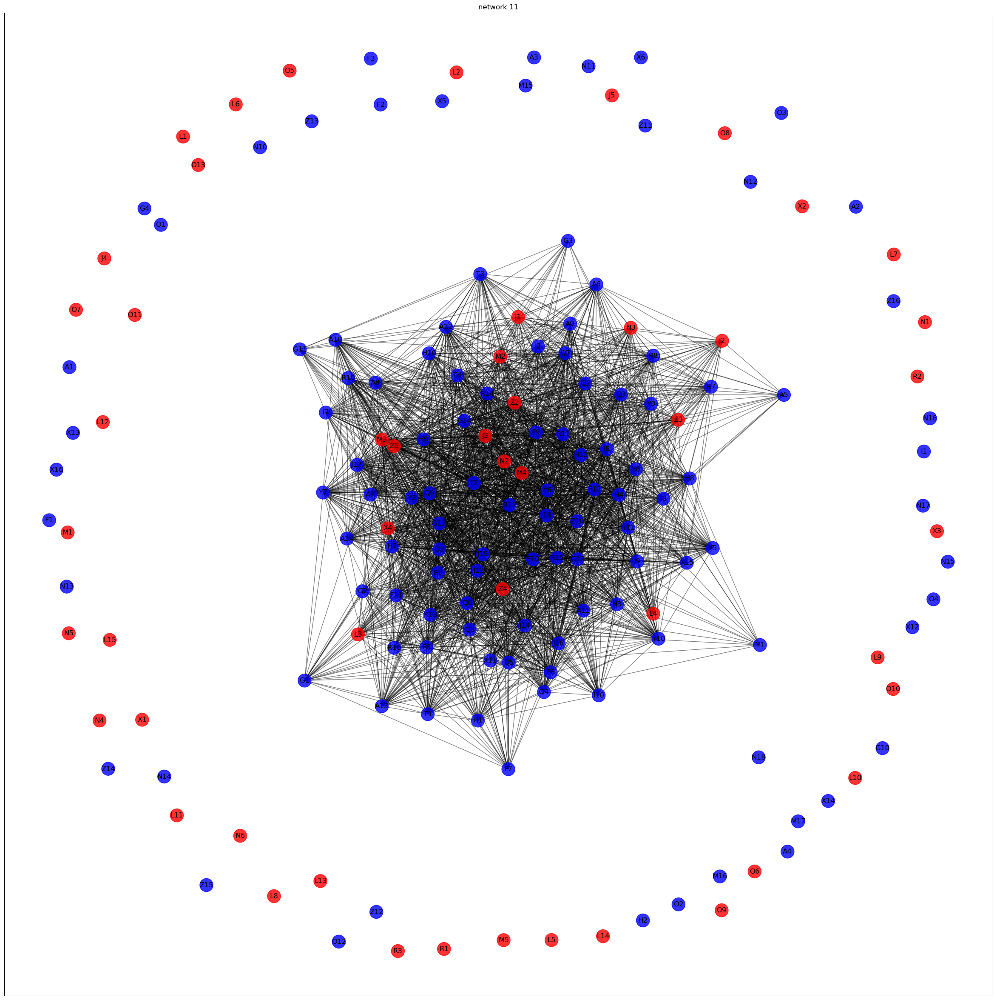

{'J1': 0, 'J2': 2, 'J3': 2, 'J4': 3, 'J5': 4, 'L1': 5, 'L10': 6, 'L11': 7, 'L12': 8, 'L13': 9, 'L14': 10, 'L15': 11, 'L2': 12, 'L3': 1, 'L4': 2, 'L5': 15, 'L6': 16, 'L7': 17, 'L8': 18, 'L9': 19, 'M1': 20, 'M2': 2, 'M3': 1, 'M4': 2, 'M5': 24, 'N1': 25, 'N2': 1, 'N3': 2, 'N4': 28, 'N5': 29, 'N6': 30, 'O10': 31, 'O11': 32, 'O13': 33, 'O5': 34, 'O6': 35, 'O7': 36, 'O8': 37, 'O9': 38, 'R1': 39, 'R2': 40, 'R3': 41, 'X1': 42, 'X2': 43, 'X3': 44, 'X4': 1, 'Z2': 2, 'Z3': 2, 'Z4': 0, 'Z5': 2, 'A1': 50, 'A10': 0, 'A11': 0, 'A12': 0, 'A13': 1, 'A14': 0, 'A2': 56, 'A3': 57, 'A4': 58, 'A5': 2, 'A6': 2, 'A7': 2, 'A8': 0, 'A9': 0, 'F1': 64, 'F10': 1, 'F11': 1, 'F12': 2, 'F2': 68, 'F3': 69, 'F6': 1, 'F7': 1, 'F8': 1, 'F9': 2, 'G1': 1, 'G10': 75, 'G11': 0, 'G12': 2, 'G13': 1, 'G14': 0, 'G2': 1, 'G3': 0, 'G4': 51, 'H1': 0, 'H10': 0, 'H11': 0, 'H12': 2, 'H2': 52, 'H3': 0, 'H4': 2, 'H7': 0, 'H8': 0, 'H9': 0, 'I1': 53, 'I10': 0, 'I2': 2, 'I3': 2, 'I7': 0, 'I8': 0, 'I9': 1, 'J14': 1, 'J15': 1, 'J16': 1, 'J17

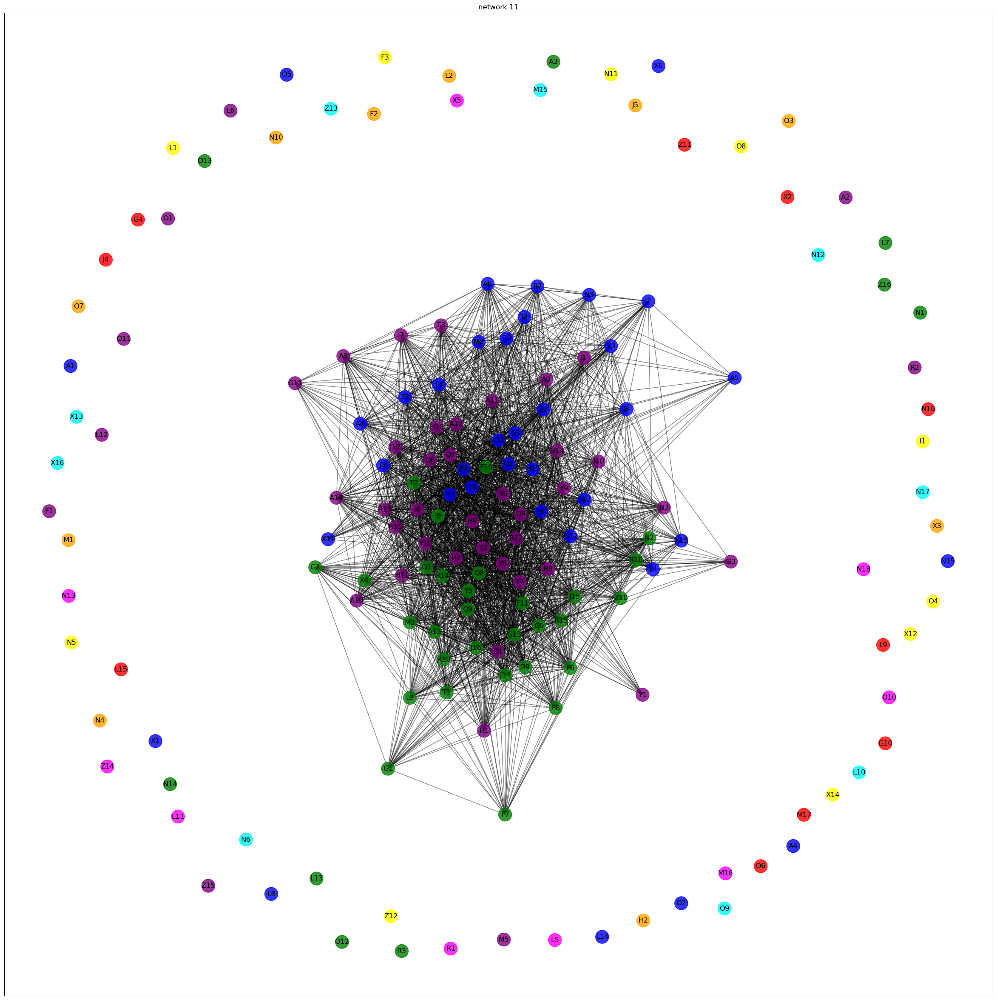

V-Measure Score: 0.0955134475140963
Homogeneity Score: 0.10212143794066492
La percentuale di corrispondenza massima per Graph with 169 nodes and 2280 edges è: 66.07142857142857%


In [43]:
networks = [A,B,C,D,E,F,G,H,I,L,M,N,O,P]
# Leggi il file Excel
df = pd.read_csv('channel_labels_withoutZ6_Z14.csv')

label_true=df['Epileptogenic'].values
#print(label_true)
# Lista degli indici per cui eseguire le operazioni
indices_da_eseguire = [11]

for i, network in enumerate(networks):
    if i in indices_da_eseguire:
        print(f'network {i}')
        show_graph_weight(network, i)
        
#         # Calcolo della centralità di grado
#         degree_centrality = nx.degree_centrality(network)
#         print("Centralità di Grado:", degree_centrality)

#         # Calcolo della centralità di betweenness
#         betweenness_centrality = nx.betweenness_centrality(network)
#         print("Centralità di Betweenness:", betweenness_centrality)

#         # Calcolo della centralità di closeness
#         closeness_centrality = nx.closeness_centrality(network)
#         print("Centralità di Closeness:", closeness_centrality)
        
#         # Calcolo della centralità di autovettore
#         eigenvector_centrality = nx.eigenvector_centrality(network)
#         print("Centralità di Autovettore:", eigenvector_centrality)
        
#         clustering_coefficients = nx.clustering(network)
#         print("Centralità di Clustering:", clustering_coefficients)
        
#         # Ottieni la lista dei nodi
#         nodes = list(network.nodes())

#         # Scrivi le misure di centralità in due file CSV separati
#         with open(f'distribuzione_dati/centrality_measures_epi_second_dataset{i}.csv', mode='w', newline='') as epi_file, \
#              open(f'distribuzione_dati/centrality_measures_non_epi_second_dataset{i}.csv', mode='w', newline='') as non_epi_file:

#             epi_writer = csv.writer(epi_file)
#             non_epi_writer = csv.writer(non_epi_file)

#             # Scrivi l'intestazione
#             header = ['Node', 'Degree Centrality', 'Betweenness Centrality', 'Closeness Centrality', 'Eigenvector Centrality', 'Clustering Centrality']
#             epi_writer.writerow(header)
#             non_epi_writer.writerow(header)

#             # Scrivi i valori di centralità per ogni nodo nei rispettivi file
#             for node in nodes:
#                 row = [node, degree_centrality[node], betweenness_centrality[node], closeness_centrality[node], eigenvector_centrality[node], clustering_coefficients[node]]
#                 if network.nodes[node]['color'] == 'red':
#                     epi_writer.writerow(row)
#                 else:
#                     non_epi_writer.writerow(row)

#         print(f"Le misure di centralità sono state salvate con successo nei file centrality_measures_epi_{i}.csv e centrality_measures_non_epi_{i}.csv")


        draw_network_Louvain(network, i)
        ordered_label_true, ordered_assignment = process_graph_and_labels(network, 'channel_labels_withoutZ6_Z14.csv')
        
        # Calcola il v_measure_score
        score = v_measure_score(ordered_assignment, ordered_label_true)
        metric = homogeneity_score(ordered_label_true, ordered_assignment)
        print(f'V-Measure Score: {score}')
        print(f'Homogeneity Score: {metric}')
        
        matching_percentage = calculate_matching_percentage(ordered_label_true, ordered_assignment)
        print(f"La percentuale di corrispondenza massima per {network} è: {matching_percentage}%")
